### Neethling-ACSE-fh223

In [1]:
%precision 3
%matplotlib inline
import time
import numpy as np
import matplotlib.pyplot as plt
import scipy.linalg as sl
import scipy.sparse as sp
import scipy.sparse.linalg as spla
# the following allows us to plot triangles indicating convergence order
from matplotlib import cm
# and we will create some animations!
import matplotlib.animation as animation
from IPython.display import HTML
from pprint import pprint

In [2]:
def pressure_poisson_jacobi(p, dx, dy, RHS, rtol = 1.e-5, logs = False):
    """ Solve the pressure Poisson equation (PPE)
    using Jacobi iteration assuming mesh spacing of
    dx and dy (we assume at the moment that dx=dy)
    and the RHS function given by RHS.
    
    Assumes imposition of a Neumann BC on all boundaries.
    
    Return the pressure field.
    """
    # iterate
    tol = 10.*rtol
    it = 0
    p_old = np.copy(p)
    while tol > rtol:
        it += 1
        
        #swap arrays without copying the data
        temp = p_old
        p_old = p
        p = temp
        
        #this version is valid for dx!=dy
        p[1:-1, 1:-1] = 1.0/(2.0+2.0*(dx**2)/(dy**2))*(p_old[2:, 1:-1] + p_old[:-2, 1:-1] +
                                (p_old[1:-1, 2:] + p_old[1:-1,:-2])*(dx**2)/(dy**2)
                                - (dx**2)*RHS[1:-1, 1:-1])
        
        # apply zero gradient Neumann boundary conditions at the no slip walls
        p[:, 0] = p[:, 1]
        p[-1, :] = p[-2, :]
        p[:i//2,-1]= p[:i//2,-2]

        # relative change in pressure
        tol = sl.norm(p - p_old)/np.maximum(1.0e-10,sl.norm(p))
        
    if logs: print('pressure solve iterations = {:4d}'.format(it))
    return p

In [3]:
def calculate_ppm_RHS_upwind(rho, u, v, RHS, dt, dx, dy):
    """ Calculate the RHS of the 
    Poisson equation resulting from the projection method.
    Use upwind differences for the first derivatives of u and v.
    """
    RHS[1:-1, 1:-1] =rho*(np.select([u[1:-1, 1:-1] > 0, u[1:-1, 1:-1] < 0],
                      [np.diff(u[:-1, 1:-1], n=1, axis=0)/dx,
                       np.diff(u[1:, 1:-1], n=1, axis=0)/dx]) + 
              np.select([v[1:-1, 1:-1] > 0, v[1:-1, 1:-1] < 0],
                      [np.diff(v[1:-1, :-1], n=1, axis=1)/dy,
                       np.diff(v[1:-1, 1:], n=1, axis=1)/dy]))
    return RHS

def calculate_ppm_RHS_central(rho, u, v, RHS, dt, dx, dy):
    """ Calculate the RHS of the 
    Poisson equation resulting from the projection method.
    Use central differences for the first derivatives of u and v.
    """
    RHS[1:-1, 1:-1] = rho * (
        (1.0/dt) * ( (u[2:, 1:-1] - u[:-2, 1:-1]) / (2*dx) 
                   + (v[1:-1, 2:] - v[1:-1, :-2]) / (2*dy) ))
    return RHS


def project_velocity(rho, u, v, dt, dx, dy, p):
    """ Update the velocity to be divergence free using the pressure.
    """
    u[1:-1, 1:-1] = u[1:-1, 1:-1] - dt * (1./rho) * (
        (p[2:, 1:-1] - p[:-2, 1:-1])/(2*dx) )
    v[1:-1, 1:-1] = v[1:-1, 1:-1] - dt * (1./rho) * (
        (p[1:-1, 2:] - p[1:-1, :-2])/(2*dy) )
    
    #apply the velocity boundary condition
    i = len(u)
    j = np.size(u)//len(u)
    u[0,:] = u[1,:]
    v[i//2:,-1]= v[i//2:,-2]
    return u, v

def calculate_intermediate_velocity(nu, u, v, u_old, v_old, dt, dx, dy):
    """ Calculate the intermediate velocities.
    """
    # intermediate u
    u[1:-1, 1:-1] = u_old[1:-1, 1:-1] - dt * (
                      # ADVECTION:  uu_x + vu_x
                        u_old[1:-1, 1:-1] *
                      # see comments in the upwind based solver for advection above
                      np.select([u_old[1:-1, 1:-1] > 0, u_old[1:-1, 1:-1] < 0],
                      [np.diff(u_old[:-1, 1:-1], n=1, axis=0)/dx,
                       np.diff(u_old[1:, 1:-1], n=1, axis=0)/dx]) +
                             v_old[1:-1, 1:-1] *
                       np.select([v_old[1:-1, 1:-1] > 0, v_old[1:-1, 1:-1] < 0],
                      [np.diff(u_old[1:-1, :-1], n=1, axis=1)/dy,
                       np.diff(u_old[1:-1, 1:], n=1, axis=1)/dy]) ) + (
                       # DIFFUSION
                         dt*nu*(np.diff(u_old[:, 1:-1], n=2, axis=0)/(dx**2)
                                 + np.diff(u_old[1:-1, :], n=2, axis=1)/(dy**2)) )
    # intermediate v
    v[1:-1, 1:-1] = v_old[1:-1, 1:-1] - dt * (
                      # ADVECTION:  uv_x + vv_x
                        u_old[1:-1, 1:-1] *
                      np.select([u_old[1:-1, 1:-1] > 0, u_old[1:-1, 1:-1] < 0],
                      [np.diff(v_old[:-1, 1:-1], n=1, axis=0)/dx,
                       np.diff(v_old[1:, 1:-1], n=1, axis=0)/dx]) +
                             v_old[1:-1, 1:-1] *
                       np.select([v_old[1:-1, 1:-1] > 0, v_old[1:-1, 1:-1] < 0],
                      [np.diff(v_old[1:-1, :-1], n=1, axis=1)/dy,
                       np.diff(v_old[1:-1, 1:], n=1, axis=1)/dy]) ) + (
                       # DIFFUSION
                        dt*nu*(np.diff(v_old[:, 1:-1], n=2, axis=0)/(dx**2)
                                 + np.diff(v_old[1:-1, :], n=2, axis=1)/(dy**2)) )
    
    return u, v

In [4]:
def solve_NS(u, v, p, rho, nu, dt, t_end, dx, dy, rtol = 1.e-5, logs = False):
    """ Solve the incompressible Navier-Stokes equations
    using a lot of the numerical choices and approaches we've seen
    earlier in this lecture.
    """
    t = 0
    
    u_old = u.copy()
    v_old = v.copy()
    p_RHS = np.zeros_like(X)
    
    while t < t_end:
        t += dt
        if logs: print('\nTime = {:.8f}'.format(t))
            
        # calculate intermediate velocities
        u, v = calculate_intermediate_velocity(nu, u, v, u_old, v_old, dt, dx, dy)
        # PPM
        # calculate RHS for the pressure Poisson problem
        p_RHS = calculate_ppm_RHS_central(rho, u, v, p_RHS, dt, dx, dy)
        # compute pressure - note that we use the previous p as an initial guess to the solution
        p = pressure_poisson_jacobi(p, dx, dy, p_RHS, 1.e-5, logs)
        # project velocity
        u, v = project_velocity(rho, u, v, dt, dx, dy, p)
        
        if logs:
            print('norm(u) = {0:.8f}, norm(v) = {1:.8f}'.format(sl.norm(u),sl.norm(v)))
            print('Courant number: {0:.8f}'.format(np.max(np.sqrt(u**2+v**2)) * dt / min(dx,dy)))
                
        #swap pointers without copying data
        temp = u_old
        u_old = u
        u = temp
        temp = v_old
        v_old = v
        v = temp
    return u, v, p

### (A)  Simulator to solve this problem

In [5]:
rho = 1000.0  # Fluid density kg/m^3
mu = 0.001  # Dynamic viscosity Pa·s
nu = mu / rho  # Kinematic viscosity m^2/s
P_max = 0.5  # Pressure drop Pa

# Update grid size to match the size of the heating chamber
Lx = 0.01  # Length in x direction
Ly = 0.005  # Length in y direction
Nx = 51  # Number of grid points in x direction
Ny = 51  # Number of grid points in y direction
dx = Lx / (Nx - 1)
dy = Ly / (Ny - 1)

X, Y = np.mgrid[0: Lx + 1e-10: dx, 0: Ly + 1e-10: dy]

#Initialize velocity and pressure fields
u = np.zeros((Ny, Nx))
v = np.zeros((Ny, Nx))
p = np.zeros((Ny, Nx))

i = len(u)
j = np.size(u)//len(u)

u[:, -1] = 0
u[:, 0] = 0
u[0, :] = 0
u[-1, :] = 0
v[:, -1] = 0
v[:, 0] = 0
v[0, :] = 0
v[-1, :] = 0

p[0, :] = P_max
p[i//2:, -1] = 0

# Set time step
dt = 0.0001
t_end = 10  

# Start simulation
start = time.time()
u, v, p = solve_NS(u, v, p, rho, nu, dt, t_end, dx, dy, rtol=1.e-6, logs=True)
end = time.time()
print('Time taken by calculation = ', end - start)


Time = 0.00010000
pressure solve iterations = 7378
norm(u) = 0.00026445, norm(v) = 0.00012294
Courant number: 0.00002904

Time = 0.00020000
pressure solve iterations = 1572
norm(u) = 0.00052381, norm(v) = 0.00025522
Courant number: 0.00006165

Time = 0.00030000
pressure solve iterations =  320
norm(u) = 0.00078235, norm(v) = 0.00038672
Courant number: 0.00009211

Time = 0.00040000
pressure solve iterations =  295
norm(u) = 0.00104056, norm(v) = 0.00051748
Courant number: 0.00012103

Time = 0.00050000
pressure solve iterations =  125
norm(u) = 0.00129874, norm(v) = 0.00064807
Courant number: 0.00014943

Time = 0.00060000
pressure solve iterations =   46
norm(u) = 0.00155687, norm(v) = 0.00077862
Courant number: 0.00017756

Time = 0.00070000
pressure solve iterations =   84
norm(u) = 0.00181491, norm(v) = 0.00090905
Courant number: 0.00020553

Time = 0.00080000
pressure solve iterations =   97
norm(u) = 0.00207288, norm(v) = 0.00103929
Courant number: 0.00023332

Time = 0.00090000
press

pressure solve iterations =   12
norm(u) = 0.04789747, norm(v) = 0.02378586
Courant number: 0.00358046

Time = 0.01920000
pressure solve iterations =   12
norm(u) = 0.04814182, norm(v) = 0.02390661
Courant number: 0.00359324

Time = 0.01930000
pressure solve iterations =   11
norm(u) = 0.04838612, norm(v) = 0.02402733
Courant number: 0.00360598

Time = 0.01940000
pressure solve iterations =    7
norm(u) = 0.04863037, norm(v) = 0.02414801
Courant number: 0.00361867

Time = 0.01950000
pressure solve iterations =   11
norm(u) = 0.04887455, norm(v) = 0.02426868
Courant number: 0.00363132

Time = 0.01960000
pressure solve iterations =   10
norm(u) = 0.04911868, norm(v) = 0.02438932
Courant number: 0.00364393

Time = 0.01970000
pressure solve iterations =   10
norm(u) = 0.04936276, norm(v) = 0.02450994
Courant number: 0.00365651

Time = 0.01980000
pressure solve iterations =   11
norm(u) = 0.04960677, norm(v) = 0.02463053
Courant number: 0.00366905

Time = 0.01990000
pressure solve iteration

pressure solve iterations =    8
norm(u) = 0.09065644, norm(v) = 0.04478876
Courant number: 0.00571397

Time = 0.03700000
pressure solve iterations =    8
norm(u) = 0.09089288, norm(v) = 0.04490416
Courant number: 0.00572402

Time = 0.03710000
pressure solve iterations =    7
norm(u) = 0.09112929, norm(v) = 0.04501952
Courant number: 0.00573405

Time = 0.03720000
pressure solve iterations =    5
norm(u) = 0.09136567, norm(v) = 0.04513484
Courant number: 0.00574406

Time = 0.03730000
pressure solve iterations =    7
norm(u) = 0.09160202, norm(v) = 0.04525013
Courant number: 0.00575405

Time = 0.03740000
pressure solve iterations =    7
norm(u) = 0.09183832, norm(v) = 0.04536539
Courant number: 0.00576403

Time = 0.03750000
pressure solve iterations =    9
norm(u) = 0.09207459, norm(v) = 0.04548062
Courant number: 0.00577399

Time = 0.03760000
pressure solve iterations =    6
norm(u) = 0.09231083, norm(v) = 0.04559582
Courant number: 0.00578393

Time = 0.03770000
pressure solve iteration

pressure solve iterations =    9
norm(u) = 0.13425487, norm(v) = 0.06590599
Courant number: 0.00745208

Time = 0.05570000
pressure solve iterations =    8
norm(u) = 0.13448489, norm(v) = 0.06601656
Courant number: 0.00746077

Time = 0.05580000
pressure solve iterations =    8
norm(u) = 0.13471488, norm(v) = 0.06612710
Courant number: 0.00746944

Time = 0.05590000
pressure solve iterations =   10
norm(u) = 0.13494483, norm(v) = 0.06623763
Courant number: 0.00747811

Time = 0.05600000
pressure solve iterations =    8
norm(u) = 0.13517475, norm(v) = 0.06634812
Courant number: 0.00748677

Time = 0.05610000
pressure solve iterations =    8
norm(u) = 0.13540465, norm(v) = 0.06645860
Courant number: 0.00749541

Time = 0.05620000
pressure solve iterations =    9
norm(u) = 0.13563451, norm(v) = 0.06656905
Courant number: 0.00750405

Time = 0.05630000
pressure solve iterations =    5
norm(u) = 0.13586434, norm(v) = 0.06667946
Courant number: 0.00751268

Time = 0.05640000
pressure solve iteration

norm(u) = 0.17855013, norm(v) = 0.08702667
Courant number: 0.00898317

Time = 0.07520000
pressure solve iterations =    7
norm(u) = 0.17877454, norm(v) = 0.08713279
Courant number: 0.00899030

Time = 0.07530000
pressure solve iterations =   10
norm(u) = 0.17899891, norm(v) = 0.08723890
Courant number: 0.00899742

Time = 0.07540000
pressure solve iterations =   10
norm(u) = 0.17922326, norm(v) = 0.08734500
Courant number: 0.00900453

Time = 0.07550000
pressure solve iterations =    8
norm(u) = 0.17944758, norm(v) = 0.08745106
Courant number: 0.00901164

Time = 0.07560000
pressure solve iterations =    9
norm(u) = 0.17967187, norm(v) = 0.08755711
Courant number: 0.00901874

Time = 0.07570000
pressure solve iterations =    7
norm(u) = 0.17989614, norm(v) = 0.08766313
Courant number: 0.00902583

Time = 0.07580000
pressure solve iterations =   11
norm(u) = 0.18012038, norm(v) = 0.08776914
Courant number: 0.00903292

Time = 0.07590000
pressure solve iterations =    8
norm(u) = 0.18034459, no

pressure solve iterations =   10
norm(u) = 0.21588593, norm(v) = 0.10456738
Courant number: 0.01010005

Time = 0.09200000
pressure solve iterations =    9
norm(u) = 0.21610604, norm(v) = 0.10467011
Courant number: 0.01010627

Time = 0.09210000
pressure solve iterations =    8
norm(u) = 0.21632614, norm(v) = 0.10477281
Courant number: 0.01011248

Time = 0.09220000
pressure solve iterations =   10
norm(u) = 0.21654620, norm(v) = 0.10487550
Courant number: 0.01011868

Time = 0.09230000
pressure solve iterations =   10
norm(u) = 0.21676625, norm(v) = 0.10497817
Courant number: 0.01012488

Time = 0.09240000
pressure solve iterations =   10
norm(u) = 0.21698626, norm(v) = 0.10508082
Courant number: 0.01013174

Time = 0.09250000
pressure solve iterations =    9
norm(u) = 0.21720626, norm(v) = 0.10518345
Courant number: 0.01013873

Time = 0.09260000
pressure solve iterations =    9
norm(u) = 0.21742623, norm(v) = 0.10528606
Courant number: 0.01014572

Time = 0.09270000
pressure solve iteration

pressure solve iterations =   10
norm(u) = 0.25447676, norm(v) = 0.12246162
Courant number: 0.01129617

Time = 0.10970000
pressure solve iterations =   10
norm(u) = 0.25469272, norm(v) = 0.12256112
Courant number: 0.01130298

Time = 0.10980000
pressure solve iterations =   11
norm(u) = 0.25490867, norm(v) = 0.12266062
Courant number: 0.01130979

Time = 0.10990000
pressure solve iterations =    9
norm(u) = 0.25512459, norm(v) = 0.12276009
Courant number: 0.01131660

Time = 0.11000000
pressure solve iterations =   11
norm(u) = 0.25534049, norm(v) = 0.12285955
Courant number: 0.01132340

Time = 0.11010000
pressure solve iterations =   10
norm(u) = 0.25555636, norm(v) = 0.12295899
Courant number: 0.01133019

Time = 0.11020000
pressure solve iterations =   11
norm(u) = 0.25577221, norm(v) = 0.12305841
Courant number: 0.01133698

Time = 0.11030000
pressure solve iterations =    9
norm(u) = 0.25598805, norm(v) = 0.12315781
Courant number: 0.01134377

Time = 0.11040000
pressure solve iteration

pressure solve iterations =   10
norm(u) = 0.28789800, norm(v) = 0.13778300
Courant number: 0.01230554

Time = 0.12530000
pressure solve iterations =   11
norm(u) = 0.28811051, norm(v) = 0.13787994
Courant number: 0.01231169

Time = 0.12540000
pressure solve iterations =   11
norm(u) = 0.28832300, norm(v) = 0.13797687
Courant number: 0.01231783

Time = 0.12550000
pressure solve iterations =   11
norm(u) = 0.28853547, norm(v) = 0.13807378
Courant number: 0.01232397

Time = 0.12560000
pressure solve iterations =   11
norm(u) = 0.28874792, norm(v) = 0.13817068
Courant number: 0.01233011

Time = 0.12570000
pressure solve iterations =   10
norm(u) = 0.28896035, norm(v) = 0.13826756
Courant number: 0.01233624

Time = 0.12580000
pressure solve iterations =   12
norm(u) = 0.28917275, norm(v) = 0.13836442
Courant number: 0.01234237

Time = 0.12590000
pressure solve iterations =   10
norm(u) = 0.28938514, norm(v) = 0.13846127
Courant number: 0.01234849

Time = 0.12600000
pressure solve iteration

pressure solve iterations =   12
norm(u) = 0.32225418, norm(v) = 0.15338318
Courant number: 0.01330776

Time = 0.14160000
pressure solve iterations =   12
norm(u) = 0.32246321, norm(v) = 0.15347768
Courant number: 0.01331402

Time = 0.14170000
pressure solve iterations =   11
norm(u) = 0.32267221, norm(v) = 0.15357215
Courant number: 0.01332027

Time = 0.14180000
pressure solve iterations =   11
norm(u) = 0.32288120, norm(v) = 0.15366661
Courant number: 0.01332651

Time = 0.14190000
pressure solve iterations =   12
norm(u) = 0.32309016, norm(v) = 0.15376106
Courant number: 0.01333276

Time = 0.14200000
pressure solve iterations =   11
norm(u) = 0.32329911, norm(v) = 0.15385549
Courant number: 0.01333900

Time = 0.14210000
pressure solve iterations =   12
norm(u) = 0.32350803, norm(v) = 0.15394991
Courant number: 0.01334524

Time = 0.14220000
pressure solve iterations =   11
norm(u) = 0.32371693, norm(v) = 0.15404432
Courant number: 0.01335147

Time = 0.14230000
pressure solve iteration

Courant number: 0.01422648

Time = 0.15680000
pressure solve iterations =   13
norm(u) = 0.35399021, norm(v) = 0.16767661
Courant number: 0.01423232

Time = 0.15690000
pressure solve iterations =   12
norm(u) = 0.35419601, norm(v) = 0.16776898
Courant number: 0.01423817

Time = 0.15700000
pressure solve iterations =   11
norm(u) = 0.35440180, norm(v) = 0.16786132
Courant number: 0.01424400

Time = 0.15710000
pressure solve iterations =   13
norm(u) = 0.35460756, norm(v) = 0.16795366
Courant number: 0.01424984

Time = 0.15720000
pressure solve iterations =   12
norm(u) = 0.35481330, norm(v) = 0.16804598
Courant number: 0.01425567

Time = 0.15730000
pressure solve iterations =   12
norm(u) = 0.35501903, norm(v) = 0.16813828
Courant number: 0.01426151

Time = 0.15740000
pressure solve iterations =   13
norm(u) = 0.35522472, norm(v) = 0.16823058
Courant number: 0.01426733

Time = 0.15750000
pressure solve iterations =   11
norm(u) = 0.35543040, norm(v) = 0.16832286
Courant number: 0.014273

pressure solve iterations =   12
norm(u) = 0.38725824, norm(v) = 0.18255732
Courant number: 0.01515325

Time = 0.17320000
pressure solve iterations =   14
norm(u) = 0.38746061, norm(v) = 0.18264755
Courant number: 0.01515871

Time = 0.17330000
pressure solve iterations =   12
norm(u) = 0.38766295, norm(v) = 0.18273777
Courant number: 0.01516418

Time = 0.17340000
pressure solve iterations =   13
norm(u) = 0.38786527, norm(v) = 0.18282797
Courant number: 0.01516964

Time = 0.17350000
pressure solve iterations =   12
norm(u) = 0.38806758, norm(v) = 0.18291816
Courant number: 0.01517510

Time = 0.17360000
pressure solve iterations =   13
norm(u) = 0.38826986, norm(v) = 0.18300834
Courant number: 0.01518055

Time = 0.17370000
pressure solve iterations =   14
norm(u) = 0.38847212, norm(v) = 0.18309851
Courant number: 0.01518601

Time = 0.17380000
pressure solve iterations =   12
norm(u) = 0.38867435, norm(v) = 0.18318867
Courant number: 0.01519146

Time = 0.17390000
pressure solve iteration

pressure solve iterations =   13
norm(u) = 0.41836977, norm(v) = 0.19639287
Courant number: 0.01597599

Time = 0.18870000
pressure solve iterations =   14
norm(u) = 0.41856881, norm(v) = 0.19648116
Courant number: 0.01598115

Time = 0.18880000
pressure solve iterations =   13
norm(u) = 0.41876783, norm(v) = 0.19656944
Courant number: 0.01598630

Time = 0.18890000
pressure solve iterations =   14
norm(u) = 0.41896683, norm(v) = 0.19665771
Courant number: 0.01599145

Time = 0.18900000
pressure solve iterations =   12
norm(u) = 0.41916580, norm(v) = 0.19674596
Courant number: 0.01599660

Time = 0.18910000
pressure solve iterations =   14
norm(u) = 0.41936476, norm(v) = 0.19683420
Courant number: 0.01600175

Time = 0.18920000
pressure solve iterations =   14
norm(u) = 0.41956369, norm(v) = 0.19692243
Courant number: 0.01600689

Time = 0.18930000
pressure solve iterations =   13
norm(u) = 0.41976260, norm(v) = 0.19701065
Courant number: 0.01601204

Time = 0.18940000
pressure solve iteration

pressure solve iterations =   14
norm(u) = 0.44837209, norm(v) = 0.20967250
Courant number: 0.01678796

Time = 0.20390000
pressure solve iterations =   14
norm(u) = 0.44856777, norm(v) = 0.20975893
Courant number: 0.01679323

Time = 0.20400000
pressure solve iterations =   14
norm(u) = 0.44876344, norm(v) = 0.20984535
Courant number: 0.01679851

Time = 0.20410000
pressure solve iterations =   14
norm(u) = 0.44895908, norm(v) = 0.20993176
Courant number: 0.01680378

Time = 0.20420000
pressure solve iterations =   14
norm(u) = 0.44915470, norm(v) = 0.21001816
Courant number: 0.01680906

Time = 0.20430000
pressure solve iterations =   13
norm(u) = 0.44935030, norm(v) = 0.21010454
Courant number: 0.01681433

Time = 0.20440000
pressure solve iterations =   15
norm(u) = 0.44954587, norm(v) = 0.21019091
Courant number: 0.01681960

Time = 0.20450000
pressure solve iterations =   13
norm(u) = 0.44974143, norm(v) = 0.21027727
Courant number: 0.01682487

Time = 0.20460000
pressure solve iteration

pressure solve iterations =   15
norm(u) = 0.47670215, norm(v) = 0.22216282
Courant number: 0.01754183

Time = 0.21850000
pressure solve iterations =   14
norm(u) = 0.47689450, norm(v) = 0.22224748
Courant number: 0.01754688

Time = 0.21860000
pressure solve iterations =   14
norm(u) = 0.47708683, norm(v) = 0.22233212
Courant number: 0.01755193

Time = 0.21870000
pressure solve iterations =   15
norm(u) = 0.47727913, norm(v) = 0.22241675
Courant number: 0.01755698

Time = 0.21880000
pressure solve iterations =   15
norm(u) = 0.47747141, norm(v) = 0.22250137
Courant number: 0.01756203

Time = 0.21890000
pressure solve iterations =   14
norm(u) = 0.47766367, norm(v) = 0.22258597
Courant number: 0.01756708

Time = 0.21900000
pressure solve iterations =   14
norm(u) = 0.47785591, norm(v) = 0.22267056
Courant number: 0.01757212

Time = 0.21910000
pressure solve iterations =   15
norm(u) = 0.47804812, norm(v) = 0.22275514
Courant number: 0.01757716

Time = 0.21920000
pressure solve iteration

pressure solve iterations =   14
norm(u) = 0.50396884, norm(v) = 0.23414359
Courant number: 0.01824955

Time = 0.23280000
pressure solve iterations =   16
norm(u) = 0.50415779, norm(v) = 0.23422648
Courant number: 0.01825439

Time = 0.23290000
pressure solve iterations =   14
norm(u) = 0.50434672, norm(v) = 0.23430936
Courant number: 0.01825924

Time = 0.23300000
pressure solve iterations =   15
norm(u) = 0.50453563, norm(v) = 0.23439222
Courant number: 0.01826409

Time = 0.23310000
pressure solve iterations =   15
norm(u) = 0.50472451, norm(v) = 0.23447507
Courant number: 0.01826893

Time = 0.23320000
pressure solve iterations =   15
norm(u) = 0.50491337, norm(v) = 0.23455792
Courant number: 0.01827377

Time = 0.23330000
pressure solve iterations =   15
norm(u) = 0.50510220, norm(v) = 0.23464074
Courant number: 0.01827862

Time = 0.23340000
pressure solve iterations =   15
norm(u) = 0.50529101, norm(v) = 0.23472356
Courant number: 0.01828346

Time = 0.23350000
pressure solve iteration

pressure solve iterations =   16
norm(u) = 0.52944080, norm(v) = 0.24530145
Courant number: 0.01889672

Time = 0.24640000
pressure solve iterations =   15
norm(u) = 0.52962639, norm(v) = 0.24538262
Courant number: 0.01890139

Time = 0.24650000
pressure solve iterations =   15
norm(u) = 0.52981195, norm(v) = 0.24546378
Courant number: 0.01890606

Time = 0.24660000
pressure solve iterations =   16
norm(u) = 0.52999748, norm(v) = 0.24554493
Courant number: 0.01891073

Time = 0.24670000
pressure solve iterations =   15
norm(u) = 0.53018300, norm(v) = 0.24562607
Courant number: 0.01891540

Time = 0.24680000
pressure solve iterations =   15
norm(u) = 0.53036848, norm(v) = 0.24570719
Courant number: 0.01892006

Time = 0.24690000
pressure solve iterations =   16
norm(u) = 0.53055394, norm(v) = 0.24578830
Courant number: 0.01892473

Time = 0.24700000
pressure solve iterations =   15
norm(u) = 0.53073938, norm(v) = 0.24586940
Courant number: 0.01892939

Time = 0.24710000
pressure solve iteration

pressure solve iterations =   16
norm(u) = 0.55499165, norm(v) = 0.25646045
Courant number: 0.01953404

Time = 0.26030000
pressure solve iterations =   15
norm(u) = 0.55517365, norm(v) = 0.25653981
Courant number: 0.01953854

Time = 0.26040000
pressure solve iterations =   16
norm(u) = 0.55535562, norm(v) = 0.25661916
Courant number: 0.01954304

Time = 0.26050000
pressure solve iterations =   16
norm(u) = 0.55553757, norm(v) = 0.25669850
Courant number: 0.01954754

Time = 0.26060000
pressure solve iterations =   15
norm(u) = 0.55571949, norm(v) = 0.25677782
Courant number: 0.01955204

Time = 0.26070000
pressure solve iterations =   16
norm(u) = 0.55590139, norm(v) = 0.25685713
Courant number: 0.01955653

Time = 0.26080000
pressure solve iterations =   16
norm(u) = 0.55608326, norm(v) = 0.25693643
Courant number: 0.01956103

Time = 0.26090000
pressure solve iterations =   15
norm(u) = 0.55626510, norm(v) = 0.25701571
Courant number: 0.01956552

Time = 0.26100000
pressure solve iteration

pressure solve iterations =   17
norm(u) = 0.58021204, norm(v) = 0.26744046
Courant number: 0.02015801

Time = 0.27430000
pressure solve iterations =   15
norm(u) = 0.58039028, norm(v) = 0.26751793
Courant number: 0.02016265

Time = 0.27440000
pressure solve iterations =   16
norm(u) = 0.58056849, norm(v) = 0.26759538
Courant number: 0.02016729

Time = 0.27450000
pressure solve iterations =   17
norm(u) = 0.58074668, norm(v) = 0.26767283
Courant number: 0.02017193

Time = 0.27460000
pressure solve iterations =   15
norm(u) = 0.58092483, norm(v) = 0.26775025
Courant number: 0.02017657

Time = 0.27470000
pressure solve iterations =   16
norm(u) = 0.58110296, norm(v) = 0.26782766
Courant number: 0.02018121

Time = 0.27480000
pressure solve iterations =   16
norm(u) = 0.58128106, norm(v) = 0.26790506
Courant number: 0.02018585

Time = 0.27490000
pressure solve iterations =   17
norm(u) = 0.58145913, norm(v) = 0.26798245
Courant number: 0.02019048

Time = 0.27500000
pressure solve iteration

pressure solve iterations =   17
norm(u) = 0.60192732, norm(v) = 0.27686422
Courant number: 0.02072093

Time = 0.28660000
pressure solve iterations =   15
norm(u) = 0.60210213, norm(v) = 0.27693995
Courant number: 0.02072544

Time = 0.28670000
pressure solve iterations =   17
norm(u) = 0.60227691, norm(v) = 0.27701568
Courant number: 0.02072996

Time = 0.28680000
pressure solve iterations =   15
norm(u) = 0.60245166, norm(v) = 0.27709139
Courant number: 0.02073446

Time = 0.28690000
pressure solve iterations =   17
norm(u) = 0.60262638, norm(v) = 0.27716708
Courant number: 0.02073897

Time = 0.28700000
pressure solve iterations =   16
norm(u) = 0.60280108, norm(v) = 0.27724276
Courant number: 0.02074348

Time = 0.28710000
pressure solve iterations =   16
norm(u) = 0.60297575, norm(v) = 0.27731843
Courant number: 0.02074799

Time = 0.28720000
pressure solve iterations =   17
norm(u) = 0.60315038, norm(v) = 0.27739409
Courant number: 0.02075249

Time = 0.28730000
pressure solve iteration

pressure solve iterations =   16
norm(u) = 0.62372761, norm(v) = 0.28629322
Courant number: 0.02128138

Time = 0.29920000
pressure solve iterations =   16
norm(u) = 0.62389879, norm(v) = 0.28636713
Courant number: 0.02128576

Time = 0.29930000
pressure solve iterations =   17
norm(u) = 0.62406994, norm(v) = 0.28644102
Courant number: 0.02129014

Time = 0.29940000
pressure solve iterations =   15
norm(u) = 0.62424106, norm(v) = 0.28651488
Courant number: 0.02129453

Time = 0.29950000
pressure solve iterations =   17
norm(u) = 0.62441215, norm(v) = 0.28658874
Courant number: 0.02129891

Time = 0.29960000
pressure solve iterations =   17
norm(u) = 0.62458321, norm(v) = 0.28666259
Courant number: 0.02130329

Time = 0.29970000
pressure solve iterations =   16
norm(u) = 0.62475425, norm(v) = 0.28673642
Courant number: 0.02130767

Time = 0.29980000
pressure solve iterations =   16
norm(u) = 0.62492525, norm(v) = 0.28681023
Courant number: 0.02131205

Time = 0.29990000
pressure solve iteration

pressure solve iterations =   17
norm(u) = 0.64623516, norm(v) = 0.29599029
Courant number: 0.02185743

Time = 0.31250000
pressure solve iterations =   15
norm(u) = 0.64640239, norm(v) = 0.29606217
Courant number: 0.02186192

Time = 0.31260000
pressure solve iterations =   17
norm(u) = 0.64656959, norm(v) = 0.29613405
Courant number: 0.02186641

Time = 0.31270000
pressure solve iterations =   17
norm(u) = 0.64673676, norm(v) = 0.29620591
Courant number: 0.02187090

Time = 0.31280000
pressure solve iterations =   16
norm(u) = 0.64690390, norm(v) = 0.29627776
Courant number: 0.02187538

Time = 0.31290000
pressure solve iterations =   16
norm(u) = 0.64707101, norm(v) = 0.29634959
Courant number: 0.02187987

Time = 0.31300000
pressure solve iterations =   17
norm(u) = 0.64723809, norm(v) = 0.29642140
Courant number: 0.02188435

Time = 0.31310000
pressure solve iterations =   16
norm(u) = 0.64740514, norm(v) = 0.29649320
Courant number: 0.02188884

Time = 0.31320000
pressure solve iteration

pressure solve iterations =   16
norm(u) = 0.66935148, norm(v) = 0.30590347
Courant number: 0.02247660

Time = 0.32650000
pressure solve iterations =   17
norm(u) = 0.66951443, norm(v) = 0.30597317
Courant number: 0.02248096

Time = 0.32660000
pressure solve iterations =   15
norm(u) = 0.66967735, norm(v) = 0.30604284
Courant number: 0.02248531

Time = 0.32670000
pressure solve iterations =   18
norm(u) = 0.66984024, norm(v) = 0.30611251
Courant number: 0.02248967

Time = 0.32680000
pressure solve iterations =   15
norm(u) = 0.67000310, norm(v) = 0.30618216
Courant number: 0.02249402

Time = 0.32690000
pressure solve iterations =   17
norm(u) = 0.67016593, norm(v) = 0.30625179
Courant number: 0.02249837

Time = 0.32700000
pressure solve iterations =   17
norm(u) = 0.67032873, norm(v) = 0.30632141
Courant number: 0.02250272

Time = 0.32710000
pressure solve iterations =   15
norm(u) = 0.67049150, norm(v) = 0.30639101
Courant number: 0.02250707

Time = 0.32720000
pressure solve iteration

pressure solve iterations =   16
norm(u) = 0.69170263, norm(v) = 0.31543694
Courant number: 0.02307329

Time = 0.34040000
pressure solve iterations =   17
norm(u) = 0.69186123, norm(v) = 0.31550439
Courant number: 0.02307752

Time = 0.34050000
pressure solve iterations =   16
norm(u) = 0.69201979, norm(v) = 0.31557182
Courant number: 0.02308175

Time = 0.34060000
pressure solve iterations =   17
norm(u) = 0.69217833, norm(v) = 0.31563923
Courant number: 0.02308598

Time = 0.34070000
pressure solve iterations =   16
norm(u) = 0.69233683, norm(v) = 0.31570663
Courant number: 0.02309020

Time = 0.34080000
pressure solve iterations =   16
norm(u) = 0.69249530, norm(v) = 0.31577401
Courant number: 0.02309443

Time = 0.34090000
pressure solve iterations =   16
norm(u) = 0.69265374, norm(v) = 0.31584138
Courant number: 0.02309865

Time = 0.34100000
pressure solve iterations =   17
norm(u) = 0.69281215, norm(v) = 0.31590873
Courant number: 0.02310288

Time = 0.34110000
pressure solve iteration

pressure solve iterations =   17
norm(u) = 0.71328791, norm(v) = 0.32458805
Courant number: 0.02364866

Time = 0.35420000
pressure solve iterations =   16
norm(u) = 0.71344210, norm(v) = 0.32465320
Courant number: 0.02365277

Time = 0.35430000
pressure solve iterations =   16
norm(u) = 0.71359625, norm(v) = 0.32471834
Courant number: 0.02365688

Time = 0.35440000
pressure solve iterations =   16
norm(u) = 0.71375037, norm(v) = 0.32478345
Courant number: 0.02366099

Time = 0.35450000
pressure solve iterations =   17
norm(u) = 0.71390446, norm(v) = 0.32484855
Courant number: 0.02366510

Time = 0.35460000
pressure solve iterations =   15
norm(u) = 0.71405852, norm(v) = 0.32491363
Courant number: 0.02366920

Time = 0.35470000
pressure solve iterations =   17
norm(u) = 0.71421254, norm(v) = 0.32497870
Courant number: 0.02367331

Time = 0.35480000
pressure solve iterations =   16
norm(u) = 0.71436654, norm(v) = 0.32504375
Courant number: 0.02367741

Time = 0.35490000
pressure solve iteration

pressure solve iterations =   16
norm(u) = 0.73246011, norm(v) = 0.33266359
Courant number: 0.02418239

Time = 0.36680000
pressure solve iterations =   16
norm(u) = 0.73261020, norm(v) = 0.33272660
Courant number: 0.02418660

Time = 0.36690000
pressure solve iterations =   17
norm(u) = 0.73276026, norm(v) = 0.33278959
Courant number: 0.02419081

Time = 0.36700000
pressure solve iterations =   15
norm(u) = 0.73291029, norm(v) = 0.33285257
Courant number: 0.02419502

Time = 0.36710000
pressure solve iterations =   16
norm(u) = 0.73306028, norm(v) = 0.33291552
Courant number: 0.02419923

Time = 0.36720000
pressure solve iterations =   16
norm(u) = 0.73321025, norm(v) = 0.33297846
Courant number: 0.02420344

Time = 0.36730000
pressure solve iterations =   17
norm(u) = 0.73336017, norm(v) = 0.33304139
Courant number: 0.02420764

Time = 0.36740000
pressure solve iterations =   15
norm(u) = 0.73351007, norm(v) = 0.33310429
Courant number: 0.02421185

Time = 0.36750000
pressure solve iteration

pressure solve iterations =   16
norm(u) = 0.75125936, norm(v) = 0.34052771
Courant number: 0.02471032

Time = 0.37950000
pressure solve iterations =   16
norm(u) = 0.75140528, norm(v) = 0.34058852
Courant number: 0.02471443

Time = 0.37960000
pressure solve iterations =   15
norm(u) = 0.75155116, norm(v) = 0.34064932
Courant number: 0.02471853

Time = 0.37970000
pressure solve iterations =   17
norm(u) = 0.75169701, norm(v) = 0.34071010
Courant number: 0.02472263

Time = 0.37980000
pressure solve iterations =   15
norm(u) = 0.75184283, norm(v) = 0.34077086
Courant number: 0.02472673

Time = 0.37990000
pressure solve iterations =   16
norm(u) = 0.75198862, norm(v) = 0.34083160
Courant number: 0.02473083

Time = 0.38000000
pressure solve iterations =   15
norm(u) = 0.75213437, norm(v) = 0.34089233
Courant number: 0.02473493

Time = 0.38010000
pressure solve iterations =   16
norm(u) = 0.75228010, norm(v) = 0.34095303
Courant number: 0.02473903

Time = 0.38020000
pressure solve iteration

pressure solve iterations =   16
norm(u) = 0.76881694, norm(v) = 0.34781805
Courant number: 0.02520495

Time = 0.39170000
pressure solve iterations =   15
norm(u) = 0.76895881, norm(v) = 0.34787673
Courant number: 0.02520895

Time = 0.39180000
pressure solve iterations =   16
norm(u) = 0.76910065, norm(v) = 0.34793540
Courant number: 0.02521296

Time = 0.39190000
pressure solve iterations =   15
norm(u) = 0.76924246, norm(v) = 0.34799404
Courant number: 0.02521696

Time = 0.39200000
pressure solve iterations =   16
norm(u) = 0.76938423, norm(v) = 0.34805267
Courant number: 0.02522096

Time = 0.39210000
pressure solve iterations =   15
norm(u) = 0.76952597, norm(v) = 0.34811128
Courant number: 0.02522496

Time = 0.39220000
pressure solve iterations =   16
norm(u) = 0.76966767, norm(v) = 0.34816987
Courant number: 0.02522896

Time = 0.39230000
pressure solve iterations =   15
norm(u) = 0.76980935, norm(v) = 0.34822844
Courant number: 0.02523296

Time = 0.39240000
pressure solve iteration

pressure solve iterations =   15
norm(u) = 0.78725597, norm(v) = 0.35541151
Courant number: 0.02572674

Time = 0.40490000
pressure solve iterations =   15
norm(u) = 0.78739344, norm(v) = 0.35546786
Courant number: 0.02573064

Time = 0.40500000
pressure solve iterations =   16
norm(u) = 0.78753088, norm(v) = 0.35552420
Courant number: 0.02573454

Time = 0.40510000
pressure solve iterations =   14
norm(u) = 0.78766828, norm(v) = 0.35558051
Courant number: 0.02573844

Time = 0.40520000
pressure solve iterations =   16
norm(u) = 0.78780565, norm(v) = 0.35563682
Courant number: 0.02574234

Time = 0.40530000
pressure solve iterations =   15
norm(u) = 0.78794298, norm(v) = 0.35569310
Courant number: 0.02574623

Time = 0.40540000
pressure solve iterations =   15
norm(u) = 0.78808029, norm(v) = 0.35574936
Courant number: 0.02575013

Time = 0.40550000
pressure solve iterations =   15
norm(u) = 0.78821756, norm(v) = 0.35580561
Courant number: 0.02575403

Time = 0.40560000
pressure solve iteration

Courant number: 0.02624265

Time = 0.41830000
pressure solve iterations =   15
norm(u) = 0.80551166, norm(v) = 0.36285918
Courant number: 0.02624645

Time = 0.41840000
pressure solve iterations =   14
norm(u) = 0.80564462, norm(v) = 0.36291314
Courant number: 0.02625025

Time = 0.41850000
pressure solve iterations =   15
norm(u) = 0.80577753, norm(v) = 0.36296708
Courant number: 0.02625404

Time = 0.41860000
pressure solve iterations =   15
norm(u) = 0.80591042, norm(v) = 0.36302102
Courant number: 0.02625784

Time = 0.41870000
pressure solve iterations =   15
norm(u) = 0.80604326, norm(v) = 0.36307493
Courant number: 0.02626164

Time = 0.41880000
pressure solve iterations =   14
norm(u) = 0.80617608, norm(v) = 0.36312882
Courant number: 0.02626543

Time = 0.41890000
pressure solve iterations =   15
norm(u) = 0.80630886, norm(v) = 0.36318270
Courant number: 0.02626923

Time = 0.41900000
pressure solve iterations =   15
norm(u) = 0.80644161, norm(v) = 0.36323656
Courant number: 0.026273

pressure solve iterations =   14
norm(u) = 0.82225694, norm(v) = 0.36962289
Courant number: 0.02672656

Time = 0.43120000
pressure solve iterations =   14
norm(u) = 0.82238561, norm(v) = 0.36967459
Courant number: 0.02673026

Time = 0.43130000
pressure solve iterations =   14
norm(u) = 0.82251424, norm(v) = 0.36972627
Courant number: 0.02673397

Time = 0.43140000
pressure solve iterations =   15
norm(u) = 0.82264283, norm(v) = 0.36977794
Courant number: 0.02673767

Time = 0.43150000
pressure solve iterations =   14
norm(u) = 0.82277139, norm(v) = 0.36982959
Courant number: 0.02674137

Time = 0.43160000
pressure solve iterations =   15
norm(u) = 0.82289992, norm(v) = 0.36988122
Courant number: 0.02674507

Time = 0.43170000
pressure solve iterations =   14
norm(u) = 0.82302841, norm(v) = 0.36993284
Courant number: 0.02674877

Time = 0.43180000
pressure solve iterations =   14
norm(u) = 0.82315687, norm(v) = 0.36998443
Courant number: 0.02675247

Time = 0.43190000
pressure solve iteration

pressure solve iterations =   13
norm(u) = 0.83919941, norm(v) = 0.37639397
Courant number: 0.02722697

Time = 0.44460000
pressure solve iterations =   14
norm(u) = 0.83932359, norm(v) = 0.37644332
Courant number: 0.02723076

Time = 0.44470000
pressure solve iterations =   14
norm(u) = 0.83944774, norm(v) = 0.37649264
Courant number: 0.02723455

Time = 0.44480000
pressure solve iterations =   14
norm(u) = 0.83957185, norm(v) = 0.37654195
Courant number: 0.02723834

Time = 0.44490000
pressure solve iterations =   14
norm(u) = 0.83969593, norm(v) = 0.37659124
Courant number: 0.02724213

Time = 0.44500000
pressure solve iterations =   14
norm(u) = 0.83981997, norm(v) = 0.37664052
Courant number: 0.02724591

Time = 0.44510000
pressure solve iterations =   14
norm(u) = 0.83994398, norm(v) = 0.37668978
Courant number: 0.02724970

Time = 0.44520000
pressure solve iterations =   13
norm(u) = 0.84006797, norm(v) = 0.37673901
Courant number: 0.02725348

Time = 0.44530000
pressure solve iteration

pressure solve iterations =   14
norm(u) = 0.85673806, norm(v) = 0.38331975
Courant number: 0.02776493

Time = 0.45900000
pressure solve iterations =   13
norm(u) = 0.85685745, norm(v) = 0.38336658
Courant number: 0.02776861

Time = 0.45910000
pressure solve iterations =   14
norm(u) = 0.85697680, norm(v) = 0.38341340
Courant number: 0.02777229

Time = 0.45920000
pressure solve iterations =   13
norm(u) = 0.85709611, norm(v) = 0.38346020
Courant number: 0.02777598

Time = 0.45930000
pressure solve iterations =   13
norm(u) = 0.85721540, norm(v) = 0.38350698
Courant number: 0.02777966

Time = 0.45940000
pressure solve iterations =   14
norm(u) = 0.85733465, norm(v) = 0.38355375
Courant number: 0.02778333

Time = 0.45950000
pressure solve iterations =   13
norm(u) = 0.85745387, norm(v) = 0.38360050
Courant number: 0.02778701

Time = 0.45960000
pressure solve iterations =   13
norm(u) = 0.85757305, norm(v) = 0.38364722
Courant number: 0.02779069

Time = 0.45970000
pressure solve iteration

Courant number: 0.02829472

Time = 0.47360000
pressure solve iterations =   12
norm(u) = 0.87393223, norm(v) = 0.39001949
Courant number: 0.02829830

Time = 0.47370000
pressure solve iterations =   13
norm(u) = 0.87404675, norm(v) = 0.39006380
Courant number: 0.02830187

Time = 0.47380000
pressure solve iterations =   13
norm(u) = 0.87416125, norm(v) = 0.39010809
Courant number: 0.02830545

Time = 0.47390000
pressure solve iterations =   13
norm(u) = 0.87427570, norm(v) = 0.39015237
Courant number: 0.02830902

Time = 0.47400000
pressure solve iterations =   12
norm(u) = 0.87439013, norm(v) = 0.39019662
Courant number: 0.02831259

Time = 0.47410000
pressure solve iterations =   13
norm(u) = 0.87450452, norm(v) = 0.39024086
Courant number: 0.02831616

Time = 0.47420000
pressure solve iterations =   13
norm(u) = 0.87461888, norm(v) = 0.39028508
Courant number: 0.02831973

Time = 0.47430000
pressure solve iterations =   13
norm(u) = 0.87473321, norm(v) = 0.39032929
Courant number: 0.028323

pressure solve iterations =   13
norm(u) = 0.89096366, norm(v) = 0.39656012
Courant number: 0.02883322

Time = 0.48890000
pressure solve iterations =   11
norm(u) = 0.89107321, norm(v) = 0.39660186
Courant number: 0.02883668

Time = 0.48900000
pressure solve iterations =   13
norm(u) = 0.89118273, norm(v) = 0.39664359
Courant number: 0.02884015

Time = 0.48910000
pressure solve iterations =   12
norm(u) = 0.89129221, norm(v) = 0.39668530
Courant number: 0.02884361

Time = 0.48920000
pressure solve iterations =   12
norm(u) = 0.89140167, norm(v) = 0.39672700
Courant number: 0.02884707

Time = 0.48930000
pressure solve iterations =   13
norm(u) = 0.89151109, norm(v) = 0.39676868
Courant number: 0.02885053

Time = 0.48940000
pressure solve iterations =   12
norm(u) = 0.89162047, norm(v) = 0.39681034
Courant number: 0.02885399

Time = 0.48950000
pressure solve iterations =   12
norm(u) = 0.89172983, norm(v) = 0.39685199
Courant number: 0.02885745

Time = 0.48960000
pressure solve iteration

pressure solve iterations =   12
norm(u) = 0.90651057, norm(v) = 0.40244031
Courant number: 0.02935545

Time = 0.50340000
pressure solve iterations =   12
norm(u) = 0.90661544, norm(v) = 0.40247967
Courant number: 0.02935900

Time = 0.50350000
pressure solve iterations =   11
norm(u) = 0.90672027, norm(v) = 0.40251901
Courant number: 0.02936256

Time = 0.50360000
pressure solve iterations =   12
norm(u) = 0.90682508, norm(v) = 0.40255833
Courant number: 0.02936612

Time = 0.50370000
pressure solve iterations =   11
norm(u) = 0.90692985, norm(v) = 0.40259763
Courant number: 0.02936967

Time = 0.50380000
pressure solve iterations =   12
norm(u) = 0.90703459, norm(v) = 0.40263692
Courant number: 0.02937323

Time = 0.50390000
pressure solve iterations =   12
norm(u) = 0.90713930, norm(v) = 0.40267620
Courant number: 0.02937678

Time = 0.50400000
pressure solve iterations =   11
norm(u) = 0.90724397, norm(v) = 0.40271545
Courant number: 0.02938033

Time = 0.50410000
pressure solve iteration

pressure solve iterations =   11
norm(u) = 0.92268447, norm(v) = 0.40845826
Courant number: 0.02990805

Time = 0.51920000
pressure solve iterations =   12
norm(u) = 0.92278431, norm(v) = 0.40849508
Courant number: 0.02991149

Time = 0.51930000
pressure solve iterations =   10
norm(u) = 0.92288413, norm(v) = 0.40853188
Courant number: 0.02991492

Time = 0.51940000
pressure solve iterations =   11
norm(u) = 0.92298392, norm(v) = 0.40856867
Courant number: 0.02991836

Time = 0.51950000
pressure solve iterations =   12
norm(u) = 0.92308367, norm(v) = 0.40860544
Courant number: 0.02992179

Time = 0.51960000
pressure solve iterations =   10
norm(u) = 0.92318339, norm(v) = 0.40864219
Courant number: 0.02992523

Time = 0.51970000
pressure solve iterations =   11
norm(u) = 0.92328308, norm(v) = 0.40867893
Courant number: 0.02992866

Time = 0.51980000
pressure solve iterations =   12
norm(u) = 0.92338274, norm(v) = 0.40871566
Courant number: 0.02993209

Time = 0.51990000
pressure solve iteration

pressure solve iterations =   11
norm(u) = 0.93769287, norm(v) = 0.41394412
Courant number: 0.03042837

Time = 0.53460000
pressure solve iterations =   10
norm(u) = 0.93778792, norm(v) = 0.41397855
Courant number: 0.03043169

Time = 0.53470000
pressure solve iterations =   10
norm(u) = 0.93788294, norm(v) = 0.41401296
Courant number: 0.03043501

Time = 0.53480000
pressure solve iterations =   10
norm(u) = 0.93797794, norm(v) = 0.41404734
Courant number: 0.03043832

Time = 0.53490000
pressure solve iterations =   11
norm(u) = 0.93807289, norm(v) = 0.41408172
Courant number: 0.03044164

Time = 0.53500000
pressure solve iterations =   11
norm(u) = 0.93816782, norm(v) = 0.41411609
Courant number: 0.03044496

Time = 0.53510000
pressure solve iterations =   10
norm(u) = 0.93826272, norm(v) = 0.41415043
Courant number: 0.03044828

Time = 0.53520000
pressure solve iterations =   10
norm(u) = 0.93835759, norm(v) = 0.41418476
Courant number: 0.03045159

Time = 0.53530000
pressure solve iteration

pressure solve iterations =    9
norm(u) = 0.95151835, norm(v) = 0.41890648
Courant number: 0.03093395

Time = 0.54950000
pressure solve iterations =   11
norm(u) = 0.95160886, norm(v) = 0.41893867
Courant number: 0.03093736

Time = 0.54960000
pressure solve iterations =    9
norm(u) = 0.95169934, norm(v) = 0.41897084
Courant number: 0.03094077

Time = 0.54970000
pressure solve iterations =   10
norm(u) = 0.95178979, norm(v) = 0.41900299
Courant number: 0.03094418

Time = 0.54980000
pressure solve iterations =   10
norm(u) = 0.95188021, norm(v) = 0.41903513
Courant number: 0.03094759

Time = 0.54990000
pressure solve iterations =   10
norm(u) = 0.95197060, norm(v) = 0.41906726
Courant number: 0.03095100

Time = 0.55000000
pressure solve iterations =    9
norm(u) = 0.95206097, norm(v) = 0.41909936
Courant number: 0.03095441

Time = 0.55010000
pressure solve iterations =   11
norm(u) = 0.95215130, norm(v) = 0.41913146
Courant number: 0.03095781

Time = 0.55020000
pressure solve iteration

pressure solve iterations =   10
norm(u) = 0.96656249, norm(v) = 0.42419799
Courant number: 0.03150562

Time = 0.56660000
pressure solve iterations =    9
norm(u) = 0.96664793, norm(v) = 0.42422770
Courant number: 0.03150890

Time = 0.56670000
pressure solve iterations =    9
norm(u) = 0.96673334, norm(v) = 0.42425740
Courant number: 0.03151217

Time = 0.56680000
pressure solve iterations =    9
norm(u) = 0.96681872, norm(v) = 0.42428708
Courant number: 0.03151544

Time = 0.56690000
pressure solve iterations =    9
norm(u) = 0.96690407, norm(v) = 0.42431674
Courant number: 0.03151871

Time = 0.56700000
pressure solve iterations =   10
norm(u) = 0.96698939, norm(v) = 0.42434640
Courant number: 0.03152198

Time = 0.56710000
pressure solve iterations =    8
norm(u) = 0.96707469, norm(v) = 0.42437603
Courant number: 0.03152525

Time = 0.56720000
pressure solve iterations =   10
norm(u) = 0.96715995, norm(v) = 0.42440566
Courant number: 0.03152852

Time = 0.56730000
pressure solve iteration

pressure solve iterations =    9
norm(u) = 0.98067165, norm(v) = 0.42904819
Courant number: 0.03205067

Time = 0.58360000
pressure solve iterations =    8
norm(u) = 0.98075220, norm(v) = 0.42907555
Courant number: 0.03205381

Time = 0.58370000
pressure solve iterations =    8
norm(u) = 0.98083273, norm(v) = 0.42910289
Courant number: 0.03205695

Time = 0.58380000
pressure solve iterations =    9
norm(u) = 0.98091322, norm(v) = 0.42913022
Courant number: 0.03206008

Time = 0.58390000
pressure solve iterations =    9
norm(u) = 0.98099368, norm(v) = 0.42915753
Courant number: 0.03206322

Time = 0.58400000
pressure solve iterations =    8
norm(u) = 0.98107412, norm(v) = 0.42918483
Courant number: 0.03206635

Time = 0.58410000
pressure solve iterations =    9
norm(u) = 0.98115453, norm(v) = 0.42921212
Courant number: 0.03206949

Time = 0.58420000
pressure solve iterations =    8
norm(u) = 0.98123491, norm(v) = 0.42923940
Courant number: 0.03207262

Time = 0.58430000
pressure solve iteration

pressure solve iterations =    8
norm(u) = 0.99472067, norm(v) = 0.43375805
Courant number: 0.03260273

Time = 0.60160000
pressure solve iterations =    8
norm(u) = 0.99479623, norm(v) = 0.43378303
Courant number: 0.03260573

Time = 0.60170000
pressure solve iterations =    8
norm(u) = 0.99487176, norm(v) = 0.43380800
Courant number: 0.03260872

Time = 0.60180000
pressure solve iterations =    8
norm(u) = 0.99494725, norm(v) = 0.43383296
Courant number: 0.03261172

Time = 0.60190000
pressure solve iterations =    8
norm(u) = 0.99502273, norm(v) = 0.43385790
Courant number: 0.03261471

Time = 0.60200000
pressure solve iterations =    7
norm(u) = 0.99509817, norm(v) = 0.43388283
Courant number: 0.03261770

Time = 0.60210000
pressure solve iterations =    9
norm(u) = 0.99517359, norm(v) = 0.43390775
Courant number: 0.03262069

Time = 0.60220000
pressure solve iterations =    7
norm(u) = 0.99524899, norm(v) = 0.43393265
Courant number: 0.03262369

Time = 0.60230000
pressure solve iteration

pressure solve iterations =    8
norm(u) = 1.00845313, norm(v) = 0.43823312
Courant number: 0.03315219

Time = 0.62040000
pressure solve iterations =    7
norm(u) = 1.00852368, norm(v) = 0.43825576
Courant number: 0.03315504

Time = 0.62050000
pressure solve iterations =    8
norm(u) = 1.00859420, norm(v) = 0.43827838
Courant number: 0.03315789

Time = 0.62060000
pressure solve iterations =    6
norm(u) = 1.00866469, norm(v) = 0.43830099
Courant number: 0.03316074

Time = 0.62070000
pressure solve iterations =    8
norm(u) = 1.00873516, norm(v) = 0.43832359
Courant number: 0.03316359

Time = 0.62080000
pressure solve iterations =    7
norm(u) = 1.00880560, norm(v) = 0.43834617
Courant number: 0.03316643

Time = 0.62090000
pressure solve iterations =    8
norm(u) = 1.00887601, norm(v) = 0.43836875
Courant number: 0.03316928

Time = 0.62100000
pressure solve iterations =    7
norm(u) = 1.00894640, norm(v) = 0.43839131
Courant number: 0.03317212

Time = 0.62110000
pressure solve iteration

pressure solve iterations =    6
norm(u) = 1.02172407, norm(v) = 0.44242180
Courant number: 0.03370752

Time = 0.63990000
pressure solve iterations =    6
norm(u) = 1.02178966, norm(v) = 0.44244213
Courant number: 0.03371033

Time = 0.64000000
pressure solve iterations =    7
norm(u) = 1.02185521, norm(v) = 0.44246246
Courant number: 0.03371313

Time = 0.64010000
pressure solve iterations =    7
norm(u) = 1.02192075, norm(v) = 0.44248277
Courant number: 0.03371593

Time = 0.64020000
pressure solve iterations =    7
norm(u) = 1.02198625, norm(v) = 0.44250308
Courant number: 0.03371873

Time = 0.64030000
pressure solve iterations =    6
norm(u) = 1.02205173, norm(v) = 0.44252337
Courant number: 0.03372153

Time = 0.64040000
pressure solve iterations =    7
norm(u) = 1.02211719, norm(v) = 0.44254366
Courant number: 0.03372433

Time = 0.64050000
pressure solve iterations =    6
norm(u) = 1.02218263, norm(v) = 0.44256392
Courant number: 0.03372713

Time = 0.64060000
pressure solve iteration

pressure solve iterations =    7
norm(u) = 1.03405052, norm(v) = 0.44617650
Courant number: 0.03423939

Time = 0.65940000
pressure solve iterations =    6
norm(u) = 1.03411137, norm(v) = 0.44619469
Courant number: 0.03424204

Time = 0.65950000
pressure solve iterations =    6
norm(u) = 1.03417221, norm(v) = 0.44621286
Courant number: 0.03424469

Time = 0.65960000
pressure solve iterations =    6
norm(u) = 1.03423302, norm(v) = 0.44623102
Courant number: 0.03424734

Time = 0.65970000
pressure solve iterations =    6
norm(u) = 1.03429381, norm(v) = 0.44624917
Courant number: 0.03424999

Time = 0.65980000
pressure solve iterations =    6
norm(u) = 1.03435458, norm(v) = 0.44626731
Courant number: 0.03425264

Time = 0.65990000
pressure solve iterations =    6
norm(u) = 1.03441532, norm(v) = 0.44628544
Courant number: 0.03425529

Time = 0.66000000
pressure solve iterations =    7
norm(u) = 1.03447604, norm(v) = 0.44630357
Courant number: 0.03425794

Time = 0.66010000
pressure solve iteration

pressure solve iterations =    6
norm(u) = 1.04581774, norm(v) = 0.44962137
Courant number: 0.03475732

Time = 0.67950000
pressure solve iterations =    6
norm(u) = 1.04587398, norm(v) = 0.44963748
Courant number: 0.03475983

Time = 0.67960000
pressure solve iterations =    5
norm(u) = 1.04593021, norm(v) = 0.44965357
Courant number: 0.03476233

Time = 0.67970000
pressure solve iterations =    5
norm(u) = 1.04598641, norm(v) = 0.44966966
Courant number: 0.03476483

Time = 0.67980000
pressure solve iterations =    6
norm(u) = 1.04604259, norm(v) = 0.44968573
Courant number: 0.03476733

Time = 0.67990000
pressure solve iterations =    6
norm(u) = 1.04609875, norm(v) = 0.44970180
Courant number: 0.03476982

Time = 0.68000000
pressure solve iterations =    5
norm(u) = 1.04615488, norm(v) = 0.44971786
Courant number: 0.03477232

Time = 0.68010000
pressure solve iterations =    6
norm(u) = 1.04621100, norm(v) = 0.44973391
Courant number: 0.03477482

Time = 0.68020000
pressure solve iteration

pressure solve iterations =    4
norm(u) = 1.05730503, norm(v) = 0.45283280
Courant number: 0.03527374

Time = 0.70080000
pressure solve iterations =    5
norm(u) = 1.05735667, norm(v) = 0.45284687
Courant number: 0.03527608

Time = 0.70090000
pressure solve iterations =    5
norm(u) = 1.05740829, norm(v) = 0.45286092
Courant number: 0.03527843

Time = 0.70100000
pressure solve iterations =    6
norm(u) = 1.05745989, norm(v) = 0.45287497
Courant number: 0.03528078

Time = 0.70110000
pressure solve iterations =    4
norm(u) = 1.05751147, norm(v) = 0.45288900
Courant number: 0.03528312

Time = 0.70120000
pressure solve iterations =    5
norm(u) = 1.05756302, norm(v) = 0.45290303
Courant number: 0.03528547

Time = 0.70130000
pressure solve iterations =    5
norm(u) = 1.05761456, norm(v) = 0.45291705
Courant number: 0.03528781

Time = 0.70140000
pressure solve iterations =    5
norm(u) = 1.05766608, norm(v) = 0.45293105
Courant number: 0.03529016

Time = 0.70150000
pressure solve iteration

pressure solve iterations =    4
norm(u) = 1.06817246, norm(v) = 0.45571058
Courant number: 0.03577343

Time = 0.72280000
pressure solve iterations =    4
norm(u) = 1.06821965, norm(v) = 0.45572270
Courant number: 0.03577562

Time = 0.72290000
pressure solve iterations =    5
norm(u) = 1.06826681, norm(v) = 0.45573481
Courant number: 0.03577782

Time = 0.72300000
pressure solve iterations =    4
norm(u) = 1.06831396, norm(v) = 0.45574690
Courant number: 0.03578001

Time = 0.72310000
pressure solve iterations =    5
norm(u) = 1.06836108, norm(v) = 0.45575900
Courant number: 0.03578220

Time = 0.72320000
pressure solve iterations =    4
norm(u) = 1.06840819, norm(v) = 0.45577108
Courant number: 0.03578440

Time = 0.72330000
pressure solve iterations =    5
norm(u) = 1.06845527, norm(v) = 0.45578316
Courant number: 0.03578659

Time = 0.72340000
pressure solve iterations =    4
norm(u) = 1.06850234, norm(v) = 0.45579522
Courant number: 0.03578878

Time = 0.72350000
pressure solve iteration

pressure solve iterations =    3
norm(u) = 1.07877841, norm(v) = 0.45834188
Courant number: 0.03627311

Time = 0.74640000
pressure solve iterations =    4
norm(u) = 1.07882115, norm(v) = 0.45835208
Courant number: 0.03627515

Time = 0.74650000
pressure solve iterations =    4
norm(u) = 1.07886387, norm(v) = 0.45836228
Courant number: 0.03627719

Time = 0.74660000
pressure solve iterations =    4
norm(u) = 1.07890656, norm(v) = 0.45837247
Courant number: 0.03627922

Time = 0.74670000
pressure solve iterations =    4
norm(u) = 1.07894924, norm(v) = 0.45838265
Courant number: 0.03628126

Time = 0.74680000
pressure solve iterations =    4
norm(u) = 1.07899190, norm(v) = 0.45839283
Courant number: 0.03628330

Time = 0.74690000
pressure solve iterations =    3
norm(u) = 1.07903455, norm(v) = 0.45840299
Courant number: 0.03628534

Time = 0.74700000
pressure solve iterations =    4
norm(u) = 1.07907718, norm(v) = 0.45841314
Courant number: 0.03628737

Time = 0.74710000
pressure solve iteration

pressure solve iterations =    3
norm(u) = 1.08837368, norm(v) = 0.46054281
Courant number: 0.03673706

Time = 0.77000000
pressure solve iterations =    3
norm(u) = 1.08841230, norm(v) = 0.46055127
Courant number: 0.03673896

Time = 0.77010000
pressure solve iterations =    4
norm(u) = 1.08845090, norm(v) = 0.46055974
Courant number: 0.03674085

Time = 0.77020000
pressure solve iterations =    3
norm(u) = 1.08848948, norm(v) = 0.46056819
Courant number: 0.03674274

Time = 0.77030000
pressure solve iterations =    3
norm(u) = 1.08852805, norm(v) = 0.46057663
Courant number: 0.03674463

Time = 0.77040000
pressure solve iterations =    4
norm(u) = 1.08856660, norm(v) = 0.46058507
Courant number: 0.03674652

Time = 0.77050000
pressure solve iterations =    4
norm(u) = 1.08860514, norm(v) = 0.46059351
Courant number: 0.03674841

Time = 0.77060000
pressure solve iterations =    3
norm(u) = 1.08864365, norm(v) = 0.46060193
Courant number: 0.03675030

Time = 0.77070000
pressure solve iteration

pressure solve iterations =    4
norm(u) = 1.09738286, norm(v) = 0.46242233
Courant number: 0.03718479

Time = 0.79460000
pressure solve iterations =    3
norm(u) = 1.09741752, norm(v) = 0.46242917
Courant number: 0.03718654

Time = 0.79470000
pressure solve iterations =    3
norm(u) = 1.09745217, norm(v) = 0.46243600
Courant number: 0.03718829

Time = 0.79480000
pressure solve iterations =    2
norm(u) = 1.09748681, norm(v) = 0.46244281
Courant number: 0.03719003

Time = 0.79490000
pressure solve iterations =    3
norm(u) = 1.09752144, norm(v) = 0.46244962
Courant number: 0.03719178

Time = 0.79500000
pressure solve iterations =    4
norm(u) = 1.09755604, norm(v) = 0.46245644
Courant number: 0.03719353

Time = 0.79510000
pressure solve iterations =    3
norm(u) = 1.09759063, norm(v) = 0.46246324
Courant number: 0.03719527

Time = 0.79520000
pressure solve iterations =    3
norm(u) = 1.09762520, norm(v) = 0.46247004
Courant number: 0.03719702

Time = 0.79530000
pressure solve iteration

pressure solve iterations =    3
norm(u) = 1.10561619, norm(v) = 0.46394780
Courant number: 0.03760615

Time = 0.81970000
pressure solve iterations =    3
norm(u) = 1.10564716, norm(v) = 0.46395314
Courant number: 0.03760776

Time = 0.81980000
pressure solve iterations =    2
norm(u) = 1.10567813, norm(v) = 0.46395848
Courant number: 0.03760937

Time = 0.81990000
pressure solve iterations =    3
norm(u) = 1.10570908, norm(v) = 0.46396381
Courant number: 0.03761098

Time = 0.82000000
pressure solve iterations =    2
norm(u) = 1.10574001, norm(v) = 0.46396914
Courant number: 0.03761259

Time = 0.82010000
pressure solve iterations =    3
norm(u) = 1.10577093, norm(v) = 0.46397446
Courant number: 0.03761420

Time = 0.82020000
pressure solve iterations =    2
norm(u) = 1.10580184, norm(v) = 0.46397977
Courant number: 0.03761581

Time = 0.82030000
pressure solve iterations =    3
norm(u) = 1.10583274, norm(v) = 0.46398508
Courant number: 0.03761741

Time = 0.82040000
pressure solve iteration

pressure solve iterations =    3
norm(u) = 1.11334985, norm(v) = 0.46517526
Courant number: 0.03801473

Time = 0.84620000
pressure solve iterations =    2
norm(u) = 1.11337729, norm(v) = 0.46517920
Courant number: 0.03801620

Time = 0.84630000
pressure solve iterations =    2
norm(u) = 1.11340471, norm(v) = 0.46518314
Courant number: 0.03801768

Time = 0.84640000
pressure solve iterations =    2
norm(u) = 1.11343212, norm(v) = 0.46518707
Courant number: 0.03801915

Time = 0.84650000
pressure solve iterations =    3
norm(u) = 1.11345951, norm(v) = 0.46519101
Courant number: 0.03802062

Time = 0.84660000
pressure solve iterations =    2
norm(u) = 1.11348690, norm(v) = 0.46519494
Courant number: 0.03802210

Time = 0.84670000
pressure solve iterations =    2
norm(u) = 1.11351427, norm(v) = 0.46519886
Courant number: 0.03802357

Time = 0.84680000
pressure solve iterations =    2
norm(u) = 1.11354163, norm(v) = 0.46520277
Courant number: 0.03802504

Time = 0.84690000
pressure solve iteration

pressure solve iterations =    2
norm(u) = 1.12047984, norm(v) = 0.46608738
Courant number: 0.03840779

Time = 0.87390000
pressure solve iterations =    2
norm(u) = 1.12050393, norm(v) = 0.46609005
Courant number: 0.03840916

Time = 0.87400000
pressure solve iterations =    2
norm(u) = 1.12052801, norm(v) = 0.46609272
Courant number: 0.03841053

Time = 0.87410000
pressure solve iterations =    1
norm(u) = 1.12055208, norm(v) = 0.46609537
Courant number: 0.03841189

Time = 0.87420000
pressure solve iterations =    1
norm(u) = 1.12057615, norm(v) = 0.46609801
Courant number: 0.03841326

Time = 0.87430000
pressure solve iterations =    2
norm(u) = 1.12060020, norm(v) = 0.46610065
Courant number: 0.03841463

Time = 0.87440000
pressure solve iterations =    3
norm(u) = 1.12062423, norm(v) = 0.46610330
Courant number: 0.03841599

Time = 0.87450000
pressure solve iterations =    2
norm(u) = 1.12064826, norm(v) = 0.46610594
Courant number: 0.03841736

Time = 0.87460000
pressure solve iteration

norm(u) = 1.12666880, norm(v) = 0.46666379
Courant number: 0.03876551

Time = 0.90130000
pressure solve iterations =    2
norm(u) = 1.12668993, norm(v) = 0.46666535
Courant number: 0.03876676

Time = 0.90140000
pressure solve iterations =    2
norm(u) = 1.12671104, norm(v) = 0.46666691
Courant number: 0.03876800

Time = 0.90150000
pressure solve iterations =    2
norm(u) = 1.12673215, norm(v) = 0.46666847
Courant number: 0.03876924

Time = 0.90160000
pressure solve iterations =    2
norm(u) = 1.12675324, norm(v) = 0.46667004
Courant number: 0.03877049

Time = 0.90170000
pressure solve iterations =    1
norm(u) = 1.12677432, norm(v) = 0.46667159
Courant number: 0.03877173

Time = 0.90180000
pressure solve iterations =    1
norm(u) = 1.12679540, norm(v) = 0.46667313
Courant number: 0.03877297

Time = 0.90190000
pressure solve iterations =    2
norm(u) = 1.12681646, norm(v) = 0.46667467
Courant number: 0.03877421

Time = 0.90200000
pressure solve iterations =    2
norm(u) = 1.12683751, no

pressure solve iterations =    2
norm(u) = 1.13239987, norm(v) = 0.46696953
Courant number: 0.03910994

Time = 0.93040000
pressure solve iterations =    2
norm(u) = 1.13241818, norm(v) = 0.46697010
Courant number: 0.03911106

Time = 0.93050000
pressure solve iterations =    1
norm(u) = 1.13243647, norm(v) = 0.46697066
Courant number: 0.03911218

Time = 0.93060000
pressure solve iterations =    1
norm(u) = 1.13245477, norm(v) = 0.46697121
Courant number: 0.03911331

Time = 0.93070000
pressure solve iterations =    1
norm(u) = 1.13247305, norm(v) = 0.46697176
Courant number: 0.03911443

Time = 0.93080000
pressure solve iterations =    1
norm(u) = 1.13249132, norm(v) = 0.46697230
Courant number: 0.03911555

Time = 0.93090000
pressure solve iterations =    2
norm(u) = 1.13250959, norm(v) = 0.46697285
Courant number: 0.03911668

Time = 0.93100000
pressure solve iterations =    1
norm(u) = 1.13252784, norm(v) = 0.46697339
Courant number: 0.03911780

Time = 0.93110000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.13745319, norm(v) = 0.46700355
Courant number: 0.03942705

Time = 0.96010000
pressure solve iterations =    2
norm(u) = 1.13746895, norm(v) = 0.46700325
Courant number: 0.03942807

Time = 0.96020000
pressure solve iterations =    1
norm(u) = 1.13748471, norm(v) = 0.46700294
Courant number: 0.03942908

Time = 0.96030000
pressure solve iterations =    1
norm(u) = 1.13750045, norm(v) = 0.46700263
Courant number: 0.03943009

Time = 0.96040000
pressure solve iterations =    1
norm(u) = 1.13751619, norm(v) = 0.46700232
Courant number: 0.03943110

Time = 0.96050000
pressure solve iterations =    1
norm(u) = 1.13753192, norm(v) = 0.46700200
Courant number: 0.03943211

Time = 0.96060000
pressure solve iterations =    1
norm(u) = 1.13754764, norm(v) = 0.46700167
Courant number: 0.03943312

Time = 0.96070000
pressure solve iterations =    1
norm(u) = 1.13756336, norm(v) = 0.46700135
Courant number: 0.03943413

Time = 0.96080000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14188904, norm(v) = 0.46679438
Courant number: 0.03971901

Time = 0.99050000
pressure solve iterations =    1
norm(u) = 1.14190250, norm(v) = 0.46679334
Courant number: 0.03971992

Time = 0.99060000
pressure solve iterations =    1
norm(u) = 1.14191595, norm(v) = 0.46679230
Courant number: 0.03972083

Time = 0.99070000
pressure solve iterations =    1
norm(u) = 1.14192940, norm(v) = 0.46679125
Courant number: 0.03972174

Time = 0.99080000
pressure solve iterations =    1
norm(u) = 1.14194284, norm(v) = 0.46679020
Courant number: 0.03972265

Time = 0.99090000
pressure solve iterations =    1
norm(u) = 1.14195627, norm(v) = 0.46678915
Courant number: 0.03972356

Time = 0.99100000
pressure solve iterations =    1
norm(u) = 1.14196969, norm(v) = 0.46678810
Courant number: 0.03972446

Time = 0.99110000
pressure solve iterations =    1
norm(u) = 1.14198311, norm(v) = 0.46678705
Courant number: 0.03972537

Time = 0.99120000
pressure solve iteration

Courant number: 0.03997129

Time = 1.01970000
pressure solve iterations =    1
norm(u) = 1.14554239, norm(v) = 0.46639758
Courant number: 0.03997211

Time = 1.01980000
pressure solve iterations =    1
norm(u) = 1.14555390, norm(v) = 0.46639594
Courant number: 0.03997293

Time = 1.01990000
pressure solve iterations =    1
norm(u) = 1.14556541, norm(v) = 0.46639430
Courant number: 0.03997375

Time = 1.02000000
pressure solve iterations =    1
norm(u) = 1.14557690, norm(v) = 0.46639266
Courant number: 0.03997457

Time = 1.02010000
pressure solve iterations =    1
norm(u) = 1.14558839, norm(v) = 0.46639102
Courant number: 0.03997539

Time = 1.02020000
pressure solve iterations =    1
norm(u) = 1.14559988, norm(v) = 0.46638937
Courant number: 0.03997621

Time = 1.02030000
pressure solve iterations =    1
norm(u) = 1.14561135, norm(v) = 0.46638772
Courant number: 0.03997703

Time = 1.02040000
pressure solve iterations =    1
norm(u) = 1.14562282, norm(v) = 0.46638607
Courant number: 0.039977

pressure solve iterations =    1
norm(u) = 1.14885369, norm(v) = 0.46579893
Courant number: 0.04021478

Time = 1.05110000
pressure solve iterations =    1
norm(u) = 1.14886337, norm(v) = 0.46579677
Courant number: 0.04021551

Time = 1.05120000
pressure solve iterations =    1
norm(u) = 1.14887305, norm(v) = 0.46579461
Courant number: 0.04021625

Time = 1.05130000
pressure solve iterations =    1
norm(u) = 1.14888272, norm(v) = 0.46579245
Courant number: 0.04021698

Time = 1.05140000
pressure solve iterations =    1
norm(u) = 1.14889238, norm(v) = 0.46579028
Courant number: 0.04021771

Time = 1.05150000
pressure solve iterations =    1
norm(u) = 1.14890205, norm(v) = 0.46578812
Courant number: 0.04021844

Time = 1.05160000
pressure solve iterations =    1
norm(u) = 1.14891170, norm(v) = 0.46578595
Courant number: 0.04021917

Time = 1.05170000
pressure solve iterations =    1
norm(u) = 1.14892135, norm(v) = 0.46578378
Courant number: 0.04021990

Time = 1.05180000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15134462, norm(v) = 0.46514387
Courant number: 0.04040862

Time = 1.07890000
pressure solve iterations =    1
norm(u) = 1.15135288, norm(v) = 0.46514134
Courant number: 0.04040928

Time = 1.07900000
pressure solve iterations =    1
norm(u) = 1.15136113, norm(v) = 0.46513880
Courant number: 0.04040995

Time = 1.07910000
pressure solve iterations =    1
norm(u) = 1.15136938, norm(v) = 0.46513627
Courant number: 0.04041061

Time = 1.07920000
pressure solve iterations =    1
norm(u) = 1.15137763, norm(v) = 0.46513373
Courant number: 0.04041127

Time = 1.07930000
pressure solve iterations =    1
norm(u) = 1.15138587, norm(v) = 0.46513119
Courant number: 0.04041193

Time = 1.07940000
pressure solve iterations =    1
norm(u) = 1.15139411, norm(v) = 0.46512865
Courant number: 0.04041260

Time = 1.07950000
pressure solve iterations =    1
norm(u) = 1.15140234, norm(v) = 0.46512611
Courant number: 0.04041326

Time = 1.07960000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15348437, norm(v) = 0.46438716
Courant number: 0.04058582

Time = 1.10700000
pressure solve iterations =    1
norm(u) = 1.15349136, norm(v) = 0.46438433
Courant number: 0.04058642

Time = 1.10710000
pressure solve iterations =    1
norm(u) = 1.15349835, norm(v) = 0.46438149
Courant number: 0.04058702

Time = 1.10720000
pressure solve iterations =    1
norm(u) = 1.15350533, norm(v) = 0.46437865
Courant number: 0.04058762

Time = 1.10730000
pressure solve iterations =    1
norm(u) = 1.15351231, norm(v) = 0.46437581
Courant number: 0.04058822

Time = 1.10740000
pressure solve iterations =    1
norm(u) = 1.15351928, norm(v) = 0.46437297
Courant number: 0.04058881

Time = 1.10750000
pressure solve iterations =    1
norm(u) = 1.15352625, norm(v) = 0.46437013
Courant number: 0.04058941

Time = 1.10760000
pressure solve iterations =    1
norm(u) = 1.15353322, norm(v) = 0.46436729
Courant number: 0.04059001

Time = 1.10770000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15533016, norm(v) = 0.46353350
Courant number: 0.04074974

Time = 1.13580000
pressure solve iterations =    1
norm(u) = 1.15533601, norm(v) = 0.46353042
Courant number: 0.04075028

Time = 1.13590000
pressure solve iterations =    1
norm(u) = 1.15534185, norm(v) = 0.46352734
Courant number: 0.04075082

Time = 1.13600000
pressure solve iterations =    1
norm(u) = 1.15534769, norm(v) = 0.46352426
Courant number: 0.04075136

Time = 1.13610000
pressure solve iterations =    1
norm(u) = 1.15535353, norm(v) = 0.46352118
Courant number: 0.04075190

Time = 1.13620000
pressure solve iterations =    1
norm(u) = 1.15535936, norm(v) = 0.46351810
Courant number: 0.04075244

Time = 1.13630000
pressure solve iterations =    1
norm(u) = 1.15536519, norm(v) = 0.46351501
Courant number: 0.04075298

Time = 1.13640000
pressure solve iterations =    1
norm(u) = 1.15537102, norm(v) = 0.46351193
Courant number: 0.04075351

Time = 1.13650000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15688195, norm(v) = 0.46260916
Courant number: 0.04089893

Time = 1.16490000
pressure solve iterations =    1
norm(u) = 1.15688679, norm(v) = 0.46260590
Courant number: 0.04089941

Time = 1.16500000
pressure solve iterations =    1
norm(u) = 1.15689162, norm(v) = 0.46260264
Courant number: 0.04089990

Time = 1.16510000
pressure solve iterations =    1
norm(u) = 1.15689645, norm(v) = 0.46259937
Courant number: 0.04090038

Time = 1.16520000
pressure solve iterations =    1
norm(u) = 1.15690128, norm(v) = 0.46259611
Courant number: 0.04090087

Time = 1.16530000
pressure solve iterations =    1
norm(u) = 1.15690610, norm(v) = 0.46259284
Courant number: 0.04090136

Time = 1.16540000
pressure solve iterations =    1
norm(u) = 1.15691092, norm(v) = 0.46258958
Courant number: 0.04090184

Time = 1.16550000
pressure solve iterations =    1
norm(u) = 1.15691574, norm(v) = 0.46258631
Courant number: 0.04090233

Time = 1.16560000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15811069, norm(v) = 0.46167983
Courant number: 0.04102795

Time = 1.19280000
pressure solve iterations =    1
norm(u) = 1.15811468, norm(v) = 0.46167644
Courant number: 0.04102839

Time = 1.19290000
pressure solve iterations =    1
norm(u) = 1.15811866, norm(v) = 0.46167305
Courant number: 0.04102883

Time = 1.19300000
pressure solve iterations =    1
norm(u) = 1.15812264, norm(v) = 0.46166966
Courant number: 0.04102927

Time = 1.19310000
pressure solve iterations =    1
norm(u) = 1.15812662, norm(v) = 0.46166626
Courant number: 0.04102970

Time = 1.19320000
pressure solve iterations =    1
norm(u) = 1.15813060, norm(v) = 0.46166287
Courant number: 0.04103014

Time = 1.19330000
pressure solve iterations =    1
norm(u) = 1.15813457, norm(v) = 0.46165948
Courant number: 0.04103058

Time = 1.19340000
pressure solve iterations =    1
norm(u) = 1.15813854, norm(v) = 0.46165608
Courant number: 0.04103102

Time = 1.19350000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15917845, norm(v) = 0.46065479
Courant number: 0.04115209

Time = 1.22260000
pressure solve iterations =    1
norm(u) = 1.15918164, norm(v) = 0.46065131
Courant number: 0.04115248

Time = 1.22270000
pressure solve iterations =    1
norm(u) = 1.15918484, norm(v) = 0.46064783
Courant number: 0.04115287

Time = 1.22280000
pressure solve iterations =    1
norm(u) = 1.15918803, norm(v) = 0.46064434
Courant number: 0.04115327

Time = 1.22290000
pressure solve iterations =    1
norm(u) = 1.15919121, norm(v) = 0.46064086
Courant number: 0.04115366

Time = 1.22300000
pressure solve iterations =    1
norm(u) = 1.15919440, norm(v) = 0.46063738
Courant number: 0.04115406

Time = 1.22310000
pressure solve iterations =    1
norm(u) = 1.15919758, norm(v) = 0.46063390
Courant number: 0.04115445

Time = 1.22320000
pressure solve iterations =    1
norm(u) = 1.15920076, norm(v) = 0.46063041
Courant number: 0.04115484

Time = 1.22330000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15999323, norm(v) = 0.45965483
Courant number: 0.04125888

Time = 1.25110000
pressure solve iterations =    1
norm(u) = 1.15999577, norm(v) = 0.45965130
Courant number: 0.04125923

Time = 1.25120000
pressure solve iterations =    1
norm(u) = 1.15999830, norm(v) = 0.45964777
Courant number: 0.04125959

Time = 1.25130000
pressure solve iterations =    1
norm(u) = 1.16000083, norm(v) = 0.45964424
Courant number: 0.04125995

Time = 1.25140000
pressure solve iterations =    1
norm(u) = 1.16000336, norm(v) = 0.45964071
Courant number: 0.04126030

Time = 1.25150000
pressure solve iterations =    1
norm(u) = 1.16000589, norm(v) = 0.45963718
Courant number: 0.04126066

Time = 1.25160000
pressure solve iterations =    1
norm(u) = 1.16000841, norm(v) = 0.45963365
Courant number: 0.04126101

Time = 1.25170000
pressure solve iterations =    1
norm(u) = 1.16001093, norm(v) = 0.45963011
Courant number: 0.04126137

Time = 1.25180000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16068273, norm(v) = 0.45855316
Courant number: 0.04136344

Time = 1.28220000
pressure solve iterations =    1
norm(u) = 1.16068464, norm(v) = 0.45854961
Courant number: 0.04136376

Time = 1.28230000
pressure solve iterations =    1
norm(u) = 1.16068655, norm(v) = 0.45854606
Courant number: 0.04136408

Time = 1.28240000
pressure solve iterations =    1
norm(u) = 1.16068846, norm(v) = 0.45854251
Courant number: 0.04136440

Time = 1.28250000
pressure solve iterations =    1
norm(u) = 1.16069036, norm(v) = 0.45853896
Courant number: 0.04136471

Time = 1.28260000
pressure solve iterations =    1
norm(u) = 1.16069227, norm(v) = 0.45853541
Courant number: 0.04136503

Time = 1.28270000
pressure solve iterations =    1
norm(u) = 1.16069417, norm(v) = 0.45853187
Courant number: 0.04136535

Time = 1.28280000
pressure solve iterations =    1
norm(u) = 1.16069607, norm(v) = 0.45852832
Courant number: 0.04136566

Time = 1.28290000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16121010, norm(v) = 0.45740474
Courant number: 0.04146046

Time = 1.31460000
pressure solve iterations =    1
norm(u) = 1.16121146, norm(v) = 0.45740120
Courant number: 0.04146074

Time = 1.31470000
pressure solve iterations =    1
norm(u) = 1.16121281, norm(v) = 0.45739766
Courant number: 0.04146102

Time = 1.31480000
pressure solve iterations =    1
norm(u) = 1.16121417, norm(v) = 0.45739413
Courant number: 0.04146130

Time = 1.31490000
pressure solve iterations =    1
norm(u) = 1.16121552, norm(v) = 0.45739059
Courant number: 0.04146159

Time = 1.31500000
pressure solve iterations =    1
norm(u) = 1.16121687, norm(v) = 0.45738706
Courant number: 0.04146187

Time = 1.31510000
pressure solve iterations =    1
norm(u) = 1.16121822, norm(v) = 0.45738353
Courant number: 0.04146215

Time = 1.31520000
pressure solve iterations =    1
norm(u) = 1.16121956, norm(v) = 0.45737999
Courant number: 0.04146243

Time = 1.31530000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16155405, norm(v) = 0.45633164
Courant number: 0.04154183

Time = 1.34510000
pressure solve iterations =    1
norm(u) = 1.16155496, norm(v) = 0.45632814
Courant number: 0.04154208

Time = 1.34520000
pressure solve iterations =    1
norm(u) = 1.16155586, norm(v) = 0.45632464
Courant number: 0.04154233

Time = 1.34530000
pressure solve iterations =    1
norm(u) = 1.16155677, norm(v) = 0.45632115
Courant number: 0.04154258

Time = 1.34540000
pressure solve iterations =    1
norm(u) = 1.16155768, norm(v) = 0.45631765
Courant number: 0.04154284

Time = 1.34550000
pressure solve iterations =    1
norm(u) = 1.16155858, norm(v) = 0.45631415
Courant number: 0.04154309

Time = 1.34560000
pressure solve iterations =    1
norm(u) = 1.16155948, norm(v) = 0.45631066
Courant number: 0.04154334

Time = 1.34570000
pressure solve iterations =    1
norm(u) = 1.16156038, norm(v) = 0.45630716
Courant number: 0.04154359

Time = 1.34580000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16175747, norm(v) = 0.45536261
Courant number: 0.04160866

Time = 1.37300000
pressure solve iterations =    1
norm(u) = 1.16175803, norm(v) = 0.45535917
Courant number: 0.04160889

Time = 1.37310000
pressure solve iterations =    1
norm(u) = 1.16175859, norm(v) = 0.45535572
Courant number: 0.04160911

Time = 1.37320000
pressure solve iterations =    1
norm(u) = 1.16175914, norm(v) = 0.45535228
Courant number: 0.04160934

Time = 1.37330000
pressure solve iterations =    1
norm(u) = 1.16175969, norm(v) = 0.45534883
Courant number: 0.04160957

Time = 1.37340000
pressure solve iterations =    1
norm(u) = 1.16176024, norm(v) = 0.45534539
Courant number: 0.04160980

Time = 1.37350000
pressure solve iterations =    1
norm(u) = 1.16176080, norm(v) = 0.45534194
Courant number: 0.04161002

Time = 1.37360000
pressure solve iterations =    1
norm(u) = 1.16176134, norm(v) = 0.45533850
Courant number: 0.04161025

Time = 1.37370000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16187455, norm(v) = 0.45433563
Courant number: 0.04167341

Time = 1.40310000
pressure solve iterations =    1
norm(u) = 1.16187478, norm(v) = 0.45433226
Courant number: 0.04167362

Time = 1.40320000
pressure solve iterations =    1
norm(u) = 1.16187501, norm(v) = 0.45432888
Courant number: 0.04167382

Time = 1.40330000
pressure solve iterations =    1
norm(u) = 1.16187524, norm(v) = 0.45432551
Courant number: 0.04167402

Time = 1.40340000
pressure solve iterations =    1
norm(u) = 1.16187546, norm(v) = 0.45432213
Courant number: 0.04167423

Time = 1.40350000
pressure solve iterations =    1
norm(u) = 1.16187569, norm(v) = 0.45431876
Courant number: 0.04167443

Time = 1.40360000
pressure solve iterations =    1
norm(u) = 1.16187591, norm(v) = 0.45431538
Courant number: 0.04167463

Time = 1.40370000
pressure solve iterations =    1
norm(u) = 1.16187614, norm(v) = 0.45431201
Courant number: 0.04167483

Time = 1.40380000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16190084, norm(v) = 0.45335169
Courant number: 0.04173019

Time = 1.43260000
pressure solve iterations =    1
norm(u) = 1.16190079, norm(v) = 0.45334840
Courant number: 0.04173037

Time = 1.43270000
pressure solve iterations =    1
norm(u) = 1.16190075, norm(v) = 0.45334510
Courant number: 0.04173056

Time = 1.43280000
pressure solve iterations =    1
norm(u) = 1.16190070, norm(v) = 0.45334181
Courant number: 0.04173074

Time = 1.43290000
pressure solve iterations =    1
norm(u) = 1.16190065, norm(v) = 0.45333852
Courant number: 0.04173092

Time = 1.43300000
pressure solve iterations =    1
norm(u) = 1.16190060, norm(v) = 0.45333523
Courant number: 0.04173110

Time = 1.43310000
pressure solve iterations =    1
norm(u) = 1.16190056, norm(v) = 0.45333193
Courant number: 0.04173128

Time = 1.43320000
pressure solve iterations =    1
norm(u) = 1.16190051, norm(v) = 0.45332864
Courant number: 0.04173146

Time = 1.43330000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16185391, norm(v) = 0.45240932
Courant number: 0.04178018

Time = 1.46160000
pressure solve iterations =    1
norm(u) = 1.16185363, norm(v) = 0.45240612
Courant number: 0.04178035

Time = 1.46170000
pressure solve iterations =    1
norm(u) = 1.16185336, norm(v) = 0.45240291
Courant number: 0.04178051

Time = 1.46180000
pressure solve iterations =    1
norm(u) = 1.16185308, norm(v) = 0.45239971
Courant number: 0.04178067

Time = 1.46190000
pressure solve iterations =    1
norm(u) = 1.16185281, norm(v) = 0.45239651
Courant number: 0.04178084

Time = 1.46200000
pressure solve iterations =    1
norm(u) = 1.16185253, norm(v) = 0.45239330
Courant number: 0.04178100

Time = 1.46210000
pressure solve iterations =    1
norm(u) = 1.16185225, norm(v) = 0.45239010
Courant number: 0.04178116

Time = 1.46220000
pressure solve iterations =    1
norm(u) = 1.16185197, norm(v) = 0.45238690
Courant number: 0.04178132

Time = 1.46230000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16174000, norm(v) = 0.45145674
Courant number: 0.04182671

Time = 1.49180000
pressure solve iterations =    1
norm(u) = 1.16173953, norm(v) = 0.45145364
Courant number: 0.04182685

Time = 1.49190000
pressure solve iterations =    1
norm(u) = 1.16173905, norm(v) = 0.45145053
Courant number: 0.04182700

Time = 1.49200000
pressure solve iterations =    1
norm(u) = 1.16173857, norm(v) = 0.45144743
Courant number: 0.04182714

Time = 1.49210000
pressure solve iterations =    1
norm(u) = 1.16173810, norm(v) = 0.45144433
Courant number: 0.04182729

Time = 1.49220000
pressure solve iterations =    1
norm(u) = 1.16173762, norm(v) = 0.45144123
Courant number: 0.04182743

Time = 1.49230000
pressure solve iterations =    1
norm(u) = 1.16173714, norm(v) = 0.45143813
Courant number: 0.04182758

Time = 1.49240000
pressure solve iterations =    1
norm(u) = 1.16173666, norm(v) = 0.45143503
Courant number: 0.04182772

Time = 1.49250000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16156314, norm(v) = 0.45050259
Courant number: 0.04187098

Time = 1.52310000
pressure solve iterations =    1
norm(u) = 1.16156249, norm(v) = 0.45049959
Courant number: 0.04187112

Time = 1.52320000
pressure solve iterations =    1
norm(u) = 1.16156184, norm(v) = 0.45049660
Courant number: 0.04187126

Time = 1.52330000
pressure solve iterations =    1
norm(u) = 1.16156119, norm(v) = 0.45049361
Courant number: 0.04187140

Time = 1.52340000
pressure solve iterations =    1
norm(u) = 1.16156054, norm(v) = 0.45049062
Courant number: 0.04187154

Time = 1.52350000
pressure solve iterations =    1
norm(u) = 1.16155989, norm(v) = 0.45048763
Courant number: 0.04187167

Time = 1.52360000
pressure solve iterations =    1
norm(u) = 1.16155923, norm(v) = 0.45048464
Courant number: 0.04187181

Time = 1.52370000
pressure solve iterations =    1
norm(u) = 1.16155858, norm(v) = 0.45048165
Courant number: 0.04187195

Time = 1.52380000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16132070, norm(v) = 0.44952626
Courant number: 0.04191419

Time = 1.55640000
pressure solve iterations =    1
norm(u) = 1.16131990, norm(v) = 0.44952338
Courant number: 0.04191431

Time = 1.55650000
pressure solve iterations =    1
norm(u) = 1.16131910, norm(v) = 0.44952051
Courant number: 0.04191443

Time = 1.55660000
pressure solve iterations =    1
norm(u) = 1.16131829, norm(v) = 0.44951765
Courant number: 0.04191455

Time = 1.55670000
pressure solve iterations =    1
norm(u) = 1.16131749, norm(v) = 0.44951478
Courant number: 0.04191467

Time = 1.55680000
pressure solve iterations =    1
norm(u) = 1.16131669, norm(v) = 0.44951191
Courant number: 0.04191479

Time = 1.55690000
pressure solve iterations =    1
norm(u) = 1.16131589, norm(v) = 0.44950904
Courant number: 0.04191492

Time = 1.55700000
pressure solve iterations =    1
norm(u) = 1.16131508, norm(v) = 0.44950617
Courant number: 0.04191504

Time = 1.55710000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16104300, norm(v) = 0.44862138
Courant number: 0.04195120

Time = 1.58860000
pressure solve iterations =    1
norm(u) = 1.16104208, norm(v) = 0.44861863
Courant number: 0.04195131

Time = 1.58870000
pressure solve iterations =    1
norm(u) = 1.16104116, norm(v) = 0.44861588
Courant number: 0.04195142

Time = 1.58880000
pressure solve iterations =    1
norm(u) = 1.16104024, norm(v) = 0.44861313
Courant number: 0.04195153

Time = 1.58890000
pressure solve iterations =    1
norm(u) = 1.16103932, norm(v) = 0.44861038
Courant number: 0.04195163

Time = 1.58900000
pressure solve iterations =    1
norm(u) = 1.16103840, norm(v) = 0.44860764
Courant number: 0.04195174

Time = 1.58910000
pressure solve iterations =    1
norm(u) = 1.16103748, norm(v) = 0.44860489
Courant number: 0.04195185

Time = 1.58920000
pressure solve iterations =    1
norm(u) = 1.16103656, norm(v) = 0.44860214
Courant number: 0.04195196

Time = 1.58930000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16072624, norm(v) = 0.44774256
Courant number: 0.04198450

Time = 1.62130000
pressure solve iterations =    1
norm(u) = 1.16072523, norm(v) = 0.44773994
Courant number: 0.04198459

Time = 1.62140000
pressure solve iterations =    1
norm(u) = 1.16072421, norm(v) = 0.44773731
Courant number: 0.04198469

Time = 1.62150000
pressure solve iterations =    1
norm(u) = 1.16072320, norm(v) = 0.44773469
Courant number: 0.04198478

Time = 1.62160000
pressure solve iterations =    1
norm(u) = 1.16072218, norm(v) = 0.44773206
Courant number: 0.04198488

Time = 1.62170000
pressure solve iterations =    1
norm(u) = 1.16072117, norm(v) = 0.44772944
Courant number: 0.04198498

Time = 1.62180000
pressure solve iterations =    1
norm(u) = 1.16072015, norm(v) = 0.44772682
Courant number: 0.04198507

Time = 1.62190000
pressure solve iterations =    1
norm(u) = 1.16071913, norm(v) = 0.44772419
Courant number: 0.04198517

Time = 1.62200000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16038858, norm(v) = 0.44691940
Courant number: 0.04201340

Time = 1.65340000
pressure solve iterations =    1
norm(u) = 1.16038749, norm(v) = 0.44691689
Courant number: 0.04201349

Time = 1.65350000
pressure solve iterations =    1
norm(u) = 1.16038640, norm(v) = 0.44691439
Courant number: 0.04201357

Time = 1.65360000
pressure solve iterations =    1
norm(u) = 1.16038532, norm(v) = 0.44691189
Courant number: 0.04201365

Time = 1.65370000
pressure solve iterations =    1
norm(u) = 1.16038423, norm(v) = 0.44690939
Courant number: 0.04201374

Time = 1.65380000
pressure solve iterations =    1
norm(u) = 1.16038314, norm(v) = 0.44690688
Courant number: 0.04201382

Time = 1.65390000
pressure solve iterations =    1
norm(u) = 1.16038205, norm(v) = 0.44690438
Courant number: 0.04201391

Time = 1.65400000
pressure solve iterations =    1
norm(u) = 1.16038097, norm(v) = 0.44690188
Courant number: 0.04201399

Time = 1.65410000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.16002730, norm(v) = 0.44612811
Courant number: 0.04203916

Time = 1.68580000
pressure solve iterations =    1
norm(u) = 1.16002615, norm(v) = 0.44612573
Courant number: 0.04203924

Time = 1.68590000
pressure solve iterations =    1
norm(u) = 1.16002501, norm(v) = 0.44612335
Courant number: 0.04203931

Time = 1.68600000
pressure solve iterations =    1
norm(u) = 1.16002387, norm(v) = 0.44612097
Courant number: 0.04203938

Time = 1.68610000
pressure solve iterations =    1
norm(u) = 1.16002273, norm(v) = 0.44611859
Courant number: 0.04203946

Time = 1.68620000
pressure solve iterations =    1
norm(u) = 1.16002159, norm(v) = 0.44611621
Courant number: 0.04203953

Time = 1.68630000
pressure solve iterations =    1
norm(u) = 1.16002045, norm(v) = 0.44611383
Courant number: 0.04203961

Time = 1.68640000
pressure solve iterations =    1
norm(u) = 1.16001931, norm(v) = 0.44611145
Courant number: 0.04203968

Time = 1.68650000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15968749, norm(v) = 0.44544642
Courant number: 0.04205979

Time = 1.71510000
pressure solve iterations =    1
norm(u) = 1.15968631, norm(v) = 0.44544414
Courant number: 0.04205986

Time = 1.71520000
pressure solve iterations =    1
norm(u) = 1.15968514, norm(v) = 0.44544187
Courant number: 0.04205993

Time = 1.71530000
pressure solve iterations =    1
norm(u) = 1.15968396, norm(v) = 0.44543960
Courant number: 0.04205999

Time = 1.71540000
pressure solve iterations =    1
norm(u) = 1.15968278, norm(v) = 0.44543733
Courant number: 0.04206006

Time = 1.71550000
pressure solve iterations =    1
norm(u) = 1.15968161, norm(v) = 0.44543506
Courant number: 0.04206013

Time = 1.71560000
pressure solve iterations =    1
norm(u) = 1.15968043, norm(v) = 0.44543279
Courant number: 0.04206019

Time = 1.71570000
pressure solve iterations =    1
norm(u) = 1.15967925, norm(v) = 0.44543052
Courant number: 0.04206026

Time = 1.71580000
pressure solve iteration

norm(u) = 1.15933412, norm(v) = 0.44478774
Courant number: 0.04207838

Time = 1.74480000
pressure solve iterations =    1
norm(u) = 1.15933292, norm(v) = 0.44478558
Courant number: 0.04207844

Time = 1.74490000
pressure solve iterations =    1
norm(u) = 1.15933172, norm(v) = 0.44478342
Courant number: 0.04207849

Time = 1.74500000
pressure solve iterations =    1
norm(u) = 1.15933052, norm(v) = 0.44478125
Courant number: 0.04207855

Time = 1.74510000
pressure solve iterations =    1
norm(u) = 1.15932932, norm(v) = 0.44477909
Courant number: 0.04207861

Time = 1.74520000
pressure solve iterations =    1
norm(u) = 1.15932812, norm(v) = 0.44477693
Courant number: 0.04207867

Time = 1.74530000
pressure solve iterations =    1
norm(u) = 1.15932692, norm(v) = 0.44477477
Courant number: 0.04207873

Time = 1.74540000
pressure solve iterations =    1
norm(u) = 1.15932571, norm(v) = 0.44477261
Courant number: 0.04207879

Time = 1.74550000
pressure solve iterations =    1
norm(u) = 1.15932451, no

pressure solve iterations =    1
norm(u) = 1.15895064, norm(v) = 0.44411990
Courant number: 0.04209587

Time = 1.77650000
pressure solve iterations =    1
norm(u) = 1.15894942, norm(v) = 0.44411785
Courant number: 0.04209592

Time = 1.77660000
pressure solve iterations =    1
norm(u) = 1.15894820, norm(v) = 0.44411580
Courant number: 0.04209597

Time = 1.77670000
pressure solve iterations =    1
norm(u) = 1.15894699, norm(v) = 0.44411375
Courant number: 0.04209602

Time = 1.77680000
pressure solve iterations =    1
norm(u) = 1.15894577, norm(v) = 0.44411170
Courant number: 0.04209608

Time = 1.77690000
pressure solve iterations =    1
norm(u) = 1.15894455, norm(v) = 0.44410965
Courant number: 0.04209613

Time = 1.77700000
pressure solve iterations =    1
norm(u) = 1.15894334, norm(v) = 0.44410760
Courant number: 0.04209618

Time = 1.77710000
pressure solve iterations =    1
norm(u) = 1.15894212, norm(v) = 0.44410556
Courant number: 0.04209623

Time = 1.77720000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15857245, norm(v) = 0.44350108
Courant number: 0.04211087

Time = 1.80750000
pressure solve iterations =    1
norm(u) = 1.15857123, norm(v) = 0.44349914
Courant number: 0.04211091

Time = 1.80760000
pressure solve iterations =    1
norm(u) = 1.15857001, norm(v) = 0.44349720
Courant number: 0.04211096

Time = 1.80770000
pressure solve iterations =    1
norm(u) = 1.15856879, norm(v) = 0.44349525
Courant number: 0.04211100

Time = 1.80780000
pressure solve iterations =    1
norm(u) = 1.15856756, norm(v) = 0.44349331
Courant number: 0.04211105

Time = 1.80790000
pressure solve iterations =    1
norm(u) = 1.15856634, norm(v) = 0.44349137
Courant number: 0.04211109

Time = 1.80800000
pressure solve iterations =    1
norm(u) = 1.15856512, norm(v) = 0.44348943
Courant number: 0.04211114

Time = 1.80810000
pressure solve iterations =    1
norm(u) = 1.15856390, norm(v) = 0.44348749
Courant number: 0.04211118

Time = 1.80820000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15817800, norm(v) = 0.44289132
Courant number: 0.04212450

Time = 1.83980000
pressure solve iterations =    1
norm(u) = 1.15817678, norm(v) = 0.44288949
Courant number: 0.04212453

Time = 1.83990000
pressure solve iterations =    1
norm(u) = 1.15817556, norm(v) = 0.44288766
Courant number: 0.04212457

Time = 1.84000000
pressure solve iterations =    1
norm(u) = 1.15817434, norm(v) = 0.44288582
Courant number: 0.04212461

Time = 1.84010000
pressure solve iterations =    1
norm(u) = 1.15817312, norm(v) = 0.44288399
Courant number: 0.04212465

Time = 1.84020000
pressure solve iterations =    1
norm(u) = 1.15817190, norm(v) = 0.44288216
Courant number: 0.04212469

Time = 1.84030000
pressure solve iterations =    1
norm(u) = 1.15817068, norm(v) = 0.44288033
Courant number: 0.04212473

Time = 1.84040000
pressure solve iterations =    1
norm(u) = 1.15816946, norm(v) = 0.44287850
Courant number: 0.04212477

Time = 1.84050000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15779897, norm(v) = 0.44233517
Courant number: 0.04213592

Time = 1.87100000
pressure solve iterations =    1
norm(u) = 1.15779776, norm(v) = 0.44233344
Courant number: 0.04213596

Time = 1.87110000
pressure solve iterations =    1
norm(u) = 1.15779655, norm(v) = 0.44233170
Courant number: 0.04213599

Time = 1.87120000
pressure solve iterations =    1
norm(u) = 1.15779534, norm(v) = 0.44232997
Courant number: 0.04213603

Time = 1.87130000
pressure solve iterations =    1
norm(u) = 1.15779414, norm(v) = 0.44232824
Courant number: 0.04213606

Time = 1.87140000
pressure solve iterations =    1
norm(u) = 1.15779293, norm(v) = 0.44232651
Courant number: 0.04213610

Time = 1.87150000
pressure solve iterations =    1
norm(u) = 1.15779172, norm(v) = 0.44232478
Courant number: 0.04213613

Time = 1.87160000
pressure solve iterations =    1
norm(u) = 1.15779051, norm(v) = 0.44232305
Courant number: 0.04213616

Time = 1.87170000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15744541, norm(v) = 0.44183961
Courant number: 0.04214529

Time = 1.90040000
pressure solve iterations =    1
norm(u) = 1.15744422, norm(v) = 0.44183797
Courant number: 0.04214532

Time = 1.90050000
pressure solve iterations =    1
norm(u) = 1.15744302, norm(v) = 0.44183634
Courant number: 0.04214535

Time = 1.90060000
pressure solve iterations =    1
norm(u) = 1.15744183, norm(v) = 0.44183470
Courant number: 0.04214538

Time = 1.90070000
pressure solve iterations =    1
norm(u) = 1.15744063, norm(v) = 0.44183306
Courant number: 0.04214541

Time = 1.90080000
pressure solve iterations =    1
norm(u) = 1.15743944, norm(v) = 0.44183142
Courant number: 0.04214544

Time = 1.90090000
pressure solve iterations =    1
norm(u) = 1.15743824, norm(v) = 0.44182978
Courant number: 0.04214547

Time = 1.90100000
pressure solve iterations =    1
norm(u) = 1.15743705, norm(v) = 0.44182814
Courant number: 0.04214550

Time = 1.90110000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15708501, norm(v) = 0.44135525
Courant number: 0.04215368

Time = 1.93080000
pressure solve iterations =    1
norm(u) = 1.15708383, norm(v) = 0.44135370
Courant number: 0.04215371

Time = 1.93090000
pressure solve iterations =    1
norm(u) = 1.15708265, norm(v) = 0.44135215
Courant number: 0.04215373

Time = 1.93100000
pressure solve iterations =    1
norm(u) = 1.15708148, norm(v) = 0.44135060
Courant number: 0.04215376

Time = 1.93110000
pressure solve iterations =    1
norm(u) = 1.15708030, norm(v) = 0.44134906
Courant number: 0.04215378

Time = 1.93120000
pressure solve iterations =    1
norm(u) = 1.15707913, norm(v) = 0.44134751
Courant number: 0.04215381

Time = 1.93130000
pressure solve iterations =    1
norm(u) = 1.15707795, norm(v) = 0.44134597
Courant number: 0.04215384

Time = 1.93140000
pressure solve iterations =    1
norm(u) = 1.15707678, norm(v) = 0.44134442
Courant number: 0.04215386

Time = 1.93150000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15674268, norm(v) = 0.44091291
Courant number: 0.04216067

Time = 1.96020000
pressure solve iterations =    1
norm(u) = 1.15674153, norm(v) = 0.44091145
Courant number: 0.04216070

Time = 1.96030000
pressure solve iterations =    1
norm(u) = 1.15674037, norm(v) = 0.44090999
Courant number: 0.04216072

Time = 1.96040000
pressure solve iterations =    1
norm(u) = 1.15673922, norm(v) = 0.44090853
Courant number: 0.04216074

Time = 1.96050000
pressure solve iterations =    1
norm(u) = 1.15673807, norm(v) = 0.44090707
Courant number: 0.04216076

Time = 1.96060000
pressure solve iterations =    1
norm(u) = 1.15673692, norm(v) = 0.44090561
Courant number: 0.04216078

Time = 1.96070000
pressure solve iterations =    1
norm(u) = 1.15673576, norm(v) = 0.44090415
Courant number: 0.04216081

Time = 1.96080000
pressure solve iterations =    1
norm(u) = 1.15673461, norm(v) = 0.44090269
Courant number: 0.04216083

Time = 1.96090000
pressure solve iteration

norm(u) = 1.15637594, norm(v) = 0.44045670
Courant number: 0.04216719

Time = 1.99240000
pressure solve iterations =    1
norm(u) = 1.15637482, norm(v) = 0.44045533
Courant number: 0.04216721

Time = 1.99250000
pressure solve iterations =    1
norm(u) = 1.15637369, norm(v) = 0.44045395
Courant number: 0.04216723

Time = 1.99260000
pressure solve iterations =    1
norm(u) = 1.15637257, norm(v) = 0.44045258
Courant number: 0.04216725

Time = 1.99270000
pressure solve iterations =    1
norm(u) = 1.15637145, norm(v) = 0.44045121
Courant number: 0.04216727

Time = 1.99280000
pressure solve iterations =    1
norm(u) = 1.15637032, norm(v) = 0.44044984
Courant number: 0.04216729

Time = 1.99290000
pressure solve iterations =    1
norm(u) = 1.15636920, norm(v) = 0.44044847
Courant number: 0.04216730

Time = 1.99300000
pressure solve iterations =    1
norm(u) = 1.15636807, norm(v) = 0.44044710
Courant number: 0.04216732

Time = 1.99310000
pressure solve iterations =    1
norm(u) = 1.15636695, no

norm(u) = 1.15602535, norm(v) = 0.44003646
Courant number: 0.04217255

Time = 2.02400000
pressure solve iterations =    1
norm(u) = 1.15602426, norm(v) = 0.44003517
Courant number: 0.04217257

Time = 2.02410000
pressure solve iterations =    1
norm(u) = 1.15602316, norm(v) = 0.44003388
Courant number: 0.04217259

Time = 2.02420000
pressure solve iterations =    1
norm(u) = 1.15602207, norm(v) = 0.44003259
Courant number: 0.04217260

Time = 2.02430000
pressure solve iterations =    1
norm(u) = 1.15602098, norm(v) = 0.44003131
Courant number: 0.04217262

Time = 2.02440000
pressure solve iterations =    1
norm(u) = 1.15601988, norm(v) = 0.44003002
Courant number: 0.04217263

Time = 2.02450000
pressure solve iterations =    1
norm(u) = 1.15601879, norm(v) = 0.44002873
Courant number: 0.04217265

Time = 2.02460000
pressure solve iterations =    1
norm(u) = 1.15601770, norm(v) = 0.44002745
Courant number: 0.04217266

Time = 2.02470000
pressure solve iterations =    1
norm(u) = 1.15601660, no

pressure solve iterations =    1
norm(u) = 1.15568479, norm(v) = 0.43964217
Courant number: 0.04217700

Time = 2.05560000
pressure solve iterations =    1
norm(u) = 1.15568373, norm(v) = 0.43964097
Courant number: 0.04217702

Time = 2.05570000
pressure solve iterations =    1
norm(u) = 1.15568266, norm(v) = 0.43963976
Courant number: 0.04217703

Time = 2.05580000
pressure solve iterations =    1
norm(u) = 1.15568160, norm(v) = 0.43963855
Courant number: 0.04217704

Time = 2.05590000
pressure solve iterations =    1
norm(u) = 1.15568054, norm(v) = 0.43963734
Courant number: 0.04217705

Time = 2.05600000
pressure solve iterations =    1
norm(u) = 1.15567948, norm(v) = 0.43963614
Courant number: 0.04217707

Time = 2.05610000
pressure solve iterations =    1
norm(u) = 1.15567842, norm(v) = 0.43963493
Courant number: 0.04217708

Time = 2.05620000
pressure solve iterations =    1
norm(u) = 1.15567736, norm(v) = 0.43963372
Courant number: 0.04217709

Time = 2.05630000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15534769, norm(v) = 0.43926470
Courant number: 0.04218071

Time = 2.08790000
pressure solve iterations =    1
norm(u) = 1.15534666, norm(v) = 0.43926358
Courant number: 0.04218072

Time = 2.08800000
pressure solve iterations =    1
norm(u) = 1.15534564, norm(v) = 0.43926245
Courant number: 0.04218073

Time = 2.08810000
pressure solve iterations =    1
norm(u) = 1.15534461, norm(v) = 0.43926132
Courant number: 0.04218074

Time = 2.08820000
pressure solve iterations =    1
norm(u) = 1.15534359, norm(v) = 0.43926019
Courant number: 0.04218075

Time = 2.08830000
pressure solve iterations =    1
norm(u) = 1.15534256, norm(v) = 0.43925906
Courant number: 0.04218076

Time = 2.08840000
pressure solve iterations =    1
norm(u) = 1.15534154, norm(v) = 0.43925793
Courant number: 0.04218077

Time = 2.08850000
pressure solve iterations =    1
norm(u) = 1.15534051, norm(v) = 0.43925680
Courant number: 0.04218078

Time = 2.08860000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15506188, norm(v) = 0.43895420
Courant number: 0.04218334

Time = 2.11620000
pressure solve iterations =    1
norm(u) = 1.15506089, norm(v) = 0.43895313
Courant number: 0.04218335

Time = 2.11630000
pressure solve iterations =    1
norm(u) = 1.15505989, norm(v) = 0.43895207
Courant number: 0.04218336

Time = 2.11640000
pressure solve iterations =    1
norm(u) = 1.15505890, norm(v) = 0.43895100
Courant number: 0.04218336

Time = 2.11650000
pressure solve iterations =    1
norm(u) = 1.15505791, norm(v) = 0.43894994
Courant number: 0.04218337

Time = 2.11660000
pressure solve iterations =    1
norm(u) = 1.15505691, norm(v) = 0.43894888
Courant number: 0.04218338

Time = 2.11670000
pressure solve iterations =    1
norm(u) = 1.15505592, norm(v) = 0.43894781
Courant number: 0.04218339

Time = 2.11680000
pressure solve iterations =    1
norm(u) = 1.15505493, norm(v) = 0.43894675
Courant number: 0.04218340

Time = 2.11690000
pressure solve iteration

norm(u) = 1.15477660, norm(v) = 0.43865266
Courant number: 0.04218551

Time = 2.14540000
pressure solve iterations =    1
norm(u) = 1.15477564, norm(v) = 0.43865166
Courant number: 0.04218552

Time = 2.14550000
pressure solve iterations =    1
norm(u) = 1.15477468, norm(v) = 0.43865066
Courant number: 0.04218552

Time = 2.14560000
pressure solve iterations =    1
norm(u) = 1.15477372, norm(v) = 0.43864966
Courant number: 0.04218553

Time = 2.14570000
pressure solve iterations =    1
norm(u) = 1.15477276, norm(v) = 0.43864866
Courant number: 0.04218554

Time = 2.14580000
pressure solve iterations =    1
norm(u) = 1.15477180, norm(v) = 0.43864766
Courant number: 0.04218554

Time = 2.14590000
pressure solve iterations =    1
norm(u) = 1.15477085, norm(v) = 0.43864666
Courant number: 0.04218555

Time = 2.14600000
pressure solve iterations =    1
norm(u) = 1.15476989, norm(v) = 0.43864566
Courant number: 0.04218556

Time = 2.14610000
pressure solve iterations =    1
norm(u) = 1.15476893, no

pressure solve iterations =    1
norm(u) = 1.15448556, norm(v) = 0.43835341
Courant number: 0.04218728

Time = 2.17630000
pressure solve iterations =    1
norm(u) = 1.15448464, norm(v) = 0.43835248
Courant number: 0.04218728

Time = 2.17640000
pressure solve iterations =    1
norm(u) = 1.15448371, norm(v) = 0.43835154
Courant number: 0.04218729

Time = 2.17650000
pressure solve iterations =    1
norm(u) = 1.15448279, norm(v) = 0.43835060
Courant number: 0.04218729

Time = 2.17660000
pressure solve iterations =    1
norm(u) = 1.15448187, norm(v) = 0.43834967
Courant number: 0.04218730

Time = 2.17670000
pressure solve iterations =    1
norm(u) = 1.15448094, norm(v) = 0.43834873
Courant number: 0.04218730

Time = 2.17680000
pressure solve iterations =    1
norm(u) = 1.15448002, norm(v) = 0.43834780
Courant number: 0.04218731

Time = 2.17690000
pressure solve iterations =    1
norm(u) = 1.15447910, norm(v) = 0.43834686
Courant number: 0.04218731

Time = 2.17700000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15421112, norm(v) = 0.43807878
Courant number: 0.04218854

Time = 2.20660000
pressure solve iterations =    1
norm(u) = 1.15421023, norm(v) = 0.43807791
Courant number: 0.04218854

Time = 2.20670000
pressure solve iterations =    1
norm(u) = 1.15420934, norm(v) = 0.43807703
Courant number: 0.04218854

Time = 2.20680000
pressure solve iterations =    1
norm(u) = 1.15420845, norm(v) = 0.43807615
Courant number: 0.04218855

Time = 2.20690000
pressure solve iterations =    1
norm(u) = 1.15420757, norm(v) = 0.43807528
Courant number: 0.04218855

Time = 2.20700000
pressure solve iterations =    1
norm(u) = 1.15420668, norm(v) = 0.43807440
Courant number: 0.04218855

Time = 2.20710000
pressure solve iterations =    1
norm(u) = 1.15420579, norm(v) = 0.43807353
Courant number: 0.04218856

Time = 2.20720000
pressure solve iterations =    1
norm(u) = 1.15420491, norm(v) = 0.43807265
Courant number: 0.04218856

Time = 2.20730000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15393735, norm(v) = 0.43781198
Courant number: 0.04218941

Time = 2.23810000
pressure solve iterations =    1
norm(u) = 1.15393650, norm(v) = 0.43781116
Courant number: 0.04218941

Time = 2.23820000
pressure solve iterations =    1
norm(u) = 1.15393565, norm(v) = 0.43781035
Courant number: 0.04218941

Time = 2.23830000
pressure solve iterations =    1
norm(u) = 1.15393480, norm(v) = 0.43780953
Courant number: 0.04218942

Time = 2.23840000
pressure solve iterations =    1
norm(u) = 1.15393395, norm(v) = 0.43780871
Courant number: 0.04218942

Time = 2.23850000
pressure solve iterations =    1
norm(u) = 1.15393310, norm(v) = 0.43780789
Courant number: 0.04218942

Time = 2.23860000
pressure solve iterations =    1
norm(u) = 1.15393225, norm(v) = 0.43780708
Courant number: 0.04218942

Time = 2.23870000
pressure solve iterations =    1
norm(u) = 1.15393140, norm(v) = 0.43780626
Courant number: 0.04218942

Time = 2.23880000
pressure solve iteration

norm(u) = 1.15368347, norm(v) = 0.43757084
Courant number: 0.04218989

Time = 2.26860000
pressure solve iterations =    1
norm(u) = 1.15368266, norm(v) = 0.43757007
Courant number: 0.04218989

Time = 2.26870000
pressure solve iterations =    1
norm(u) = 1.15368184, norm(v) = 0.43756931
Courant number: 0.04218989

Time = 2.26880000
pressure solve iterations =    1
norm(u) = 1.15368103, norm(v) = 0.43756854
Courant number: 0.04218989

Time = 2.26890000
pressure solve iterations =    1
norm(u) = 1.15368021, norm(v) = 0.43756778
Courant number: 0.04218989

Time = 2.26900000
pressure solve iterations =    1
norm(u) = 1.15367940, norm(v) = 0.43756702
Courant number: 0.04218989

Time = 2.26910000
pressure solve iterations =    1
norm(u) = 1.15367859, norm(v) = 0.43756626
Courant number: 0.04218989

Time = 2.26920000
pressure solve iterations =    1
norm(u) = 1.15367777, norm(v) = 0.43756549
Courant number: 0.04218989

Time = 2.26930000
pressure solve iterations =    1
norm(u) = 1.15367696, no

pressure solve iterations =    1
norm(u) = 1.15343897, norm(v) = 0.43734425
Courant number: 0.04219004

Time = 2.29930000
pressure solve iterations =    1
norm(u) = 1.15343819, norm(v) = 0.43734353
Courant number: 0.04219004

Time = 2.29940000
pressure solve iterations =    1
norm(u) = 1.15343741, norm(v) = 0.43734282
Courant number: 0.04219004

Time = 2.29950000
pressure solve iterations =    1
norm(u) = 1.15343663, norm(v) = 0.43734211
Courant number: 0.04219005

Time = 2.29960000
pressure solve iterations =    1
norm(u) = 1.15343585, norm(v) = 0.43734140
Courant number: 0.04219005

Time = 2.29970000
pressure solve iterations =    1
norm(u) = 1.15343508, norm(v) = 0.43734069
Courant number: 0.04219005

Time = 2.29980000
pressure solve iterations =    1
norm(u) = 1.15343430, norm(v) = 0.43733997
Courant number: 0.04219005

Time = 2.29990000
pressure solve iterations =    1
norm(u) = 1.15343352, norm(v) = 0.43733926
Courant number: 0.04219005

Time = 2.30000000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15320244, norm(v) = 0.43713029
Courant number: 0.04218992

Time = 2.33040000
pressure solve iterations =    1
norm(u) = 1.15320170, norm(v) = 0.43712963
Courant number: 0.04218992

Time = 2.33050000
pressure solve iterations =    1
norm(u) = 1.15320096, norm(v) = 0.43712896
Courant number: 0.04218992

Time = 2.33060000
pressure solve iterations =    1
norm(u) = 1.15320021, norm(v) = 0.43712830
Courant number: 0.04218992

Time = 2.33070000
pressure solve iterations =    1
norm(u) = 1.15319947, norm(v) = 0.43712764
Courant number: 0.04218992

Time = 2.33080000
pressure solve iterations =    1
norm(u) = 1.15319873, norm(v) = 0.43712697
Courant number: 0.04218992

Time = 2.33090000
pressure solve iterations =    1
norm(u) = 1.15319799, norm(v) = 0.43712631
Courant number: 0.04218992

Time = 2.33100000
pressure solve iterations =    1
norm(u) = 1.15319725, norm(v) = 0.43712565
Courant number: 0.04218991

Time = 2.33110000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15297627, norm(v) = 0.43693050
Courant number: 0.04218955

Time = 2.36160000
pressure solve iterations =    1
norm(u) = 1.15297556, norm(v) = 0.43692989
Courant number: 0.04218955

Time = 2.36170000
pressure solve iterations =    1
norm(u) = 1.15297485, norm(v) = 0.43692927
Courant number: 0.04218954

Time = 2.36180000
pressure solve iterations =    1
norm(u) = 1.15297414, norm(v) = 0.43692865
Courant number: 0.04218954

Time = 2.36190000
pressure solve iterations =    1
norm(u) = 1.15297344, norm(v) = 0.43692804
Courant number: 0.04218954

Time = 2.36200000
pressure solve iterations =    1
norm(u) = 1.15297273, norm(v) = 0.43692742
Courant number: 0.04218954

Time = 2.36210000
pressure solve iterations =    1
norm(u) = 1.15297202, norm(v) = 0.43692680
Courant number: 0.04218954

Time = 2.36220000
pressure solve iterations =    1
norm(u) = 1.15297132, norm(v) = 0.43692619
Courant number: 0.04218954

Time = 2.36230000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15278664, norm(v) = 0.43676663
Courant number: 0.04218904

Time = 2.38900000
pressure solve iterations =    1
norm(u) = 1.15278596, norm(v) = 0.43676605
Courant number: 0.04218904

Time = 2.38910000
pressure solve iterations =    1
norm(u) = 1.15278529, norm(v) = 0.43676548
Courant number: 0.04218904

Time = 2.38920000
pressure solve iterations =    1
norm(u) = 1.15278461, norm(v) = 0.43676490
Courant number: 0.04218904

Time = 2.38930000
pressure solve iterations =    1
norm(u) = 1.15278393, norm(v) = 0.43676432
Courant number: 0.04218903

Time = 2.38940000
pressure solve iterations =    1
norm(u) = 1.15278326, norm(v) = 0.43676374
Courant number: 0.04218903

Time = 2.38950000
pressure solve iterations =    1
norm(u) = 1.15278258, norm(v) = 0.43676316
Courant number: 0.04218903

Time = 2.38960000
pressure solve iterations =    1
norm(u) = 1.15278191, norm(v) = 0.43676258
Courant number: 0.04218903

Time = 2.38970000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15259686, norm(v) = 0.43660595
Courant number: 0.04218836

Time = 2.41770000
pressure solve iterations =    1
norm(u) = 1.15259621, norm(v) = 0.43660541
Courant number: 0.04218836

Time = 2.41780000
pressure solve iterations =    1
norm(u) = 1.15259557, norm(v) = 0.43660487
Courant number: 0.04218836

Time = 2.41790000
pressure solve iterations =    1
norm(u) = 1.15259492, norm(v) = 0.43660433
Courant number: 0.04218835

Time = 2.41800000
pressure solve iterations =    1
norm(u) = 1.15259428, norm(v) = 0.43660379
Courant number: 0.04218835

Time = 2.41810000
pressure solve iterations =    1
norm(u) = 1.15259363, norm(v) = 0.43660325
Courant number: 0.04218835

Time = 2.41820000
pressure solve iterations =    1
norm(u) = 1.15259298, norm(v) = 0.43660271
Courant number: 0.04218835

Time = 2.41830000
pressure solve iterations =    1
norm(u) = 1.15259234, norm(v) = 0.43660217
Courant number: 0.04218834

Time = 2.41840000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15240853, norm(v) = 0.43644983
Courant number: 0.04218751

Time = 2.44760000
pressure solve iterations =    1
norm(u) = 1.15240791, norm(v) = 0.43644933
Courant number: 0.04218751

Time = 2.44770000
pressure solve iterations =    1
norm(u) = 1.15240730, norm(v) = 0.43644882
Courant number: 0.04218750

Time = 2.44780000
pressure solve iterations =    1
norm(u) = 1.15240669, norm(v) = 0.43644832
Courant number: 0.04218750

Time = 2.44790000
pressure solve iterations =    1
norm(u) = 1.15240607, norm(v) = 0.43644782
Courant number: 0.04218750

Time = 2.44800000
pressure solve iterations =    1
norm(u) = 1.15240546, norm(v) = 0.43644731
Courant number: 0.04218750

Time = 2.44810000
pressure solve iterations =    1
norm(u) = 1.15240485, norm(v) = 0.43644681
Courant number: 0.04218749

Time = 2.44820000
pressure solve iterations =    1
norm(u) = 1.15240423, norm(v) = 0.43644631
Courant number: 0.04218749

Time = 2.44830000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15224531, norm(v) = 0.43631723
Courant number: 0.04218663

Time = 2.47480000
pressure solve iterations =    1
norm(u) = 1.15224473, norm(v) = 0.43631676
Courant number: 0.04218663

Time = 2.47490000
pressure solve iterations =    1
norm(u) = 1.15224414, norm(v) = 0.43631629
Courant number: 0.04218662

Time = 2.47500000
pressure solve iterations =    1
norm(u) = 1.15224355, norm(v) = 0.43631582
Courant number: 0.04218662

Time = 2.47510000
pressure solve iterations =    1
norm(u) = 1.15224297, norm(v) = 0.43631535
Courant number: 0.04218662

Time = 2.47520000
pressure solve iterations =    1
norm(u) = 1.15224238, norm(v) = 0.43631488
Courant number: 0.04218661

Time = 2.47530000
pressure solve iterations =    1
norm(u) = 1.15224180, norm(v) = 0.43631440
Courant number: 0.04218661

Time = 2.47540000
pressure solve iterations =    1
norm(u) = 1.15224121, norm(v) = 0.43631393
Courant number: 0.04218661

Time = 2.47550000
pressure solve iteration

norm(u) = 1.15208012, norm(v) = 0.43618563
Courant number: 0.04218560

Time = 2.50370000
pressure solve iterations =    1
norm(u) = 1.15207957, norm(v) = 0.43618519
Courant number: 0.04218560

Time = 2.50380000
pressure solve iterations =    1
norm(u) = 1.15207901, norm(v) = 0.43618475
Courant number: 0.04218560

Time = 2.50390000
pressure solve iterations =    1
norm(u) = 1.15207845, norm(v) = 0.43618431
Courant number: 0.04218559

Time = 2.50400000
pressure solve iterations =    1
norm(u) = 1.15207789, norm(v) = 0.43618387
Courant number: 0.04218559

Time = 2.50410000
pressure solve iterations =    1
norm(u) = 1.15207734, norm(v) = 0.43618343
Courant number: 0.04218559

Time = 2.50420000
pressure solve iterations =    1
norm(u) = 1.15207678, norm(v) = 0.43618299
Courant number: 0.04218558

Time = 2.50430000
pressure solve iterations =    1
norm(u) = 1.15207622, norm(v) = 0.43618255
Courant number: 0.04218558

Time = 2.50440000
pressure solve iterations =    1
norm(u) = 1.15207567, no

pressure solve iterations =    1
norm(u) = 1.15190837, norm(v) = 0.43605162
Courant number: 0.04218439

Time = 2.53540000
pressure solve iterations =    1
norm(u) = 1.15190785, norm(v) = 0.43605121
Courant number: 0.04218438

Time = 2.53550000
pressure solve iterations =    1
norm(u) = 1.15190732, norm(v) = 0.43605081
Courant number: 0.04218438

Time = 2.53560000
pressure solve iterations =    1
norm(u) = 1.15190680, norm(v) = 0.43605040
Courant number: 0.04218438

Time = 2.53570000
pressure solve iterations =    1
norm(u) = 1.15190627, norm(v) = 0.43604999
Courant number: 0.04218437

Time = 2.53580000
pressure solve iterations =    1
norm(u) = 1.15190574, norm(v) = 0.43604959
Courant number: 0.04218437

Time = 2.53590000
pressure solve iterations =    1
norm(u) = 1.15190522, norm(v) = 0.43604918
Courant number: 0.04218436

Time = 2.53600000
pressure solve iterations =    1
norm(u) = 1.15190469, norm(v) = 0.43604878
Courant number: 0.04218436

Time = 2.53610000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15175813, norm(v) = 0.43593679
Courant number: 0.04218320

Time = 2.56470000
pressure solve iterations =    1
norm(u) = 1.15175763, norm(v) = 0.43593642
Courant number: 0.04218319

Time = 2.56480000
pressure solve iterations =    1
norm(u) = 1.15175713, norm(v) = 0.43593604
Courant number: 0.04218319

Time = 2.56490000
pressure solve iterations =    1
norm(u) = 1.15175663, norm(v) = 0.43593566
Courant number: 0.04218319

Time = 2.56500000
pressure solve iterations =    1
norm(u) = 1.15175613, norm(v) = 0.43593528
Courant number: 0.04218318

Time = 2.56510000
pressure solve iterations =    1
norm(u) = 1.15175563, norm(v) = 0.43593491
Courant number: 0.04218318

Time = 2.56520000
pressure solve iterations =    1
norm(u) = 1.15175513, norm(v) = 0.43593453
Courant number: 0.04218317

Time = 2.56530000
pressure solve iterations =    1
norm(u) = 1.15175463, norm(v) = 0.43593415
Courant number: 0.04218317

Time = 2.56540000
pressure solve iteration

Courant number: 0.04218198

Time = 2.59350000
pressure solve iterations =    1
norm(u) = 1.15161764, norm(v) = 0.43583151
Courant number: 0.04218198

Time = 2.59360000
pressure solve iterations =    1
norm(u) = 1.15161717, norm(v) = 0.43583116
Courant number: 0.04218197

Time = 2.59370000
pressure solve iterations =    1
norm(u) = 1.15161669, norm(v) = 0.43583081
Courant number: 0.04218197

Time = 2.59380000
pressure solve iterations =    1
norm(u) = 1.15161622, norm(v) = 0.43583046
Courant number: 0.04218196

Time = 2.59390000
pressure solve iterations =    1
norm(u) = 1.15161575, norm(v) = 0.43583011
Courant number: 0.04218196

Time = 2.59400000
pressure solve iterations =    1
norm(u) = 1.15161527, norm(v) = 0.43582976
Courant number: 0.04218195

Time = 2.59410000
pressure solve iterations =    1
norm(u) = 1.15161480, norm(v) = 0.43582941
Courant number: 0.04218195

Time = 2.59420000
pressure solve iterations =    1
norm(u) = 1.15161433, norm(v) = 0.43582906
Courant number: 0.042181

norm(u) = 1.15148409, norm(v) = 0.43573335
Courant number: 0.04218071

Time = 2.62260000
pressure solve iterations =    1
norm(u) = 1.15148364, norm(v) = 0.43573302
Courant number: 0.04218071

Time = 2.62270000
pressure solve iterations =    1
norm(u) = 1.15148319, norm(v) = 0.43573269
Courant number: 0.04218070

Time = 2.62280000
pressure solve iterations =    1
norm(u) = 1.15148275, norm(v) = 0.43573237
Courant number: 0.04218070

Time = 2.62290000
pressure solve iterations =    1
norm(u) = 1.15148230, norm(v) = 0.43573204
Courant number: 0.04218070

Time = 2.62300000
pressure solve iterations =    1
norm(u) = 1.15148185, norm(v) = 0.43573172
Courant number: 0.04218069

Time = 2.62310000
pressure solve iterations =    1
norm(u) = 1.15148140, norm(v) = 0.43573139
Courant number: 0.04218069

Time = 2.62320000
pressure solve iterations =    1
norm(u) = 1.15148096, norm(v) = 0.43573107
Courant number: 0.04218068

Time = 2.62330000
pressure solve iterations =    1
norm(u) = 1.15148051, no

Courant number: 0.04217941

Time = 2.65200000
pressure solve iterations =    1
norm(u) = 1.15135558, norm(v) = 0.43564070
Courant number: 0.04217940

Time = 2.65210000
pressure solve iterations =    1
norm(u) = 1.15135516, norm(v) = 0.43564040
Courant number: 0.04217940

Time = 2.65220000
pressure solve iterations =    1
norm(u) = 1.15135473, norm(v) = 0.43564009
Courant number: 0.04217940

Time = 2.65230000
pressure solve iterations =    1
norm(u) = 1.15135431, norm(v) = 0.43563979
Courant number: 0.04217939

Time = 2.65240000
pressure solve iterations =    1
norm(u) = 1.15135389, norm(v) = 0.43563949
Courant number: 0.04217939

Time = 2.65250000
pressure solve iterations =    1
norm(u) = 1.15135346, norm(v) = 0.43563919
Courant number: 0.04217938

Time = 2.65260000
pressure solve iterations =    1
norm(u) = 1.15135304, norm(v) = 0.43563889
Courant number: 0.04217938

Time = 2.65270000
pressure solve iterations =    1
norm(u) = 1.15135262, norm(v) = 0.43563859
Courant number: 0.042179

pressure solve iterations =    1
norm(u) = 1.15122700, norm(v) = 0.43554984
Courant number: 0.04217800

Time = 2.68340000
pressure solve iterations =    1
norm(u) = 1.15122660, norm(v) = 0.43554956
Courant number: 0.04217799

Time = 2.68350000
pressure solve iterations =    1
norm(u) = 1.15122620, norm(v) = 0.43554928
Courant number: 0.04217799

Time = 2.68360000
pressure solve iterations =    1
norm(u) = 1.15122580, norm(v) = 0.43554901
Courant number: 0.04217798

Time = 2.68370000
pressure solve iterations =    1
norm(u) = 1.15122541, norm(v) = 0.43554873
Courant number: 0.04217798

Time = 2.68380000
pressure solve iterations =    1
norm(u) = 1.15122501, norm(v) = 0.43554845
Courant number: 0.04217798

Time = 2.68390000
pressure solve iterations =    1
norm(u) = 1.15122461, norm(v) = 0.43554817
Courant number: 0.04217797

Time = 2.68400000
pressure solve iterations =    1
norm(u) = 1.15122421, norm(v) = 0.43554789
Courant number: 0.04217797

Time = 2.68410000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15111095, norm(v) = 0.43546948
Courant number: 0.04217664

Time = 2.71340000
pressure solve iterations =    1
norm(u) = 1.15111058, norm(v) = 0.43546922
Courant number: 0.04217664

Time = 2.71350000
pressure solve iterations =    1
norm(u) = 1.15111020, norm(v) = 0.43546896
Courant number: 0.04217663

Time = 2.71360000
pressure solve iterations =    1
norm(u) = 1.15110983, norm(v) = 0.43546871
Courant number: 0.04217663

Time = 2.71370000
pressure solve iterations =    1
norm(u) = 1.15110945, norm(v) = 0.43546845
Courant number: 0.04217662

Time = 2.71380000
pressure solve iterations =    1
norm(u) = 1.15110907, norm(v) = 0.43546819
Courant number: 0.04217662

Time = 2.71390000
pressure solve iterations =    1
norm(u) = 1.15110870, norm(v) = 0.43546793
Courant number: 0.04217662

Time = 2.71400000
pressure solve iterations =    1
norm(u) = 1.15110833, norm(v) = 0.43546768
Courant number: 0.04217661

Time = 2.71410000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15100164, norm(v) = 0.43539525
Courant number: 0.04217529

Time = 2.74340000
pressure solve iterations =    1
norm(u) = 1.15100128, norm(v) = 0.43539501
Courant number: 0.04217528

Time = 2.74350000
pressure solve iterations =    1
norm(u) = 1.15100093, norm(v) = 0.43539478
Courant number: 0.04217528

Time = 2.74360000
pressure solve iterations =    1
norm(u) = 1.15100058, norm(v) = 0.43539454
Courant number: 0.04217528

Time = 2.74370000
pressure solve iterations =    1
norm(u) = 1.15100022, norm(v) = 0.43539430
Courant number: 0.04217527

Time = 2.74380000
pressure solve iterations =    1
norm(u) = 1.15099987, norm(v) = 0.43539406
Courant number: 0.04217527

Time = 2.74390000
pressure solve iterations =    1
norm(u) = 1.15099952, norm(v) = 0.43539383
Courant number: 0.04217526

Time = 2.74400000
pressure solve iterations =    1
norm(u) = 1.15099916, norm(v) = 0.43539359
Courant number: 0.04217526

Time = 2.74410000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15089676, norm(v) = 0.43532544
Courant number: 0.04217392

Time = 2.77400000
pressure solve iterations =    1
norm(u) = 1.15089643, norm(v) = 0.43532522
Courant number: 0.04217391

Time = 2.77410000
pressure solve iterations =    1
norm(u) = 1.15089610, norm(v) = 0.43532501
Courant number: 0.04217391

Time = 2.77420000
pressure solve iterations =    1
norm(u) = 1.15089576, norm(v) = 0.43532479
Courant number: 0.04217390

Time = 2.77430000
pressure solve iterations =    1
norm(u) = 1.15089543, norm(v) = 0.43532457
Courant number: 0.04217390

Time = 2.77440000
pressure solve iterations =    1
norm(u) = 1.15089510, norm(v) = 0.43532435
Courant number: 0.04217389

Time = 2.77450000
pressure solve iterations =    1
norm(u) = 1.15089477, norm(v) = 0.43532413
Courant number: 0.04217389

Time = 2.77460000
pressure solve iterations =    1
norm(u) = 1.15089444, norm(v) = 0.43532391
Courant number: 0.04217389

Time = 2.77470000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15079608, norm(v) = 0.43525978
Courant number: 0.04217253

Time = 2.80530000
pressure solve iterations =    1
norm(u) = 1.15079577, norm(v) = 0.43525958
Courant number: 0.04217252

Time = 2.80540000
pressure solve iterations =    1
norm(u) = 1.15079546, norm(v) = 0.43525938
Courant number: 0.04217252

Time = 2.80550000
pressure solve iterations =    1
norm(u) = 1.15079515, norm(v) = 0.43525918
Courant number: 0.04217252

Time = 2.80560000
pressure solve iterations =    1
norm(u) = 1.15079484, norm(v) = 0.43525898
Courant number: 0.04217251

Time = 2.80570000
pressure solve iterations =    1
norm(u) = 1.15079453, norm(v) = 0.43525878
Courant number: 0.04217251

Time = 2.80580000
pressure solve iterations =    1
norm(u) = 1.15079422, norm(v) = 0.43525858
Courant number: 0.04217250

Time = 2.80590000
pressure solve iterations =    1
norm(u) = 1.15079391, norm(v) = 0.43525838
Courant number: 0.04217250

Time = 2.80600000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15070467, norm(v) = 0.43520136
Courant number: 0.04217121

Time = 2.83560000
pressure solve iterations =    1
norm(u) = 1.15070438, norm(v) = 0.43520118
Courant number: 0.04217120

Time = 2.83570000
pressure solve iterations =    1
norm(u) = 1.15070409, norm(v) = 0.43520099
Courant number: 0.04217120

Time = 2.83580000
pressure solve iterations =    1
norm(u) = 1.15070380, norm(v) = 0.43520081
Courant number: 0.04217119

Time = 2.83590000
pressure solve iterations =    1
norm(u) = 1.15070351, norm(v) = 0.43520062
Courant number: 0.04217119

Time = 2.83600000
pressure solve iterations =    1
norm(u) = 1.15070321, norm(v) = 0.43520044
Courant number: 0.04217118

Time = 2.83610000
pressure solve iterations =    1
norm(u) = 1.15070292, norm(v) = 0.43520025
Courant number: 0.04217118

Time = 2.83620000
pressure solve iterations =    1
norm(u) = 1.15070263, norm(v) = 0.43520007
Courant number: 0.04217118

Time = 2.83630000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15062002, norm(v) = 0.43514833
Courant number: 0.04216993

Time = 2.86550000
pressure solve iterations =    1
norm(u) = 1.15061975, norm(v) = 0.43514816
Courant number: 0.04216992

Time = 2.86560000
pressure solve iterations =    1
norm(u) = 1.15061947, norm(v) = 0.43514799
Courant number: 0.04216992

Time = 2.86570000
pressure solve iterations =    1
norm(u) = 1.15061920, norm(v) = 0.43514782
Courant number: 0.04216991

Time = 2.86580000
pressure solve iterations =    1
norm(u) = 1.15061892, norm(v) = 0.43514765
Courant number: 0.04216991

Time = 2.86590000
pressure solve iterations =    1
norm(u) = 1.15061865, norm(v) = 0.43514748
Courant number: 0.04216990

Time = 2.86600000
pressure solve iterations =    1
norm(u) = 1.15061838, norm(v) = 0.43514731
Courant number: 0.04216990

Time = 2.86610000
pressure solve iterations =    1
norm(u) = 1.15061810, norm(v) = 0.43514714
Courant number: 0.04216990

Time = 2.86620000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15053266, norm(v) = 0.43509474
Courant number: 0.04216854

Time = 2.89850000
pressure solve iterations =    1
norm(u) = 1.15053241, norm(v) = 0.43509459
Courant number: 0.04216854

Time = 2.89860000
pressure solve iterations =    1
norm(u) = 1.15053215, norm(v) = 0.43509443
Courant number: 0.04216854

Time = 2.89870000
pressure solve iterations =    1
norm(u) = 1.15053190, norm(v) = 0.43509428
Courant number: 0.04216853

Time = 2.89880000
pressure solve iterations =    1
norm(u) = 1.15053164, norm(v) = 0.43509413
Courant number: 0.04216853

Time = 2.89890000
pressure solve iterations =    1
norm(u) = 1.15053139, norm(v) = 0.43509397
Courant number: 0.04216852

Time = 2.89900000
pressure solve iterations =    1
norm(u) = 1.15053113, norm(v) = 0.43509382
Courant number: 0.04216852

Time = 2.89910000
pressure solve iterations =    1
norm(u) = 1.15053088, norm(v) = 0.43509366
Courant number: 0.04216852

Time = 2.89920000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15045825, norm(v) = 0.43505006
Courant number: 0.04216732

Time = 2.92860000
pressure solve iterations =    1
norm(u) = 1.15045801, norm(v) = 0.43504992
Courant number: 0.04216731

Time = 2.92870000
pressure solve iterations =    1
norm(u) = 1.15045777, norm(v) = 0.43504978
Courant number: 0.04216731

Time = 2.92880000
pressure solve iterations =    1
norm(u) = 1.15045753, norm(v) = 0.43504963
Courant number: 0.04216731

Time = 2.92890000
pressure solve iterations =    1
norm(u) = 1.15045729, norm(v) = 0.43504949
Courant number: 0.04216730

Time = 2.92900000
pressure solve iterations =    1
norm(u) = 1.15045706, norm(v) = 0.43504935
Courant number: 0.04216730

Time = 2.92910000
pressure solve iterations =    1
norm(u) = 1.15045682, norm(v) = 0.43504921
Courant number: 0.04216729

Time = 2.92920000
pressure solve iterations =    1
norm(u) = 1.15045658, norm(v) = 0.43504907
Courant number: 0.04216729

Time = 2.92930000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15039353, norm(v) = 0.43501196
Courant number: 0.04216621

Time = 2.95650000
pressure solve iterations =    1
norm(u) = 1.15039331, norm(v) = 0.43501183
Courant number: 0.04216621

Time = 2.95660000
pressure solve iterations =    1
norm(u) = 1.15039308, norm(v) = 0.43501169
Courant number: 0.04216620

Time = 2.95670000
pressure solve iterations =    1
norm(u) = 1.15039286, norm(v) = 0.43501156
Courant number: 0.04216620

Time = 2.95680000
pressure solve iterations =    1
norm(u) = 1.15039263, norm(v) = 0.43501143
Courant number: 0.04216620

Time = 2.95690000
pressure solve iterations =    1
norm(u) = 1.15039241, norm(v) = 0.43501130
Courant number: 0.04216619

Time = 2.95700000
pressure solve iterations =    1
norm(u) = 1.15039218, norm(v) = 0.43501117
Courant number: 0.04216619

Time = 2.95710000
pressure solve iterations =    1
norm(u) = 1.15039196, norm(v) = 0.43501104
Courant number: 0.04216618

Time = 2.95720000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15032680, norm(v) = 0.43497346
Courant number: 0.04216503

Time = 2.98720000
pressure solve iterations =    1
norm(u) = 1.15032659, norm(v) = 0.43497334
Courant number: 0.04216502

Time = 2.98730000
pressure solve iterations =    1
norm(u) = 1.15032638, norm(v) = 0.43497322
Courant number: 0.04216502

Time = 2.98740000
pressure solve iterations =    1
norm(u) = 1.15032617, norm(v) = 0.43497310
Courant number: 0.04216502

Time = 2.98750000
pressure solve iterations =    1
norm(u) = 1.15032596, norm(v) = 0.43497298
Courant number: 0.04216501

Time = 2.98760000
pressure solve iterations =    1
norm(u) = 1.15032575, norm(v) = 0.43497286
Courant number: 0.04216501

Time = 2.98770000
pressure solve iterations =    1
norm(u) = 1.15032554, norm(v) = 0.43497274
Courant number: 0.04216501

Time = 2.98780000
pressure solve iterations =    1
norm(u) = 1.15032533, norm(v) = 0.43497262
Courant number: 0.04216500

Time = 2.98790000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15026648, norm(v) = 0.43493938
Courant number: 0.04216392

Time = 3.01690000
pressure solve iterations =    1
norm(u) = 1.15026628, norm(v) = 0.43493927
Courant number: 0.04216392

Time = 3.01700000
pressure solve iterations =    1
norm(u) = 1.15026609, norm(v) = 0.43493916
Courant number: 0.04216391

Time = 3.01710000
pressure solve iterations =    1
norm(u) = 1.15026589, norm(v) = 0.43493905
Courant number: 0.04216391

Time = 3.01720000
pressure solve iterations =    1
norm(u) = 1.15026569, norm(v) = 0.43493894
Courant number: 0.04216391

Time = 3.01730000
pressure solve iterations =    1
norm(u) = 1.15026550, norm(v) = 0.43493883
Courant number: 0.04216390

Time = 3.01740000
pressure solve iterations =    1
norm(u) = 1.15026530, norm(v) = 0.43493872
Courant number: 0.04216390

Time = 3.01750000
pressure solve iterations =    1
norm(u) = 1.15026511, norm(v) = 0.43493861
Courant number: 0.04216390

Time = 3.01760000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15020955, norm(v) = 0.43490790
Courant number: 0.04216284

Time = 3.04690000
pressure solve iterations =    1
norm(u) = 1.15020937, norm(v) = 0.43490780
Courant number: 0.04216284

Time = 3.04700000
pressure solve iterations =    1
norm(u) = 1.15020918, norm(v) = 0.43490770
Courant number: 0.04216284

Time = 3.04710000
pressure solve iterations =    1
norm(u) = 1.15020900, norm(v) = 0.43490760
Courant number: 0.04216283

Time = 3.04720000
pressure solve iterations =    1
norm(u) = 1.15020882, norm(v) = 0.43490750
Courant number: 0.04216283

Time = 3.04730000
pressure solve iterations =    1
norm(u) = 1.15020863, norm(v) = 0.43490740
Courant number: 0.04216282

Time = 3.04740000
pressure solve iterations =    1
norm(u) = 1.15020845, norm(v) = 0.43490730
Courant number: 0.04216282

Time = 3.04750000
pressure solve iterations =    1
norm(u) = 1.15020827, norm(v) = 0.43490720
Courant number: 0.04216282

Time = 3.04760000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.15015437, norm(v) = 0.43487805
Courant number: 0.04216176

Time = 3.07810000
pressure solve iterations =    1
norm(u) = 1.15015419, norm(v) = 0.43487796
Courant number: 0.04216176

Time = 3.07820000
pressure solve iterations =    1
norm(u) = 1.15015402, norm(v) = 0.43487787
Courant number: 0.04216175

Time = 3.07830000
pressure solve iterations =    1
norm(u) = 1.15015385, norm(v) = 0.43487777
Courant number: 0.04216175

Time = 3.07840000
pressure solve iterations =    1
norm(u) = 1.15015368, norm(v) = 0.43487768
Courant number: 0.04216175

Time = 3.07850000
pressure solve iterations =    1
norm(u) = 1.15015351, norm(v) = 0.43487759
Courant number: 0.04216174

Time = 3.07860000
pressure solve iterations =    1
norm(u) = 1.15015334, norm(v) = 0.43487750
Courant number: 0.04216174

Time = 3.07870000
pressure solve iterations =    1
norm(u) = 1.15015317, norm(v) = 0.43487741
Courant number: 0.04216174

Time = 3.07880000
pressure solve iteration

norm(u) = 1.15010353, norm(v) = 0.43485117
Courant number: 0.04216073

Time = 3.10900000
pressure solve iterations =    1
norm(u) = 1.15010337, norm(v) = 0.43485109
Courant number: 0.04216073

Time = 3.10910000
pressure solve iterations =    1
norm(u) = 1.15010321, norm(v) = 0.43485101
Courant number: 0.04216073

Time = 3.10920000
pressure solve iterations =    1
norm(u) = 1.15010305, norm(v) = 0.43485092
Courant number: 0.04216072

Time = 3.10930000
pressure solve iterations =    1
norm(u) = 1.15010289, norm(v) = 0.43485084
Courant number: 0.04216072

Time = 3.10940000
pressure solve iterations =    1
norm(u) = 1.15010273, norm(v) = 0.43485076
Courant number: 0.04216072

Time = 3.10950000
pressure solve iterations =    1
norm(u) = 1.15010257, norm(v) = 0.43485068
Courant number: 0.04216071

Time = 3.10960000
pressure solve iterations =    1
norm(u) = 1.15010242, norm(v) = 0.43485059
Courant number: 0.04216071

Time = 3.10970000
pressure solve iterations =    1
norm(u) = 1.15010226, no

pressure solve iterations =    1
norm(u) = 1.15005685, norm(v) = 0.43482706
Courant number: 0.04215976

Time = 3.13950000
pressure solve iterations =    1
norm(u) = 1.15005670, norm(v) = 0.43482699
Courant number: 0.04215975

Time = 3.13960000
pressure solve iterations =    1
norm(u) = 1.15005655, norm(v) = 0.43482691
Courant number: 0.04215975

Time = 3.13970000
pressure solve iterations =    1
norm(u) = 1.15005640, norm(v) = 0.43482684
Courant number: 0.04215975

Time = 3.13980000
pressure solve iterations =    1
norm(u) = 1.15005626, norm(v) = 0.43482676
Courant number: 0.04215974

Time = 3.13990000
pressure solve iterations =    1
norm(u) = 1.15005611, norm(v) = 0.43482669
Courant number: 0.04215974

Time = 3.14000000
pressure solve iterations =    1
norm(u) = 1.15005596, norm(v) = 0.43482661
Courant number: 0.04215974

Time = 3.14010000
pressure solve iterations =    1
norm(u) = 1.15005581, norm(v) = 0.43482654
Courant number: 0.04215974

Time = 3.14020000
pressure solve iteration

norm(u) = 1.15001412, norm(v) = 0.43480551
Courant number: 0.04215884

Time = 3.16950000
pressure solve iterations =    1
norm(u) = 1.15001399, norm(v) = 0.43480544
Courant number: 0.04215884

Time = 3.16960000
pressure solve iterations =    1
norm(u) = 1.15001385, norm(v) = 0.43480537
Courant number: 0.04215883

Time = 3.16970000
pressure solve iterations =    1
norm(u) = 1.15001371, norm(v) = 0.43480530
Courant number: 0.04215883

Time = 3.16980000
pressure solve iterations =    1
norm(u) = 1.15001358, norm(v) = 0.43480523
Courant number: 0.04215883

Time = 3.16990000
pressure solve iterations =    1
norm(u) = 1.15001344, norm(v) = 0.43480517
Courant number: 0.04215882

Time = 3.17000000
pressure solve iterations =    1
norm(u) = 1.15001330, norm(v) = 0.43480510
Courant number: 0.04215882

Time = 3.17010000
pressure solve iterations =    1
norm(u) = 1.15001316, norm(v) = 0.43480503
Courant number: 0.04215882

Time = 3.17020000
pressure solve iterations =    1
norm(u) = 1.15001303, no

norm(u) = 1.14997617, norm(v) = 0.43478680
Courant number: 0.04215800

Time = 3.19810000
pressure solve iterations =    1
norm(u) = 1.14997605, norm(v) = 0.43478674
Courant number: 0.04215800

Time = 3.19820000
pressure solve iterations =    1
norm(u) = 1.14997592, norm(v) = 0.43478668
Courant number: 0.04215799

Time = 3.19830000
pressure solve iterations =    1
norm(u) = 1.14997579, norm(v) = 0.43478662
Courant number: 0.04215799

Time = 3.19840000
pressure solve iterations =    1
norm(u) = 1.14997566, norm(v) = 0.43478655
Courant number: 0.04215799

Time = 3.19850000
pressure solve iterations =    1
norm(u) = 1.14997553, norm(v) = 0.43478649
Courant number: 0.04215799

Time = 3.19860000
pressure solve iterations =    1
norm(u) = 1.14997541, norm(v) = 0.43478643
Courant number: 0.04215798

Time = 3.19870000
pressure solve iterations =    1
norm(u) = 1.14997528, norm(v) = 0.43478637
Courant number: 0.04215798

Time = 3.19880000
pressure solve iterations =    1
norm(u) = 1.14997515, no

pressure solve iterations =    1
norm(u) = 1.14993685, norm(v) = 0.43476790
Courant number: 0.04215711

Time = 3.23000000
pressure solve iterations =    1
norm(u) = 1.14993673, norm(v) = 0.43476784
Courant number: 0.04215710

Time = 3.23010000
pressure solve iterations =    1
norm(u) = 1.14993661, norm(v) = 0.43476778
Courant number: 0.04215710

Time = 3.23020000
pressure solve iterations =    1
norm(u) = 1.14993650, norm(v) = 0.43476773
Courant number: 0.04215710

Time = 3.23030000
pressure solve iterations =    1
norm(u) = 1.14993638, norm(v) = 0.43476767
Courant number: 0.04215709

Time = 3.23040000
pressure solve iterations =    1
norm(u) = 1.14993626, norm(v) = 0.43476762
Courant number: 0.04215709

Time = 3.23050000
pressure solve iterations =    1
norm(u) = 1.14993614, norm(v) = 0.43476756
Courant number: 0.04215709

Time = 3.23060000
pressure solve iterations =    1
norm(u) = 1.14993602, norm(v) = 0.43476750
Courant number: 0.04215709

Time = 3.23070000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14990303, norm(v) = 0.43475205
Courant number: 0.04215631

Time = 3.25960000
pressure solve iterations =    1
norm(u) = 1.14990292, norm(v) = 0.43475200
Courant number: 0.04215631

Time = 3.25970000
pressure solve iterations =    1
norm(u) = 1.14990281, norm(v) = 0.43475195
Courant number: 0.04215631

Time = 3.25980000
pressure solve iterations =    1
norm(u) = 1.14990270, norm(v) = 0.43475190
Courant number: 0.04215631

Time = 3.25990000
pressure solve iterations =    1
norm(u) = 1.14990259, norm(v) = 0.43475185
Courant number: 0.04215630

Time = 3.26000000
pressure solve iterations =    1
norm(u) = 1.14990248, norm(v) = 0.43475180
Courant number: 0.04215630

Time = 3.26010000
pressure solve iterations =    1
norm(u) = 1.14990237, norm(v) = 0.43475175
Courant number: 0.04215630

Time = 3.26020000
pressure solve iterations =    1
norm(u) = 1.14990226, norm(v) = 0.43475169
Courant number: 0.04215630

Time = 3.26030000
pressure solve iteration

norm(u) = 1.14986988, norm(v) = 0.43473693
Courant number: 0.04215552

Time = 3.29090000
pressure solve iterations =    1
norm(u) = 1.14986977, norm(v) = 0.43473688
Courant number: 0.04215552

Time = 3.29100000
pressure solve iterations =    1
norm(u) = 1.14986967, norm(v) = 0.43473684
Courant number: 0.04215551

Time = 3.29110000
pressure solve iterations =    1
norm(u) = 1.14986957, norm(v) = 0.43473679
Courant number: 0.04215551

Time = 3.29120000
pressure solve iterations =    1
norm(u) = 1.14986947, norm(v) = 0.43473674
Courant number: 0.04215551

Time = 3.29130000
pressure solve iterations =    1
norm(u) = 1.14986937, norm(v) = 0.43473670
Courant number: 0.04215551

Time = 3.29140000
pressure solve iterations =    1
norm(u) = 1.14986927, norm(v) = 0.43473665
Courant number: 0.04215550

Time = 3.29150000
pressure solve iterations =    1
norm(u) = 1.14986916, norm(v) = 0.43473661
Courant number: 0.04215550

Time = 3.29160000
pressure solve iterations =    1
norm(u) = 1.14986906, no

pressure solve iterations =    1
norm(u) = 1.14984150, norm(v) = 0.43472433
Courant number: 0.04215482

Time = 3.31980000
pressure solve iterations =    1
norm(u) = 1.14984141, norm(v) = 0.43472429
Courant number: 0.04215482

Time = 3.31990000
pressure solve iterations =    1
norm(u) = 1.14984131, norm(v) = 0.43472425
Courant number: 0.04215481

Time = 3.32000000
pressure solve iterations =    1
norm(u) = 1.14984122, norm(v) = 0.43472421
Courant number: 0.04215481

Time = 3.32010000
pressure solve iterations =    1
norm(u) = 1.14984112, norm(v) = 0.43472417
Courant number: 0.04215481

Time = 3.32020000
pressure solve iterations =    1
norm(u) = 1.14984103, norm(v) = 0.43472413
Courant number: 0.04215481

Time = 3.32030000
pressure solve iterations =    1
norm(u) = 1.14984094, norm(v) = 0.43472408
Courant number: 0.04215480

Time = 3.32040000
pressure solve iterations =    1
norm(u) = 1.14984084, norm(v) = 0.43472404
Courant number: 0.04215480

Time = 3.32050000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14981260, norm(v) = 0.43471187
Courant number: 0.04215409

Time = 3.35160000
pressure solve iterations =    1
norm(u) = 1.14981252, norm(v) = 0.43471183
Courant number: 0.04215408

Time = 3.35170000
pressure solve iterations =    1
norm(u) = 1.14981243, norm(v) = 0.43471179
Courant number: 0.04215408

Time = 3.35180000
pressure solve iterations =    1
norm(u) = 1.14981234, norm(v) = 0.43471176
Courant number: 0.04215408

Time = 3.35190000
pressure solve iterations =    1
norm(u) = 1.14981226, norm(v) = 0.43471172
Courant number: 0.04215408

Time = 3.35200000
pressure solve iterations =    1
norm(u) = 1.14981217, norm(v) = 0.43471168
Courant number: 0.04215408

Time = 3.35210000
pressure solve iterations =    1
norm(u) = 1.14981208, norm(v) = 0.43471165
Courant number: 0.04215407

Time = 3.35220000
pressure solve iterations =    1
norm(u) = 1.14981199, norm(v) = 0.43471161
Courant number: 0.04215407

Time = 3.35230000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14978630, norm(v) = 0.43470087
Courant number: 0.04215340

Time = 3.38300000
pressure solve iterations =    1
norm(u) = 1.14978622, norm(v) = 0.43470084
Courant number: 0.04215340

Time = 3.38310000
pressure solve iterations =    1
norm(u) = 1.14978614, norm(v) = 0.43470080
Courant number: 0.04215340

Time = 3.38320000
pressure solve iterations =    1
norm(u) = 1.14978606, norm(v) = 0.43470077
Courant number: 0.04215340

Time = 3.38330000
pressure solve iterations =    1
norm(u) = 1.14978598, norm(v) = 0.43470074
Courant number: 0.04215339

Time = 3.38340000
pressure solve iterations =    1
norm(u) = 1.14978590, norm(v) = 0.43470070
Courant number: 0.04215339

Time = 3.38350000
pressure solve iterations =    1
norm(u) = 1.14978582, norm(v) = 0.43470067
Courant number: 0.04215339

Time = 3.38360000
pressure solve iterations =    1
norm(u) = 1.14978574, norm(v) = 0.43470064
Courant number: 0.04215339

Time = 3.38370000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14976266, norm(v) = 0.43469130
Courant number: 0.04215277

Time = 3.41360000
pressure solve iterations =    1
norm(u) = 1.14976259, norm(v) = 0.43469127
Courant number: 0.04215277

Time = 3.41370000
pressure solve iterations =    1
norm(u) = 1.14976251, norm(v) = 0.43469124
Courant number: 0.04215277

Time = 3.41380000
pressure solve iterations =    1
norm(u) = 1.14976244, norm(v) = 0.43469121
Courant number: 0.04215276

Time = 3.41390000
pressure solve iterations =    1
norm(u) = 1.14976236, norm(v) = 0.43469118
Courant number: 0.04215276

Time = 3.41400000
pressure solve iterations =    1
norm(u) = 1.14976229, norm(v) = 0.43469115
Courant number: 0.04215276

Time = 3.41410000
pressure solve iterations =    1
norm(u) = 1.14976222, norm(v) = 0.43469112
Courant number: 0.04215276

Time = 3.41420000
pressure solve iterations =    1
norm(u) = 1.14976214, norm(v) = 0.43469109
Courant number: 0.04215276

Time = 3.41430000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14974051, norm(v) = 0.43468262
Courant number: 0.04215216

Time = 3.44470000
pressure solve iterations =    1
norm(u) = 1.14974044, norm(v) = 0.43468260
Courant number: 0.04215216

Time = 3.44480000
pressure solve iterations =    1
norm(u) = 1.14974037, norm(v) = 0.43468257
Courant number: 0.04215216

Time = 3.44490000
pressure solve iterations =    1
norm(u) = 1.14974031, norm(v) = 0.43468254
Courant number: 0.04215216

Time = 3.44500000
pressure solve iterations =    1
norm(u) = 1.14974024, norm(v) = 0.43468252
Courant number: 0.04215216

Time = 3.44510000
pressure solve iterations =    1
norm(u) = 1.14974017, norm(v) = 0.43468249
Courant number: 0.04215215

Time = 3.44520000
pressure solve iterations =    1
norm(u) = 1.14974010, norm(v) = 0.43468246
Courant number: 0.04215215

Time = 3.44530000
pressure solve iterations =    1
norm(u) = 1.14974003, norm(v) = 0.43468244
Courant number: 0.04215215

Time = 3.44540000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14972013, norm(v) = 0.43467492
Courant number: 0.04215159

Time = 3.47580000
pressure solve iterations =    1
norm(u) = 1.14972006, norm(v) = 0.43467489
Courant number: 0.04215159

Time = 3.47590000
pressure solve iterations =    1
norm(u) = 1.14972000, norm(v) = 0.43467487
Courant number: 0.04215159

Time = 3.47600000
pressure solve iterations =    1
norm(u) = 1.14971994, norm(v) = 0.43467485
Courant number: 0.04215159

Time = 3.47610000
pressure solve iterations =    1
norm(u) = 1.14971987, norm(v) = 0.43467482
Courant number: 0.04215158

Time = 3.47620000
pressure solve iterations =    1
norm(u) = 1.14971981, norm(v) = 0.43467480
Courant number: 0.04215158

Time = 3.47630000
pressure solve iterations =    1
norm(u) = 1.14971975, norm(v) = 0.43467478
Courant number: 0.04215158

Time = 3.47640000
pressure solve iterations =    1
norm(u) = 1.14971969, norm(v) = 0.43467475
Courant number: 0.04215158

Time = 3.47650000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14970127, norm(v) = 0.43466805
Courant number: 0.04215105

Time = 3.50710000
pressure solve iterations =    1
norm(u) = 1.14970121, norm(v) = 0.43466803
Courant number: 0.04215104

Time = 3.50720000
pressure solve iterations =    1
norm(u) = 1.14970115, norm(v) = 0.43466801
Courant number: 0.04215104

Time = 3.50730000
pressure solve iterations =    1
norm(u) = 1.14970109, norm(v) = 0.43466799
Courant number: 0.04215104

Time = 3.50740000
pressure solve iterations =    1
norm(u) = 1.14970104, norm(v) = 0.43466797
Courant number: 0.04215104

Time = 3.50750000
pressure solve iterations =    1
norm(u) = 1.14970098, norm(v) = 0.43466795
Courant number: 0.04215104

Time = 3.50760000
pressure solve iterations =    1
norm(u) = 1.14970092, norm(v) = 0.43466793
Courant number: 0.04215104

Time = 3.50770000
pressure solve iterations =    1
norm(u) = 1.14970086, norm(v) = 0.43466791
Courant number: 0.04215103

Time = 3.50780000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14968395, norm(v) = 0.43466200
Courant number: 0.04215053

Time = 3.53840000
pressure solve iterations =    1
norm(u) = 1.14968390, norm(v) = 0.43466199
Courant number: 0.04215053

Time = 3.53850000
pressure solve iterations =    1
norm(u) = 1.14968385, norm(v) = 0.43466197
Courant number: 0.04215053

Time = 3.53860000
pressure solve iterations =    1
norm(u) = 1.14968379, norm(v) = 0.43466195
Courant number: 0.04215053

Time = 3.53870000
pressure solve iterations =    1
norm(u) = 1.14968374, norm(v) = 0.43466193
Courant number: 0.04215053

Time = 3.53880000
pressure solve iterations =    1
norm(u) = 1.14968369, norm(v) = 0.43466191
Courant number: 0.04215053

Time = 3.53890000
pressure solve iterations =    1
norm(u) = 1.14968364, norm(v) = 0.43466190
Courant number: 0.04215052

Time = 3.53900000
pressure solve iterations =    1
norm(u) = 1.14968358, norm(v) = 0.43466188
Courant number: 0.04215052

Time = 3.53910000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14966774, norm(v) = 0.43465658
Courant number: 0.04215004

Time = 3.57040000
pressure solve iterations =    1
norm(u) = 1.14966769, norm(v) = 0.43465656
Courant number: 0.04215004

Time = 3.57050000
pressure solve iterations =    1
norm(u) = 1.14966764, norm(v) = 0.43465655
Courant number: 0.04215004

Time = 3.57060000
pressure solve iterations =    1
norm(u) = 1.14966759, norm(v) = 0.43465653
Courant number: 0.04215004

Time = 3.57070000
pressure solve iterations =    1
norm(u) = 1.14966754, norm(v) = 0.43465652
Courant number: 0.04215004

Time = 3.57080000
pressure solve iterations =    1
norm(u) = 1.14966749, norm(v) = 0.43465650
Courant number: 0.04215003

Time = 3.57090000
pressure solve iterations =    1
norm(u) = 1.14966745, norm(v) = 0.43465648
Courant number: 0.04215003

Time = 3.57100000
pressure solve iterations =    1
norm(u) = 1.14966740, norm(v) = 0.43465647
Courant number: 0.04215003

Time = 3.57110000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14965357, norm(v) = 0.43465206
Courant number: 0.04214960

Time = 3.60090000
pressure solve iterations =    1
norm(u) = 1.14965353, norm(v) = 0.43465204
Courant number: 0.04214960

Time = 3.60100000
pressure solve iterations =    1
norm(u) = 1.14965349, norm(v) = 0.43465203
Courant number: 0.04214960

Time = 3.60110000
pressure solve iterations =    1
norm(u) = 1.14965344, norm(v) = 0.43465201
Courant number: 0.04214960

Time = 3.60120000
pressure solve iterations =    1
norm(u) = 1.14965340, norm(v) = 0.43465200
Courant number: 0.04214959

Time = 3.60130000
pressure solve iterations =    1
norm(u) = 1.14965335, norm(v) = 0.43465199
Courant number: 0.04214959

Time = 3.60140000
pressure solve iterations =    1
norm(u) = 1.14965331, norm(v) = 0.43465197
Courant number: 0.04214959

Time = 3.60150000
pressure solve iterations =    1
norm(u) = 1.14965326, norm(v) = 0.43465196
Courant number: 0.04214959

Time = 3.60160000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14964087, norm(v) = 0.43464819
Courant number: 0.04214919

Time = 3.63070000
pressure solve iterations =    1
norm(u) = 1.14964083, norm(v) = 0.43464818
Courant number: 0.04214919

Time = 3.63080000
pressure solve iterations =    1
norm(u) = 1.14964079, norm(v) = 0.43464816
Courant number: 0.04214919

Time = 3.63090000
pressure solve iterations =    1
norm(u) = 1.14964075, norm(v) = 0.43464815
Courant number: 0.04214919

Time = 3.63100000
pressure solve iterations =    1
norm(u) = 1.14964071, norm(v) = 0.43464814
Courant number: 0.04214919

Time = 3.63110000
pressure solve iterations =    1
norm(u) = 1.14964067, norm(v) = 0.43464813
Courant number: 0.04214919

Time = 3.63120000
pressure solve iterations =    1
norm(u) = 1.14964063, norm(v) = 0.43464812
Courant number: 0.04214919

Time = 3.63130000
pressure solve iterations =    1
norm(u) = 1.14964059, norm(v) = 0.43464810
Courant number: 0.04214918

Time = 3.63140000
pressure solve iteration

Courant number: 0.04214880

Time = 3.66110000
pressure solve iterations =    1
norm(u) = 1.14962895, norm(v) = 0.43464475
Courant number: 0.04214880

Time = 3.66120000
pressure solve iterations =    1
norm(u) = 1.14962891, norm(v) = 0.43464473
Courant number: 0.04214880

Time = 3.66130000
pressure solve iterations =    1
norm(u) = 1.14962887, norm(v) = 0.43464472
Courant number: 0.04214880

Time = 3.66140000
pressure solve iterations =    1
norm(u) = 1.14962884, norm(v) = 0.43464471
Courant number: 0.04214880

Time = 3.66150000
pressure solve iterations =    1
norm(u) = 1.14962880, norm(v) = 0.43464470
Courant number: 0.04214880

Time = 3.66160000
pressure solve iterations =    1
norm(u) = 1.14962876, norm(v) = 0.43464469
Courant number: 0.04214880

Time = 3.66170000
pressure solve iterations =    1
norm(u) = 1.14962872, norm(v) = 0.43464468
Courant number: 0.04214880

Time = 3.66180000
pressure solve iterations =    1
norm(u) = 1.14962869, norm(v) = 0.43464467
Courant number: 0.042148

pressure solve iterations =    1
norm(u) = 1.14961729, norm(v) = 0.43464157
Courant number: 0.04214841

Time = 3.69390000
pressure solve iterations =    1
norm(u) = 1.14961725, norm(v) = 0.43464156
Courant number: 0.04214841

Time = 3.69400000
pressure solve iterations =    1
norm(u) = 1.14961722, norm(v) = 0.43464155
Courant number: 0.04214841

Time = 3.69410000
pressure solve iterations =    1
norm(u) = 1.14961718, norm(v) = 0.43464155
Courant number: 0.04214841

Time = 3.69420000
pressure solve iterations =    1
norm(u) = 1.14961715, norm(v) = 0.43464154
Courant number: 0.04214841

Time = 3.69430000
pressure solve iterations =    1
norm(u) = 1.14961712, norm(v) = 0.43464153
Courant number: 0.04214840

Time = 3.69440000
pressure solve iterations =    1
norm(u) = 1.14961708, norm(v) = 0.43464152
Courant number: 0.04214840

Time = 3.69450000
pressure solve iterations =    1
norm(u) = 1.14961705, norm(v) = 0.43464151
Courant number: 0.04214840

Time = 3.69460000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14960700, norm(v) = 0.43463896
Courant number: 0.04214805

Time = 3.72560000
pressure solve iterations =    1
norm(u) = 1.14960697, norm(v) = 0.43463895
Courant number: 0.04214805

Time = 3.72570000
pressure solve iterations =    1
norm(u) = 1.14960694, norm(v) = 0.43463894
Courant number: 0.04214805

Time = 3.72580000
pressure solve iterations =    1
norm(u) = 1.14960691, norm(v) = 0.43463894
Courant number: 0.04214805

Time = 3.72590000
pressure solve iterations =    1
norm(u) = 1.14960688, norm(v) = 0.43463893
Courant number: 0.04214805

Time = 3.72600000
pressure solve iterations =    1
norm(u) = 1.14960685, norm(v) = 0.43463892
Courant number: 0.04214805

Time = 3.72610000
pressure solve iterations =    1
norm(u) = 1.14960682, norm(v) = 0.43463891
Courant number: 0.04214805

Time = 3.72620000
pressure solve iterations =    1
norm(u) = 1.14960679, norm(v) = 0.43463890
Courant number: 0.04214805

Time = 3.72630000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14959751, norm(v) = 0.43463672
Courant number: 0.04214772

Time = 3.75780000
pressure solve iterations =    1
norm(u) = 1.14959748, norm(v) = 0.43463671
Courant number: 0.04214772

Time = 3.75790000
pressure solve iterations =    1
norm(u) = 1.14959745, norm(v) = 0.43463671
Courant number: 0.04214772

Time = 3.75800000
pressure solve iterations =    1
norm(u) = 1.14959742, norm(v) = 0.43463670
Courant number: 0.04214771

Time = 3.75810000
pressure solve iterations =    1
norm(u) = 1.14959740, norm(v) = 0.43463669
Courant number: 0.04214771

Time = 3.75820000
pressure solve iterations =    1
norm(u) = 1.14959737, norm(v) = 0.43463669
Courant number: 0.04214771

Time = 3.75830000
pressure solve iterations =    1
norm(u) = 1.14959734, norm(v) = 0.43463668
Courant number: 0.04214771

Time = 3.75840000
pressure solve iterations =    1
norm(u) = 1.14959731, norm(v) = 0.43463667
Courant number: 0.04214771

Time = 3.75850000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14958948, norm(v) = 0.43463497
Courant number: 0.04214742

Time = 3.78770000
pressure solve iterations =    1
norm(u) = 1.14958946, norm(v) = 0.43463497
Courant number: 0.04214742

Time = 3.78780000
pressure solve iterations =    1
norm(u) = 1.14958943, norm(v) = 0.43463496
Courant number: 0.04214742

Time = 3.78790000
pressure solve iterations =    1
norm(u) = 1.14958941, norm(v) = 0.43463496
Courant number: 0.04214742

Time = 3.78800000
pressure solve iterations =    1
norm(u) = 1.14958938, norm(v) = 0.43463495
Courant number: 0.04214742

Time = 3.78810000
pressure solve iterations =    1
norm(u) = 1.14958936, norm(v) = 0.43463495
Courant number: 0.04214742

Time = 3.78820000
pressure solve iterations =    1
norm(u) = 1.14958933, norm(v) = 0.43463494
Courant number: 0.04214742

Time = 3.78830000
pressure solve iterations =    1
norm(u) = 1.14958931, norm(v) = 0.43463494
Courant number: 0.04214742

Time = 3.78840000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14958228, norm(v) = 0.43463354
Courant number: 0.04214715

Time = 3.81710000
pressure solve iterations =    1
norm(u) = 1.14958226, norm(v) = 0.43463354
Courant number: 0.04214715

Time = 3.81720000
pressure solve iterations =    1
norm(u) = 1.14958223, norm(v) = 0.43463353
Courant number: 0.04214715

Time = 3.81730000
pressure solve iterations =    1
norm(u) = 1.14958221, norm(v) = 0.43463353
Courant number: 0.04214715

Time = 3.81740000
pressure solve iterations =    1
norm(u) = 1.14958219, norm(v) = 0.43463352
Courant number: 0.04214715

Time = 3.81750000
pressure solve iterations =    1
norm(u) = 1.14958216, norm(v) = 0.43463352
Courant number: 0.04214715

Time = 3.81760000
pressure solve iterations =    1
norm(u) = 1.14958214, norm(v) = 0.43463352
Courant number: 0.04214715

Time = 3.81770000
pressure solve iterations =    1
norm(u) = 1.14958212, norm(v) = 0.43463351
Courant number: 0.04214715

Time = 3.81780000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14957535, norm(v) = 0.43463230
Courant number: 0.04214689

Time = 3.84820000
pressure solve iterations =    1
norm(u) = 1.14957533, norm(v) = 0.43463230
Courant number: 0.04214689

Time = 3.84830000
pressure solve iterations =    1
norm(u) = 1.14957530, norm(v) = 0.43463229
Courant number: 0.04214689

Time = 3.84840000
pressure solve iterations =    1
norm(u) = 1.14957528, norm(v) = 0.43463229
Courant number: 0.04214689

Time = 3.84850000
pressure solve iterations =    1
norm(u) = 1.14957526, norm(v) = 0.43463229
Courant number: 0.04214688

Time = 3.84860000
pressure solve iterations =    1
norm(u) = 1.14957524, norm(v) = 0.43463228
Courant number: 0.04214688

Time = 3.84870000
pressure solve iterations =    1
norm(u) = 1.14957522, norm(v) = 0.43463228
Courant number: 0.04214688

Time = 3.84880000
pressure solve iterations =    1
norm(u) = 1.14957520, norm(v) = 0.43463227
Courant number: 0.04214688

Time = 3.84890000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14956922, norm(v) = 0.43463133
Courant number: 0.04214664

Time = 3.87850000
pressure solve iterations =    1
norm(u) = 1.14956920, norm(v) = 0.43463133
Courant number: 0.04214664

Time = 3.87860000
pressure solve iterations =    1
norm(u) = 1.14956918, norm(v) = 0.43463133
Courant number: 0.04214664

Time = 3.87870000
pressure solve iterations =    1
norm(u) = 1.14956916, norm(v) = 0.43463132
Courant number: 0.04214664

Time = 3.87880000
pressure solve iterations =    1
norm(u) = 1.14956914, norm(v) = 0.43463132
Courant number: 0.04214664

Time = 3.87890000
pressure solve iterations =    1
norm(u) = 1.14956912, norm(v) = 0.43463132
Courant number: 0.04214664

Time = 3.87900000
pressure solve iterations =    1
norm(u) = 1.14956910, norm(v) = 0.43463131
Courant number: 0.04214664

Time = 3.87910000
pressure solve iterations =    1
norm(u) = 1.14956908, norm(v) = 0.43463131
Courant number: 0.04214664

Time = 3.87920000
pressure solve iteration

Courant number: 0.04214642

Time = 3.90870000
pressure solve iterations =    1
norm(u) = 1.14956365, norm(v) = 0.43463057
Courant number: 0.04214642

Time = 3.90880000
pressure solve iterations =    1
norm(u) = 1.14956363, norm(v) = 0.43463057
Courant number: 0.04214642

Time = 3.90890000
pressure solve iterations =    1
norm(u) = 1.14956362, norm(v) = 0.43463057
Courant number: 0.04214642

Time = 3.90900000
pressure solve iterations =    1
norm(u) = 1.14956360, norm(v) = 0.43463057
Courant number: 0.04214642

Time = 3.90910000
pressure solve iterations =    1
norm(u) = 1.14956358, norm(v) = 0.43463056
Courant number: 0.04214642

Time = 3.90920000
pressure solve iterations =    1
norm(u) = 1.14956357, norm(v) = 0.43463056
Courant number: 0.04214641

Time = 3.90930000
pressure solve iterations =    1
norm(u) = 1.14956355, norm(v) = 0.43463056
Courant number: 0.04214641

Time = 3.90940000
pressure solve iterations =    1
norm(u) = 1.14956353, norm(v) = 0.43463056
Courant number: 0.042146

pressure solve iterations =    1
norm(u) = 1.14955853, norm(v) = 0.43462999
Courant number: 0.04214620

Time = 3.93960000
pressure solve iterations =    1
norm(u) = 1.14955852, norm(v) = 0.43462999
Courant number: 0.04214620

Time = 3.93970000
pressure solve iterations =    1
norm(u) = 1.14955850, norm(v) = 0.43462999
Courant number: 0.04214620

Time = 3.93980000
pressure solve iterations =    1
norm(u) = 1.14955849, norm(v) = 0.43462999
Courant number: 0.04214620

Time = 3.93990000
pressure solve iterations =    1
norm(u) = 1.14955847, norm(v) = 0.43462999
Courant number: 0.04214620

Time = 3.94000000
pressure solve iterations =    1
norm(u) = 1.14955846, norm(v) = 0.43462999
Courant number: 0.04214620

Time = 3.94010000
pressure solve iterations =    1
norm(u) = 1.14955844, norm(v) = 0.43462999
Courant number: 0.04214620

Time = 3.94020000
pressure solve iterations =    1
norm(u) = 1.14955842, norm(v) = 0.43462998
Courant number: 0.04214620

Time = 3.94030000
pressure solve iteration

Courant number: 0.04214600

Time = 3.97100000
pressure solve iterations =    1
norm(u) = 1.14955381, norm(v) = 0.43462958
Courant number: 0.04214600

Time = 3.97110000
pressure solve iterations =    1
norm(u) = 1.14955380, norm(v) = 0.43462958
Courant number: 0.04214600

Time = 3.97120000
pressure solve iterations =    1
norm(u) = 1.14955378, norm(v) = 0.43462958
Courant number: 0.04214600

Time = 3.97130000
pressure solve iterations =    1
norm(u) = 1.14955377, norm(v) = 0.43462958
Courant number: 0.04214600

Time = 3.97140000
pressure solve iterations =    1
norm(u) = 1.14955376, norm(v) = 0.43462958
Courant number: 0.04214600

Time = 3.97150000
pressure solve iterations =    1
norm(u) = 1.14955374, norm(v) = 0.43462957
Courant number: 0.04214600

Time = 3.97160000
pressure solve iterations =    1
norm(u) = 1.14955373, norm(v) = 0.43462957
Courant number: 0.04214600

Time = 3.97170000
pressure solve iterations =    1
norm(u) = 1.14955371, norm(v) = 0.43462957
Courant number: 0.042145

pressure solve iterations =    1
norm(u) = 1.14954967, norm(v) = 0.43462933
Courant number: 0.04214581

Time = 4.00180000
pressure solve iterations =    1
norm(u) = 1.14954966, norm(v) = 0.43462933
Courant number: 0.04214581

Time = 4.00190000
pressure solve iterations =    1
norm(u) = 1.14954965, norm(v) = 0.43462933
Courant number: 0.04214581

Time = 4.00200000
pressure solve iterations =    1
norm(u) = 1.14954963, norm(v) = 0.43462933
Courant number: 0.04214581

Time = 4.00210000
pressure solve iterations =    1
norm(u) = 1.14954962, norm(v) = 0.43462932
Courant number: 0.04214581

Time = 4.00220000
pressure solve iterations =    1
norm(u) = 1.14954961, norm(v) = 0.43462932
Courant number: 0.04214581

Time = 4.00230000
pressure solve iterations =    1
norm(u) = 1.14954959, norm(v) = 0.43462932
Courant number: 0.04214581

Time = 4.00240000
pressure solve iterations =    1
norm(u) = 1.14954958, norm(v) = 0.43462932
Courant number: 0.04214581

Time = 4.00250000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14954592, norm(v) = 0.43462920
Courant number: 0.04214564

Time = 4.03270000
pressure solve iterations =    1
norm(u) = 1.14954591, norm(v) = 0.43462920
Courant number: 0.04214564

Time = 4.03280000
pressure solve iterations =    1
norm(u) = 1.14954590, norm(v) = 0.43462920
Courant number: 0.04214564

Time = 4.03290000
pressure solve iterations =    1
norm(u) = 1.14954589, norm(v) = 0.43462920
Courant number: 0.04214564

Time = 4.03300000
pressure solve iterations =    1
norm(u) = 1.14954587, norm(v) = 0.43462920
Courant number: 0.04214564

Time = 4.03310000
pressure solve iterations =    1
norm(u) = 1.14954586, norm(v) = 0.43462920
Courant number: 0.04214564

Time = 4.03320000
pressure solve iterations =    1
norm(u) = 1.14954585, norm(v) = 0.43462920
Courant number: 0.04214564

Time = 4.03330000
pressure solve iterations =    1
norm(u) = 1.14954584, norm(v) = 0.43462920
Courant number: 0.04214564

Time = 4.03340000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14954258, norm(v) = 0.43462919
Courant number: 0.04214548

Time = 4.06340000
pressure solve iterations =    1
norm(u) = 1.14954257, norm(v) = 0.43462919
Courant number: 0.04214548

Time = 4.06350000
pressure solve iterations =    1
norm(u) = 1.14954256, norm(v) = 0.43462919
Courant number: 0.04214548

Time = 4.06360000
pressure solve iterations =    1
norm(u) = 1.14954255, norm(v) = 0.43462919
Courant number: 0.04214548

Time = 4.06370000
pressure solve iterations =    1
norm(u) = 1.14954253, norm(v) = 0.43462920
Courant number: 0.04214548

Time = 4.06380000
pressure solve iterations =    1
norm(u) = 1.14954252, norm(v) = 0.43462920
Courant number: 0.04214548

Time = 4.06390000
pressure solve iterations =    1
norm(u) = 1.14954251, norm(v) = 0.43462920
Courant number: 0.04214548

Time = 4.06400000
pressure solve iterations =    1
norm(u) = 1.14954250, norm(v) = 0.43462920
Courant number: 0.04214548

Time = 4.06410000
pressure solve iteration

Courant number: 0.04214534

Time = 4.09260000
pressure solve iterations =    1
norm(u) = 1.14953971, norm(v) = 0.43462928
Courant number: 0.04214534

Time = 4.09270000
pressure solve iterations =    1
norm(u) = 1.14953970, norm(v) = 0.43462928
Courant number: 0.04214534

Time = 4.09280000
pressure solve iterations =    1
norm(u) = 1.14953969, norm(v) = 0.43462928
Courant number: 0.04214534

Time = 4.09290000
pressure solve iterations =    1
norm(u) = 1.14953968, norm(v) = 0.43462928
Courant number: 0.04214534

Time = 4.09300000
pressure solve iterations =    1
norm(u) = 1.14953967, norm(v) = 0.43462928
Courant number: 0.04214534

Time = 4.09310000
pressure solve iterations =    1
norm(u) = 1.14953966, norm(v) = 0.43462928
Courant number: 0.04214534

Time = 4.09320000
pressure solve iterations =    1
norm(u) = 1.14953965, norm(v) = 0.43462928
Courant number: 0.04214534

Time = 4.09330000
pressure solve iterations =    1
norm(u) = 1.14953964, norm(v) = 0.43462928
Courant number: 0.042145

norm(u) = 1.14953709, norm(v) = 0.43462944
Courant number: 0.04214521

Time = 4.12250000
pressure solve iterations =    1
norm(u) = 1.14953708, norm(v) = 0.43462944
Courant number: 0.04214521

Time = 4.12260000
pressure solve iterations =    1
norm(u) = 1.14953707, norm(v) = 0.43462944
Courant number: 0.04214520

Time = 4.12270000
pressure solve iterations =    1
norm(u) = 1.14953707, norm(v) = 0.43462944
Courant number: 0.04214520

Time = 4.12280000
pressure solve iterations =    1
norm(u) = 1.14953706, norm(v) = 0.43462944
Courant number: 0.04214520

Time = 4.12290000
pressure solve iterations =    1
norm(u) = 1.14953705, norm(v) = 0.43462945
Courant number: 0.04214520

Time = 4.12300000
pressure solve iterations =    1
norm(u) = 1.14953704, norm(v) = 0.43462945
Courant number: 0.04214520

Time = 4.12310000
pressure solve iterations =    1
norm(u) = 1.14953703, norm(v) = 0.43462945
Courant number: 0.04214520

Time = 4.12320000
pressure solve iterations =    1
norm(u) = 1.14953702, no

pressure solve iterations =    1
norm(u) = 1.14953476, norm(v) = 0.43462967
Courant number: 0.04214508

Time = 4.15220000
pressure solve iterations =    1
norm(u) = 1.14953475, norm(v) = 0.43462967
Courant number: 0.04214508

Time = 4.15230000
pressure solve iterations =    1
norm(u) = 1.14953474, norm(v) = 0.43462968
Courant number: 0.04214508

Time = 4.15240000
pressure solve iterations =    1
norm(u) = 1.14953473, norm(v) = 0.43462968
Courant number: 0.04214508

Time = 4.15250000
pressure solve iterations =    1
norm(u) = 1.14953473, norm(v) = 0.43462968
Courant number: 0.04214508

Time = 4.15260000
pressure solve iterations =    1
norm(u) = 1.14953472, norm(v) = 0.43462968
Courant number: 0.04214508

Time = 4.15270000
pressure solve iterations =    1
norm(u) = 1.14953471, norm(v) = 0.43462968
Courant number: 0.04214508

Time = 4.15280000
pressure solve iterations =    1
norm(u) = 1.14953470, norm(v) = 0.43462968
Courant number: 0.04214508

Time = 4.15290000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14953261, norm(v) = 0.43462997
Courant number: 0.04214496

Time = 4.18280000
pressure solve iterations =    1
norm(u) = 1.14953260, norm(v) = 0.43462997
Courant number: 0.04214496

Time = 4.18290000
pressure solve iterations =    1
norm(u) = 1.14953260, norm(v) = 0.43462998
Courant number: 0.04214496

Time = 4.18300000
pressure solve iterations =    1
norm(u) = 1.14953259, norm(v) = 0.43462998
Courant number: 0.04214496

Time = 4.18310000
pressure solve iterations =    1
norm(u) = 1.14953259, norm(v) = 0.43462998
Courant number: 0.04214496

Time = 4.18320000
pressure solve iterations =    1
norm(u) = 1.14953258, norm(v) = 0.43462998
Courant number: 0.04214496

Time = 4.18330000
pressure solve iterations =    1
norm(u) = 1.14953257, norm(v) = 0.43462998
Courant number: 0.04214496

Time = 4.18340000
pressure solve iterations =    1
norm(u) = 1.14953257, norm(v) = 0.43462998
Courant number: 0.04214496

Time = 4.18350000
pressure solve iteration

Courant number: 0.04214486

Time = 4.21270000
pressure solve iterations =    1
norm(u) = 1.14953074, norm(v) = 0.43463032
Courant number: 0.04214486

Time = 4.21280000
pressure solve iterations =    1
norm(u) = 1.14953074, norm(v) = 0.43463032
Courant number: 0.04214486

Time = 4.21290000
pressure solve iterations =    1
norm(u) = 1.14953073, norm(v) = 0.43463032
Courant number: 0.04214486

Time = 4.21300000
pressure solve iterations =    1
norm(u) = 1.14953073, norm(v) = 0.43463032
Courant number: 0.04214485

Time = 4.21310000
pressure solve iterations =    1
norm(u) = 1.14953072, norm(v) = 0.43463032
Courant number: 0.04214485

Time = 4.21320000
pressure solve iterations =    1
norm(u) = 1.14953072, norm(v) = 0.43463032
Courant number: 0.04214485

Time = 4.21330000
pressure solve iterations =    1
norm(u) = 1.14953071, norm(v) = 0.43463032
Courant number: 0.04214485

Time = 4.21340000
pressure solve iterations =    1
norm(u) = 1.14953070, norm(v) = 0.43463033
Courant number: 0.042144

pressure solve iterations =    1
norm(u) = 1.14952906, norm(v) = 0.43463071
Courant number: 0.04214476

Time = 4.24330000
pressure solve iterations =    1
norm(u) = 1.14952906, norm(v) = 0.43463071
Courant number: 0.04214475

Time = 4.24340000
pressure solve iterations =    1
norm(u) = 1.14952905, norm(v) = 0.43463071
Courant number: 0.04214475

Time = 4.24350000
pressure solve iterations =    1
norm(u) = 1.14952905, norm(v) = 0.43463071
Courant number: 0.04214475

Time = 4.24360000
pressure solve iterations =    1
norm(u) = 1.14952904, norm(v) = 0.43463072
Courant number: 0.04214475

Time = 4.24370000
pressure solve iterations =    1
norm(u) = 1.14952904, norm(v) = 0.43463072
Courant number: 0.04214475

Time = 4.24380000
pressure solve iterations =    1
norm(u) = 1.14952903, norm(v) = 0.43463072
Courant number: 0.04214475

Time = 4.24390000
pressure solve iterations =    1
norm(u) = 1.14952903, norm(v) = 0.43463072
Courant number: 0.04214475

Time = 4.24400000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952759, norm(v) = 0.43463114
Courant number: 0.04214466

Time = 4.27370000
pressure solve iterations =    1
norm(u) = 1.14952758, norm(v) = 0.43463114
Courant number: 0.04214466

Time = 4.27380000
pressure solve iterations =    1
norm(u) = 1.14952758, norm(v) = 0.43463114
Courant number: 0.04214466

Time = 4.27390000
pressure solve iterations =    1
norm(u) = 1.14952757, norm(v) = 0.43463114
Courant number: 0.04214466

Time = 4.27400000
pressure solve iterations =    1
norm(u) = 1.14952757, norm(v) = 0.43463114
Courant number: 0.04214466

Time = 4.27410000
pressure solve iterations =    1
norm(u) = 1.14952756, norm(v) = 0.43463114
Courant number: 0.04214466

Time = 4.27420000
pressure solve iterations =    1
norm(u) = 1.14952756, norm(v) = 0.43463114
Courant number: 0.04214466

Time = 4.27430000
pressure solve iterations =    1
norm(u) = 1.14952756, norm(v) = 0.43463115
Courant number: 0.04214466

Time = 4.27440000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952629, norm(v) = 0.43463159
Courant number: 0.04214458

Time = 4.30420000
pressure solve iterations =    1
norm(u) = 1.14952628, norm(v) = 0.43463159
Courant number: 0.04214458

Time = 4.30430000
pressure solve iterations =    1
norm(u) = 1.14952628, norm(v) = 0.43463159
Courant number: 0.04214458

Time = 4.30440000
pressure solve iterations =    1
norm(u) = 1.14952627, norm(v) = 0.43463160
Courant number: 0.04214458

Time = 4.30450000
pressure solve iterations =    1
norm(u) = 1.14952627, norm(v) = 0.43463160
Courant number: 0.04214457

Time = 4.30460000
pressure solve iterations =    1
norm(u) = 1.14952627, norm(v) = 0.43463160
Courant number: 0.04214457

Time = 4.30470000
pressure solve iterations =    1
norm(u) = 1.14952626, norm(v) = 0.43463160
Courant number: 0.04214457

Time = 4.30480000
pressure solve iterations =    1
norm(u) = 1.14952626, norm(v) = 0.43463160
Courant number: 0.04214457

Time = 4.30490000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952515, norm(v) = 0.43463207
Courant number: 0.04214450

Time = 4.33480000
pressure solve iterations =    1
norm(u) = 1.14952514, norm(v) = 0.43463207
Courant number: 0.04214450

Time = 4.33490000
pressure solve iterations =    1
norm(u) = 1.14952514, norm(v) = 0.43463207
Courant number: 0.04214450

Time = 4.33500000
pressure solve iterations =    1
norm(u) = 1.14952514, norm(v) = 0.43463207
Courant number: 0.04214450

Time = 4.33510000
pressure solve iterations =    1
norm(u) = 1.14952513, norm(v) = 0.43463208
Courant number: 0.04214450

Time = 4.33520000
pressure solve iterations =    1
norm(u) = 1.14952513, norm(v) = 0.43463208
Courant number: 0.04214450

Time = 4.33530000
pressure solve iterations =    1
norm(u) = 1.14952513, norm(v) = 0.43463208
Courant number: 0.04214449

Time = 4.33540000
pressure solve iterations =    1
norm(u) = 1.14952512, norm(v) = 0.43463208
Courant number: 0.04214449

Time = 4.33550000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43463256
Courant number: 0.04214442

Time = 4.36490000
pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43463256
Courant number: 0.04214442

Time = 4.36500000
pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43463256
Courant number: 0.04214442

Time = 4.36510000
pressure solve iterations =    1
norm(u) = 1.14952416, norm(v) = 0.43463256
Courant number: 0.04214442

Time = 4.36520000
pressure solve iterations =    1
norm(u) = 1.14952416, norm(v) = 0.43463256
Courant number: 0.04214442

Time = 4.36530000
pressure solve iterations =    1
norm(u) = 1.14952416, norm(v) = 0.43463256
Courant number: 0.04214442

Time = 4.36540000
pressure solve iterations =    1
norm(u) = 1.14952415, norm(v) = 0.43463257
Courant number: 0.04214442

Time = 4.36550000
pressure solve iterations =    1
norm(u) = 1.14952415, norm(v) = 0.43463257
Courant number: 0.04214442

Time = 4.36560000
pressure solve iteration

Courant number: 0.04214436

Time = 4.39360000
pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43463303
Courant number: 0.04214436

Time = 4.39370000
pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43463303
Courant number: 0.04214436

Time = 4.39380000
pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43463303
Courant number: 0.04214436

Time = 4.39390000
pressure solve iterations =    1
norm(u) = 1.14952335, norm(v) = 0.43463304
Courant number: 0.04214436

Time = 4.39400000
pressure solve iterations =    1
norm(u) = 1.14952335, norm(v) = 0.43463304
Courant number: 0.04214436

Time = 4.39410000
pressure solve iterations =    1
norm(u) = 1.14952335, norm(v) = 0.43463304
Courant number: 0.04214436

Time = 4.39420000
pressure solve iterations =    1
norm(u) = 1.14952334, norm(v) = 0.43463304
Courant number: 0.04214436

Time = 4.39430000
pressure solve iterations =    1
norm(u) = 1.14952334, norm(v) = 0.43463304
Courant number: 0.042144

pressure solve iterations =    1
norm(u) = 1.14952267, norm(v) = 0.43463351
Courant number: 0.04214430

Time = 4.42220000
pressure solve iterations =    1
norm(u) = 1.14952266, norm(v) = 0.43463351
Courant number: 0.04214430

Time = 4.42230000
pressure solve iterations =    1
norm(u) = 1.14952266, norm(v) = 0.43463351
Courant number: 0.04214430

Time = 4.42240000
pressure solve iterations =    1
norm(u) = 1.14952266, norm(v) = 0.43463351
Courant number: 0.04214430

Time = 4.42250000
pressure solve iterations =    1
norm(u) = 1.14952266, norm(v) = 0.43463351
Courant number: 0.04214430

Time = 4.42260000
pressure solve iterations =    1
norm(u) = 1.14952265, norm(v) = 0.43463352
Courant number: 0.04214430

Time = 4.42270000
pressure solve iterations =    1
norm(u) = 1.14952265, norm(v) = 0.43463352
Courant number: 0.04214430

Time = 4.42280000
pressure solve iterations =    1
norm(u) = 1.14952265, norm(v) = 0.43463352
Courant number: 0.04214430

Time = 4.42290000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952200, norm(v) = 0.43463404
Courant number: 0.04214424

Time = 4.45390000
pressure solve iterations =    1
norm(u) = 1.14952200, norm(v) = 0.43463404
Courant number: 0.04214424

Time = 4.45400000
pressure solve iterations =    1
norm(u) = 1.14952200, norm(v) = 0.43463405
Courant number: 0.04214424

Time = 4.45410000
pressure solve iterations =    1
norm(u) = 1.14952200, norm(v) = 0.43463405
Courant number: 0.04214424

Time = 4.45420000
pressure solve iterations =    1
norm(u) = 1.14952200, norm(v) = 0.43463405
Courant number: 0.04214424

Time = 4.45430000
pressure solve iterations =    1
norm(u) = 1.14952200, norm(v) = 0.43463405
Courant number: 0.04214424

Time = 4.45440000
pressure solve iterations =    1
norm(u) = 1.14952199, norm(v) = 0.43463405
Courant number: 0.04214424

Time = 4.45450000
pressure solve iterations =    1
norm(u) = 1.14952199, norm(v) = 0.43463405
Courant number: 0.04214424

Time = 4.45460000
pressure solve iteration

norm(u) = 1.14952144, norm(v) = 0.43463459
Courant number: 0.04214419

Time = 4.48640000
pressure solve iterations =    1
norm(u) = 1.14952144, norm(v) = 0.43463459
Courant number: 0.04214419

Time = 4.48650000
pressure solve iterations =    1
norm(u) = 1.14952144, norm(v) = 0.43463459
Courant number: 0.04214419

Time = 4.48660000
pressure solve iterations =    1
norm(u) = 1.14952143, norm(v) = 0.43463460
Courant number: 0.04214419

Time = 4.48670000
pressure solve iterations =    1
norm(u) = 1.14952143, norm(v) = 0.43463460
Courant number: 0.04214419

Time = 4.48680000
pressure solve iterations =    1
norm(u) = 1.14952143, norm(v) = 0.43463460
Courant number: 0.04214419

Time = 4.48690000
pressure solve iterations =    1
norm(u) = 1.14952143, norm(v) = 0.43463460
Courant number: 0.04214419

Time = 4.48700000
pressure solve iterations =    1
norm(u) = 1.14952143, norm(v) = 0.43463460
Courant number: 0.04214419

Time = 4.48710000
pressure solve iterations =    1
norm(u) = 1.14952143, no

pressure solve iterations =    1
norm(u) = 1.14952098, norm(v) = 0.43463512
Courant number: 0.04214414

Time = 4.51810000
pressure solve iterations =    1
norm(u) = 1.14952098, norm(v) = 0.43463512
Courant number: 0.04214414

Time = 4.51820000
pressure solve iterations =    1
norm(u) = 1.14952098, norm(v) = 0.43463512
Courant number: 0.04214414

Time = 4.51830000
pressure solve iterations =    1
norm(u) = 1.14952098, norm(v) = 0.43463513
Courant number: 0.04214414

Time = 4.51840000
pressure solve iterations =    1
norm(u) = 1.14952098, norm(v) = 0.43463513
Courant number: 0.04214414

Time = 4.51850000
pressure solve iterations =    1
norm(u) = 1.14952098, norm(v) = 0.43463513
Courant number: 0.04214414

Time = 4.51860000
pressure solve iterations =    1
norm(u) = 1.14952097, norm(v) = 0.43463513
Courant number: 0.04214414

Time = 4.51870000
pressure solve iterations =    1
norm(u) = 1.14952097, norm(v) = 0.43463513
Courant number: 0.04214414

Time = 4.51880000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952063, norm(v) = 0.43463562
Courant number: 0.04214409

Time = 4.54820000
pressure solve iterations =    1
norm(u) = 1.14952063, norm(v) = 0.43463562
Courant number: 0.04214409

Time = 4.54830000
pressure solve iterations =    1
norm(u) = 1.14952063, norm(v) = 0.43463562
Courant number: 0.04214409

Time = 4.54840000
pressure solve iterations =    1
norm(u) = 1.14952063, norm(v) = 0.43463562
Courant number: 0.04214409

Time = 4.54850000
pressure solve iterations =    1
norm(u) = 1.14952062, norm(v) = 0.43463563
Courant number: 0.04214409

Time = 4.54860000
pressure solve iterations =    1
norm(u) = 1.14952062, norm(v) = 0.43463563
Courant number: 0.04214409

Time = 4.54870000
pressure solve iterations =    1
norm(u) = 1.14952062, norm(v) = 0.43463563
Courant number: 0.04214409

Time = 4.54880000
pressure solve iterations =    1
norm(u) = 1.14952062, norm(v) = 0.43463563
Courant number: 0.04214409

Time = 4.54890000
pressure solve iteration

Courant number: 0.04214405

Time = 4.57870000
pressure solve iterations =    1
norm(u) = 1.14952034, norm(v) = 0.43463612
Courant number: 0.04214405

Time = 4.57880000
pressure solve iterations =    1
norm(u) = 1.14952034, norm(v) = 0.43463612
Courant number: 0.04214405

Time = 4.57890000
pressure solve iterations =    1
norm(u) = 1.14952034, norm(v) = 0.43463612
Courant number: 0.04214405

Time = 4.57900000
pressure solve iterations =    1
norm(u) = 1.14952034, norm(v) = 0.43463612
Courant number: 0.04214405

Time = 4.57910000
pressure solve iterations =    1
norm(u) = 1.14952033, norm(v) = 0.43463613
Courant number: 0.04214405

Time = 4.57920000
pressure solve iterations =    1
norm(u) = 1.14952033, norm(v) = 0.43463613
Courant number: 0.04214405

Time = 4.57930000
pressure solve iterations =    1
norm(u) = 1.14952033, norm(v) = 0.43463613
Courant number: 0.04214405

Time = 4.57940000
pressure solve iterations =    1
norm(u) = 1.14952033, norm(v) = 0.43463613
Courant number: 0.042144

pressure solve iterations =    1
norm(u) = 1.14952011, norm(v) = 0.43463661
Courant number: 0.04214402

Time = 4.60910000
pressure solve iterations =    1
norm(u) = 1.14952011, norm(v) = 0.43463661
Courant number: 0.04214402

Time = 4.60920000
pressure solve iterations =    1
norm(u) = 1.14952011, norm(v) = 0.43463661
Courant number: 0.04214402

Time = 4.60930000
pressure solve iterations =    1
norm(u) = 1.14952011, norm(v) = 0.43463661
Courant number: 0.04214402

Time = 4.60940000
pressure solve iterations =    1
norm(u) = 1.14952011, norm(v) = 0.43463661
Courant number: 0.04214402

Time = 4.60950000
pressure solve iterations =    1
norm(u) = 1.14952011, norm(v) = 0.43463661
Courant number: 0.04214402

Time = 4.60960000
pressure solve iterations =    1
norm(u) = 1.14952011, norm(v) = 0.43463661
Courant number: 0.04214402

Time = 4.60970000
pressure solve iterations =    1
norm(u) = 1.14952011, norm(v) = 0.43463662
Courant number: 0.04214402

Time = 4.60980000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14951994, norm(v) = 0.43463707
Courant number: 0.04214399

Time = 4.63850000
pressure solve iterations =    1
norm(u) = 1.14951994, norm(v) = 0.43463707
Courant number: 0.04214399

Time = 4.63860000
pressure solve iterations =    1
norm(u) = 1.14951994, norm(v) = 0.43463707
Courant number: 0.04214399

Time = 4.63870000
pressure solve iterations =    1
norm(u) = 1.14951994, norm(v) = 0.43463707
Courant number: 0.04214399

Time = 4.63880000
pressure solve iterations =    1
norm(u) = 1.14951994, norm(v) = 0.43463707
Courant number: 0.04214399

Time = 4.63890000
pressure solve iterations =    1
norm(u) = 1.14951994, norm(v) = 0.43463707
Courant number: 0.04214399

Time = 4.63900000
pressure solve iterations =    1
norm(u) = 1.14951994, norm(v) = 0.43463708
Courant number: 0.04214399

Time = 4.63910000
pressure solve iterations =    1
norm(u) = 1.14951994, norm(v) = 0.43463708
Courant number: 0.04214399

Time = 4.63920000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14951982, norm(v) = 0.43463752
Courant number: 0.04214396

Time = 4.66840000
pressure solve iterations =    1
norm(u) = 1.14951982, norm(v) = 0.43463753
Courant number: 0.04214396

Time = 4.66850000
pressure solve iterations =    1
norm(u) = 1.14951982, norm(v) = 0.43463753
Courant number: 0.04214396

Time = 4.66860000
pressure solve iterations =    1
norm(u) = 1.14951982, norm(v) = 0.43463753
Courant number: 0.04214396

Time = 4.66870000
pressure solve iterations =    1
norm(u) = 1.14951982, norm(v) = 0.43463753
Courant number: 0.04214396

Time = 4.66880000
pressure solve iterations =    1
norm(u) = 1.14951982, norm(v) = 0.43463753
Courant number: 0.04214396

Time = 4.66890000
pressure solve iterations =    1
norm(u) = 1.14951982, norm(v) = 0.43463753
Courant number: 0.04214396

Time = 4.66900000
pressure solve iterations =    1
norm(u) = 1.14951982, norm(v) = 0.43463753
Courant number: 0.04214396

Time = 4.66910000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14951974, norm(v) = 0.43463801
Courant number: 0.04214393

Time = 4.70090000
pressure solve iterations =    1
norm(u) = 1.14951973, norm(v) = 0.43463801
Courant number: 0.04214393

Time = 4.70100000
pressure solve iterations =    1
norm(u) = 1.14951973, norm(v) = 0.43463801
Courant number: 0.04214393

Time = 4.70110000
pressure solve iterations =    1
norm(u) = 1.14951973, norm(v) = 0.43463801
Courant number: 0.04214393

Time = 4.70120000
pressure solve iterations =    1
norm(u) = 1.14951973, norm(v) = 0.43463801
Courant number: 0.04214393

Time = 4.70130000
pressure solve iterations =    1
norm(u) = 1.14951973, norm(v) = 0.43463801
Courant number: 0.04214393

Time = 4.70140000
pressure solve iterations =    1
norm(u) = 1.14951973, norm(v) = 0.43463802
Courant number: 0.04214393

Time = 4.70150000
pressure solve iterations =    1
norm(u) = 1.14951973, norm(v) = 0.43463802
Courant number: 0.04214393

Time = 4.70160000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14951969, norm(v) = 0.43463847
Courant number: 0.04214390

Time = 4.73280000
pressure solve iterations =    1
norm(u) = 1.14951969, norm(v) = 0.43463847
Courant number: 0.04214390

Time = 4.73290000
pressure solve iterations =    1
norm(u) = 1.14951969, norm(v) = 0.43463847
Courant number: 0.04214390

Time = 4.73300000
pressure solve iterations =    1
norm(u) = 1.14951969, norm(v) = 0.43463847
Courant number: 0.04214390

Time = 4.73310000
pressure solve iterations =    1
norm(u) = 1.14951969, norm(v) = 0.43463847
Courant number: 0.04214390

Time = 4.73320000
pressure solve iterations =    1
norm(u) = 1.14951969, norm(v) = 0.43463847
Courant number: 0.04214390

Time = 4.73330000
pressure solve iterations =    1
norm(u) = 1.14951969, norm(v) = 0.43463847
Courant number: 0.04214390

Time = 4.73340000
pressure solve iterations =    1
norm(u) = 1.14951969, norm(v) = 0.43463848
Courant number: 0.04214390

Time = 4.73350000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14951968, norm(v) = 0.43463884
Courant number: 0.04214388

Time = 4.75980000
pressure solve iterations =    1
norm(u) = 1.14951968, norm(v) = 0.43463884
Courant number: 0.04214388

Time = 4.75990000
pressure solve iterations =    1
norm(u) = 1.14951968, norm(v) = 0.43463885
Courant number: 0.04214388

Time = 4.76000000
pressure solve iterations =    1
norm(u) = 1.14951968, norm(v) = 0.43463885
Courant number: 0.04214388

Time = 4.76010000
pressure solve iterations =    1
norm(u) = 1.14951968, norm(v) = 0.43463885
Courant number: 0.04214388

Time = 4.76020000
pressure solve iterations =    1
norm(u) = 1.14951968, norm(v) = 0.43463885
Courant number: 0.04214388

Time = 4.76030000
pressure solve iterations =    1
norm(u) = 1.14951968, norm(v) = 0.43463885
Courant number: 0.04214388

Time = 4.76040000
pressure solve iterations =    1
norm(u) = 1.14951968, norm(v) = 0.43463885
Courant number: 0.04214388

Time = 4.76050000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14951970, norm(v) = 0.43463925
Courant number: 0.04214386

Time = 4.79020000
pressure solve iterations =    1
norm(u) = 1.14951970, norm(v) = 0.43463925
Courant number: 0.04214386

Time = 4.79030000
pressure solve iterations =    1
norm(u) = 1.14951970, norm(v) = 0.43463925
Courant number: 0.04214386

Time = 4.79040000
pressure solve iterations =    1
norm(u) = 1.14951970, norm(v) = 0.43463926
Courant number: 0.04214386

Time = 4.79050000
pressure solve iterations =    1
norm(u) = 1.14951970, norm(v) = 0.43463926
Courant number: 0.04214386

Time = 4.79060000
pressure solve iterations =    1
norm(u) = 1.14951970, norm(v) = 0.43463926
Courant number: 0.04214386

Time = 4.79070000
pressure solve iterations =    1
norm(u) = 1.14951970, norm(v) = 0.43463926
Courant number: 0.04214386

Time = 4.79080000
pressure solve iterations =    1
norm(u) = 1.14951970, norm(v) = 0.43463926
Courant number: 0.04214386

Time = 4.79090000
pressure solve iteration

norm(u) = 1.14951974, norm(v) = 0.43463965
Courant number: 0.04214384

Time = 4.82080000
pressure solve iterations =    1
norm(u) = 1.14951974, norm(v) = 0.43463965
Courant number: 0.04214384

Time = 4.82090000
pressure solve iterations =    1
norm(u) = 1.14951974, norm(v) = 0.43463965
Courant number: 0.04214384

Time = 4.82100000
pressure solve iterations =    1
norm(u) = 1.14951974, norm(v) = 0.43463965
Courant number: 0.04214384

Time = 4.82110000
pressure solve iterations =    1
norm(u) = 1.14951974, norm(v) = 0.43463965
Courant number: 0.04214384

Time = 4.82120000
pressure solve iterations =    1
norm(u) = 1.14951974, norm(v) = 0.43463966
Courant number: 0.04214384

Time = 4.82130000
pressure solve iterations =    1
norm(u) = 1.14951974, norm(v) = 0.43463966
Courant number: 0.04214384

Time = 4.82140000
pressure solve iterations =    1
norm(u) = 1.14951974, norm(v) = 0.43463966
Courant number: 0.04214384

Time = 4.82150000
pressure solve iterations =    1
norm(u) = 1.14951974, no

pressure solve iterations =    1
norm(u) = 1.14951981, norm(v) = 0.43464003
Courant number: 0.04214382

Time = 4.85170000
pressure solve iterations =    1
norm(u) = 1.14951981, norm(v) = 0.43464004
Courant number: 0.04214382

Time = 4.85180000
pressure solve iterations =    1
norm(u) = 1.14951981, norm(v) = 0.43464004
Courant number: 0.04214382

Time = 4.85190000
pressure solve iterations =    1
norm(u) = 1.14951981, norm(v) = 0.43464004
Courant number: 0.04214382

Time = 4.85200000
pressure solve iterations =    1
norm(u) = 1.14951981, norm(v) = 0.43464004
Courant number: 0.04214382

Time = 4.85210000
pressure solve iterations =    1
norm(u) = 1.14951981, norm(v) = 0.43464004
Courant number: 0.04214382

Time = 4.85220000
pressure solve iterations =    1
norm(u) = 1.14951981, norm(v) = 0.43464004
Courant number: 0.04214382

Time = 4.85230000
pressure solve iterations =    1
norm(u) = 1.14951981, norm(v) = 0.43464004
Courant number: 0.04214382

Time = 4.85240000
pressure solve iteration

norm(u) = 1.14951989, norm(v) = 0.43464041
Courant number: 0.04214381

Time = 4.88330000
pressure solve iterations =    1
norm(u) = 1.14951989, norm(v) = 0.43464041
Courant number: 0.04214381

Time = 4.88340000
pressure solve iterations =    1
norm(u) = 1.14951989, norm(v) = 0.43464042
Courant number: 0.04214381

Time = 4.88350000
pressure solve iterations =    1
norm(u) = 1.14951989, norm(v) = 0.43464042
Courant number: 0.04214381

Time = 4.88360000
pressure solve iterations =    1
norm(u) = 1.14951989, norm(v) = 0.43464042
Courant number: 0.04214381

Time = 4.88370000
pressure solve iterations =    1
norm(u) = 1.14951989, norm(v) = 0.43464042
Courant number: 0.04214381

Time = 4.88380000
pressure solve iterations =    1
norm(u) = 1.14951989, norm(v) = 0.43464042
Courant number: 0.04214381

Time = 4.88390000
pressure solve iterations =    1
norm(u) = 1.14951989, norm(v) = 0.43464042
Courant number: 0.04214381

Time = 4.88400000
pressure solve iterations =    1
norm(u) = 1.14951989, no

pressure solve iterations =    1
norm(u) = 1.14952000, norm(v) = 0.43464079
Courant number: 0.04214379

Time = 4.91620000
pressure solve iterations =    1
norm(u) = 1.14952000, norm(v) = 0.43464079
Courant number: 0.04214379

Time = 4.91630000
pressure solve iterations =    1
norm(u) = 1.14952000, norm(v) = 0.43464079
Courant number: 0.04214379

Time = 4.91640000
pressure solve iterations =    1
norm(u) = 1.14952000, norm(v) = 0.43464079
Courant number: 0.04214379

Time = 4.91650000
pressure solve iterations =    1
norm(u) = 1.14952000, norm(v) = 0.43464079
Courant number: 0.04214379

Time = 4.91660000
pressure solve iterations =    1
norm(u) = 1.14952000, norm(v) = 0.43464079
Courant number: 0.04214379

Time = 4.91670000
pressure solve iterations =    1
norm(u) = 1.14952000, norm(v) = 0.43464080
Courant number: 0.04214379

Time = 4.91680000
pressure solve iterations =    1
norm(u) = 1.14952000, norm(v) = 0.43464080
Courant number: 0.04214379

Time = 4.91690000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952012, norm(v) = 0.43464115
Courant number: 0.04214378

Time = 4.94950000
pressure solve iterations =    1
norm(u) = 1.14952012, norm(v) = 0.43464115
Courant number: 0.04214378

Time = 4.94960000
pressure solve iterations =    1
norm(u) = 1.14952012, norm(v) = 0.43464115
Courant number: 0.04214378

Time = 4.94970000
pressure solve iterations =    1
norm(u) = 1.14952012, norm(v) = 0.43464115
Courant number: 0.04214378

Time = 4.94980000
pressure solve iterations =    1
norm(u) = 1.14952012, norm(v) = 0.43464116
Courant number: 0.04214378

Time = 4.94990000
pressure solve iterations =    1
norm(u) = 1.14952012, norm(v) = 0.43464116
Courant number: 0.04214378

Time = 4.95000000
pressure solve iterations =    1
norm(u) = 1.14952012, norm(v) = 0.43464116
Courant number: 0.04214378

Time = 4.95010000
pressure solve iterations =    1
norm(u) = 1.14952012, norm(v) = 0.43464116
Courant number: 0.04214378

Time = 4.95020000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952025, norm(v) = 0.43464149
Courant number: 0.04214377

Time = 4.98250000
pressure solve iterations =    1
norm(u) = 1.14952025, norm(v) = 0.43464149
Courant number: 0.04214377

Time = 4.98260000
pressure solve iterations =    1
norm(u) = 1.14952025, norm(v) = 0.43464150
Courant number: 0.04214377

Time = 4.98270000
pressure solve iterations =    1
norm(u) = 1.14952025, norm(v) = 0.43464150
Courant number: 0.04214377

Time = 4.98280000
pressure solve iterations =    1
norm(u) = 1.14952025, norm(v) = 0.43464150
Courant number: 0.04214377

Time = 4.98290000
pressure solve iterations =    1
norm(u) = 1.14952025, norm(v) = 0.43464150
Courant number: 0.04214377

Time = 4.98300000
pressure solve iterations =    1
norm(u) = 1.14952025, norm(v) = 0.43464150
Courant number: 0.04214377

Time = 4.98310000
pressure solve iterations =    1
norm(u) = 1.14952025, norm(v) = 0.43464150
Courant number: 0.04214377

Time = 4.98320000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952039, norm(v) = 0.43464181
Courant number: 0.04214376

Time = 5.01430000
pressure solve iterations =    1
norm(u) = 1.14952039, norm(v) = 0.43464181
Courant number: 0.04214376

Time = 5.01440000
pressure solve iterations =    1
norm(u) = 1.14952039, norm(v) = 0.43464181
Courant number: 0.04214376

Time = 5.01450000
pressure solve iterations =    1
norm(u) = 1.14952039, norm(v) = 0.43464181
Courant number: 0.04214376

Time = 5.01460000
pressure solve iterations =    1
norm(u) = 1.14952039, norm(v) = 0.43464181
Courant number: 0.04214376

Time = 5.01470000
pressure solve iterations =    1
norm(u) = 1.14952039, norm(v) = 0.43464181
Courant number: 0.04214376

Time = 5.01480000
pressure solve iterations =    1
norm(u) = 1.14952039, norm(v) = 0.43464181
Courant number: 0.04214376

Time = 5.01490000
pressure solve iterations =    1
norm(u) = 1.14952039, norm(v) = 0.43464181
Courant number: 0.04214376

Time = 5.01500000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952052, norm(v) = 0.43464210
Courant number: 0.04214375

Time = 5.04540000
pressure solve iterations =    1
norm(u) = 1.14952053, norm(v) = 0.43464210
Courant number: 0.04214375

Time = 5.04550000
pressure solve iterations =    1
norm(u) = 1.14952053, norm(v) = 0.43464210
Courant number: 0.04214375

Time = 5.04560000
pressure solve iterations =    1
norm(u) = 1.14952053, norm(v) = 0.43464210
Courant number: 0.04214375

Time = 5.04570000
pressure solve iterations =    1
norm(u) = 1.14952053, norm(v) = 0.43464210
Courant number: 0.04214375

Time = 5.04580000
pressure solve iterations =    1
norm(u) = 1.14952053, norm(v) = 0.43464210
Courant number: 0.04214375

Time = 5.04590000
pressure solve iterations =    1
norm(u) = 1.14952053, norm(v) = 0.43464210
Courant number: 0.04214375

Time = 5.04600000
pressure solve iterations =    1
norm(u) = 1.14952053, norm(v) = 0.43464210
Courant number: 0.04214375

Time = 5.04610000
pressure solve iteration

Courant number: 0.04214374

Time = 5.07720000
pressure solve iterations =    1
norm(u) = 1.14952067, norm(v) = 0.43464238
Courant number: 0.04214374

Time = 5.07730000
pressure solve iterations =    1
norm(u) = 1.14952067, norm(v) = 0.43464238
Courant number: 0.04214374

Time = 5.07740000
pressure solve iterations =    1
norm(u) = 1.14952067, norm(v) = 0.43464238
Courant number: 0.04214374

Time = 5.07750000
pressure solve iterations =    1
norm(u) = 1.14952067, norm(v) = 0.43464238
Courant number: 0.04214374

Time = 5.07760000
pressure solve iterations =    1
norm(u) = 1.14952067, norm(v) = 0.43464238
Courant number: 0.04214374

Time = 5.07770000
pressure solve iterations =    1
norm(u) = 1.14952067, norm(v) = 0.43464238
Courant number: 0.04214374

Time = 5.07780000
pressure solve iterations =    1
norm(u) = 1.14952067, norm(v) = 0.43464239
Courant number: 0.04214374

Time = 5.07790000
pressure solve iterations =    1
norm(u) = 1.14952068, norm(v) = 0.43464239
Courant number: 0.042143

pressure solve iterations =    1
norm(u) = 1.14952083, norm(v) = 0.43464265
Courant number: 0.04214374

Time = 5.10980000
pressure solve iterations =    1
norm(u) = 1.14952083, norm(v) = 0.43464265
Courant number: 0.04214374

Time = 5.10990000
pressure solve iterations =    1
norm(u) = 1.14952083, norm(v) = 0.43464265
Courant number: 0.04214374

Time = 5.11000000
pressure solve iterations =    1
norm(u) = 1.14952083, norm(v) = 0.43464266
Courant number: 0.04214374

Time = 5.11010000
pressure solve iterations =    1
norm(u) = 1.14952083, norm(v) = 0.43464266
Courant number: 0.04214374

Time = 5.11020000
pressure solve iterations =    1
norm(u) = 1.14952083, norm(v) = 0.43464266
Courant number: 0.04214374

Time = 5.11030000
pressure solve iterations =    1
norm(u) = 1.14952083, norm(v) = 0.43464266
Courant number: 0.04214374

Time = 5.11040000
pressure solve iterations =    1
norm(u) = 1.14952083, norm(v) = 0.43464266
Courant number: 0.04214374

Time = 5.11050000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952099, norm(v) = 0.43464292
Courant number: 0.04214373

Time = 5.14380000
pressure solve iterations =    1
norm(u) = 1.14952099, norm(v) = 0.43464292
Courant number: 0.04214373

Time = 5.14390000
pressure solve iterations =    1
norm(u) = 1.14952099, norm(v) = 0.43464292
Courant number: 0.04214373

Time = 5.14400000
pressure solve iterations =    1
norm(u) = 1.14952099, norm(v) = 0.43464292
Courant number: 0.04214373

Time = 5.14410000
pressure solve iterations =    1
norm(u) = 1.14952099, norm(v) = 0.43464293
Courant number: 0.04214373

Time = 5.14420000
pressure solve iterations =    1
norm(u) = 1.14952099, norm(v) = 0.43464293
Courant number: 0.04214373

Time = 5.14430000
pressure solve iterations =    1
norm(u) = 1.14952099, norm(v) = 0.43464293
Courant number: 0.04214373

Time = 5.14440000
pressure solve iterations =    1
norm(u) = 1.14952099, norm(v) = 0.43464293
Courant number: 0.04214373

Time = 5.14450000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952114, norm(v) = 0.43464316
Courant number: 0.04214373

Time = 5.17550000
pressure solve iterations =    1
norm(u) = 1.14952114, norm(v) = 0.43464316
Courant number: 0.04214373

Time = 5.17560000
pressure solve iterations =    1
norm(u) = 1.14952114, norm(v) = 0.43464316
Courant number: 0.04214373

Time = 5.17570000
pressure solve iterations =    1
norm(u) = 1.14952114, norm(v) = 0.43464316
Courant number: 0.04214373

Time = 5.17580000
pressure solve iterations =    1
norm(u) = 1.14952114, norm(v) = 0.43464316
Courant number: 0.04214373

Time = 5.17590000
pressure solve iterations =    1
norm(u) = 1.14952114, norm(v) = 0.43464316
Courant number: 0.04214372

Time = 5.17600000
pressure solve iterations =    1
norm(u) = 1.14952114, norm(v) = 0.43464316
Courant number: 0.04214372

Time = 5.17610000
pressure solve iterations =    1
norm(u) = 1.14952114, norm(v) = 0.43464316
Courant number: 0.04214372

Time = 5.17620000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952129, norm(v) = 0.43464339
Courant number: 0.04214372

Time = 5.20760000
pressure solve iterations =    1
norm(u) = 1.14952129, norm(v) = 0.43464339
Courant number: 0.04214372

Time = 5.20770000
pressure solve iterations =    1
norm(u) = 1.14952129, norm(v) = 0.43464339
Courant number: 0.04214372

Time = 5.20780000
pressure solve iterations =    1
norm(u) = 1.14952130, norm(v) = 0.43464339
Courant number: 0.04214372

Time = 5.20790000
pressure solve iterations =    1
norm(u) = 1.14952130, norm(v) = 0.43464339
Courant number: 0.04214372

Time = 5.20800000
pressure solve iterations =    1
norm(u) = 1.14952130, norm(v) = 0.43464339
Courant number: 0.04214372

Time = 5.20810000
pressure solve iterations =    1
norm(u) = 1.14952130, norm(v) = 0.43464339
Courant number: 0.04214372

Time = 5.20820000
pressure solve iterations =    1
norm(u) = 1.14952130, norm(v) = 0.43464339
Courant number: 0.04214372

Time = 5.20830000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952145, norm(v) = 0.43464360
Courant number: 0.04214372

Time = 5.23970000
pressure solve iterations =    1
norm(u) = 1.14952145, norm(v) = 0.43464360
Courant number: 0.04214372

Time = 5.23980000
pressure solve iterations =    1
norm(u) = 1.14952145, norm(v) = 0.43464360
Courant number: 0.04214372

Time = 5.23990000
pressure solve iterations =    1
norm(u) = 1.14952145, norm(v) = 0.43464360
Courant number: 0.04214372

Time = 5.24000000
pressure solve iterations =    1
norm(u) = 1.14952145, norm(v) = 0.43464360
Courant number: 0.04214372

Time = 5.24010000
pressure solve iterations =    1
norm(u) = 1.14952145, norm(v) = 0.43464360
Courant number: 0.04214372

Time = 5.24020000
pressure solve iterations =    1
norm(u) = 1.14952145, norm(v) = 0.43464360
Courant number: 0.04214372

Time = 5.24030000
pressure solve iterations =    1
norm(u) = 1.14952145, norm(v) = 0.43464360
Courant number: 0.04214372

Time = 5.24040000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952159, norm(v) = 0.43464380
Courant number: 0.04214371

Time = 5.27140000
pressure solve iterations =    1
norm(u) = 1.14952159, norm(v) = 0.43464380
Courant number: 0.04214371

Time = 5.27150000
pressure solve iterations =    1
norm(u) = 1.14952160, norm(v) = 0.43464380
Courant number: 0.04214371

Time = 5.27160000
pressure solve iterations =    1
norm(u) = 1.14952160, norm(v) = 0.43464380
Courant number: 0.04214371

Time = 5.27170000
pressure solve iterations =    1
norm(u) = 1.14952160, norm(v) = 0.43464380
Courant number: 0.04214371

Time = 5.27180000
pressure solve iterations =    1
norm(u) = 1.14952160, norm(v) = 0.43464380
Courant number: 0.04214371

Time = 5.27190000
pressure solve iterations =    1
norm(u) = 1.14952160, norm(v) = 0.43464380
Courant number: 0.04214371

Time = 5.27200000
pressure solve iterations =    1
norm(u) = 1.14952160, norm(v) = 0.43464380
Courant number: 0.04214371

Time = 5.27210000
pressure solve iteration

Courant number: 0.04214371

Time = 5.30350000
pressure solve iterations =    1
norm(u) = 1.14952174, norm(v) = 0.43464399
Courant number: 0.04214371

Time = 5.30360000
pressure solve iterations =    1
norm(u) = 1.14952174, norm(v) = 0.43464399
Courant number: 0.04214371

Time = 5.30370000
pressure solve iterations =    1
norm(u) = 1.14952174, norm(v) = 0.43464399
Courant number: 0.04214371

Time = 5.30380000
pressure solve iterations =    1
norm(u) = 1.14952174, norm(v) = 0.43464399
Courant number: 0.04214371

Time = 5.30390000
pressure solve iterations =    1
norm(u) = 1.14952174, norm(v) = 0.43464399
Courant number: 0.04214371

Time = 5.30400000
pressure solve iterations =    1
norm(u) = 1.14952174, norm(v) = 0.43464399
Courant number: 0.04214371

Time = 5.30410000
pressure solve iterations =    1
norm(u) = 1.14952174, norm(v) = 0.43464399
Courant number: 0.04214371

Time = 5.30420000
pressure solve iterations =    1
norm(u) = 1.14952175, norm(v) = 0.43464399
Courant number: 0.042143

pressure solve iterations =    1
norm(u) = 1.14952188, norm(v) = 0.43464416
Courant number: 0.04214371

Time = 5.33530000
pressure solve iterations =    1
norm(u) = 1.14952189, norm(v) = 0.43464416
Courant number: 0.04214371

Time = 5.33540000
pressure solve iterations =    1
norm(u) = 1.14952189, norm(v) = 0.43464416
Courant number: 0.04214371

Time = 5.33550000
pressure solve iterations =    1
norm(u) = 1.14952189, norm(v) = 0.43464416
Courant number: 0.04214371

Time = 5.33560000
pressure solve iterations =    1
norm(u) = 1.14952189, norm(v) = 0.43464416
Courant number: 0.04214371

Time = 5.33570000
pressure solve iterations =    1
norm(u) = 1.14952189, norm(v) = 0.43464416
Courant number: 0.04214371

Time = 5.33580000
pressure solve iterations =    1
norm(u) = 1.14952189, norm(v) = 0.43464416
Courant number: 0.04214371

Time = 5.33590000
pressure solve iterations =    1
norm(u) = 1.14952189, norm(v) = 0.43464416
Courant number: 0.04214371

Time = 5.33600000
pressure solve iteration

norm(u) = 1.14952203, norm(v) = 0.43464433
Courant number: 0.04214371

Time = 5.36750000
pressure solve iterations =    1
norm(u) = 1.14952203, norm(v) = 0.43464433
Courant number: 0.04214371

Time = 5.36760000
pressure solve iterations =    1
norm(u) = 1.14952203, norm(v) = 0.43464433
Courant number: 0.04214371

Time = 5.36770000
pressure solve iterations =    1
norm(u) = 1.14952203, norm(v) = 0.43464433
Courant number: 0.04214371

Time = 5.36780000
pressure solve iterations =    1
norm(u) = 1.14952203, norm(v) = 0.43464433
Courant number: 0.04214371

Time = 5.36790000
pressure solve iterations =    1
norm(u) = 1.14952203, norm(v) = 0.43464433
Courant number: 0.04214371

Time = 5.36800000
pressure solve iterations =    1
norm(u) = 1.14952203, norm(v) = 0.43464433
Courant number: 0.04214371

Time = 5.36810000
pressure solve iterations =    1
norm(u) = 1.14952203, norm(v) = 0.43464433
Courant number: 0.04214371

Time = 5.36820000
pressure solve iterations =    1
norm(u) = 1.14952203, no

pressure solve iterations =    1
norm(u) = 1.14952217, norm(v) = 0.43464449
Courant number: 0.04214370

Time = 5.40060000
pressure solve iterations =    1
norm(u) = 1.14952217, norm(v) = 0.43464449
Courant number: 0.04214370

Time = 5.40070000
pressure solve iterations =    1
norm(u) = 1.14952217, norm(v) = 0.43464449
Courant number: 0.04214370

Time = 5.40080000
pressure solve iterations =    1
norm(u) = 1.14952217, norm(v) = 0.43464449
Courant number: 0.04214370

Time = 5.40090000
pressure solve iterations =    1
norm(u) = 1.14952217, norm(v) = 0.43464449
Courant number: 0.04214370

Time = 5.40100000
pressure solve iterations =    1
norm(u) = 1.14952217, norm(v) = 0.43464449
Courant number: 0.04214370

Time = 5.40110000
pressure solve iterations =    1
norm(u) = 1.14952217, norm(v) = 0.43464449
Courant number: 0.04214370

Time = 5.40120000
pressure solve iterations =    1
norm(u) = 1.14952217, norm(v) = 0.43464449
Courant number: 0.04214370

Time = 5.40130000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952230, norm(v) = 0.43464464
Courant number: 0.04214370

Time = 5.43350000
pressure solve iterations =    1
norm(u) = 1.14952230, norm(v) = 0.43464464
Courant number: 0.04214370

Time = 5.43360000
pressure solve iterations =    1
norm(u) = 1.14952230, norm(v) = 0.43464464
Courant number: 0.04214370

Time = 5.43370000
pressure solve iterations =    1
norm(u) = 1.14952230, norm(v) = 0.43464464
Courant number: 0.04214370

Time = 5.43380000
pressure solve iterations =    1
norm(u) = 1.14952230, norm(v) = 0.43464464
Courant number: 0.04214370

Time = 5.43390000
pressure solve iterations =    1
norm(u) = 1.14952230, norm(v) = 0.43464464
Courant number: 0.04214370

Time = 5.43400000
pressure solve iterations =    1
norm(u) = 1.14952230, norm(v) = 0.43464464
Courant number: 0.04214370

Time = 5.43410000
pressure solve iterations =    1
norm(u) = 1.14952230, norm(v) = 0.43464464
Courant number: 0.04214370

Time = 5.43420000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952243, norm(v) = 0.43464477
Courant number: 0.04214370

Time = 5.46520000
pressure solve iterations =    1
norm(u) = 1.14952243, norm(v) = 0.43464477
Courant number: 0.04214370

Time = 5.46530000
pressure solve iterations =    1
norm(u) = 1.14952243, norm(v) = 0.43464477
Courant number: 0.04214370

Time = 5.46540000
pressure solve iterations =    1
norm(u) = 1.14952243, norm(v) = 0.43464477
Courant number: 0.04214370

Time = 5.46550000
pressure solve iterations =    1
norm(u) = 1.14952243, norm(v) = 0.43464477
Courant number: 0.04214370

Time = 5.46560000
pressure solve iterations =    1
norm(u) = 1.14952243, norm(v) = 0.43464477
Courant number: 0.04214370

Time = 5.46570000
pressure solve iterations =    1
norm(u) = 1.14952243, norm(v) = 0.43464477
Courant number: 0.04214370

Time = 5.46580000
pressure solve iterations =    1
norm(u) = 1.14952243, norm(v) = 0.43464477
Courant number: 0.04214370

Time = 5.46590000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952255, norm(v) = 0.43464490
Courant number: 0.04214370

Time = 5.49770000
pressure solve iterations =    1
norm(u) = 1.14952255, norm(v) = 0.43464490
Courant number: 0.04214370

Time = 5.49780000
pressure solve iterations =    1
norm(u) = 1.14952255, norm(v) = 0.43464490
Courant number: 0.04214370

Time = 5.49790000
pressure solve iterations =    1
norm(u) = 1.14952255, norm(v) = 0.43464490
Courant number: 0.04214370

Time = 5.49800000
pressure solve iterations =    1
norm(u) = 1.14952255, norm(v) = 0.43464490
Courant number: 0.04214370

Time = 5.49810000
pressure solve iterations =    1
norm(u) = 1.14952255, norm(v) = 0.43464490
Courant number: 0.04214370

Time = 5.49820000
pressure solve iterations =    1
norm(u) = 1.14952255, norm(v) = 0.43464490
Courant number: 0.04214370

Time = 5.49830000
pressure solve iterations =    1
norm(u) = 1.14952256, norm(v) = 0.43464490
Courant number: 0.04214370

Time = 5.49840000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952267, norm(v) = 0.43464501
Courant number: 0.04214370

Time = 5.52890000
pressure solve iterations =    1
norm(u) = 1.14952267, norm(v) = 0.43464501
Courant number: 0.04214370

Time = 5.52900000
pressure solve iterations =    1
norm(u) = 1.14952267, norm(v) = 0.43464501
Courant number: 0.04214370

Time = 5.52910000
pressure solve iterations =    1
norm(u) = 1.14952267, norm(v) = 0.43464501
Courant number: 0.04214370

Time = 5.52920000
pressure solve iterations =    1
norm(u) = 1.14952267, norm(v) = 0.43464502
Courant number: 0.04214370

Time = 5.52930000
pressure solve iterations =    1
norm(u) = 1.14952267, norm(v) = 0.43464502
Courant number: 0.04214370

Time = 5.52940000
pressure solve iterations =    1
norm(u) = 1.14952267, norm(v) = 0.43464502
Courant number: 0.04214370

Time = 5.52950000
pressure solve iterations =    1
norm(u) = 1.14952267, norm(v) = 0.43464502
Courant number: 0.04214370

Time = 5.52960000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952278, norm(v) = 0.43464513
Courant number: 0.04214370

Time = 5.56160000
pressure solve iterations =    1
norm(u) = 1.14952278, norm(v) = 0.43464513
Courant number: 0.04214370

Time = 5.56170000
pressure solve iterations =    1
norm(u) = 1.14952278, norm(v) = 0.43464513
Courant number: 0.04214370

Time = 5.56180000
pressure solve iterations =    1
norm(u) = 1.14952278, norm(v) = 0.43464513
Courant number: 0.04214370

Time = 5.56190000
pressure solve iterations =    1
norm(u) = 1.14952278, norm(v) = 0.43464513
Courant number: 0.04214370

Time = 5.56200000
pressure solve iterations =    1
norm(u) = 1.14952278, norm(v) = 0.43464513
Courant number: 0.04214370

Time = 5.56210000
pressure solve iterations =    1
norm(u) = 1.14952279, norm(v) = 0.43464513
Courant number: 0.04214370

Time = 5.56220000
pressure solve iterations =    1
norm(u) = 1.14952279, norm(v) = 0.43464513
Courant number: 0.04214370

Time = 5.56230000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952289, norm(v) = 0.43464523
Courant number: 0.04214370

Time = 5.59340000
pressure solve iterations =    1
norm(u) = 1.14952289, norm(v) = 0.43464523
Courant number: 0.04214370

Time = 5.59350000
pressure solve iterations =    1
norm(u) = 1.14952289, norm(v) = 0.43464523
Courant number: 0.04214370

Time = 5.59360000
pressure solve iterations =    1
norm(u) = 1.14952289, norm(v) = 0.43464523
Courant number: 0.04214370

Time = 5.59370000
pressure solve iterations =    1
norm(u) = 1.14952289, norm(v) = 0.43464523
Courant number: 0.04214370

Time = 5.59380000
pressure solve iterations =    1
norm(u) = 1.14952289, norm(v) = 0.43464523
Courant number: 0.04214370

Time = 5.59390000
pressure solve iterations =    1
norm(u) = 1.14952289, norm(v) = 0.43464523
Courant number: 0.04214370

Time = 5.59400000
pressure solve iterations =    1
norm(u) = 1.14952289, norm(v) = 0.43464523
Courant number: 0.04214370

Time = 5.59410000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952300, norm(v) = 0.43464532
Courant number: 0.04214370

Time = 5.62570000
pressure solve iterations =    1
norm(u) = 1.14952300, norm(v) = 0.43464532
Courant number: 0.04214370

Time = 5.62580000
pressure solve iterations =    1
norm(u) = 1.14952300, norm(v) = 0.43464532
Courant number: 0.04214370

Time = 5.62590000
pressure solve iterations =    1
norm(u) = 1.14952300, norm(v) = 0.43464532
Courant number: 0.04214370

Time = 5.62600000
pressure solve iterations =    1
norm(u) = 1.14952300, norm(v) = 0.43464533
Courant number: 0.04214370

Time = 5.62610000
pressure solve iterations =    1
norm(u) = 1.14952300, norm(v) = 0.43464533
Courant number: 0.04214370

Time = 5.62620000
pressure solve iterations =    1
norm(u) = 1.14952300, norm(v) = 0.43464533
Courant number: 0.04214370

Time = 5.62630000
pressure solve iterations =    1
norm(u) = 1.14952300, norm(v) = 0.43464533
Courant number: 0.04214370

Time = 5.62640000
pressure solve iteration

norm(u) = 1.14952309, norm(v) = 0.43464541
Courant number: 0.04214370

Time = 5.65650000
pressure solve iterations =    1
norm(u) = 1.14952309, norm(v) = 0.43464541
Courant number: 0.04214370

Time = 5.65660000
pressure solve iterations =    1
norm(u) = 1.14952309, norm(v) = 0.43464541
Courant number: 0.04214370

Time = 5.65670000
pressure solve iterations =    1
norm(u) = 1.14952309, norm(v) = 0.43464541
Courant number: 0.04214370

Time = 5.65680000
pressure solve iterations =    1
norm(u) = 1.14952309, norm(v) = 0.43464541
Courant number: 0.04214370

Time = 5.65690000
pressure solve iterations =    1
norm(u) = 1.14952309, norm(v) = 0.43464541
Courant number: 0.04214370

Time = 5.65700000
pressure solve iterations =    1
norm(u) = 1.14952309, norm(v) = 0.43464541
Courant number: 0.04214370

Time = 5.65710000
pressure solve iterations =    1
norm(u) = 1.14952309, norm(v) = 0.43464541
Courant number: 0.04214370

Time = 5.65720000
pressure solve iterations =    1
norm(u) = 1.14952309, no

pressure solve iterations =    1
norm(u) = 1.14952318, norm(v) = 0.43464549
Courant number: 0.04214370

Time = 5.68760000
pressure solve iterations =    1
norm(u) = 1.14952318, norm(v) = 0.43464549
Courant number: 0.04214370

Time = 5.68770000
pressure solve iterations =    1
norm(u) = 1.14952318, norm(v) = 0.43464549
Courant number: 0.04214370

Time = 5.68780000
pressure solve iterations =    1
norm(u) = 1.14952318, norm(v) = 0.43464549
Courant number: 0.04214370

Time = 5.68790000
pressure solve iterations =    1
norm(u) = 1.14952318, norm(v) = 0.43464549
Courant number: 0.04214370

Time = 5.68800000
pressure solve iterations =    1
norm(u) = 1.14952318, norm(v) = 0.43464549
Courant number: 0.04214370

Time = 5.68810000
pressure solve iterations =    1
norm(u) = 1.14952318, norm(v) = 0.43464549
Courant number: 0.04214370

Time = 5.68820000
pressure solve iterations =    1
norm(u) = 1.14952318, norm(v) = 0.43464549
Courant number: 0.04214370

Time = 5.68830000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952327, norm(v) = 0.43464556
Courant number: 0.04214370

Time = 5.71890000
pressure solve iterations =    1
norm(u) = 1.14952327, norm(v) = 0.43464556
Courant number: 0.04214370

Time = 5.71900000
pressure solve iterations =    1
norm(u) = 1.14952327, norm(v) = 0.43464556
Courant number: 0.04214370

Time = 5.71910000
pressure solve iterations =    1
norm(u) = 1.14952327, norm(v) = 0.43464557
Courant number: 0.04214370

Time = 5.71920000
pressure solve iterations =    1
norm(u) = 1.14952327, norm(v) = 0.43464557
Courant number: 0.04214370

Time = 5.71930000
pressure solve iterations =    1
norm(u) = 1.14952327, norm(v) = 0.43464557
Courant number: 0.04214370

Time = 5.71940000
pressure solve iterations =    1
norm(u) = 1.14952327, norm(v) = 0.43464557
Courant number: 0.04214370

Time = 5.71950000
pressure solve iterations =    1
norm(u) = 1.14952327, norm(v) = 0.43464557
Courant number: 0.04214370

Time = 5.71960000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43464564
Courant number: 0.04214370

Time = 5.75170000
pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43464564
Courant number: 0.04214370

Time = 5.75180000
pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43464564
Courant number: 0.04214370

Time = 5.75190000
pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43464564
Courant number: 0.04214370

Time = 5.75200000
pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43464564
Courant number: 0.04214370

Time = 5.75210000
pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43464564
Courant number: 0.04214370

Time = 5.75220000
pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43464564
Courant number: 0.04214370

Time = 5.75230000
pressure solve iterations =    1
norm(u) = 1.14952336, norm(v) = 0.43464564
Courant number: 0.04214370

Time = 5.75240000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952343, norm(v) = 0.43464570
Courant number: 0.04214370

Time = 5.78270000
pressure solve iterations =    1
norm(u) = 1.14952344, norm(v) = 0.43464570
Courant number: 0.04214370

Time = 5.78280000
pressure solve iterations =    1
norm(u) = 1.14952344, norm(v) = 0.43464570
Courant number: 0.04214370

Time = 5.78290000
pressure solve iterations =    1
norm(u) = 1.14952344, norm(v) = 0.43464570
Courant number: 0.04214370

Time = 5.78300000
pressure solve iterations =    1
norm(u) = 1.14952344, norm(v) = 0.43464570
Courant number: 0.04214370

Time = 5.78310000
pressure solve iterations =    1
norm(u) = 1.14952344, norm(v) = 0.43464570
Courant number: 0.04214370

Time = 5.78320000
pressure solve iterations =    1
norm(u) = 1.14952344, norm(v) = 0.43464570
Courant number: 0.04214370

Time = 5.78330000
pressure solve iterations =    1
norm(u) = 1.14952344, norm(v) = 0.43464570
Courant number: 0.04214370

Time = 5.78340000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952351, norm(v) = 0.43464576
Courant number: 0.04214370

Time = 5.81450000
pressure solve iterations =    1
norm(u) = 1.14952351, norm(v) = 0.43464576
Courant number: 0.04214370

Time = 5.81460000
pressure solve iterations =    1
norm(u) = 1.14952351, norm(v) = 0.43464576
Courant number: 0.04214370

Time = 5.81470000
pressure solve iterations =    1
norm(u) = 1.14952351, norm(v) = 0.43464576
Courant number: 0.04214370

Time = 5.81480000
pressure solve iterations =    1
norm(u) = 1.14952351, norm(v) = 0.43464576
Courant number: 0.04214370

Time = 5.81490000
pressure solve iterations =    1
norm(u) = 1.14952351, norm(v) = 0.43464576
Courant number: 0.04214370

Time = 5.81500000
pressure solve iterations =    1
norm(u) = 1.14952351, norm(v) = 0.43464576
Courant number: 0.04214370

Time = 5.81510000
pressure solve iterations =    1
norm(u) = 1.14952351, norm(v) = 0.43464576
Courant number: 0.04214370

Time = 5.81520000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952358, norm(v) = 0.43464582
Courant number: 0.04214370

Time = 5.84480000
pressure solve iterations =    1
norm(u) = 1.14952358, norm(v) = 0.43464582
Courant number: 0.04214370

Time = 5.84490000
pressure solve iterations =    1
norm(u) = 1.14952358, norm(v) = 0.43464582
Courant number: 0.04214370

Time = 5.84500000
pressure solve iterations =    1
norm(u) = 1.14952358, norm(v) = 0.43464582
Courant number: 0.04214370

Time = 5.84510000
pressure solve iterations =    1
norm(u) = 1.14952358, norm(v) = 0.43464582
Courant number: 0.04214370

Time = 5.84520000
pressure solve iterations =    1
norm(u) = 1.14952358, norm(v) = 0.43464582
Courant number: 0.04214370

Time = 5.84530000
pressure solve iterations =    1
norm(u) = 1.14952358, norm(v) = 0.43464582
Courant number: 0.04214370

Time = 5.84540000
pressure solve iterations =    1
norm(u) = 1.14952358, norm(v) = 0.43464582
Courant number: 0.04214370

Time = 5.84550000
pressure solve iteration

norm(u) = 1.14952365, norm(v) = 0.43464587
Courant number: 0.04214370

Time = 5.87680000
pressure solve iterations =    1
norm(u) = 1.14952365, norm(v) = 0.43464587
Courant number: 0.04214370

Time = 5.87690000
pressure solve iterations =    1
norm(u) = 1.14952365, norm(v) = 0.43464587
Courant number: 0.04214370

Time = 5.87700000
pressure solve iterations =    1
norm(u) = 1.14952365, norm(v) = 0.43464587
Courant number: 0.04214370

Time = 5.87710000
pressure solve iterations =    1
norm(u) = 1.14952365, norm(v) = 0.43464587
Courant number: 0.04214370

Time = 5.87720000
pressure solve iterations =    1
norm(u) = 1.14952365, norm(v) = 0.43464587
Courant number: 0.04214370

Time = 5.87730000
pressure solve iterations =    1
norm(u) = 1.14952365, norm(v) = 0.43464587
Courant number: 0.04214370

Time = 5.87740000
pressure solve iterations =    1
norm(u) = 1.14952365, norm(v) = 0.43464587
Courant number: 0.04214370

Time = 5.87750000
pressure solve iterations =    1
norm(u) = 1.14952365, no

pressure solve iterations =    1
norm(u) = 1.14952371, norm(v) = 0.43464591
Courant number: 0.04214370

Time = 5.90790000
pressure solve iterations =    1
norm(u) = 1.14952371, norm(v) = 0.43464592
Courant number: 0.04214370

Time = 5.90800000
pressure solve iterations =    1
norm(u) = 1.14952371, norm(v) = 0.43464592
Courant number: 0.04214370

Time = 5.90810000
pressure solve iterations =    1
norm(u) = 1.14952371, norm(v) = 0.43464592
Courant number: 0.04214370

Time = 5.90820000
pressure solve iterations =    1
norm(u) = 1.14952371, norm(v) = 0.43464592
Courant number: 0.04214370

Time = 5.90830000
pressure solve iterations =    1
norm(u) = 1.14952371, norm(v) = 0.43464592
Courant number: 0.04214370

Time = 5.90840000
pressure solve iterations =    1
norm(u) = 1.14952371, norm(v) = 0.43464592
Courant number: 0.04214370

Time = 5.90850000
pressure solve iterations =    1
norm(u) = 1.14952371, norm(v) = 0.43464592
Courant number: 0.04214370

Time = 5.90860000
pressure solve iteration

Courant number: 0.04214370

Time = 5.93850000
pressure solve iterations =    1
norm(u) = 1.14952377, norm(v) = 0.43464596
Courant number: 0.04214370

Time = 5.93860000
pressure solve iterations =    1
norm(u) = 1.14952377, norm(v) = 0.43464596
Courant number: 0.04214370

Time = 5.93870000
pressure solve iterations =    1
norm(u) = 1.14952377, norm(v) = 0.43464596
Courant number: 0.04214370

Time = 5.93880000
pressure solve iterations =    1
norm(u) = 1.14952377, norm(v) = 0.43464596
Courant number: 0.04214370

Time = 5.93890000
pressure solve iterations =    1
norm(u) = 1.14952377, norm(v) = 0.43464596
Courant number: 0.04214370

Time = 5.93900000
pressure solve iterations =    1
norm(u) = 1.14952377, norm(v) = 0.43464596
Courant number: 0.04214370

Time = 5.93910000
pressure solve iterations =    1
norm(u) = 1.14952377, norm(v) = 0.43464596
Courant number: 0.04214370

Time = 5.93920000
pressure solve iterations =    1
norm(u) = 1.14952377, norm(v) = 0.43464596
Courant number: 0.042143

pressure solve iterations =    1
norm(u) = 1.14952383, norm(v) = 0.43464600
Courant number: 0.04214371

Time = 5.96970000
pressure solve iterations =    1
norm(u) = 1.14952383, norm(v) = 0.43464600
Courant number: 0.04214371

Time = 5.96980000
pressure solve iterations =    1
norm(u) = 1.14952383, norm(v) = 0.43464600
Courant number: 0.04214371

Time = 5.96990000
pressure solve iterations =    1
norm(u) = 1.14952383, norm(v) = 0.43464600
Courant number: 0.04214371

Time = 5.97000000
pressure solve iterations =    1
norm(u) = 1.14952383, norm(v) = 0.43464600
Courant number: 0.04214371

Time = 5.97010000
pressure solve iterations =    1
norm(u) = 1.14952383, norm(v) = 0.43464600
Courant number: 0.04214371

Time = 5.97020000
pressure solve iterations =    1
norm(u) = 1.14952383, norm(v) = 0.43464600
Courant number: 0.04214371

Time = 5.97030000
pressure solve iterations =    1
norm(u) = 1.14952383, norm(v) = 0.43464600
Courant number: 0.04214371

Time = 5.97040000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952388, norm(v) = 0.43464604
Courant number: 0.04214371

Time = 6.00250000
pressure solve iterations =    1
norm(u) = 1.14952388, norm(v) = 0.43464604
Courant number: 0.04214371

Time = 6.00260000
pressure solve iterations =    1
norm(u) = 1.14952388, norm(v) = 0.43464604
Courant number: 0.04214371

Time = 6.00270000
pressure solve iterations =    1
norm(u) = 1.14952388, norm(v) = 0.43464604
Courant number: 0.04214371

Time = 6.00280000
pressure solve iterations =    1
norm(u) = 1.14952388, norm(v) = 0.43464604
Courant number: 0.04214371

Time = 6.00290000
pressure solve iterations =    1
norm(u) = 1.14952388, norm(v) = 0.43464604
Courant number: 0.04214371

Time = 6.00300000
pressure solve iterations =    1
norm(u) = 1.14952388, norm(v) = 0.43464604
Courant number: 0.04214371

Time = 6.00310000
pressure solve iterations =    1
norm(u) = 1.14952388, norm(v) = 0.43464604
Courant number: 0.04214371

Time = 6.00320000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952393, norm(v) = 0.43464607
Courant number: 0.04214371

Time = 6.03490000
pressure solve iterations =    1
norm(u) = 1.14952393, norm(v) = 0.43464607
Courant number: 0.04214371

Time = 6.03500000
pressure solve iterations =    1
norm(u) = 1.14952393, norm(v) = 0.43464607
Courant number: 0.04214371

Time = 6.03510000
pressure solve iterations =    1
norm(u) = 1.14952393, norm(v) = 0.43464607
Courant number: 0.04214371

Time = 6.03520000
pressure solve iterations =    1
norm(u) = 1.14952393, norm(v) = 0.43464607
Courant number: 0.04214371

Time = 6.03530000
pressure solve iterations =    1
norm(u) = 1.14952393, norm(v) = 0.43464607
Courant number: 0.04214371

Time = 6.03540000
pressure solve iterations =    1
norm(u) = 1.14952393, norm(v) = 0.43464607
Courant number: 0.04214371

Time = 6.03550000
pressure solve iterations =    1
norm(u) = 1.14952393, norm(v) = 0.43464607
Courant number: 0.04214371

Time = 6.03560000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952398, norm(v) = 0.43464610
Courant number: 0.04214371

Time = 6.06560000
pressure solve iterations =    1
norm(u) = 1.14952398, norm(v) = 0.43464610
Courant number: 0.04214371

Time = 6.06570000
pressure solve iterations =    1
norm(u) = 1.14952398, norm(v) = 0.43464610
Courant number: 0.04214371

Time = 6.06580000
pressure solve iterations =    1
norm(u) = 1.14952398, norm(v) = 0.43464610
Courant number: 0.04214371

Time = 6.06590000
pressure solve iterations =    1
norm(u) = 1.14952398, norm(v) = 0.43464610
Courant number: 0.04214371

Time = 6.06600000
pressure solve iterations =    1
norm(u) = 1.14952398, norm(v) = 0.43464610
Courant number: 0.04214371

Time = 6.06610000
pressure solve iterations =    1
norm(u) = 1.14952398, norm(v) = 0.43464610
Courant number: 0.04214371

Time = 6.06620000
pressure solve iterations =    1
norm(u) = 1.14952398, norm(v) = 0.43464610
Courant number: 0.04214371

Time = 6.06630000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952402, norm(v) = 0.43464613
Courant number: 0.04214371

Time = 6.09610000
pressure solve iterations =    1
norm(u) = 1.14952402, norm(v) = 0.43464613
Courant number: 0.04214371

Time = 6.09620000
pressure solve iterations =    1
norm(u) = 1.14952402, norm(v) = 0.43464613
Courant number: 0.04214371

Time = 6.09630000
pressure solve iterations =    1
norm(u) = 1.14952402, norm(v) = 0.43464613
Courant number: 0.04214371

Time = 6.09640000
pressure solve iterations =    1
norm(u) = 1.14952402, norm(v) = 0.43464613
Courant number: 0.04214371

Time = 6.09650000
pressure solve iterations =    1
norm(u) = 1.14952402, norm(v) = 0.43464613
Courant number: 0.04214371

Time = 6.09660000
pressure solve iterations =    1
norm(u) = 1.14952402, norm(v) = 0.43464613
Courant number: 0.04214371

Time = 6.09670000
pressure solve iterations =    1
norm(u) = 1.14952402, norm(v) = 0.43464613
Courant number: 0.04214371

Time = 6.09680000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952406, norm(v) = 0.43464616
Courant number: 0.04214371

Time = 6.12830000
pressure solve iterations =    1
norm(u) = 1.14952406, norm(v) = 0.43464616
Courant number: 0.04214371

Time = 6.12840000
pressure solve iterations =    1
norm(u) = 1.14952406, norm(v) = 0.43464616
Courant number: 0.04214371

Time = 6.12850000
pressure solve iterations =    1
norm(u) = 1.14952406, norm(v) = 0.43464616
Courant number: 0.04214371

Time = 6.12860000
pressure solve iterations =    1
norm(u) = 1.14952406, norm(v) = 0.43464616
Courant number: 0.04214371

Time = 6.12870000
pressure solve iterations =    1
norm(u) = 1.14952406, norm(v) = 0.43464616
Courant number: 0.04214371

Time = 6.12880000
pressure solve iterations =    1
norm(u) = 1.14952406, norm(v) = 0.43464616
Courant number: 0.04214371

Time = 6.12890000
pressure solve iterations =    1
norm(u) = 1.14952406, norm(v) = 0.43464616
Courant number: 0.04214371

Time = 6.12900000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952410, norm(v) = 0.43464618
Courant number: 0.04214371

Time = 6.15840000
pressure solve iterations =    1
norm(u) = 1.14952410, norm(v) = 0.43464618
Courant number: 0.04214371

Time = 6.15850000
pressure solve iterations =    1
norm(u) = 1.14952410, norm(v) = 0.43464618
Courant number: 0.04214371

Time = 6.15860000
pressure solve iterations =    1
norm(u) = 1.14952410, norm(v) = 0.43464618
Courant number: 0.04214371

Time = 6.15870000
pressure solve iterations =    1
norm(u) = 1.14952410, norm(v) = 0.43464618
Courant number: 0.04214371

Time = 6.15880000
pressure solve iterations =    1
norm(u) = 1.14952410, norm(v) = 0.43464618
Courant number: 0.04214371

Time = 6.15890000
pressure solve iterations =    1
norm(u) = 1.14952410, norm(v) = 0.43464618
Courant number: 0.04214371

Time = 6.15900000
pressure solve iterations =    1
norm(u) = 1.14952410, norm(v) = 0.43464618
Courant number: 0.04214371

Time = 6.15910000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952414, norm(v) = 0.43464620
Courant number: 0.04214371

Time = 6.18930000
pressure solve iterations =    1
norm(u) = 1.14952414, norm(v) = 0.43464620
Courant number: 0.04214371

Time = 6.18940000
pressure solve iterations =    1
norm(u) = 1.14952414, norm(v) = 0.43464620
Courant number: 0.04214371

Time = 6.18950000
pressure solve iterations =    1
norm(u) = 1.14952414, norm(v) = 0.43464620
Courant number: 0.04214371

Time = 6.18960000
pressure solve iterations =    1
norm(u) = 1.14952414, norm(v) = 0.43464620
Courant number: 0.04214371

Time = 6.18970000
pressure solve iterations =    1
norm(u) = 1.14952414, norm(v) = 0.43464620
Courant number: 0.04214371

Time = 6.18980000
pressure solve iterations =    1
norm(u) = 1.14952414, norm(v) = 0.43464620
Courant number: 0.04214371

Time = 6.18990000
pressure solve iterations =    1
norm(u) = 1.14952414, norm(v) = 0.43464620
Courant number: 0.04214371

Time = 6.19000000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43464622
Courant number: 0.04214371

Time = 6.21960000
pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43464622
Courant number: 0.04214371

Time = 6.21970000
pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43464622
Courant number: 0.04214371

Time = 6.21980000
pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43464622
Courant number: 0.04214371

Time = 6.21990000
pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43464622
Courant number: 0.04214371

Time = 6.22000000
pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43464622
Courant number: 0.04214371

Time = 6.22010000
pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43464622
Courant number: 0.04214371

Time = 6.22020000
pressure solve iterations =    1
norm(u) = 1.14952417, norm(v) = 0.43464622
Courant number: 0.04214371

Time = 6.22030000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952420, norm(v) = 0.43464624
Courant number: 0.04214371

Time = 6.25150000
pressure solve iterations =    1
norm(u) = 1.14952420, norm(v) = 0.43464624
Courant number: 0.04214371

Time = 6.25160000
pressure solve iterations =    1
norm(u) = 1.14952420, norm(v) = 0.43464624
Courant number: 0.04214371

Time = 6.25170000
pressure solve iterations =    1
norm(u) = 1.14952420, norm(v) = 0.43464624
Courant number: 0.04214371

Time = 6.25180000
pressure solve iterations =    1
norm(u) = 1.14952420, norm(v) = 0.43464624
Courant number: 0.04214371

Time = 6.25190000
pressure solve iterations =    1
norm(u) = 1.14952420, norm(v) = 0.43464624
Courant number: 0.04214371

Time = 6.25200000
pressure solve iterations =    1
norm(u) = 1.14952420, norm(v) = 0.43464624
Courant number: 0.04214371

Time = 6.25210000
pressure solve iterations =    1
norm(u) = 1.14952420, norm(v) = 0.43464624
Courant number: 0.04214371

Time = 6.25220000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952423, norm(v) = 0.43464626
Courant number: 0.04214371

Time = 6.28370000
pressure solve iterations =    1
norm(u) = 1.14952423, norm(v) = 0.43464626
Courant number: 0.04214371

Time = 6.28380000
pressure solve iterations =    1
norm(u) = 1.14952423, norm(v) = 0.43464626
Courant number: 0.04214371

Time = 6.28390000
pressure solve iterations =    1
norm(u) = 1.14952423, norm(v) = 0.43464626
Courant number: 0.04214371

Time = 6.28400000
pressure solve iterations =    1
norm(u) = 1.14952423, norm(v) = 0.43464626
Courant number: 0.04214371

Time = 6.28410000
pressure solve iterations =    1
norm(u) = 1.14952423, norm(v) = 0.43464626
Courant number: 0.04214371

Time = 6.28420000
pressure solve iterations =    1
norm(u) = 1.14952423, norm(v) = 0.43464626
Courant number: 0.04214371

Time = 6.28430000
pressure solve iterations =    1
norm(u) = 1.14952423, norm(v) = 0.43464626
Courant number: 0.04214371

Time = 6.28440000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952426, norm(v) = 0.43464628
Courant number: 0.04214371

Time = 6.31520000
pressure solve iterations =    1
norm(u) = 1.14952426, norm(v) = 0.43464628
Courant number: 0.04214371

Time = 6.31530000
pressure solve iterations =    1
norm(u) = 1.14952426, norm(v) = 0.43464628
Courant number: 0.04214371

Time = 6.31540000
pressure solve iterations =    1
norm(u) = 1.14952426, norm(v) = 0.43464628
Courant number: 0.04214371

Time = 6.31550000
pressure solve iterations =    1
norm(u) = 1.14952426, norm(v) = 0.43464628
Courant number: 0.04214371

Time = 6.31560000
pressure solve iterations =    1
norm(u) = 1.14952426, norm(v) = 0.43464628
Courant number: 0.04214371

Time = 6.31570000
pressure solve iterations =    1
norm(u) = 1.14952426, norm(v) = 0.43464628
Courant number: 0.04214371

Time = 6.31580000
pressure solve iterations =    1
norm(u) = 1.14952426, norm(v) = 0.43464628
Courant number: 0.04214371

Time = 6.31590000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952429, norm(v) = 0.43464629
Courant number: 0.04214371

Time = 6.34690000
pressure solve iterations =    1
norm(u) = 1.14952429, norm(v) = 0.43464629
Courant number: 0.04214371

Time = 6.34700000
pressure solve iterations =    1
norm(u) = 1.14952429, norm(v) = 0.43464629
Courant number: 0.04214371

Time = 6.34710000
pressure solve iterations =    1
norm(u) = 1.14952429, norm(v) = 0.43464629
Courant number: 0.04214371

Time = 6.34720000
pressure solve iterations =    1
norm(u) = 1.14952429, norm(v) = 0.43464629
Courant number: 0.04214371

Time = 6.34730000
pressure solve iterations =    1
norm(u) = 1.14952429, norm(v) = 0.43464629
Courant number: 0.04214371

Time = 6.34740000
pressure solve iterations =    1
norm(u) = 1.14952429, norm(v) = 0.43464629
Courant number: 0.04214371

Time = 6.34750000
pressure solve iterations =    1
norm(u) = 1.14952429, norm(v) = 0.43464629
Courant number: 0.04214371

Time = 6.34760000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952431, norm(v) = 0.43464630
Courant number: 0.04214371

Time = 6.37850000
pressure solve iterations =    1
norm(u) = 1.14952431, norm(v) = 0.43464630
Courant number: 0.04214371

Time = 6.37860000
pressure solve iterations =    1
norm(u) = 1.14952431, norm(v) = 0.43464630
Courant number: 0.04214371

Time = 6.37870000
pressure solve iterations =    1
norm(u) = 1.14952431, norm(v) = 0.43464630
Courant number: 0.04214371

Time = 6.37880000
pressure solve iterations =    1
norm(u) = 1.14952431, norm(v) = 0.43464630
Courant number: 0.04214371

Time = 6.37890000
pressure solve iterations =    1
norm(u) = 1.14952431, norm(v) = 0.43464630
Courant number: 0.04214371

Time = 6.37900000
pressure solve iterations =    1
norm(u) = 1.14952431, norm(v) = 0.43464630
Courant number: 0.04214371

Time = 6.37910000
pressure solve iterations =    1
norm(u) = 1.14952431, norm(v) = 0.43464630
Courant number: 0.04214371

Time = 6.37920000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952433, norm(v) = 0.43464632
Courant number: 0.04214371

Time = 6.41080000
pressure solve iterations =    1
norm(u) = 1.14952433, norm(v) = 0.43464632
Courant number: 0.04214371

Time = 6.41090000
pressure solve iterations =    1
norm(u) = 1.14952433, norm(v) = 0.43464632
Courant number: 0.04214371

Time = 6.41100000
pressure solve iterations =    1
norm(u) = 1.14952433, norm(v) = 0.43464632
Courant number: 0.04214371

Time = 6.41110000
pressure solve iterations =    1
norm(u) = 1.14952433, norm(v) = 0.43464632
Courant number: 0.04214371

Time = 6.41120000
pressure solve iterations =    1
norm(u) = 1.14952433, norm(v) = 0.43464632
Courant number: 0.04214371

Time = 6.41130000
pressure solve iterations =    1
norm(u) = 1.14952433, norm(v) = 0.43464632
Courant number: 0.04214371

Time = 6.41140000
pressure solve iterations =    1
norm(u) = 1.14952433, norm(v) = 0.43464632
Courant number: 0.04214371

Time = 6.41150000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952435, norm(v) = 0.43464633
Courant number: 0.04214371

Time = 6.44320000
pressure solve iterations =    1
norm(u) = 1.14952435, norm(v) = 0.43464633
Courant number: 0.04214371

Time = 6.44330000
pressure solve iterations =    1
norm(u) = 1.14952435, norm(v) = 0.43464633
Courant number: 0.04214371

Time = 6.44340000
pressure solve iterations =    1
norm(u) = 1.14952435, norm(v) = 0.43464633
Courant number: 0.04214371

Time = 6.44350000
pressure solve iterations =    1
norm(u) = 1.14952435, norm(v) = 0.43464633
Courant number: 0.04214371

Time = 6.44360000
pressure solve iterations =    1
norm(u) = 1.14952435, norm(v) = 0.43464633
Courant number: 0.04214371

Time = 6.44370000
pressure solve iterations =    1
norm(u) = 1.14952435, norm(v) = 0.43464633
Courant number: 0.04214371

Time = 6.44380000
pressure solve iterations =    1
norm(u) = 1.14952435, norm(v) = 0.43464633
Courant number: 0.04214371

Time = 6.44390000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952437, norm(v) = 0.43464634
Courant number: 0.04214371

Time = 6.47640000
pressure solve iterations =    1
norm(u) = 1.14952437, norm(v) = 0.43464634
Courant number: 0.04214371

Time = 6.47650000
pressure solve iterations =    1
norm(u) = 1.14952437, norm(v) = 0.43464634
Courant number: 0.04214371

Time = 6.47660000
pressure solve iterations =    1
norm(u) = 1.14952437, norm(v) = 0.43464634
Courant number: 0.04214371

Time = 6.47670000
pressure solve iterations =    1
norm(u) = 1.14952437, norm(v) = 0.43464634
Courant number: 0.04214371

Time = 6.47680000
pressure solve iterations =    1
norm(u) = 1.14952437, norm(v) = 0.43464634
Courant number: 0.04214371

Time = 6.47690000
pressure solve iterations =    1
norm(u) = 1.14952437, norm(v) = 0.43464634
Courant number: 0.04214371

Time = 6.47700000
pressure solve iterations =    1
norm(u) = 1.14952437, norm(v) = 0.43464634
Courant number: 0.04214371

Time = 6.47710000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952439, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.50750000
pressure solve iterations =    1
norm(u) = 1.14952439, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.50760000
pressure solve iterations =    1
norm(u) = 1.14952439, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.50770000
pressure solve iterations =    1
norm(u) = 1.14952439, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.50780000
pressure solve iterations =    1
norm(u) = 1.14952439, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.50790000
pressure solve iterations =    1
norm(u) = 1.14952439, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.50800000
pressure solve iterations =    1
norm(u) = 1.14952439, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.50810000
pressure solve iterations =    1
norm(u) = 1.14952439, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.50820000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952441, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.53920000
pressure solve iterations =    1
norm(u) = 1.14952441, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.53930000
pressure solve iterations =    1
norm(u) = 1.14952441, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.53940000
pressure solve iterations =    1
norm(u) = 1.14952441, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.53950000
pressure solve iterations =    1
norm(u) = 1.14952441, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.53960000
pressure solve iterations =    1
norm(u) = 1.14952441, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.53970000
pressure solve iterations =    1
norm(u) = 1.14952441, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.53980000
pressure solve iterations =    1
norm(u) = 1.14952441, norm(v) = 0.43464635
Courant number: 0.04214371

Time = 6.53990000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952442, norm(v) = 0.43464636
Courant number: 0.04214371

Time = 6.56990000
pressure solve iterations =    1
norm(u) = 1.14952442, norm(v) = 0.43464636
Courant number: 0.04214371

Time = 6.57000000
pressure solve iterations =    1
norm(u) = 1.14952442, norm(v) = 0.43464636
Courant number: 0.04214371

Time = 6.57010000
pressure solve iterations =    1
norm(u) = 1.14952442, norm(v) = 0.43464636
Courant number: 0.04214371

Time = 6.57020000
pressure solve iterations =    1
norm(u) = 1.14952442, norm(v) = 0.43464636
Courant number: 0.04214371

Time = 6.57030000
pressure solve iterations =    1
norm(u) = 1.14952442, norm(v) = 0.43464636
Courant number: 0.04214371

Time = 6.57040000
pressure solve iterations =    1
norm(u) = 1.14952442, norm(v) = 0.43464636
Courant number: 0.04214371

Time = 6.57050000
pressure solve iterations =    1
norm(u) = 1.14952442, norm(v) = 0.43464636
Courant number: 0.04214371

Time = 6.57060000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952444, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.60050000
pressure solve iterations =    1
norm(u) = 1.14952444, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.60060000
pressure solve iterations =    1
norm(u) = 1.14952444, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.60070000
pressure solve iterations =    1
norm(u) = 1.14952444, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.60080000
pressure solve iterations =    1
norm(u) = 1.14952444, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.60090000
pressure solve iterations =    1
norm(u) = 1.14952444, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.60100000
pressure solve iterations =    1
norm(u) = 1.14952444, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.60110000
pressure solve iterations =    1
norm(u) = 1.14952444, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.60120000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952445, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.63050000
pressure solve iterations =    1
norm(u) = 1.14952445, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.63060000
pressure solve iterations =    1
norm(u) = 1.14952445, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.63070000
pressure solve iterations =    1
norm(u) = 1.14952445, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.63080000
pressure solve iterations =    1
norm(u) = 1.14952445, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.63090000
pressure solve iterations =    1
norm(u) = 1.14952445, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.63100000
pressure solve iterations =    1
norm(u) = 1.14952445, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.63110000
pressure solve iterations =    1
norm(u) = 1.14952445, norm(v) = 0.43464637
Courant number: 0.04214372

Time = 6.63120000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952446, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.66290000
pressure solve iterations =    1
norm(u) = 1.14952446, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.66300000
pressure solve iterations =    1
norm(u) = 1.14952446, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.66310000
pressure solve iterations =    1
norm(u) = 1.14952446, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.66320000
pressure solve iterations =    1
norm(u) = 1.14952446, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.66330000
pressure solve iterations =    1
norm(u) = 1.14952446, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.66340000
pressure solve iterations =    1
norm(u) = 1.14952446, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.66350000
pressure solve iterations =    1
norm(u) = 1.14952446, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.66360000
pressure solve iteration

norm(u) = 1.14952447, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.69420000
pressure solve iterations =    1
norm(u) = 1.14952447, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.69430000
pressure solve iterations =    1
norm(u) = 1.14952447, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.69440000
pressure solve iterations =    1
norm(u) = 1.14952447, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.69450000
pressure solve iterations =    1
norm(u) = 1.14952447, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.69460000
pressure solve iterations =    1
norm(u) = 1.14952447, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.69470000
pressure solve iterations =    1
norm(u) = 1.14952447, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.69480000
pressure solve iterations =    1
norm(u) = 1.14952447, norm(v) = 0.43464638
Courant number: 0.04214372

Time = 6.69490000
pressure solve iterations =    1
norm(u) = 1.14952447, no

pressure solve iterations =    1
norm(u) = 1.14952448, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.72610000
pressure solve iterations =    1
norm(u) = 1.14952448, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.72620000
pressure solve iterations =    1
norm(u) = 1.14952448, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.72630000
pressure solve iterations =    1
norm(u) = 1.14952448, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.72640000
pressure solve iterations =    1
norm(u) = 1.14952448, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.72650000
pressure solve iterations =    1
norm(u) = 1.14952448, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.72660000
pressure solve iterations =    1
norm(u) = 1.14952448, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.72670000
pressure solve iterations =    1
norm(u) = 1.14952448, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.72680000
pressure solve iteration

Courant number: 0.04214372

Time = 6.75670000
pressure solve iterations =    1
norm(u) = 1.14952449, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.75680000
pressure solve iterations =    1
norm(u) = 1.14952449, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.75690000
pressure solve iterations =    1
norm(u) = 1.14952449, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.75700000
pressure solve iterations =    1
norm(u) = 1.14952449, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.75710000
pressure solve iterations =    1
norm(u) = 1.14952449, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.75720000
pressure solve iterations =    1
norm(u) = 1.14952449, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.75730000
pressure solve iterations =    1
norm(u) = 1.14952449, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.75740000
pressure solve iterations =    1
norm(u) = 1.14952449, norm(v) = 0.43464639
Courant number: 0.042143

pressure solve iterations =    1
norm(u) = 1.14952450, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.78460000
pressure solve iterations =    1
norm(u) = 1.14952450, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.78470000
pressure solve iterations =    1
norm(u) = 1.14952450, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.78480000
pressure solve iterations =    1
norm(u) = 1.14952450, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.78490000
pressure solve iterations =    1
norm(u) = 1.14952450, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.78500000
pressure solve iterations =    1
norm(u) = 1.14952450, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.78510000
pressure solve iterations =    1
norm(u) = 1.14952450, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.78520000
pressure solve iterations =    1
norm(u) = 1.14952450, norm(v) = 0.43464639
Courant number: 0.04214372

Time = 6.78530000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.81430000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.81440000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.81450000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.81460000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.81470000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.81480000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.81490000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.81500000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.84610000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.84620000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.84630000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.84640000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.84650000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.84660000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.84670000
pressure solve iterations =    1
norm(u) = 1.14952451, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.84680000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952452, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.87650000
pressure solve iterations =    1
norm(u) = 1.14952452, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.87660000
pressure solve iterations =    1
norm(u) = 1.14952452, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.87670000
pressure solve iterations =    1
norm(u) = 1.14952452, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.87680000
pressure solve iterations =    1
norm(u) = 1.14952452, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.87690000
pressure solve iterations =    1
norm(u) = 1.14952452, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.87700000
pressure solve iterations =    1
norm(u) = 1.14952452, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.87710000
pressure solve iterations =    1
norm(u) = 1.14952452, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.87720000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.90970000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.90980000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.90990000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.91000000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.91010000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.91020000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.91030000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.91040000
pressure solve iteration

norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.94050000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.94060000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.94070000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.94080000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.94090000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.94100000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.94110000
pressure solve iterations =    1
norm(u) = 1.14952453, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 6.94120000
pressure solve iterations =    1
norm(u) = 1.14952453, no

pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 6.97020000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 6.97030000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 6.97040000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 6.97050000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 6.97060000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 6.97070000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 6.97080000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 6.97090000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.00140000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.00150000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.00160000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.00170000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.00180000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.00190000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.00200000
pressure solve iterations =    1
norm(u) = 1.14952454, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.00210000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.03520000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.03530000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.03540000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.03550000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.03560000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.03570000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.03580000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.03590000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.06530000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.06540000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.06550000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.06560000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.06570000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.06580000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.06590000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.06600000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.09490000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.09500000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.09510000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.09520000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.09530000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.09540000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.09550000
pressure solve iterations =    1
norm(u) = 1.14952455, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.09560000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.12570000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.12580000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.12590000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.12600000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.12610000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.12620000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.12630000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.12640000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.15510000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.15520000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.15530000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.15540000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.15550000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.15560000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.15570000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.15580000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.18820000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.18830000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.18840000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.18850000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.18860000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.18870000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.18880000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.18890000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.22020000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.22030000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.22040000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.22050000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.22060000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.22070000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.22080000
pressure solve iterations =    1
norm(u) = 1.14952456, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.22090000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.25020000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.25030000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.25040000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.25050000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.25060000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.25070000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.25080000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.25090000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.28290000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.28300000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.28310000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.28320000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.28330000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.28340000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.28350000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.28360000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.31340000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.31350000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.31360000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.31370000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.31380000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.31390000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.31400000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.31410000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.34240000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.34250000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.34260000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.34270000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.34280000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.34290000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.34300000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.34310000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.37370000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.37380000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.37390000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.37400000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.37410000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.37420000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.37430000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.37440000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.40380000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.40390000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.40400000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.40410000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.40420000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.40430000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.40440000
pressure solve iterations =    1
norm(u) = 1.14952457, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.40450000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.43360000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.43370000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.43380000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.43390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.43400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.43410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.43420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.43430000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.46660000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.46670000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.46680000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.46690000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.46700000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.46710000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.46720000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.46730000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.49810000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.49820000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.49830000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.49840000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.49850000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.49860000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.49870000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.49880000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.53060000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.53070000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.53080000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.53090000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.53100000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.53110000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.53120000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.53130000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.56250000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.56260000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.56270000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.56280000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.56290000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.56300000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.56310000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.56320000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.59420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.59430000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.59440000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.59450000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.59460000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.59470000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.59480000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.59490000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.62580000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.62590000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.62600000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.62610000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.62620000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.62630000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.62640000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.62650000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.65800000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.65810000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.65820000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.65830000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.65840000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.65850000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.65860000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.65870000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.68980000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.68990000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.69000000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.69010000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.69020000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.69030000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.69040000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.69050000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.72150000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.72160000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.72170000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.72180000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.72190000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.72200000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.72210000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.72220000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.75350000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.75360000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.75370000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.75380000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.75390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.75400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.75410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.75420000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.78570000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.78580000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.78590000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.78600000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.78610000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.78620000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.78630000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.78640000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.81640000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.81650000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.81660000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.81670000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.81680000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.81690000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.81700000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.81710000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.84580000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.84590000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.84600000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.84610000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.84620000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.84630000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.84640000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.84650000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.87490000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.87500000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.87510000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.87520000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.87530000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.87540000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.87550000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.87560000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.90630000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.90640000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.90650000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.90660000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.90670000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.90680000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.90690000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.90700000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.93630000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.93640000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.93650000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.93660000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.93670000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.93680000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.93690000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.93700000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.96940000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.96950000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.96960000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.96970000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.96980000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.96990000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.97000000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 7.97010000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.00230000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.00240000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.00250000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.00260000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.00270000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.00280000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.00290000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.00300000
pressure solve iteration

norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.03400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.03410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.03420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.03430000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.03440000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.03450000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.03460000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.03470000
pressure solve iterations =    1
norm(u) = 1.14952458, no

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.06440000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.06450000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.06460000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.06470000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.06480000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.06490000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.06500000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.06510000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.09570000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.09580000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.09590000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.09600000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.09610000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.09620000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.09630000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.09640000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.12610000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.12620000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.12630000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.12640000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.12650000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.12660000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.12670000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.12680000
pressure solve iteration

Courant number: 0.04214372

Time = 8.15700000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.15710000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.15720000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.15730000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.15740000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.15750000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.15760000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.15770000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.042143

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.18700000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.18710000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.18720000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.18730000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.18740000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.18750000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.18760000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.18770000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.21710000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.21720000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.21730000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.21740000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.21750000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.21760000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.21770000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.21780000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.24980000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.24990000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.25000000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.25010000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.25020000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.25030000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.25040000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.25050000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.28210000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.28220000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.28230000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.28240000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.28250000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.28260000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.28270000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.28280000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.31050000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.31060000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.31070000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.31080000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.31090000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.31100000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.31110000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.31120000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.34190000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.34200000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.34210000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.34220000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.34230000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.34240000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.34250000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.34260000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.37250000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.37260000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.37270000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.37280000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.37290000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.37300000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.37310000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.37320000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.40340000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.40350000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.40360000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.40370000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.40380000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.40390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.40400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.40410000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.43540000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.43550000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.43560000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.43570000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.43580000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.43590000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.43600000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.43610000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.46710000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.46720000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.46730000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.46740000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.46750000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.46760000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.46770000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.46780000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.49920000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.49930000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.49940000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.49950000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.49960000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.49970000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.49980000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.49990000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.53060000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.53070000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.53080000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.53090000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.53100000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.53110000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.53120000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.53130000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.56270000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.56280000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.56290000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.56300000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.56310000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.56320000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.56330000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.56340000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.59490000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.59500000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.59510000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.59520000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.59530000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.59540000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.59550000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.59560000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.62700000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.62710000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.62720000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.62730000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.62740000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.62750000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.62760000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.62770000
pressure solve iteration

norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.65910000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.65920000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.65930000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.65940000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.65950000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.65960000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.65970000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.65980000
pressure solve iterations =    1
norm(u) = 1.14952458, no

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.69160000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.69170000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.69180000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.69190000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.69200000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.69210000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.69220000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.69230000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.72400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.72410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.72420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.72430000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.72440000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.72450000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.72460000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.72470000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.75630000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.75640000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.75650000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.75660000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.75670000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.75680000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.75690000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.75700000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.78720000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.78730000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.78740000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.78750000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.78760000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.78770000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.78780000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.78790000
pressure solve iteration

norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.81710000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.81720000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.81730000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.81740000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.81750000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.81760000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.81770000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.81780000
pressure solve iterations =    1
norm(u) = 1.14952458, no

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.84760000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.84770000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.84780000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.84790000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.84800000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.84810000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.84820000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.84830000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.87900000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.87910000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.87920000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.87930000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.87940000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.87950000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.87960000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.87970000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.91000000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.91010000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.91020000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.91030000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.91040000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.91050000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.91060000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464641
Courant number: 0.04214372

Time = 8.91070000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.93910000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.93920000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.93930000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.93940000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.93950000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.93960000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.93970000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.93980000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.97130000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.97140000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.97150000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.97160000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.97170000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.97180000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.97190000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 8.97200000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.00330000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.00340000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.00350000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.00360000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.00370000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.00380000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.00390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.00400000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.03370000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.03380000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.03390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.03400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.03410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.03420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.03430000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.03440000
pressure solve iteration

norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.06590000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.06600000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.06610000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.06620000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.06630000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.06640000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.06650000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.06660000
pressure solve iterations =    1
norm(u) = 1.14952458, no

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.09790000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.09800000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.09810000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.09820000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.09830000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.09840000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.09850000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.09860000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.13020000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.13030000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.13040000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.13050000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.13060000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.13070000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.13080000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.13090000
pressure solve iteration

norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.16230000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.16240000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.16250000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.16260000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.16270000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.16280000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.16290000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.16300000
pressure solve iterations =    1
norm(u) = 1.14952458, no

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.19440000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.19450000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.19460000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.19470000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.19480000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.19490000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.19500000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.19510000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.22680000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.22690000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.22700000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.22710000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.22720000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.22730000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.22740000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.22750000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.25880000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.25890000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.25900000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.25910000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.25920000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.25930000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.25940000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.25950000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.29080000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.29090000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.29100000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.29110000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.29120000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.29130000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.29140000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.29150000
pressure solve iteration

norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.32290000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.32300000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.32310000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.32320000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.32330000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.32340000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.32350000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.32360000
pressure solve iterations =    1
norm(u) = 1.14952458, no

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.35540000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.35550000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.35560000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.35570000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.35580000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.35590000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.35600000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.35610000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.38750000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.38760000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.38770000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.38780000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.38790000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.38800000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.38810000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.38820000
pressure solve iteration

norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.41980000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.41990000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.42000000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.42010000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.42020000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.42030000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.42040000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.42050000
pressure solve iterations =    1
norm(u) = 1.14952458, no

Courant number: 0.04214372

Time = 9.45110000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.45120000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.45130000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.45140000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.45150000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.45160000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.45170000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.45180000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.042143

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.48370000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.48380000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.48390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.48400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.48410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.48420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.48430000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.48440000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.51390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.51400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.51410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.51420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.51430000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.51440000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.51450000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.51460000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.54440000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.54450000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.54460000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.54470000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.54480000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.54490000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.54500000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.54510000
pressure solve iteration

norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.57690000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.57700000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.57710000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.57720000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.57730000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.57740000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.57750000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.57760000
pressure solve iterations =    1
norm(u) = 1.14952458, no

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.60830000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.60840000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.60850000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.60860000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.60870000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.60880000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.60890000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.60900000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.63790000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.63800000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.63810000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.63820000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.63830000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.63840000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.63850000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.63860000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.67090000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.67100000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.67110000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.67120000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.67130000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.67140000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.67150000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.67160000
pressure solve iteration

norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.70260000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.70270000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.70280000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.70290000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.70300000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.70310000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.70320000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.70330000
pressure solve iterations =    1
norm(u) = 1.14952458, no

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.73370000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.73380000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.73390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.73400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.73410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.73420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.73430000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.73440000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.76380000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.76390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.76400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.76410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.76420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.76430000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.76440000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.76450000
pressure solve iteration

norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.79370000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.79380000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.79390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.79400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.79410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.79420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.79430000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.79440000
pressure solve iterations =    1
norm(u) = 1.14952458, no

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.82500000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.82510000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.82520000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.82530000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.82540000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.82550000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.82560000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.82570000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.85500000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.85510000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.85520000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.85530000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.85540000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.85550000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.85560000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.85570000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.88390000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.88400000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.88410000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.88420000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.88430000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.88440000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.88450000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.88460000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.91580000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.91590000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.91600000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.91610000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.91620000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.91630000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.91640000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.91650000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.94830000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.94840000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.94850000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.94860000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.94870000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.94880000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.94890000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.94900000
pressure solve iteration

pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.97990000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.98000000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.98010000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.98020000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.98030000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.98040000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.98050000
pressure solve iterations =    1
norm(u) = 1.14952458, norm(v) = 0.43464640
Courant number: 0.04214372

Time = 9.98060000
pressure solve iteration

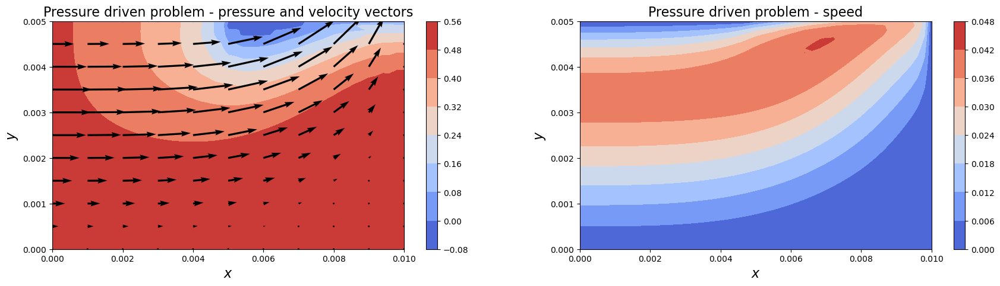

In [6]:
# set up figure
fig = plt.figure(figsize=(21, 5))

# First subplot for pressure and velocity vectors
ax1 = fig.add_subplot(121)
cont = ax1.contourf(X, Y, p, cmap=cm.coolwarm)
fig.colorbar(cont)

ax1.quiver(X[::5, ::5], Y[::5, ::5], u[::5, ::5], v[::5, ::5])
ax1.set_xlim(0, 0.01)
ax1.set_ylim(0, 0.005)
ax1.set_xlabel('$x$', fontsize=16)
ax1.set_ylabel('$y$', fontsize=16)
ax1.set_title('Pressure driven problem - pressure and velocity vectors', fontsize=16)

# Second subplot for speed
ax2 = fig.add_subplot(122)
cont = ax2.contourf(X, Y, np.sqrt(u*u + v*v), cmap=cm.coolwarm)
fig.colorbar(cont)
ax2.set_xlim(0, 0.01)
ax2.set_ylim(0, 0.005)
ax2.set_xlabel('$x$', fontsize=16)
ax2.set_ylabel('$y$', fontsize=16)
ax2.set_title('Pressure driven problem - speed', fontsize=16)

plt.show()


**(B)**:
Convection-diffusion equation:

$ \frac{\partial T}{\partial t} = -\mathbf{v} \cdot \nabla T + k\nabla^2 T $

In the one-dimensional case, this equation simplifies to:

$ \frac{\partial T}{\partial t} = -v \frac{\partial T}{\partial x} + k \frac{\partial^2 T}{\partial x^2} $


In the two-dimensional case, we need to deal with the derivatives of the convection-diffusion equations in two spatial dimensions.

$ \frac{\partial T}{\partial t} = -v_x \frac{\partial T}{\partial x} - v_y \frac{\partial T}{\partial y} + k\left( \frac{\partial^2 T}{\partial x^2} + \frac{\partial^2 T}{\partial y^2} \right) $

We adopt the following finite difference approximation:

Explicit forward differencing of time derivatives:
$ \frac{\partial T}{\partial t} = \frac{T^{n+1}_{i,j} - T^n_{i,j}}{\Delta t} $

For diffusion terms in the $ x $ direction, we use central differences:
$\frac{\partial^2 T}{\partial x^2} = \frac{T^n_{i+1,j} - 2T^n_{i,j} + T^n_{i-1,j}}{\Delta x^2} $

For diffusion terms in the $ y $ direction, we also use central differences:
$ \frac{\partial^2 T}{\partial y^2} = \frac{T^n_{i,j+1} - 2T^n_{i,j} + T^n_{i,j-1}}{\Delta y^2} $

The windward approximation will be determined based on the sign of the velocity vector in each direction:

If $ v_x > 0 $, use backward differencing for the $ x $ direction:
$ \frac{\partial T}{\partial x} = \frac{T^n_{i,j} - T^n_{i-1,j}}{\Delta x} $

If $ v_x < 0 $, use forward differencing for $ x $ direction:
$ \frac{\partial T}{\partial x} = \frac{T^n_{i+1,j} - T^n_{i,j}}{\Delta x} $

If $ v_y > 0 $, use backward differencing for the $ y $ direction:
$ \frac{\partial T}{\partial y} = \frac{T^n_{i,j} - T^n_{i,j-1}}{\Delta y} $

If $ v_y < 0 $, use forward differencing for $ y $ direction:
$ \frac{\partial T}{\partial y} = \frac{T^n_{i,j+1} - T^n_{i,j}}{\Delta y} $

Finally, we get:

$ \frac{T^{n+1}_{i,j} - T^n_{i,j}}{\Delta t} = -v_x \left( \frac{T^n_{i+\delta_x,j} - T^n_{i-\delta_x,j}}{2\Delta x} \right) -v_y \left( \frac{T^n_{i,j+\delta_y} - T^n_{i,j-\delta_y}}{2\Delta y} \right) + k \left( \frac{T^n_{i+1,j} - 2T^n_{i,j} + T^n_{i-1,j}}{\Delta x^2} + \frac{T^n_{i,j+1} - 2T^n_{i,j} + T^n_{i,j-1}}{\Delta y^2} \right) $



### (C) Simulate Temperature Changes

In [7]:
def calculate_temperature_field(T_old, u, v, dx, dy, dt, k):
    """ Calculate the temperature field T at the next time step.
    """
    # Create a copy of the temperature field
    T_new = np.copy(T_old)
    
    # Calculate the temperature field at the next time step

    T_new[1:-1,1:-1] = T_old[1:-1,1:-1] - dt * (
        (u[1:-1, 1:-1] * (T_old[1:-1,1:-1] - T_old[0:-2,1:-1])) / dy +
        (v[1:-1, 1:-1] * (T_old[1:-1,1:-1] - T_old[1:-1,:-2])) / dx
    ) + dt * k * (
        (T_old[2:,1:-1] - 2*T_old[1:-1,1:-1] + T_old[:-2,1:-1]) / dy**2 +
        (T_old[1:-1,2:] - 2*T_old[1:-1,1:-1] + T_old[1:-1,:-2]) / dx**2
    )
    
    # Apply boundary conditions for T
    T_new[int(T_new.shape[1]//2):, -1] = T_old[int(T_new.shape[1]//2):, -2]
    
    return T_new

In [8]:
def solve_NS_with_temperature(u, v, p, T, rho, nu, k, dt, t_end, dx, dy, rtol=1.e-5, logs=False):
    """ Solve the incompressible Navier-Stokes equations with temperature.
    """
    t = 0
    
    u_old = u.copy()
    v_old = v.copy()
    p_RHS = np.zeros_like(u)
    T_old = T.copy()
    
    while t < t_end:
        t += dt
        if logs: print('\nTime = {:.8f}'.format(t))
            
        # calculate intermediate velocities
        u, v = calculate_intermediate_velocity(nu, u, v, u_old, v_old, dt, dx, dy)
        # PPM
        # calculate RHS for the pressure Poisson problem
        p_RHS = calculate_ppm_RHS_central(rho, u, v, p_RHS, dt, dx, dy)
        # compute pressure - note that we use the previous p as an initial guess to the solution
        p = pressure_poisson_jacobi(p, dx, dy, p_RHS, rtol, logs)
        # project velocity
        u, v = project_velocity(rho, u, v, dt, dx, dy, p)
        # calculate temperature
        T = calculate_temperature_field(T_old, u, v, dx, dy, dt, k)
        # Calculate and log the outflow average temperature
        u_out = u[:, -1]  # Velocity at the outlet
        T_out = T[:, -1]  # Temperature at the outlet
        # Avoid division by zero in case of very low outflow velocity
        avg_outflow_temp = np.sum(T_out * u_out) / np.sum(u_out) if np.sum(u_out) != 0 else np.mean(T_out)
        
        if logs:
            print(f'Average outflow temperature at time {t:.8f} is {avg_outflow_temp:.8f} degrees')
        
        # swap pointers without copying data for velocity
        temp = u_old
        u_old = u
        u = temp
        temp = v_old
        v_old = v
        v = temp
        # swap pointers without copying data for temperature
        T_old, T = T, T_old
        
    return u, v, p, T_old


In [9]:
# Initialize the temperature field
T = np.ones((Ny, Nx)) * 20  # Assuming the initial temperature is 20 degrees everywhere
T[:, 0] = 100  # Bottom boundary temperature of 100 degrees
T[-1, :] = 100  # Right boundary temperature of 100 degrees
T[:Nx//2,-1] = 100 # Top boundary (half) temperature of 100 degrees


# Thermal diffusivity
k = 5e-6  # m^2/s

# Start simulation with temperature
start = time.time()
u, v, p, T = solve_NS_with_temperature(u, v, p, T, rho, nu, k, dt, t_end, dx, dy, rtol=1.e-6, logs=True)
end = time.time()
print('Time taken by calculation = ', end - start)



Time = 0.00010000
pressure solve iterations =    1
Average outflow temperature at time 0.00010000 is 60.78431373 degrees

Time = 0.00020000
pressure solve iterations =    1
Average outflow temperature at time 0.00020000 is 60.86274510 degrees

Time = 0.00030000
pressure solve iterations =    1
Average outflow temperature at time 0.00030000 is 60.93736612 degrees

Time = 0.00040000
pressure solve iterations =    1
Average outflow temperature at time 0.00040000 is 61.00950966 degrees

Time = 0.00050000
pressure solve iterations =    1
Average outflow temperature at time 0.00050000 is 61.07935542 degrees

Time = 0.00060000
pressure solve iterations =    1
Average outflow temperature at time 0.00060000 is 61.14708172 degrees

Time = 0.00070000
pressure solve iterations =    1
Average outflow temperature at time 0.00070000 is 61.21285069 degrees

Time = 0.00080000
pressure solve iterations =    1
Average outflow temperature at time 0.00080000 is 61.27680953 degrees

Time = 0.00090000
press

pressure solve iterations =    1
Average outflow temperature at time 0.02640000 is 68.00690343 degrees

Time = 0.02650000
pressure solve iterations =    1
Average outflow temperature at time 0.02650000 is 68.02349011 degrees

Time = 0.02660000
pressure solve iterations =    1
Average outflow temperature at time 0.02660000 is 68.04004823 degrees

Time = 0.02670000
pressure solve iterations =    1
Average outflow temperature at time 0.02670000 is 68.05657794 degrees

Time = 0.02680000
pressure solve iterations =    1
Average outflow temperature at time 0.02680000 is 68.07307939 degrees

Time = 0.02690000
pressure solve iterations =    1
Average outflow temperature at time 0.02690000 is 68.08955272 degrees

Time = 0.02700000
pressure solve iterations =    1
Average outflow temperature at time 0.02700000 is 68.10599809 degrees

Time = 0.02710000
pressure solve iterations =    1
Average outflow temperature at time 0.02710000 is 68.12241563 degrees

Time = 0.02720000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.05250000 is 71.61472739 degrees

Time = 0.05260000
pressure solve iterations =    1
Average outflow temperature at time 0.05260000 is 71.62630145 degrees

Time = 0.05270000
pressure solve iterations =    1
Average outflow temperature at time 0.05270000 is 71.63786066 degrees

Time = 0.05280000
pressure solve iterations =    1
Average outflow temperature at time 0.05280000 is 71.64940504 degrees

Time = 0.05290000
pressure solve iterations =    1
Average outflow temperature at time 0.05290000 is 71.66093460 degrees

Time = 0.05300000
pressure solve iterations =    1
Average outflow temperature at time 0.05300000 is 71.67244936 degrees

Time = 0.05310000
pressure solve iterations =    1
Average outflow temperature at time 0.05310000 is 71.68394932 degrees

Time = 0.05320000
pressure solve iterations =    1
Average outflow temperature at time 0.05320000 is 71.69543452 degrees

Time = 0.05330000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.08040000 is 74.31144702 degrees

Time = 0.08050000
pressure solve iterations =    1
Average outflow temperature at time 0.08050000 is 74.31931843 degrees

Time = 0.08060000
pressure solve iterations =    1
Average outflow temperature at time 0.08060000 is 74.32717782 degrees

Time = 0.08070000
pressure solve iterations =    1
Average outflow temperature at time 0.08070000 is 74.33502518 degrees

Time = 0.08080000
pressure solve iterations =    1
Average outflow temperature at time 0.08080000 is 74.34286054 degrees

Time = 0.08090000
pressure solve iterations =    1
Average outflow temperature at time 0.08090000 is 74.35068390 degrees

Time = 0.08100000
pressure solve iterations =    1
Average outflow temperature at time 0.08100000 is 74.35849526 degrees

Time = 0.08110000
pressure solve iterations =    1
Average outflow temperature at time 0.08110000 is 74.36629463 degrees

Time = 0.08120000
pressure solve iteration

Average outflow temperature at time 0.10790000 is 76.05095648 degrees

Time = 0.10800000
pressure solve iterations =    1
Average outflow temperature at time 0.10800000 is 76.05583601 degrees

Time = 0.10810000
pressure solve iterations =    1
Average outflow temperature at time 0.10810000 is 76.06070596 degrees

Time = 0.10820000
pressure solve iterations =    1
Average outflow temperature at time 0.10820000 is 76.06556632 degrees

Time = 0.10830000
pressure solve iterations =    1
Average outflow temperature at time 0.10830000 is 76.07041711 degrees

Time = 0.10840000
pressure solve iterations =    1
Average outflow temperature at time 0.10840000 is 76.07525835 degrees

Time = 0.10850000
pressure solve iterations =    1
Average outflow temperature at time 0.10850000 is 76.08009004 degrees

Time = 0.10860000
pressure solve iterations =    1
Average outflow temperature at time 0.10860000 is 76.08491219 degrees

Time = 0.10870000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 0.13560000 is 77.07499758 degrees

Time = 0.13570000
pressure solve iterations =    1
Average outflow temperature at time 0.13570000 is 77.07765124 degrees

Time = 0.13580000
pressure solve iterations =    1
Average outflow temperature at time 0.13580000 is 77.08029847 degrees

Time = 0.13590000
pressure solve iterations =    1
Average outflow temperature at time 0.13590000 is 77.08293930 degrees

Time = 0.13600000
pressure solve iterations =    1
Average outflow temperature at time 0.13600000 is 77.08557373 degrees

Time = 0.13610000
pressure solve iterations =    1
Average outflow temperature at time 0.13610000 is 77.08820178 degrees

Time = 0.13620000
pressure solve iterations =    1
Average outflow temperature at time 0.13620000 is 77.09082345 degrees

Time = 0.13630000
pressure solve iterations =    1
Average outflow temperature at time 0.13630000 is 77.09343876 degrees

Time = 0.13640000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.16390000 is 77.61089303 degrees

Time = 0.16400000
pressure solve iterations =    1
Average outflow temperature at time 0.16400000 is 77.61215868 degrees

Time = 0.16410000
pressure solve iterations =    1
Average outflow temperature at time 0.16410000 is 77.61342079 degrees

Time = 0.16420000
pressure solve iterations =    1
Average outflow temperature at time 0.16420000 is 77.61467938 degrees

Time = 0.16430000
pressure solve iterations =    1
Average outflow temperature at time 0.16430000 is 77.61593446 degrees

Time = 0.16440000
pressure solve iterations =    1
Average outflow temperature at time 0.16440000 is 77.61718604 degrees

Time = 0.16450000
pressure solve iterations =    1
Average outflow temperature at time 0.16450000 is 77.61843412 degrees

Time = 0.16460000
pressure solve iterations =    1
Average outflow temperature at time 0.16460000 is 77.61967871 degrees

Time = 0.16470000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.19240000 is 77.85728266 degrees

Time = 0.19250000
pressure solve iterations =    1
Average outflow temperature at time 0.19250000 is 77.85783160 degrees

Time = 0.19260000
pressure solve iterations =    1
Average outflow temperature at time 0.19260000 is 77.85837886 degrees

Time = 0.19270000
pressure solve iterations =    1
Average outflow temperature at time 0.19270000 is 77.85892446 degrees

Time = 0.19280000
pressure solve iterations =    1
Average outflow temperature at time 0.19280000 is 77.85946840 degrees

Time = 0.19290000
pressure solve iterations =    1
Average outflow temperature at time 0.19290000 is 77.86001067 degrees

Time = 0.19300000
pressure solve iterations =    1
Average outflow temperature at time 0.19300000 is 77.86055130 degrees

Time = 0.19310000
pressure solve iterations =    1
Average outflow temperature at time 0.19310000 is 77.86109027 degrees

Time = 0.19320000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.22020000 is 77.95960937 degrees

Time = 0.22030000
pressure solve iterations =    1
Average outflow temperature at time 0.22030000 is 77.95983863 degrees

Time = 0.22040000
pressure solve iterations =    1
Average outflow temperature at time 0.22040000 is 77.96006716 degrees

Time = 0.22050000
pressure solve iterations =    1
Average outflow temperature at time 0.22050000 is 77.96029495 degrees

Time = 0.22060000
pressure solve iterations =    1
Average outflow temperature at time 0.22060000 is 77.96052201 degrees

Time = 0.22070000
pressure solve iterations =    1
Average outflow temperature at time 0.22070000 is 77.96074834 degrees

Time = 0.22080000
pressure solve iterations =    1
Average outflow temperature at time 0.22080000 is 77.96097395 degrees

Time = 0.22090000
pressure solve iterations =    1
Average outflow temperature at time 0.22090000 is 77.96119883 degrees

Time = 0.22100000
pressure solve iteration

Average outflow temperature at time 0.24670000 is 78.00041771 degrees

Time = 0.24680000
pressure solve iterations =    1
Average outflow temperature at time 0.24680000 is 78.00051425 degrees

Time = 0.24690000
pressure solve iterations =    1
Average outflow temperature at time 0.24690000 is 78.00061047 degrees

Time = 0.24700000
pressure solve iterations =    1
Average outflow temperature at time 0.24700000 is 78.00070637 degrees

Time = 0.24710000
pressure solve iterations =    1
Average outflow temperature at time 0.24710000 is 78.00080195 degrees

Time = 0.24720000
pressure solve iterations =    1
Average outflow temperature at time 0.24720000 is 78.00089722 degrees

Time = 0.24730000
pressure solve iterations =    1
Average outflow temperature at time 0.24730000 is 78.00099218 degrees

Time = 0.24740000
pressure solve iterations =    1
Average outflow temperature at time 0.24740000 is 78.00108682 degrees

Time = 0.24750000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 0.27430000 is 78.01790388 degrees

Time = 0.27440000
pressure solve iterations =    1
Average outflow temperature at time 0.27440000 is 78.01794250 degrees

Time = 0.27450000
pressure solve iterations =    1
Average outflow temperature at time 0.27450000 is 78.01798099 degrees

Time = 0.27460000
pressure solve iterations =    1
Average outflow temperature at time 0.27460000 is 78.01801935 degrees

Time = 0.27470000
pressure solve iterations =    1
Average outflow temperature at time 0.27470000 is 78.01805759 degrees

Time = 0.27480000
pressure solve iterations =    1
Average outflow temperature at time 0.27480000 is 78.01809570 degrees

Time = 0.27490000
pressure solve iterations =    1
Average outflow temperature at time 0.27490000 is 78.01813368 degrees

Time = 0.27500000
pressure solve iterations =    1
Average outflow temperature at time 0.27500000 is 78.01817153 degrees

Time = 0.27510000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.30320000 is 78.02509774 degrees

Time = 0.30330000
pressure solve iterations =    1
Average outflow temperature at time 0.30330000 is 78.02511262 degrees

Time = 0.30340000
pressure solve iterations =    1
Average outflow temperature at time 0.30340000 is 78.02512745 degrees

Time = 0.30350000
pressure solve iterations =    1
Average outflow temperature at time 0.30350000 is 78.02514224 degrees

Time = 0.30360000
pressure solve iterations =    1
Average outflow temperature at time 0.30360000 is 78.02515697 degrees

Time = 0.30370000
pressure solve iterations =    1
Average outflow temperature at time 0.30370000 is 78.02517166 degrees

Time = 0.30380000
pressure solve iterations =    1
Average outflow temperature at time 0.30380000 is 78.02518630 degrees

Time = 0.30390000
pressure solve iterations =    1
Average outflow temperature at time 0.30390000 is 78.02520089 degrees

Time = 0.30400000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.33270000 is 78.02794295 degrees

Time = 0.33280000
pressure solve iterations =    1
Average outflow temperature at time 0.33280000 is 78.02794882 degrees

Time = 0.33290000
pressure solve iterations =    1
Average outflow temperature at time 0.33290000 is 78.02795466 degrees

Time = 0.33300000
pressure solve iterations =    1
Average outflow temperature at time 0.33300000 is 78.02796049 degrees

Time = 0.33310000
pressure solve iterations =    1
Average outflow temperature at time 0.33310000 is 78.02796630 degrees

Time = 0.33320000
pressure solve iterations =    1
Average outflow temperature at time 0.33320000 is 78.02797209 degrees

Time = 0.33330000
pressure solve iterations =    1
Average outflow temperature at time 0.33330000 is 78.02797787 degrees

Time = 0.33340000
pressure solve iterations =    1
Average outflow temperature at time 0.33340000 is 78.02798363 degrees

Time = 0.33350000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.36260000 is 78.02911695 degrees

Time = 0.36270000
pressure solve iterations =    1
Average outflow temperature at time 0.36270000 is 78.02911948 degrees

Time = 0.36280000
pressure solve iterations =    1
Average outflow temperature at time 0.36280000 is 78.02912200 degrees

Time = 0.36290000
pressure solve iterations =    1
Average outflow temperature at time 0.36290000 is 78.02912452 degrees

Time = 0.36300000
pressure solve iterations =    1
Average outflow temperature at time 0.36300000 is 78.02912703 degrees

Time = 0.36310000
pressure solve iterations =    1
Average outflow temperature at time 0.36310000 is 78.02912953 degrees

Time = 0.36320000
pressure solve iterations =    1
Average outflow temperature at time 0.36320000 is 78.02913203 degrees

Time = 0.36330000
pressure solve iterations =    1
Average outflow temperature at time 0.36330000 is 78.02913452 degrees

Time = 0.36340000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.39220000 is 78.02965656 degrees

Time = 0.39230000
pressure solve iterations =    1
Average outflow temperature at time 0.39230000 is 78.02965787 degrees

Time = 0.39240000
pressure solve iterations =    1
Average outflow temperature at time 0.39240000 is 78.02965917 degrees

Time = 0.39250000
pressure solve iterations =    1
Average outflow temperature at time 0.39250000 is 78.02966047 degrees

Time = 0.39260000
pressure solve iterations =    1
Average outflow temperature at time 0.39260000 is 78.02966177 degrees

Time = 0.39270000
pressure solve iterations =    1
Average outflow temperature at time 0.39270000 is 78.02966306 degrees

Time = 0.39280000
pressure solve iterations =    1
Average outflow temperature at time 0.39280000 is 78.02966435 degrees

Time = 0.39290000
pressure solve iterations =    1
Average outflow temperature at time 0.39290000 is 78.02966564 degrees

Time = 0.39300000
pressure solve iteration

Average outflow temperature at time 0.42120000 is 78.02995539 degrees

Time = 0.42130000
pressure solve iterations =    1
Average outflow temperature at time 0.42130000 is 78.02995621 degrees

Time = 0.42140000
pressure solve iterations =    1
Average outflow temperature at time 0.42140000 is 78.02995703 degrees

Time = 0.42150000
pressure solve iterations =    1
Average outflow temperature at time 0.42150000 is 78.02995785 degrees

Time = 0.42160000
pressure solve iterations =    1
Average outflow temperature at time 0.42160000 is 78.02995866 degrees

Time = 0.42170000
pressure solve iterations =    1
Average outflow temperature at time 0.42170000 is 78.02995948 degrees

Time = 0.42180000
pressure solve iterations =    1
Average outflow temperature at time 0.42180000 is 78.02996030 degrees

Time = 0.42190000
pressure solve iterations =    1
Average outflow temperature at time 0.42190000 is 78.02996111 degrees

Time = 0.42200000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 0.45140000 is 78.03016432 degrees

Time = 0.45150000
pressure solve iterations =    1
Average outflow temperature at time 0.45150000 is 78.03016491 degrees

Time = 0.45160000
pressure solve iterations =    1
Average outflow temperature at time 0.45160000 is 78.03016550 degrees

Time = 0.45170000
pressure solve iterations =    1
Average outflow temperature at time 0.45170000 is 78.03016608 degrees

Time = 0.45180000
pressure solve iterations =    1
Average outflow temperature at time 0.45180000 is 78.03016667 degrees

Time = 0.45190000
pressure solve iterations =    1
Average outflow temperature at time 0.45190000 is 78.03016726 degrees

Time = 0.45200000
pressure solve iterations =    1
Average outflow temperature at time 0.45200000 is 78.03016784 degrees

Time = 0.45210000
pressure solve iterations =    1
Average outflow temperature at time 0.45210000 is 78.03016842 degrees

Time = 0.45220000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 0.48070000 is 78.03031642 degrees

Time = 0.48080000
pressure solve iterations =    1
Average outflow temperature at time 0.48080000 is 78.03031688 degrees

Time = 0.48090000
pressure solve iterations =    1
Average outflow temperature at time 0.48090000 is 78.03031734 degrees

Time = 0.48100000
pressure solve iterations =    1
Average outflow temperature at time 0.48100000 is 78.03031779 degrees

Time = 0.48110000
pressure solve iterations =    1
Average outflow temperature at time 0.48110000 is 78.03031825 degrees

Time = 0.48120000
pressure solve iterations =    1
Average outflow temperature at time 0.48120000 is 78.03031871 degrees

Time = 0.48130000
pressure solve iterations =    1
Average outflow temperature at time 0.48130000 is 78.03031917 degrees

Time = 0.48140000
pressure solve iterations =    1
Average outflow temperature at time 0.48140000 is 78.03031962 degrees

Time = 0.48150000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.51100000 is 78.03044089 degrees

Time = 0.51110000
pressure solve iterations =    1
Average outflow temperature at time 0.51110000 is 78.03044126 degrees

Time = 0.51120000
pressure solve iterations =    1
Average outflow temperature at time 0.51120000 is 78.03044163 degrees

Time = 0.51130000
pressure solve iterations =    1
Average outflow temperature at time 0.51130000 is 78.03044199 degrees

Time = 0.51140000
pressure solve iterations =    1
Average outflow temperature at time 0.51140000 is 78.03044236 degrees

Time = 0.51150000
pressure solve iterations =    1
Average outflow temperature at time 0.51150000 is 78.03044272 degrees

Time = 0.51160000
pressure solve iterations =    1
Average outflow temperature at time 0.51160000 is 78.03044309 degrees

Time = 0.51170000
pressure solve iterations =    1
Average outflow temperature at time 0.51170000 is 78.03044345 degrees

Time = 0.51180000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.54030000 is 78.03053775 degrees

Time = 0.54040000
pressure solve iterations =    1
Average outflow temperature at time 0.54040000 is 78.03053804 degrees

Time = 0.54050000
pressure solve iterations =    1
Average outflow temperature at time 0.54050000 is 78.03053834 degrees

Time = 0.54060000
pressure solve iterations =    1
Average outflow temperature at time 0.54060000 is 78.03053864 degrees

Time = 0.54070000
pressure solve iterations =    1
Average outflow temperature at time 0.54070000 is 78.03053893 degrees

Time = 0.54080000
pressure solve iterations =    1
Average outflow temperature at time 0.54080000 is 78.03053923 degrees

Time = 0.54090000
pressure solve iterations =    1
Average outflow temperature at time 0.54090000 is 78.03053952 degrees

Time = 0.54100000
pressure solve iterations =    1
Average outflow temperature at time 0.54100000 is 78.03053982 degrees

Time = 0.54110000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.56950000 is 78.03061581 degrees

Time = 0.56960000
pressure solve iterations =    1
Average outflow temperature at time 0.56960000 is 78.03061605 degrees

Time = 0.56970000
pressure solve iterations =    1
Average outflow temperature at time 0.56970000 is 78.03061629 degrees

Time = 0.56980000
pressure solve iterations =    1
Average outflow temperature at time 0.56980000 is 78.03061653 degrees

Time = 0.56990000
pressure solve iterations =    1
Average outflow temperature at time 0.56990000 is 78.03061676 degrees

Time = 0.57000000
pressure solve iterations =    1
Average outflow temperature at time 0.57000000 is 78.03061700 degrees

Time = 0.57010000
pressure solve iterations =    1
Average outflow temperature at time 0.57010000 is 78.03061724 degrees

Time = 0.57020000
pressure solve iterations =    1
Average outflow temperature at time 0.57020000 is 78.03061748 degrees

Time = 0.57030000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.59910000 is 78.03067944 degrees

Time = 0.59920000
pressure solve iterations =    1
Average outflow temperature at time 0.59920000 is 78.03067963 degrees

Time = 0.59930000
pressure solve iterations =    1
Average outflow temperature at time 0.59930000 is 78.03067982 degrees

Time = 0.59940000
pressure solve iterations =    1
Average outflow temperature at time 0.59940000 is 78.03068001 degrees

Time = 0.59950000
pressure solve iterations =    1
Average outflow temperature at time 0.59950000 is 78.03068020 degrees

Time = 0.59960000
pressure solve iterations =    1
Average outflow temperature at time 0.59960000 is 78.03068039 degrees

Time = 0.59970000
pressure solve iterations =    1
Average outflow temperature at time 0.59970000 is 78.03068058 degrees

Time = 0.59980000
pressure solve iterations =    1
Average outflow temperature at time 0.59980000 is 78.03068077 degrees

Time = 0.59990000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.62790000 is 78.03072898 degrees

Time = 0.62800000
pressure solve iterations =    1
Average outflow temperature at time 0.62800000 is 78.03072913 degrees

Time = 0.62810000
pressure solve iterations =    1
Average outflow temperature at time 0.62810000 is 78.03072928 degrees

Time = 0.62820000
pressure solve iterations =    1
Average outflow temperature at time 0.62820000 is 78.03072944 degrees

Time = 0.62830000
pressure solve iterations =    1
Average outflow temperature at time 0.62830000 is 78.03072959 degrees

Time = 0.62840000
pressure solve iterations =    1
Average outflow temperature at time 0.62840000 is 78.03072974 degrees

Time = 0.62850000
pressure solve iterations =    1
Average outflow temperature at time 0.62850000 is 78.03072990 degrees

Time = 0.62860000
pressure solve iterations =    1
Average outflow temperature at time 0.62860000 is 78.03073005 degrees

Time = 0.62870000
pressure solve iteration

Average outflow temperature at time 0.65710000 is 78.03076901 degrees

Time = 0.65720000
pressure solve iterations =    1
Average outflow temperature at time 0.65720000 is 78.03076913 degrees

Time = 0.65730000
pressure solve iterations =    1
Average outflow temperature at time 0.65730000 is 78.03076925 degrees

Time = 0.65740000
pressure solve iterations =    1
Average outflow temperature at time 0.65740000 is 78.03076937 degrees

Time = 0.65750000
pressure solve iterations =    1
Average outflow temperature at time 0.65750000 is 78.03076949 degrees

Time = 0.65760000
pressure solve iterations =    1
Average outflow temperature at time 0.65760000 is 78.03076962 degrees

Time = 0.65770000
pressure solve iterations =    1
Average outflow temperature at time 0.65770000 is 78.03076974 degrees

Time = 0.65780000
pressure solve iterations =    1
Average outflow temperature at time 0.65780000 is 78.03076986 degrees

Time = 0.65790000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 0.68560000 is 78.03080002 degrees

Time = 0.68570000
pressure solve iterations =    1
Average outflow temperature at time 0.68570000 is 78.03080012 degrees

Time = 0.68580000
pressure solve iterations =    1
Average outflow temperature at time 0.68580000 is 78.03080022 degrees

Time = 0.68590000
pressure solve iterations =    1
Average outflow temperature at time 0.68590000 is 78.03080031 degrees

Time = 0.68600000
pressure solve iterations =    1
Average outflow temperature at time 0.68600000 is 78.03080041 degrees

Time = 0.68610000
pressure solve iterations =    1
Average outflow temperature at time 0.68610000 is 78.03080051 degrees

Time = 0.68620000
pressure solve iterations =    1
Average outflow temperature at time 0.68620000 is 78.03080060 degrees

Time = 0.68630000
pressure solve iterations =    1
Average outflow temperature at time 0.68630000 is 78.03080070 degrees

Time = 0.68640000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.71360000 is 78.03082423 degrees

Time = 0.71370000
pressure solve iterations =    1
Average outflow temperature at time 0.71370000 is 78.03082431 degrees

Time = 0.71380000
pressure solve iterations =    1
Average outflow temperature at time 0.71380000 is 78.03082439 degrees

Time = 0.71390000
pressure solve iterations =    1
Average outflow temperature at time 0.71390000 is 78.03082446 degrees

Time = 0.71400000
pressure solve iterations =    1
Average outflow temperature at time 0.71400000 is 78.03082454 degrees

Time = 0.71410000
pressure solve iterations =    1
Average outflow temperature at time 0.71410000 is 78.03082462 degrees

Time = 0.71420000
pressure solve iterations =    1
Average outflow temperature at time 0.71420000 is 78.03082469 degrees

Time = 0.71430000
pressure solve iterations =    1
Average outflow temperature at time 0.71430000 is 78.03082477 degrees

Time = 0.71440000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.74260000 is 78.03084405 degrees

Time = 0.74270000
pressure solve iterations =    1
Average outflow temperature at time 0.74270000 is 78.03084411 degrees

Time = 0.74280000
pressure solve iterations =    1
Average outflow temperature at time 0.74280000 is 78.03084417 degrees

Time = 0.74290000
pressure solve iterations =    1
Average outflow temperature at time 0.74290000 is 78.03084423 degrees

Time = 0.74300000
pressure solve iterations =    1
Average outflow temperature at time 0.74300000 is 78.03084429 degrees

Time = 0.74310000
pressure solve iterations =    1
Average outflow temperature at time 0.74310000 is 78.03084435 degrees

Time = 0.74320000
pressure solve iterations =    1
Average outflow temperature at time 0.74320000 is 78.03084441 degrees

Time = 0.74330000
pressure solve iterations =    1
Average outflow temperature at time 0.74330000 is 78.03084447 degrees

Time = 0.74340000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.77150000 is 78.03085956 degrees

Time = 0.77160000
pressure solve iterations =    1
Average outflow temperature at time 0.77160000 is 78.03085961 degrees

Time = 0.77170000
pressure solve iterations =    1
Average outflow temperature at time 0.77170000 is 78.03085965 degrees

Time = 0.77180000
pressure solve iterations =    1
Average outflow temperature at time 0.77180000 is 78.03085970 degrees

Time = 0.77190000
pressure solve iterations =    1
Average outflow temperature at time 0.77190000 is 78.03085975 degrees

Time = 0.77200000
pressure solve iterations =    1
Average outflow temperature at time 0.77200000 is 78.03085980 degrees

Time = 0.77210000
pressure solve iterations =    1
Average outflow temperature at time 0.77210000 is 78.03085984 degrees

Time = 0.77220000
pressure solve iterations =    1
Average outflow temperature at time 0.77220000 is 78.03085989 degrees

Time = 0.77230000
pressure solve iteration

Average outflow temperature at time 0.80030000 is 78.03087168 degrees

Time = 0.80040000
pressure solve iterations =    1
Average outflow temperature at time 0.80040000 is 78.03087172 degrees

Time = 0.80050000
pressure solve iterations =    1
Average outflow temperature at time 0.80050000 is 78.03087175 degrees

Time = 0.80060000
pressure solve iterations =    1
Average outflow temperature at time 0.80060000 is 78.03087179 degrees

Time = 0.80070000
pressure solve iterations =    1
Average outflow temperature at time 0.80070000 is 78.03087183 degrees

Time = 0.80080000
pressure solve iterations =    1
Average outflow temperature at time 0.80080000 is 78.03087187 degrees

Time = 0.80090000
pressure solve iterations =    1
Average outflow temperature at time 0.80090000 is 78.03087190 degrees

Time = 0.80100000
pressure solve iterations =    1
Average outflow temperature at time 0.80100000 is 78.03087194 degrees

Time = 0.80110000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 0.82930000 is 78.03088123 degrees

Time = 0.82940000
pressure solve iterations =    1
Average outflow temperature at time 0.82940000 is 78.03088126 degrees

Time = 0.82950000
pressure solve iterations =    1
Average outflow temperature at time 0.82950000 is 78.03088129 degrees

Time = 0.82960000
pressure solve iterations =    1
Average outflow temperature at time 0.82960000 is 78.03088132 degrees

Time = 0.82970000
pressure solve iterations =    1
Average outflow temperature at time 0.82970000 is 78.03088135 degrees

Time = 0.82980000
pressure solve iterations =    1
Average outflow temperature at time 0.82980000 is 78.03088138 degrees

Time = 0.82990000
pressure solve iterations =    1
Average outflow temperature at time 0.82990000 is 78.03088141 degrees

Time = 0.83000000
pressure solve iterations =    1
Average outflow temperature at time 0.83000000 is 78.03088144 degrees

Time = 0.83010000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 0.85800000 is 78.03088863 degrees

Time = 0.85810000
pressure solve iterations =    1
Average outflow temperature at time 0.85810000 is 78.03088865 degrees

Time = 0.85820000
pressure solve iterations =    1
Average outflow temperature at time 0.85820000 is 78.03088867 degrees

Time = 0.85830000
pressure solve iterations =    1
Average outflow temperature at time 0.85830000 is 78.03088869 degrees

Time = 0.85840000
pressure solve iterations =    1
Average outflow temperature at time 0.85840000 is 78.03088872 degrees

Time = 0.85850000
pressure solve iterations =    1
Average outflow temperature at time 0.85850000 is 78.03088874 degrees

Time = 0.85860000
pressure solve iterations =    1
Average outflow temperature at time 0.85860000 is 78.03088876 degrees

Time = 0.85870000
pressure solve iterations =    1
Average outflow temperature at time 0.85870000 is 78.03088878 degrees

Time = 0.85880000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 0.88460000 is 78.03089403 degrees

Time = 0.88470000
pressure solve iterations =    1
Average outflow temperature at time 0.88470000 is 78.03089405 degrees

Time = 0.88480000
pressure solve iterations =    1
Average outflow temperature at time 0.88480000 is 78.03089407 degrees

Time = 0.88490000
pressure solve iterations =    1
Average outflow temperature at time 0.88490000 is 78.03089409 degrees

Time = 0.88500000
pressure solve iterations =    1
Average outflow temperature at time 0.88500000 is 78.03089410 degrees

Time = 0.88510000
pressure solve iterations =    1
Average outflow temperature at time 0.88510000 is 78.03089412 degrees

Time = 0.88520000
pressure solve iterations =    1
Average outflow temperature at time 0.88520000 is 78.03089414 degrees

Time = 0.88530000
pressure solve iterations =    1
Average outflow temperature at time 0.88530000 is 78.03089416 degrees

Time = 0.88540000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 0.91340000 is 78.03089865 degrees

Time = 0.91350000
pressure solve iterations =    1
Average outflow temperature at time 0.91350000 is 78.03089866 degrees

Time = 0.91360000
pressure solve iterations =    1
Average outflow temperature at time 0.91360000 is 78.03089868 degrees

Time = 0.91370000
pressure solve iterations =    1
Average outflow temperature at time 0.91370000 is 78.03089869 degrees

Time = 0.91380000
pressure solve iterations =    1
Average outflow temperature at time 0.91380000 is 78.03089870 degrees

Time = 0.91390000
pressure solve iterations =    1
Average outflow temperature at time 0.91390000 is 78.03089872 degrees

Time = 0.91400000
pressure solve iterations =    1
Average outflow temperature at time 0.91400000 is 78.03089873 degrees

Time = 0.91410000
pressure solve iterations =    1
Average outflow temperature at time 0.91410000 is 78.03089875 degrees

Time = 0.91420000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.94090000 is 78.03090211 degrees

Time = 0.94100000
pressure solve iterations =    1
Average outflow temperature at time 0.94100000 is 78.03090212 degrees

Time = 0.94110000
pressure solve iterations =    1
Average outflow temperature at time 0.94110000 is 78.03090213 degrees

Time = 0.94120000
pressure solve iterations =    1
Average outflow temperature at time 0.94120000 is 78.03090214 degrees

Time = 0.94130000
pressure solve iterations =    1
Average outflow temperature at time 0.94130000 is 78.03090215 degrees

Time = 0.94140000
pressure solve iterations =    1
Average outflow temperature at time 0.94140000 is 78.03090216 degrees

Time = 0.94150000
pressure solve iterations =    1
Average outflow temperature at time 0.94150000 is 78.03090217 degrees

Time = 0.94160000
pressure solve iterations =    1
Average outflow temperature at time 0.94160000 is 78.03090218 degrees

Time = 0.94170000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.97030000 is 78.03090500 degrees

Time = 0.97040000
pressure solve iterations =    1
Average outflow temperature at time 0.97040000 is 78.03090501 degrees

Time = 0.97050000
pressure solve iterations =    1
Average outflow temperature at time 0.97050000 is 78.03090502 degrees

Time = 0.97060000
pressure solve iterations =    1
Average outflow temperature at time 0.97060000 is 78.03090503 degrees

Time = 0.97070000
pressure solve iterations =    1
Average outflow temperature at time 0.97070000 is 78.03090504 degrees

Time = 0.97080000
pressure solve iterations =    1
Average outflow temperature at time 0.97080000 is 78.03090504 degrees

Time = 0.97090000
pressure solve iterations =    1
Average outflow temperature at time 0.97090000 is 78.03090505 degrees

Time = 0.97100000
pressure solve iterations =    1
Average outflow temperature at time 0.97100000 is 78.03090506 degrees

Time = 0.97110000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 0.99770000 is 78.03090711 degrees

Time = 0.99780000
pressure solve iterations =    1
Average outflow temperature at time 0.99780000 is 78.03090712 degrees

Time = 0.99790000
pressure solve iterations =    1
Average outflow temperature at time 0.99790000 is 78.03090712 degrees

Time = 0.99800000
pressure solve iterations =    1
Average outflow temperature at time 0.99800000 is 78.03090713 degrees

Time = 0.99810000
pressure solve iterations =    1
Average outflow temperature at time 0.99810000 is 78.03090714 degrees

Time = 0.99820000
pressure solve iterations =    1
Average outflow temperature at time 0.99820000 is 78.03090715 degrees

Time = 0.99830000
pressure solve iterations =    1
Average outflow temperature at time 0.99830000 is 78.03090715 degrees

Time = 0.99840000
pressure solve iterations =    1
Average outflow temperature at time 0.99840000 is 78.03090716 degrees

Time = 0.99850000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.02510000 is 78.03090878 degrees

Time = 1.02520000
pressure solve iterations =    1
Average outflow temperature at time 1.02520000 is 78.03090878 degrees

Time = 1.02530000
pressure solve iterations =    1
Average outflow temperature at time 1.02530000 is 78.03090879 degrees

Time = 1.02540000
pressure solve iterations =    1
Average outflow temperature at time 1.02540000 is 78.03090879 degrees

Time = 1.02550000
pressure solve iterations =    1
Average outflow temperature at time 1.02550000 is 78.03090880 degrees

Time = 1.02560000
pressure solve iterations =    1
Average outflow temperature at time 1.02560000 is 78.03090880 degrees

Time = 1.02570000
pressure solve iterations =    1
Average outflow temperature at time 1.02570000 is 78.03090881 degrees

Time = 1.02580000
pressure solve iterations =    1
Average outflow temperature at time 1.02580000 is 78.03090881 degrees

Time = 1.02590000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.05130000 is 78.03091004 degrees

Time = 1.05140000
pressure solve iterations =    1
Average outflow temperature at time 1.05140000 is 78.03091004 degrees

Time = 1.05150000
pressure solve iterations =    1
Average outflow temperature at time 1.05150000 is 78.03091005 degrees

Time = 1.05160000
pressure solve iterations =    1
Average outflow temperature at time 1.05160000 is 78.03091005 degrees

Time = 1.05170000
pressure solve iterations =    1
Average outflow temperature at time 1.05170000 is 78.03091006 degrees

Time = 1.05180000
pressure solve iterations =    1
Average outflow temperature at time 1.05180000 is 78.03091006 degrees

Time = 1.05190000
pressure solve iterations =    1
Average outflow temperature at time 1.05190000 is 78.03091006 degrees

Time = 1.05200000
pressure solve iterations =    1
Average outflow temperature at time 1.05200000 is 78.03091007 degrees

Time = 1.05210000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.07910000 is 78.03091110 degrees

Time = 1.07920000
pressure solve iterations =    1
Average outflow temperature at time 1.07920000 is 78.03091110 degrees

Time = 1.07930000
pressure solve iterations =    1
Average outflow temperature at time 1.07930000 is 78.03091111 degrees

Time = 1.07940000
pressure solve iterations =    1
Average outflow temperature at time 1.07940000 is 78.03091111 degrees

Time = 1.07950000
pressure solve iterations =    1
Average outflow temperature at time 1.07950000 is 78.03091111 degrees

Time = 1.07960000
pressure solve iterations =    1
Average outflow temperature at time 1.07960000 is 78.03091112 degrees

Time = 1.07970000
pressure solve iterations =    1
Average outflow temperature at time 1.07970000 is 78.03091112 degrees

Time = 1.07980000
pressure solve iterations =    1
Average outflow temperature at time 1.07980000 is 78.03091112 degrees

Time = 1.07990000
pressure solve iteration

Average outflow temperature at time 1.10730000 is 78.03091194 degrees

Time = 1.10740000
pressure solve iterations =    1
Average outflow temperature at time 1.10740000 is 78.03091195 degrees

Time = 1.10750000
pressure solve iterations =    1
Average outflow temperature at time 1.10750000 is 78.03091195 degrees

Time = 1.10760000
pressure solve iterations =    1
Average outflow temperature at time 1.10760000 is 78.03091195 degrees

Time = 1.10770000
pressure solve iterations =    1
Average outflow temperature at time 1.10770000 is 78.03091195 degrees

Time = 1.10780000
pressure solve iterations =    1
Average outflow temperature at time 1.10780000 is 78.03091196 degrees

Time = 1.10790000
pressure solve iterations =    1
Average outflow temperature at time 1.10790000 is 78.03091196 degrees

Time = 1.10800000
pressure solve iterations =    1
Average outflow temperature at time 1.10800000 is 78.03091196 degrees

Time = 1.10810000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 1.13560000 is 78.03091261 degrees

Time = 1.13570000
pressure solve iterations =    1
Average outflow temperature at time 1.13570000 is 78.03091261 degrees

Time = 1.13580000
pressure solve iterations =    1
Average outflow temperature at time 1.13580000 is 78.03091261 degrees

Time = 1.13590000
pressure solve iterations =    1
Average outflow temperature at time 1.13590000 is 78.03091261 degrees

Time = 1.13600000
pressure solve iterations =    1
Average outflow temperature at time 1.13600000 is 78.03091262 degrees

Time = 1.13610000
pressure solve iterations =    1
Average outflow temperature at time 1.13610000 is 78.03091262 degrees

Time = 1.13620000
pressure solve iterations =    1
Average outflow temperature at time 1.13620000 is 78.03091262 degrees

Time = 1.13630000
pressure solve iterations =    1
Average outflow temperature at time 1.13630000 is 78.03091262 degrees

Time = 1.13640000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.16250000 is 78.03091310 degrees

Time = 1.16260000
pressure solve iterations =    1
Average outflow temperature at time 1.16260000 is 78.03091310 degrees

Time = 1.16270000
pressure solve iterations =    1
Average outflow temperature at time 1.16270000 is 78.03091311 degrees

Time = 1.16280000
pressure solve iterations =    1
Average outflow temperature at time 1.16280000 is 78.03091311 degrees

Time = 1.16290000
pressure solve iterations =    1
Average outflow temperature at time 1.16290000 is 78.03091311 degrees

Time = 1.16300000
pressure solve iterations =    1
Average outflow temperature at time 1.16300000 is 78.03091311 degrees

Time = 1.16310000
pressure solve iterations =    1
Average outflow temperature at time 1.16310000 is 78.03091311 degrees

Time = 1.16320000
pressure solve iterations =    1
Average outflow temperature at time 1.16320000 is 78.03091311 degrees

Time = 1.16330000
pressure solve iteration

Average outflow temperature at time 1.19030000 is 78.03091351 degrees

Time = 1.19040000
pressure solve iterations =    1
Average outflow temperature at time 1.19040000 is 78.03091351 degrees

Time = 1.19050000
pressure solve iterations =    1
Average outflow temperature at time 1.19050000 is 78.03091351 degrees

Time = 1.19060000
pressure solve iterations =    1
Average outflow temperature at time 1.19060000 is 78.03091351 degrees

Time = 1.19070000
pressure solve iterations =    1
Average outflow temperature at time 1.19070000 is 78.03091351 degrees

Time = 1.19080000
pressure solve iterations =    1
Average outflow temperature at time 1.19080000 is 78.03091351 degrees

Time = 1.19090000
pressure solve iterations =    1
Average outflow temperature at time 1.19090000 is 78.03091352 degrees

Time = 1.19100000
pressure solve iterations =    1
Average outflow temperature at time 1.19100000 is 78.03091352 degrees

Time = 1.19110000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 1.21830000 is 78.03091383 degrees

Time = 1.21840000
pressure solve iterations =    1
Average outflow temperature at time 1.21840000 is 78.03091383 degrees

Time = 1.21850000
pressure solve iterations =    1
Average outflow temperature at time 1.21850000 is 78.03091383 degrees

Time = 1.21860000
pressure solve iterations =    1
Average outflow temperature at time 1.21860000 is 78.03091383 degrees

Time = 1.21870000
pressure solve iterations =    1
Average outflow temperature at time 1.21870000 is 78.03091383 degrees

Time = 1.21880000
pressure solve iterations =    1
Average outflow temperature at time 1.21880000 is 78.03091383 degrees

Time = 1.21890000
pressure solve iterations =    1
Average outflow temperature at time 1.21890000 is 78.03091383 degrees

Time = 1.21900000
pressure solve iterations =    1
Average outflow temperature at time 1.21900000 is 78.03091383 degrees

Time = 1.21910000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.24490000 is 78.03091407 degrees

Time = 1.24500000
pressure solve iterations =    1
Average outflow temperature at time 1.24500000 is 78.03091407 degrees

Time = 1.24510000
pressure solve iterations =    1
Average outflow temperature at time 1.24510000 is 78.03091407 degrees

Time = 1.24520000
pressure solve iterations =    1
Average outflow temperature at time 1.24520000 is 78.03091407 degrees

Time = 1.24530000
pressure solve iterations =    1
Average outflow temperature at time 1.24530000 is 78.03091407 degrees

Time = 1.24540000
pressure solve iterations =    1
Average outflow temperature at time 1.24540000 is 78.03091407 degrees

Time = 1.24550000
pressure solve iterations =    1
Average outflow temperature at time 1.24550000 is 78.03091407 degrees

Time = 1.24560000
pressure solve iterations =    1
Average outflow temperature at time 1.24560000 is 78.03091407 degrees

Time = 1.24570000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.27450000 is 78.03091428 degrees

Time = 1.27460000
pressure solve iterations =    1
Average outflow temperature at time 1.27460000 is 78.03091428 degrees

Time = 1.27470000
pressure solve iterations =    1
Average outflow temperature at time 1.27470000 is 78.03091428 degrees

Time = 1.27480000
pressure solve iterations =    1
Average outflow temperature at time 1.27480000 is 78.03091428 degrees

Time = 1.27490000
pressure solve iterations =    1
Average outflow temperature at time 1.27490000 is 78.03091428 degrees

Time = 1.27500000
pressure solve iterations =    1
Average outflow temperature at time 1.27500000 is 78.03091428 degrees

Time = 1.27510000
pressure solve iterations =    1
Average outflow temperature at time 1.27510000 is 78.03091428 degrees

Time = 1.27520000
pressure solve iterations =    1
Average outflow temperature at time 1.27520000 is 78.03091428 degrees

Time = 1.27530000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.30340000 is 78.03091444 degrees

Time = 1.30350000
pressure solve iterations =    1
Average outflow temperature at time 1.30350000 is 78.03091444 degrees

Time = 1.30360000
pressure solve iterations =    1
Average outflow temperature at time 1.30360000 is 78.03091444 degrees

Time = 1.30370000
pressure solve iterations =    1
Average outflow temperature at time 1.30370000 is 78.03091444 degrees

Time = 1.30380000
pressure solve iterations =    1
Average outflow temperature at time 1.30380000 is 78.03091444 degrees

Time = 1.30390000
pressure solve iterations =    1
Average outflow temperature at time 1.30390000 is 78.03091444 degrees

Time = 1.30400000
pressure solve iterations =    1
Average outflow temperature at time 1.30400000 is 78.03091444 degrees

Time = 1.30410000
pressure solve iterations =    1
Average outflow temperature at time 1.30410000 is 78.03091444 degrees

Time = 1.30420000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.33250000 is 78.03091456 degrees

Time = 1.33260000
pressure solve iterations =    1
Average outflow temperature at time 1.33260000 is 78.03091456 degrees

Time = 1.33270000
pressure solve iterations =    1
Average outflow temperature at time 1.33270000 is 78.03091456 degrees

Time = 1.33280000
pressure solve iterations =    1
Average outflow temperature at time 1.33280000 is 78.03091456 degrees

Time = 1.33290000
pressure solve iterations =    1
Average outflow temperature at time 1.33290000 is 78.03091456 degrees

Time = 1.33300000
pressure solve iterations =    1
Average outflow temperature at time 1.33300000 is 78.03091456 degrees

Time = 1.33310000
pressure solve iterations =    1
Average outflow temperature at time 1.33310000 is 78.03091456 degrees

Time = 1.33320000
pressure solve iterations =    1
Average outflow temperature at time 1.33320000 is 78.03091456 degrees

Time = 1.33330000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.36160000 is 78.03091466 degrees

Time = 1.36170000
pressure solve iterations =    1
Average outflow temperature at time 1.36170000 is 78.03091466 degrees

Time = 1.36180000
pressure solve iterations =    1
Average outflow temperature at time 1.36180000 is 78.03091466 degrees

Time = 1.36190000
pressure solve iterations =    1
Average outflow temperature at time 1.36190000 is 78.03091466 degrees

Time = 1.36200000
pressure solve iterations =    1
Average outflow temperature at time 1.36200000 is 78.03091466 degrees

Time = 1.36210000
pressure solve iterations =    1
Average outflow temperature at time 1.36210000 is 78.03091466 degrees

Time = 1.36220000
pressure solve iterations =    1
Average outflow temperature at time 1.36220000 is 78.03091466 degrees

Time = 1.36230000
pressure solve iterations =    1
Average outflow temperature at time 1.36230000 is 78.03091466 degrees

Time = 1.36240000
pressure solve iteration

Average outflow temperature at time 1.39080000 is 78.03091473 degrees

Time = 1.39090000
pressure solve iterations =    1
Average outflow temperature at time 1.39090000 is 78.03091473 degrees

Time = 1.39100000
pressure solve iterations =    1
Average outflow temperature at time 1.39100000 is 78.03091473 degrees

Time = 1.39110000
pressure solve iterations =    1
Average outflow temperature at time 1.39110000 is 78.03091473 degrees

Time = 1.39120000
pressure solve iterations =    1
Average outflow temperature at time 1.39120000 is 78.03091473 degrees

Time = 1.39130000
pressure solve iterations =    1
Average outflow temperature at time 1.39130000 is 78.03091473 degrees

Time = 1.39140000
pressure solve iterations =    1
Average outflow temperature at time 1.39140000 is 78.03091473 degrees

Time = 1.39150000
pressure solve iterations =    1
Average outflow temperature at time 1.39150000 is 78.03091473 degrees

Time = 1.39160000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 1.42040000 is 78.03091479 degrees

Time = 1.42050000
pressure solve iterations =    1
Average outflow temperature at time 1.42050000 is 78.03091479 degrees

Time = 1.42060000
pressure solve iterations =    1
Average outflow temperature at time 1.42060000 is 78.03091479 degrees

Time = 1.42070000
pressure solve iterations =    1
Average outflow temperature at time 1.42070000 is 78.03091479 degrees

Time = 1.42080000
pressure solve iterations =    1
Average outflow temperature at time 1.42080000 is 78.03091479 degrees

Time = 1.42090000
pressure solve iterations =    1
Average outflow temperature at time 1.42090000 is 78.03091479 degrees

Time = 1.42100000
pressure solve iterations =    1
Average outflow temperature at time 1.42100000 is 78.03091479 degrees

Time = 1.42110000
pressure solve iterations =    1
Average outflow temperature at time 1.42110000 is 78.03091479 degrees

Time = 1.42120000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.44960000 is 78.03091484 degrees

Time = 1.44970000
pressure solve iterations =    1
Average outflow temperature at time 1.44970000 is 78.03091484 degrees

Time = 1.44980000
pressure solve iterations =    1
Average outflow temperature at time 1.44980000 is 78.03091484 degrees

Time = 1.44990000
pressure solve iterations =    1
Average outflow temperature at time 1.44990000 is 78.03091484 degrees

Time = 1.45000000
pressure solve iterations =    1
Average outflow temperature at time 1.45000000 is 78.03091484 degrees

Time = 1.45010000
pressure solve iterations =    1
Average outflow temperature at time 1.45010000 is 78.03091484 degrees

Time = 1.45020000
pressure solve iterations =    1
Average outflow temperature at time 1.45020000 is 78.03091484 degrees

Time = 1.45030000
pressure solve iterations =    1
Average outflow temperature at time 1.45030000 is 78.03091484 degrees

Time = 1.45040000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.47900000 is 78.03091487 degrees

Time = 1.47910000
pressure solve iterations =    1
Average outflow temperature at time 1.47910000 is 78.03091487 degrees

Time = 1.47920000
pressure solve iterations =    1
Average outflow temperature at time 1.47920000 is 78.03091487 degrees

Time = 1.47930000
pressure solve iterations =    1
Average outflow temperature at time 1.47930000 is 78.03091487 degrees

Time = 1.47940000
pressure solve iterations =    1
Average outflow temperature at time 1.47940000 is 78.03091487 degrees

Time = 1.47950000
pressure solve iterations =    1
Average outflow temperature at time 1.47950000 is 78.03091487 degrees

Time = 1.47960000
pressure solve iterations =    1
Average outflow temperature at time 1.47960000 is 78.03091487 degrees

Time = 1.47970000
pressure solve iterations =    1
Average outflow temperature at time 1.47970000 is 78.03091487 degrees

Time = 1.47980000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.50800000 is 78.03091490 degrees

Time = 1.50810000
pressure solve iterations =    1
Average outflow temperature at time 1.50810000 is 78.03091490 degrees

Time = 1.50820000
pressure solve iterations =    1
Average outflow temperature at time 1.50820000 is 78.03091490 degrees

Time = 1.50830000
pressure solve iterations =    1
Average outflow temperature at time 1.50830000 is 78.03091490 degrees

Time = 1.50840000
pressure solve iterations =    1
Average outflow temperature at time 1.50840000 is 78.03091490 degrees

Time = 1.50850000
pressure solve iterations =    1
Average outflow temperature at time 1.50850000 is 78.03091490 degrees

Time = 1.50860000
pressure solve iterations =    1
Average outflow temperature at time 1.50860000 is 78.03091490 degrees

Time = 1.50870000
pressure solve iterations =    1
Average outflow temperature at time 1.50870000 is 78.03091490 degrees

Time = 1.50880000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.53720000 is 78.03091492 degrees

Time = 1.53730000
pressure solve iterations =    1
Average outflow temperature at time 1.53730000 is 78.03091492 degrees

Time = 1.53740000
pressure solve iterations =    1
Average outflow temperature at time 1.53740000 is 78.03091492 degrees

Time = 1.53750000
pressure solve iterations =    1
Average outflow temperature at time 1.53750000 is 78.03091492 degrees

Time = 1.53760000
pressure solve iterations =    1
Average outflow temperature at time 1.53760000 is 78.03091492 degrees

Time = 1.53770000
pressure solve iterations =    1
Average outflow temperature at time 1.53770000 is 78.03091492 degrees

Time = 1.53780000
pressure solve iterations =    1
Average outflow temperature at time 1.53780000 is 78.03091492 degrees

Time = 1.53790000
pressure solve iterations =    1
Average outflow temperature at time 1.53790000 is 78.03091492 degrees

Time = 1.53800000
pressure solve iteration

Average outflow temperature at time 1.56570000 is 78.03091494 degrees

Time = 1.56580000
pressure solve iterations =    1
Average outflow temperature at time 1.56580000 is 78.03091494 degrees

Time = 1.56590000
pressure solve iterations =    1
Average outflow temperature at time 1.56590000 is 78.03091494 degrees

Time = 1.56600000
pressure solve iterations =    1
Average outflow temperature at time 1.56600000 is 78.03091494 degrees

Time = 1.56610000
pressure solve iterations =    1
Average outflow temperature at time 1.56610000 is 78.03091494 degrees

Time = 1.56620000
pressure solve iterations =    1
Average outflow temperature at time 1.56620000 is 78.03091494 degrees

Time = 1.56630000
pressure solve iterations =    1
Average outflow temperature at time 1.56630000 is 78.03091494 degrees

Time = 1.56640000
pressure solve iterations =    1
Average outflow temperature at time 1.56640000 is 78.03091494 degrees

Time = 1.56650000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 1.59480000 is 78.03091495 degrees

Time = 1.59490000
pressure solve iterations =    1
Average outflow temperature at time 1.59490000 is 78.03091495 degrees

Time = 1.59500000
pressure solve iterations =    1
Average outflow temperature at time 1.59500000 is 78.03091495 degrees

Time = 1.59510000
pressure solve iterations =    1
Average outflow temperature at time 1.59510000 is 78.03091495 degrees

Time = 1.59520000
pressure solve iterations =    1
Average outflow temperature at time 1.59520000 is 78.03091495 degrees

Time = 1.59530000
pressure solve iterations =    1
Average outflow temperature at time 1.59530000 is 78.03091495 degrees

Time = 1.59540000
pressure solve iterations =    1
Average outflow temperature at time 1.59540000 is 78.03091495 degrees

Time = 1.59550000
pressure solve iterations =    1
Average outflow temperature at time 1.59550000 is 78.03091495 degrees

Time = 1.59560000
pressure solve iteration

Average outflow temperature at time 1.62420000 is 78.03091496 degrees

Time = 1.62430000
pressure solve iterations =    1
Average outflow temperature at time 1.62430000 is 78.03091496 degrees

Time = 1.62440000
pressure solve iterations =    1
Average outflow temperature at time 1.62440000 is 78.03091496 degrees

Time = 1.62450000
pressure solve iterations =    1
Average outflow temperature at time 1.62450000 is 78.03091496 degrees

Time = 1.62460000
pressure solve iterations =    1
Average outflow temperature at time 1.62460000 is 78.03091496 degrees

Time = 1.62470000
pressure solve iterations =    1
Average outflow temperature at time 1.62470000 is 78.03091496 degrees

Time = 1.62480000
pressure solve iterations =    1
Average outflow temperature at time 1.62480000 is 78.03091496 degrees

Time = 1.62490000
pressure solve iterations =    1
Average outflow temperature at time 1.62490000 is 78.03091496 degrees

Time = 1.62500000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 1.65340000 is 78.03091497 degrees

Time = 1.65350000
pressure solve iterations =    1
Average outflow temperature at time 1.65350000 is 78.03091497 degrees

Time = 1.65360000
pressure solve iterations =    1
Average outflow temperature at time 1.65360000 is 78.03091497 degrees

Time = 1.65370000
pressure solve iterations =    1
Average outflow temperature at time 1.65370000 is 78.03091497 degrees

Time = 1.65380000
pressure solve iterations =    1
Average outflow temperature at time 1.65380000 is 78.03091497 degrees

Time = 1.65390000
pressure solve iterations =    1
Average outflow temperature at time 1.65390000 is 78.03091497 degrees

Time = 1.65400000
pressure solve iterations =    1
Average outflow temperature at time 1.65400000 is 78.03091497 degrees

Time = 1.65410000
pressure solve iterations =    1
Average outflow temperature at time 1.65410000 is 78.03091497 degrees

Time = 1.65420000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.68090000 is 78.03091497 degrees

Time = 1.68100000
pressure solve iterations =    1
Average outflow temperature at time 1.68100000 is 78.03091497 degrees

Time = 1.68110000
pressure solve iterations =    1
Average outflow temperature at time 1.68110000 is 78.03091497 degrees

Time = 1.68120000
pressure solve iterations =    1
Average outflow temperature at time 1.68120000 is 78.03091497 degrees

Time = 1.68130000
pressure solve iterations =    1
Average outflow temperature at time 1.68130000 is 78.03091497 degrees

Time = 1.68140000
pressure solve iterations =    1
Average outflow temperature at time 1.68140000 is 78.03091497 degrees

Time = 1.68150000
pressure solve iterations =    1
Average outflow temperature at time 1.68150000 is 78.03091497 degrees

Time = 1.68160000
pressure solve iterations =    1
Average outflow temperature at time 1.68160000 is 78.03091497 degrees

Time = 1.68170000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.70600000 is 78.03091498 degrees

Time = 1.70610000
pressure solve iterations =    1
Average outflow temperature at time 1.70610000 is 78.03091498 degrees

Time = 1.70620000
pressure solve iterations =    1
Average outflow temperature at time 1.70620000 is 78.03091498 degrees

Time = 1.70630000
pressure solve iterations =    1
Average outflow temperature at time 1.70630000 is 78.03091498 degrees

Time = 1.70640000
pressure solve iterations =    1
Average outflow temperature at time 1.70640000 is 78.03091498 degrees

Time = 1.70650000
pressure solve iterations =    1
Average outflow temperature at time 1.70650000 is 78.03091498 degrees

Time = 1.70660000
pressure solve iterations =    1
Average outflow temperature at time 1.70660000 is 78.03091498 degrees

Time = 1.70670000
pressure solve iterations =    1
Average outflow temperature at time 1.70670000 is 78.03091498 degrees

Time = 1.70680000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.73230000 is 78.03091498 degrees

Time = 1.73240000
pressure solve iterations =    1
Average outflow temperature at time 1.73240000 is 78.03091498 degrees

Time = 1.73250000
pressure solve iterations =    1
Average outflow temperature at time 1.73250000 is 78.03091498 degrees

Time = 1.73260000
pressure solve iterations =    1
Average outflow temperature at time 1.73260000 is 78.03091498 degrees

Time = 1.73270000
pressure solve iterations =    1
Average outflow temperature at time 1.73270000 is 78.03091498 degrees

Time = 1.73280000
pressure solve iterations =    1
Average outflow temperature at time 1.73280000 is 78.03091498 degrees

Time = 1.73290000
pressure solve iterations =    1
Average outflow temperature at time 1.73290000 is 78.03091498 degrees

Time = 1.73300000
pressure solve iterations =    1
Average outflow temperature at time 1.73300000 is 78.03091498 degrees

Time = 1.73310000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.76170000 is 78.03091498 degrees

Time = 1.76180000
pressure solve iterations =    1
Average outflow temperature at time 1.76180000 is 78.03091498 degrees

Time = 1.76190000
pressure solve iterations =    1
Average outflow temperature at time 1.76190000 is 78.03091498 degrees

Time = 1.76200000
pressure solve iterations =    1
Average outflow temperature at time 1.76200000 is 78.03091498 degrees

Time = 1.76210000
pressure solve iterations =    1
Average outflow temperature at time 1.76210000 is 78.03091498 degrees

Time = 1.76220000
pressure solve iterations =    1
Average outflow temperature at time 1.76220000 is 78.03091498 degrees

Time = 1.76230000
pressure solve iterations =    1
Average outflow temperature at time 1.76230000 is 78.03091498 degrees

Time = 1.76240000
pressure solve iterations =    1
Average outflow temperature at time 1.76240000 is 78.03091498 degrees

Time = 1.76250000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.78910000 is 78.03091498 degrees

Time = 1.78920000
pressure solve iterations =    1
Average outflow temperature at time 1.78920000 is 78.03091498 degrees

Time = 1.78930000
pressure solve iterations =    1
Average outflow temperature at time 1.78930000 is 78.03091498 degrees

Time = 1.78940000
pressure solve iterations =    1
Average outflow temperature at time 1.78940000 is 78.03091498 degrees

Time = 1.78950000
pressure solve iterations =    1
Average outflow temperature at time 1.78950000 is 78.03091498 degrees

Time = 1.78960000
pressure solve iterations =    1
Average outflow temperature at time 1.78960000 is 78.03091498 degrees

Time = 1.78970000
pressure solve iterations =    1
Average outflow temperature at time 1.78970000 is 78.03091498 degrees

Time = 1.78980000
pressure solve iterations =    1
Average outflow temperature at time 1.78980000 is 78.03091498 degrees

Time = 1.78990000
pressure solve iteration

Average outflow temperature at time 1.81870000 is 78.03091499 degrees

Time = 1.81880000
pressure solve iterations =    1
Average outflow temperature at time 1.81880000 is 78.03091499 degrees

Time = 1.81890000
pressure solve iterations =    1
Average outflow temperature at time 1.81890000 is 78.03091499 degrees

Time = 1.81900000
pressure solve iterations =    1
Average outflow temperature at time 1.81900000 is 78.03091499 degrees

Time = 1.81910000
pressure solve iterations =    1
Average outflow temperature at time 1.81910000 is 78.03091499 degrees

Time = 1.81920000
pressure solve iterations =    1
Average outflow temperature at time 1.81920000 is 78.03091499 degrees

Time = 1.81930000
pressure solve iterations =    1
Average outflow temperature at time 1.81930000 is 78.03091499 degrees

Time = 1.81940000
pressure solve iterations =    1
Average outflow temperature at time 1.81940000 is 78.03091499 degrees

Time = 1.81950000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 1.84580000 is 78.03091499 degrees

Time = 1.84590000
pressure solve iterations =    1
Average outflow temperature at time 1.84590000 is 78.03091499 degrees

Time = 1.84600000
pressure solve iterations =    1
Average outflow temperature at time 1.84600000 is 78.03091499 degrees

Time = 1.84610000
pressure solve iterations =    1
Average outflow temperature at time 1.84610000 is 78.03091499 degrees

Time = 1.84620000
pressure solve iterations =    1
Average outflow temperature at time 1.84620000 is 78.03091499 degrees

Time = 1.84630000
pressure solve iterations =    1
Average outflow temperature at time 1.84630000 is 78.03091499 degrees

Time = 1.84640000
pressure solve iterations =    1
Average outflow temperature at time 1.84640000 is 78.03091499 degrees

Time = 1.84650000
pressure solve iterations =    1
Average outflow temperature at time 1.84650000 is 78.03091499 degrees

Time = 1.84660000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 1.87310000 is 78.03091499 degrees

Time = 1.87320000
pressure solve iterations =    1
Average outflow temperature at time 1.87320000 is 78.03091499 degrees

Time = 1.87330000
pressure solve iterations =    1
Average outflow temperature at time 1.87330000 is 78.03091499 degrees

Time = 1.87340000
pressure solve iterations =    1
Average outflow temperature at time 1.87340000 is 78.03091499 degrees

Time = 1.87350000
pressure solve iterations =    1
Average outflow temperature at time 1.87350000 is 78.03091499 degrees

Time = 1.87360000
pressure solve iterations =    1
Average outflow temperature at time 1.87360000 is 78.03091499 degrees

Time = 1.87370000
pressure solve iterations =    1
Average outflow temperature at time 1.87370000 is 78.03091499 degrees

Time = 1.87380000
pressure solve iterations =    1
Average outflow temperature at time 1.87380000 is 78.03091499 degrees

Time = 1.87390000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.90340000 is 78.03091499 degrees

Time = 1.90350000
pressure solve iterations =    1
Average outflow temperature at time 1.90350000 is 78.03091499 degrees

Time = 1.90360000
pressure solve iterations =    1
Average outflow temperature at time 1.90360000 is 78.03091499 degrees

Time = 1.90370000
pressure solve iterations =    1
Average outflow temperature at time 1.90370000 is 78.03091499 degrees

Time = 1.90380000
pressure solve iterations =    1
Average outflow temperature at time 1.90380000 is 78.03091499 degrees

Time = 1.90390000
pressure solve iterations =    1
Average outflow temperature at time 1.90390000 is 78.03091499 degrees

Time = 1.90400000
pressure solve iterations =    1
Average outflow temperature at time 1.90400000 is 78.03091499 degrees

Time = 1.90410000
pressure solve iterations =    1
Average outflow temperature at time 1.90410000 is 78.03091499 degrees

Time = 1.90420000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.93280000 is 78.03091499 degrees

Time = 1.93290000
pressure solve iterations =    1
Average outflow temperature at time 1.93290000 is 78.03091499 degrees

Time = 1.93300000
pressure solve iterations =    1
Average outflow temperature at time 1.93300000 is 78.03091499 degrees

Time = 1.93310000
pressure solve iterations =    1
Average outflow temperature at time 1.93310000 is 78.03091499 degrees

Time = 1.93320000
pressure solve iterations =    1
Average outflow temperature at time 1.93320000 is 78.03091499 degrees

Time = 1.93330000
pressure solve iterations =    1
Average outflow temperature at time 1.93330000 is 78.03091499 degrees

Time = 1.93340000
pressure solve iterations =    1
Average outflow temperature at time 1.93340000 is 78.03091499 degrees

Time = 1.93350000
pressure solve iterations =    1
Average outflow temperature at time 1.93350000 is 78.03091499 degrees

Time = 1.93360000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.96200000 is 78.03091499 degrees

Time = 1.96210000
pressure solve iterations =    1
Average outflow temperature at time 1.96210000 is 78.03091499 degrees

Time = 1.96220000
pressure solve iterations =    1
Average outflow temperature at time 1.96220000 is 78.03091499 degrees

Time = 1.96230000
pressure solve iterations =    1
Average outflow temperature at time 1.96230000 is 78.03091499 degrees

Time = 1.96240000
pressure solve iterations =    1
Average outflow temperature at time 1.96240000 is 78.03091499 degrees

Time = 1.96250000
pressure solve iterations =    1
Average outflow temperature at time 1.96250000 is 78.03091499 degrees

Time = 1.96260000
pressure solve iterations =    1
Average outflow temperature at time 1.96260000 is 78.03091499 degrees

Time = 1.96270000
pressure solve iterations =    1
Average outflow temperature at time 1.96270000 is 78.03091499 degrees

Time = 1.96280000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 1.99100000 is 78.03091499 degrees

Time = 1.99110000
pressure solve iterations =    1
Average outflow temperature at time 1.99110000 is 78.03091499 degrees

Time = 1.99120000
pressure solve iterations =    1
Average outflow temperature at time 1.99120000 is 78.03091499 degrees

Time = 1.99130000
pressure solve iterations =    1
Average outflow temperature at time 1.99130000 is 78.03091499 degrees

Time = 1.99140000
pressure solve iterations =    1
Average outflow temperature at time 1.99140000 is 78.03091499 degrees

Time = 1.99150000
pressure solve iterations =    1
Average outflow temperature at time 1.99150000 is 78.03091499 degrees

Time = 1.99160000
pressure solve iterations =    1
Average outflow temperature at time 1.99160000 is 78.03091499 degrees

Time = 1.99170000
pressure solve iterations =    1
Average outflow temperature at time 1.99170000 is 78.03091499 degrees

Time = 1.99180000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.02030000 is 78.03091499 degrees

Time = 2.02040000
pressure solve iterations =    1
Average outflow temperature at time 2.02040000 is 78.03091499 degrees

Time = 2.02050000
pressure solve iterations =    1
Average outflow temperature at time 2.02050000 is 78.03091499 degrees

Time = 2.02060000
pressure solve iterations =    1
Average outflow temperature at time 2.02060000 is 78.03091499 degrees

Time = 2.02070000
pressure solve iterations =    1
Average outflow temperature at time 2.02070000 is 78.03091499 degrees

Time = 2.02080000
pressure solve iterations =    1
Average outflow temperature at time 2.02080000 is 78.03091499 degrees

Time = 2.02090000
pressure solve iterations =    1
Average outflow temperature at time 2.02090000 is 78.03091499 degrees

Time = 2.02100000
pressure solve iterations =    1
Average outflow temperature at time 2.02100000 is 78.03091499 degrees

Time = 2.02110000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.04950000 is 78.03091499 degrees

Time = 2.04960000
pressure solve iterations =    1
Average outflow temperature at time 2.04960000 is 78.03091499 degrees

Time = 2.04970000
pressure solve iterations =    1
Average outflow temperature at time 2.04970000 is 78.03091499 degrees

Time = 2.04980000
pressure solve iterations =    1
Average outflow temperature at time 2.04980000 is 78.03091499 degrees

Time = 2.04990000
pressure solve iterations =    1
Average outflow temperature at time 2.04990000 is 78.03091499 degrees

Time = 2.05000000
pressure solve iterations =    1
Average outflow temperature at time 2.05000000 is 78.03091499 degrees

Time = 2.05010000
pressure solve iterations =    1
Average outflow temperature at time 2.05010000 is 78.03091499 degrees

Time = 2.05020000
pressure solve iterations =    1
Average outflow temperature at time 2.05020000 is 78.03091499 degrees

Time = 2.05030000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.07940000 is 78.03091499 degrees

Time = 2.07950000
pressure solve iterations =    1
Average outflow temperature at time 2.07950000 is 78.03091499 degrees

Time = 2.07960000
pressure solve iterations =    1
Average outflow temperature at time 2.07960000 is 78.03091499 degrees

Time = 2.07970000
pressure solve iterations =    1
Average outflow temperature at time 2.07970000 is 78.03091499 degrees

Time = 2.07980000
pressure solve iterations =    1
Average outflow temperature at time 2.07980000 is 78.03091499 degrees

Time = 2.07990000
pressure solve iterations =    1
Average outflow temperature at time 2.07990000 is 78.03091499 degrees

Time = 2.08000000
pressure solve iterations =    1
Average outflow temperature at time 2.08000000 is 78.03091499 degrees

Time = 2.08010000
pressure solve iterations =    1
Average outflow temperature at time 2.08010000 is 78.03091499 degrees

Time = 2.08020000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.10870000 is 78.03091499 degrees

Time = 2.10880000
pressure solve iterations =    1
Average outflow temperature at time 2.10880000 is 78.03091499 degrees

Time = 2.10890000
pressure solve iterations =    1
Average outflow temperature at time 2.10890000 is 78.03091499 degrees

Time = 2.10900000
pressure solve iterations =    1
Average outflow temperature at time 2.10900000 is 78.03091499 degrees

Time = 2.10910000
pressure solve iterations =    1
Average outflow temperature at time 2.10910000 is 78.03091499 degrees

Time = 2.10920000
pressure solve iterations =    1
Average outflow temperature at time 2.10920000 is 78.03091499 degrees

Time = 2.10930000
pressure solve iterations =    1
Average outflow temperature at time 2.10930000 is 78.03091499 degrees

Time = 2.10940000
pressure solve iterations =    1
Average outflow temperature at time 2.10940000 is 78.03091499 degrees

Time = 2.10950000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.13780000 is 78.03091499 degrees

Time = 2.13790000
pressure solve iterations =    1
Average outflow temperature at time 2.13790000 is 78.03091499 degrees

Time = 2.13800000
pressure solve iterations =    1
Average outflow temperature at time 2.13800000 is 78.03091499 degrees

Time = 2.13810000
pressure solve iterations =    1
Average outflow temperature at time 2.13810000 is 78.03091499 degrees

Time = 2.13820000
pressure solve iterations =    1
Average outflow temperature at time 2.13820000 is 78.03091499 degrees

Time = 2.13830000
pressure solve iterations =    1
Average outflow temperature at time 2.13830000 is 78.03091499 degrees

Time = 2.13840000
pressure solve iterations =    1
Average outflow temperature at time 2.13840000 is 78.03091499 degrees

Time = 2.13850000
pressure solve iterations =    1
Average outflow temperature at time 2.13850000 is 78.03091499 degrees

Time = 2.13860000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.16690000 is 78.03091499 degrees

Time = 2.16700000
pressure solve iterations =    1
Average outflow temperature at time 2.16700000 is 78.03091499 degrees

Time = 2.16710000
pressure solve iterations =    1
Average outflow temperature at time 2.16710000 is 78.03091499 degrees

Time = 2.16720000
pressure solve iterations =    1
Average outflow temperature at time 2.16720000 is 78.03091499 degrees

Time = 2.16730000
pressure solve iterations =    1
Average outflow temperature at time 2.16730000 is 78.03091499 degrees

Time = 2.16740000
pressure solve iterations =    1
Average outflow temperature at time 2.16740000 is 78.03091499 degrees

Time = 2.16750000
pressure solve iterations =    1
Average outflow temperature at time 2.16750000 is 78.03091499 degrees

Time = 2.16760000
pressure solve iterations =    1
Average outflow temperature at time 2.16760000 is 78.03091499 degrees

Time = 2.16770000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.19630000 is 78.03091499 degrees

Time = 2.19640000
pressure solve iterations =    1
Average outflow temperature at time 2.19640000 is 78.03091499 degrees

Time = 2.19650000
pressure solve iterations =    1
Average outflow temperature at time 2.19650000 is 78.03091499 degrees

Time = 2.19660000
pressure solve iterations =    1
Average outflow temperature at time 2.19660000 is 78.03091499 degrees

Time = 2.19670000
pressure solve iterations =    1
Average outflow temperature at time 2.19670000 is 78.03091499 degrees

Time = 2.19680000
pressure solve iterations =    1
Average outflow temperature at time 2.19680000 is 78.03091499 degrees

Time = 2.19690000
pressure solve iterations =    1
Average outflow temperature at time 2.19690000 is 78.03091499 degrees

Time = 2.19700000
pressure solve iterations =    1
Average outflow temperature at time 2.19700000 is 78.03091499 degrees

Time = 2.19710000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.22530000 is 78.03091499 degrees

Time = 2.22540000
pressure solve iterations =    1
Average outflow temperature at time 2.22540000 is 78.03091499 degrees

Time = 2.22550000
pressure solve iterations =    1
Average outflow temperature at time 2.22550000 is 78.03091499 degrees

Time = 2.22560000
pressure solve iterations =    1
Average outflow temperature at time 2.22560000 is 78.03091499 degrees

Time = 2.22570000
pressure solve iterations =    1
Average outflow temperature at time 2.22570000 is 78.03091499 degrees

Time = 2.22580000
pressure solve iterations =    1
Average outflow temperature at time 2.22580000 is 78.03091499 degrees

Time = 2.22590000
pressure solve iterations =    1
Average outflow temperature at time 2.22590000 is 78.03091499 degrees

Time = 2.22600000
pressure solve iterations =    1
Average outflow temperature at time 2.22600000 is 78.03091499 degrees

Time = 2.22610000
pressure solve iteration

Average outflow temperature at time 2.25480000 is 78.03091499 degrees

Time = 2.25490000
pressure solve iterations =    1
Average outflow temperature at time 2.25490000 is 78.03091499 degrees

Time = 2.25500000
pressure solve iterations =    1
Average outflow temperature at time 2.25500000 is 78.03091499 degrees

Time = 2.25510000
pressure solve iterations =    1
Average outflow temperature at time 2.25510000 is 78.03091499 degrees

Time = 2.25520000
pressure solve iterations =    1
Average outflow temperature at time 2.25520000 is 78.03091499 degrees

Time = 2.25530000
pressure solve iterations =    1
Average outflow temperature at time 2.25530000 is 78.03091499 degrees

Time = 2.25540000
pressure solve iterations =    1
Average outflow temperature at time 2.25540000 is 78.03091499 degrees

Time = 2.25550000
pressure solve iterations =    1
Average outflow temperature at time 2.25550000 is 78.03091499 degrees

Time = 2.25560000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 2.28510000 is 78.03091499 degrees

Time = 2.28520000
pressure solve iterations =    1
Average outflow temperature at time 2.28520000 is 78.03091499 degrees

Time = 2.28530000
pressure solve iterations =    1
Average outflow temperature at time 2.28530000 is 78.03091499 degrees

Time = 2.28540000
pressure solve iterations =    1
Average outflow temperature at time 2.28540000 is 78.03091499 degrees

Time = 2.28550000
pressure solve iterations =    1
Average outflow temperature at time 2.28550000 is 78.03091499 degrees

Time = 2.28560000
pressure solve iterations =    1
Average outflow temperature at time 2.28560000 is 78.03091499 degrees

Time = 2.28570000
pressure solve iterations =    1
Average outflow temperature at time 2.28570000 is 78.03091499 degrees

Time = 2.28580000
pressure solve iterations =    1
Average outflow temperature at time 2.28580000 is 78.03091499 degrees

Time = 2.28590000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.31360000 is 78.03091499 degrees

Time = 2.31370000
pressure solve iterations =    1
Average outflow temperature at time 2.31370000 is 78.03091499 degrees

Time = 2.31380000
pressure solve iterations =    1
Average outflow temperature at time 2.31380000 is 78.03091499 degrees

Time = 2.31390000
pressure solve iterations =    1
Average outflow temperature at time 2.31390000 is 78.03091499 degrees

Time = 2.31400000
pressure solve iterations =    1
Average outflow temperature at time 2.31400000 is 78.03091499 degrees

Time = 2.31410000
pressure solve iterations =    1
Average outflow temperature at time 2.31410000 is 78.03091499 degrees

Time = 2.31420000
pressure solve iterations =    1
Average outflow temperature at time 2.31420000 is 78.03091499 degrees

Time = 2.31430000
pressure solve iterations =    1
Average outflow temperature at time 2.31430000 is 78.03091499 degrees

Time = 2.31440000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.34360000 is 78.03091499 degrees

Time = 2.34370000
pressure solve iterations =    1
Average outflow temperature at time 2.34370000 is 78.03091499 degrees

Time = 2.34380000
pressure solve iterations =    1
Average outflow temperature at time 2.34380000 is 78.03091499 degrees

Time = 2.34390000
pressure solve iterations =    1
Average outflow temperature at time 2.34390000 is 78.03091499 degrees

Time = 2.34400000
pressure solve iterations =    1
Average outflow temperature at time 2.34400000 is 78.03091499 degrees

Time = 2.34410000
pressure solve iterations =    1
Average outflow temperature at time 2.34410000 is 78.03091499 degrees

Time = 2.34420000
pressure solve iterations =    1
Average outflow temperature at time 2.34420000 is 78.03091499 degrees

Time = 2.34430000
pressure solve iterations =    1
Average outflow temperature at time 2.34430000 is 78.03091499 degrees

Time = 2.34440000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.37290000 is 78.03091499 degrees

Time = 2.37300000
pressure solve iterations =    1
Average outflow temperature at time 2.37300000 is 78.03091499 degrees

Time = 2.37310000
pressure solve iterations =    1
Average outflow temperature at time 2.37310000 is 78.03091499 degrees

Time = 2.37320000
pressure solve iterations =    1
Average outflow temperature at time 2.37320000 is 78.03091499 degrees

Time = 2.37330000
pressure solve iterations =    1
Average outflow temperature at time 2.37330000 is 78.03091499 degrees

Time = 2.37340000
pressure solve iterations =    1
Average outflow temperature at time 2.37340000 is 78.03091499 degrees

Time = 2.37350000
pressure solve iterations =    1
Average outflow temperature at time 2.37350000 is 78.03091499 degrees

Time = 2.37360000
pressure solve iterations =    1
Average outflow temperature at time 2.37360000 is 78.03091499 degrees

Time = 2.37370000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.40280000 is 78.03091499 degrees

Time = 2.40290000
pressure solve iterations =    1
Average outflow temperature at time 2.40290000 is 78.03091499 degrees

Time = 2.40300000
pressure solve iterations =    1
Average outflow temperature at time 2.40300000 is 78.03091499 degrees

Time = 2.40310000
pressure solve iterations =    1
Average outflow temperature at time 2.40310000 is 78.03091499 degrees

Time = 2.40320000
pressure solve iterations =    1
Average outflow temperature at time 2.40320000 is 78.03091499 degrees

Time = 2.40330000
pressure solve iterations =    1
Average outflow temperature at time 2.40330000 is 78.03091499 degrees

Time = 2.40340000
pressure solve iterations =    1
Average outflow temperature at time 2.40340000 is 78.03091499 degrees

Time = 2.40350000
pressure solve iterations =    1
Average outflow temperature at time 2.40350000 is 78.03091499 degrees

Time = 2.40360000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.43290000 is 78.03091499 degrees

Time = 2.43300000
pressure solve iterations =    1
Average outflow temperature at time 2.43300000 is 78.03091499 degrees

Time = 2.43310000
pressure solve iterations =    1
Average outflow temperature at time 2.43310000 is 78.03091499 degrees

Time = 2.43320000
pressure solve iterations =    1
Average outflow temperature at time 2.43320000 is 78.03091499 degrees

Time = 2.43330000
pressure solve iterations =    1
Average outflow temperature at time 2.43330000 is 78.03091499 degrees

Time = 2.43340000
pressure solve iterations =    1
Average outflow temperature at time 2.43340000 is 78.03091499 degrees

Time = 2.43350000
pressure solve iterations =    1
Average outflow temperature at time 2.43350000 is 78.03091499 degrees

Time = 2.43360000
pressure solve iterations =    1
Average outflow temperature at time 2.43360000 is 78.03091499 degrees

Time = 2.43370000
pressure solve iteration

Average outflow temperature at time 2.46190000 is 78.03091499 degrees

Time = 2.46200000
pressure solve iterations =    1
Average outflow temperature at time 2.46200000 is 78.03091499 degrees

Time = 2.46210000
pressure solve iterations =    1
Average outflow temperature at time 2.46210000 is 78.03091499 degrees

Time = 2.46220000
pressure solve iterations =    1
Average outflow temperature at time 2.46220000 is 78.03091499 degrees

Time = 2.46230000
pressure solve iterations =    1
Average outflow temperature at time 2.46230000 is 78.03091499 degrees

Time = 2.46240000
pressure solve iterations =    1
Average outflow temperature at time 2.46240000 is 78.03091499 degrees

Time = 2.46250000
pressure solve iterations =    1
Average outflow temperature at time 2.46250000 is 78.03091499 degrees

Time = 2.46260000
pressure solve iterations =    1
Average outflow temperature at time 2.46260000 is 78.03091499 degrees

Time = 2.46270000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 2.49120000 is 78.03091499 degrees

Time = 2.49130000
pressure solve iterations =    1
Average outflow temperature at time 2.49130000 is 78.03091499 degrees

Time = 2.49140000
pressure solve iterations =    1
Average outflow temperature at time 2.49140000 is 78.03091499 degrees

Time = 2.49150000
pressure solve iterations =    1
Average outflow temperature at time 2.49150000 is 78.03091499 degrees

Time = 2.49160000
pressure solve iterations =    1
Average outflow temperature at time 2.49160000 is 78.03091499 degrees

Time = 2.49170000
pressure solve iterations =    1
Average outflow temperature at time 2.49170000 is 78.03091499 degrees

Time = 2.49180000
pressure solve iterations =    1
Average outflow temperature at time 2.49180000 is 78.03091499 degrees

Time = 2.49190000
pressure solve iterations =    1
Average outflow temperature at time 2.49190000 is 78.03091499 degrees

Time = 2.49200000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.52040000 is 78.03091499 degrees

Time = 2.52050000
pressure solve iterations =    1
Average outflow temperature at time 2.52050000 is 78.03091499 degrees

Time = 2.52060000
pressure solve iterations =    1
Average outflow temperature at time 2.52060000 is 78.03091499 degrees

Time = 2.52070000
pressure solve iterations =    1
Average outflow temperature at time 2.52070000 is 78.03091499 degrees

Time = 2.52080000
pressure solve iterations =    1
Average outflow temperature at time 2.52080000 is 78.03091499 degrees

Time = 2.52090000
pressure solve iterations =    1
Average outflow temperature at time 2.52090000 is 78.03091499 degrees

Time = 2.52100000
pressure solve iterations =    1
Average outflow temperature at time 2.52100000 is 78.03091499 degrees

Time = 2.52110000
pressure solve iterations =    1
Average outflow temperature at time 2.52110000 is 78.03091499 degrees

Time = 2.52120000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.54980000 is 78.03091499 degrees

Time = 2.54990000
pressure solve iterations =    1
Average outflow temperature at time 2.54990000 is 78.03091499 degrees

Time = 2.55000000
pressure solve iterations =    1
Average outflow temperature at time 2.55000000 is 78.03091499 degrees

Time = 2.55010000
pressure solve iterations =    1
Average outflow temperature at time 2.55010000 is 78.03091499 degrees

Time = 2.55020000
pressure solve iterations =    1
Average outflow temperature at time 2.55020000 is 78.03091499 degrees

Time = 2.55030000
pressure solve iterations =    1
Average outflow temperature at time 2.55030000 is 78.03091499 degrees

Time = 2.55040000
pressure solve iterations =    1
Average outflow temperature at time 2.55040000 is 78.03091499 degrees

Time = 2.55050000
pressure solve iterations =    1
Average outflow temperature at time 2.55050000 is 78.03091499 degrees

Time = 2.55060000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.57950000 is 78.03091499 degrees

Time = 2.57960000
pressure solve iterations =    1
Average outflow temperature at time 2.57960000 is 78.03091499 degrees

Time = 2.57970000
pressure solve iterations =    1
Average outflow temperature at time 2.57970000 is 78.03091499 degrees

Time = 2.57980000
pressure solve iterations =    1
Average outflow temperature at time 2.57980000 is 78.03091499 degrees

Time = 2.57990000
pressure solve iterations =    1
Average outflow temperature at time 2.57990000 is 78.03091499 degrees

Time = 2.58000000
pressure solve iterations =    1
Average outflow temperature at time 2.58000000 is 78.03091499 degrees

Time = 2.58010000
pressure solve iterations =    1
Average outflow temperature at time 2.58010000 is 78.03091499 degrees

Time = 2.58020000
pressure solve iterations =    1
Average outflow temperature at time 2.58020000 is 78.03091499 degrees

Time = 2.58030000
pressure solve iteration

Average outflow temperature at time 2.60880000 is 78.03091499 degrees

Time = 2.60890000
pressure solve iterations =    1
Average outflow temperature at time 2.60890000 is 78.03091499 degrees

Time = 2.60900000
pressure solve iterations =    1
Average outflow temperature at time 2.60900000 is 78.03091499 degrees

Time = 2.60910000
pressure solve iterations =    1
Average outflow temperature at time 2.60910000 is 78.03091499 degrees

Time = 2.60920000
pressure solve iterations =    1
Average outflow temperature at time 2.60920000 is 78.03091499 degrees

Time = 2.60930000
pressure solve iterations =    1
Average outflow temperature at time 2.60930000 is 78.03091499 degrees

Time = 2.60940000
pressure solve iterations =    1
Average outflow temperature at time 2.60940000 is 78.03091499 degrees

Time = 2.60950000
pressure solve iterations =    1
Average outflow temperature at time 2.60950000 is 78.03091499 degrees

Time = 2.60960000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 2.63800000 is 78.03091499 degrees

Time = 2.63810000
pressure solve iterations =    1
Average outflow temperature at time 2.63810000 is 78.03091499 degrees

Time = 2.63820000
pressure solve iterations =    1
Average outflow temperature at time 2.63820000 is 78.03091499 degrees

Time = 2.63830000
pressure solve iterations =    1
Average outflow temperature at time 2.63830000 is 78.03091499 degrees

Time = 2.63840000
pressure solve iterations =    1
Average outflow temperature at time 2.63840000 is 78.03091499 degrees

Time = 2.63850000
pressure solve iterations =    1
Average outflow temperature at time 2.63850000 is 78.03091499 degrees

Time = 2.63860000
pressure solve iterations =    1
Average outflow temperature at time 2.63860000 is 78.03091499 degrees

Time = 2.63870000
pressure solve iterations =    1
Average outflow temperature at time 2.63870000 is 78.03091499 degrees

Time = 2.63880000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 2.66690000 is 78.03091499 degrees

Time = 2.66700000
pressure solve iterations =    1
Average outflow temperature at time 2.66700000 is 78.03091499 degrees

Time = 2.66710000
pressure solve iterations =    1
Average outflow temperature at time 2.66710000 is 78.03091499 degrees

Time = 2.66720000
pressure solve iterations =    1
Average outflow temperature at time 2.66720000 is 78.03091499 degrees

Time = 2.66730000
pressure solve iterations =    1
Average outflow temperature at time 2.66730000 is 78.03091499 degrees

Time = 2.66740000
pressure solve iterations =    1
Average outflow temperature at time 2.66740000 is 78.03091499 degrees

Time = 2.66750000
pressure solve iterations =    1
Average outflow temperature at time 2.66750000 is 78.03091499 degrees

Time = 2.66760000
pressure solve iterations =    1
Average outflow temperature at time 2.66760000 is 78.03091499 degrees

Time = 2.66770000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 2.69630000 is 78.03091499 degrees

Time = 2.69640000
pressure solve iterations =    1
Average outflow temperature at time 2.69640000 is 78.03091499 degrees

Time = 2.69650000
pressure solve iterations =    1
Average outflow temperature at time 2.69650000 is 78.03091499 degrees

Time = 2.69660000
pressure solve iterations =    1
Average outflow temperature at time 2.69660000 is 78.03091499 degrees

Time = 2.69670000
pressure solve iterations =    1
Average outflow temperature at time 2.69670000 is 78.03091499 degrees

Time = 2.69680000
pressure solve iterations =    1
Average outflow temperature at time 2.69680000 is 78.03091499 degrees

Time = 2.69690000
pressure solve iterations =    1
Average outflow temperature at time 2.69690000 is 78.03091499 degrees

Time = 2.69700000
pressure solve iterations =    1
Average outflow temperature at time 2.69700000 is 78.03091499 degrees

Time = 2.69710000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.72530000 is 78.03091499 degrees

Time = 2.72540000
pressure solve iterations =    1
Average outflow temperature at time 2.72540000 is 78.03091499 degrees

Time = 2.72550000
pressure solve iterations =    1
Average outflow temperature at time 2.72550000 is 78.03091499 degrees

Time = 2.72560000
pressure solve iterations =    1
Average outflow temperature at time 2.72560000 is 78.03091499 degrees

Time = 2.72570000
pressure solve iterations =    1
Average outflow temperature at time 2.72570000 is 78.03091499 degrees

Time = 2.72580000
pressure solve iterations =    1
Average outflow temperature at time 2.72580000 is 78.03091499 degrees

Time = 2.72590000
pressure solve iterations =    1
Average outflow temperature at time 2.72590000 is 78.03091499 degrees

Time = 2.72600000
pressure solve iterations =    1
Average outflow temperature at time 2.72600000 is 78.03091499 degrees

Time = 2.72610000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.75370000 is 78.03091499 degrees

Time = 2.75380000
pressure solve iterations =    1
Average outflow temperature at time 2.75380000 is 78.03091499 degrees

Time = 2.75390000
pressure solve iterations =    1
Average outflow temperature at time 2.75390000 is 78.03091499 degrees

Time = 2.75400000
pressure solve iterations =    1
Average outflow temperature at time 2.75400000 is 78.03091499 degrees

Time = 2.75410000
pressure solve iterations =    1
Average outflow temperature at time 2.75410000 is 78.03091499 degrees

Time = 2.75420000
pressure solve iterations =    1
Average outflow temperature at time 2.75420000 is 78.03091499 degrees

Time = 2.75430000
pressure solve iterations =    1
Average outflow temperature at time 2.75430000 is 78.03091499 degrees

Time = 2.75440000
pressure solve iterations =    1
Average outflow temperature at time 2.75440000 is 78.03091499 degrees

Time = 2.75450000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.78300000 is 78.03091499 degrees

Time = 2.78310000
pressure solve iterations =    1
Average outflow temperature at time 2.78310000 is 78.03091499 degrees

Time = 2.78320000
pressure solve iterations =    1
Average outflow temperature at time 2.78320000 is 78.03091499 degrees

Time = 2.78330000
pressure solve iterations =    1
Average outflow temperature at time 2.78330000 is 78.03091499 degrees

Time = 2.78340000
pressure solve iterations =    1
Average outflow temperature at time 2.78340000 is 78.03091499 degrees

Time = 2.78350000
pressure solve iterations =    1
Average outflow temperature at time 2.78350000 is 78.03091499 degrees

Time = 2.78360000
pressure solve iterations =    1
Average outflow temperature at time 2.78360000 is 78.03091499 degrees

Time = 2.78370000
pressure solve iterations =    1
Average outflow temperature at time 2.78370000 is 78.03091499 degrees

Time = 2.78380000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.81190000 is 78.03091499 degrees

Time = 2.81200000
pressure solve iterations =    1
Average outflow temperature at time 2.81200000 is 78.03091499 degrees

Time = 2.81210000
pressure solve iterations =    1
Average outflow temperature at time 2.81210000 is 78.03091499 degrees

Time = 2.81220000
pressure solve iterations =    1
Average outflow temperature at time 2.81220000 is 78.03091499 degrees

Time = 2.81230000
pressure solve iterations =    1
Average outflow temperature at time 2.81230000 is 78.03091499 degrees

Time = 2.81240000
pressure solve iterations =    1
Average outflow temperature at time 2.81240000 is 78.03091499 degrees

Time = 2.81250000
pressure solve iterations =    1
Average outflow temperature at time 2.81250000 is 78.03091499 degrees

Time = 2.81260000
pressure solve iterations =    1
Average outflow temperature at time 2.81260000 is 78.03091499 degrees

Time = 2.81270000
pressure solve iteration

Average outflow temperature at time 2.83860000 is 78.03091499 degrees

Time = 2.83870000
pressure solve iterations =    1
Average outflow temperature at time 2.83870000 is 78.03091499 degrees

Time = 2.83880000
pressure solve iterations =    1
Average outflow temperature at time 2.83880000 is 78.03091499 degrees

Time = 2.83890000
pressure solve iterations =    1
Average outflow temperature at time 2.83890000 is 78.03091499 degrees

Time = 2.83900000
pressure solve iterations =    1
Average outflow temperature at time 2.83900000 is 78.03091499 degrees

Time = 2.83910000
pressure solve iterations =    1
Average outflow temperature at time 2.83910000 is 78.03091499 degrees

Time = 2.83920000
pressure solve iterations =    1
Average outflow temperature at time 2.83920000 is 78.03091499 degrees

Time = 2.83930000
pressure solve iterations =    1
Average outflow temperature at time 2.83930000 is 78.03091499 degrees

Time = 2.83940000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 2.86560000 is 78.03091499 degrees

Time = 2.86570000
pressure solve iterations =    1
Average outflow temperature at time 2.86570000 is 78.03091499 degrees

Time = 2.86580000
pressure solve iterations =    1
Average outflow temperature at time 2.86580000 is 78.03091499 degrees

Time = 2.86590000
pressure solve iterations =    1
Average outflow temperature at time 2.86590000 is 78.03091499 degrees

Time = 2.86600000
pressure solve iterations =    1
Average outflow temperature at time 2.86600000 is 78.03091499 degrees

Time = 2.86610000
pressure solve iterations =    1
Average outflow temperature at time 2.86610000 is 78.03091499 degrees

Time = 2.86620000
pressure solve iterations =    1
Average outflow temperature at time 2.86620000 is 78.03091499 degrees

Time = 2.86630000
pressure solve iterations =    1
Average outflow temperature at time 2.86630000 is 78.03091499 degrees

Time = 2.86640000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.89350000 is 78.03091499 degrees

Time = 2.89360000
pressure solve iterations =    1
Average outflow temperature at time 2.89360000 is 78.03091499 degrees

Time = 2.89370000
pressure solve iterations =    1
Average outflow temperature at time 2.89370000 is 78.03091499 degrees

Time = 2.89380000
pressure solve iterations =    1
Average outflow temperature at time 2.89380000 is 78.03091499 degrees

Time = 2.89390000
pressure solve iterations =    1
Average outflow temperature at time 2.89390000 is 78.03091499 degrees

Time = 2.89400000
pressure solve iterations =    1
Average outflow temperature at time 2.89400000 is 78.03091499 degrees

Time = 2.89410000
pressure solve iterations =    1
Average outflow temperature at time 2.89410000 is 78.03091499 degrees

Time = 2.89420000
pressure solve iterations =    1
Average outflow temperature at time 2.89420000 is 78.03091499 degrees

Time = 2.89430000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.91780000 is 78.03091499 degrees

Time = 2.91790000
pressure solve iterations =    1
Average outflow temperature at time 2.91790000 is 78.03091499 degrees

Time = 2.91800000
pressure solve iterations =    1
Average outflow temperature at time 2.91800000 is 78.03091499 degrees

Time = 2.91810000
pressure solve iterations =    1
Average outflow temperature at time 2.91810000 is 78.03091499 degrees

Time = 2.91820000
pressure solve iterations =    1
Average outflow temperature at time 2.91820000 is 78.03091499 degrees

Time = 2.91830000
pressure solve iterations =    1
Average outflow temperature at time 2.91830000 is 78.03091499 degrees

Time = 2.91840000
pressure solve iterations =    1
Average outflow temperature at time 2.91840000 is 78.03091499 degrees

Time = 2.91850000
pressure solve iterations =    1
Average outflow temperature at time 2.91850000 is 78.03091499 degrees

Time = 2.91860000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.94630000 is 78.03091499 degrees

Time = 2.94640000
pressure solve iterations =    1
Average outflow temperature at time 2.94640000 is 78.03091499 degrees

Time = 2.94650000
pressure solve iterations =    1
Average outflow temperature at time 2.94650000 is 78.03091499 degrees

Time = 2.94660000
pressure solve iterations =    1
Average outflow temperature at time 2.94660000 is 78.03091499 degrees

Time = 2.94670000
pressure solve iterations =    1
Average outflow temperature at time 2.94670000 is 78.03091499 degrees

Time = 2.94680000
pressure solve iterations =    1
Average outflow temperature at time 2.94680000 is 78.03091499 degrees

Time = 2.94690000
pressure solve iterations =    1
Average outflow temperature at time 2.94690000 is 78.03091499 degrees

Time = 2.94700000
pressure solve iterations =    1
Average outflow temperature at time 2.94700000 is 78.03091499 degrees

Time = 2.94710000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 2.97310000 is 78.03091499 degrees

Time = 2.97320000
pressure solve iterations =    1
Average outflow temperature at time 2.97320000 is 78.03091499 degrees

Time = 2.97330000
pressure solve iterations =    1
Average outflow temperature at time 2.97330000 is 78.03091499 degrees

Time = 2.97340000
pressure solve iterations =    1
Average outflow temperature at time 2.97340000 is 78.03091499 degrees

Time = 2.97350000
pressure solve iterations =    1
Average outflow temperature at time 2.97350000 is 78.03091499 degrees

Time = 2.97360000
pressure solve iterations =    1
Average outflow temperature at time 2.97360000 is 78.03091499 degrees

Time = 2.97370000
pressure solve iterations =    1
Average outflow temperature at time 2.97370000 is 78.03091499 degrees

Time = 2.97380000
pressure solve iterations =    1
Average outflow temperature at time 2.97380000 is 78.03091499 degrees

Time = 2.97390000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.00130000 is 78.03091499 degrees

Time = 3.00140000
pressure solve iterations =    1
Average outflow temperature at time 3.00140000 is 78.03091499 degrees

Time = 3.00150000
pressure solve iterations =    1
Average outflow temperature at time 3.00150000 is 78.03091499 degrees

Time = 3.00160000
pressure solve iterations =    1
Average outflow temperature at time 3.00160000 is 78.03091499 degrees

Time = 3.00170000
pressure solve iterations =    1
Average outflow temperature at time 3.00170000 is 78.03091499 degrees

Time = 3.00180000
pressure solve iterations =    1
Average outflow temperature at time 3.00180000 is 78.03091499 degrees

Time = 3.00190000
pressure solve iterations =    1
Average outflow temperature at time 3.00190000 is 78.03091499 degrees

Time = 3.00200000
pressure solve iterations =    1
Average outflow temperature at time 3.00200000 is 78.03091499 degrees

Time = 3.00210000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.02940000 is 78.03091499 degrees

Time = 3.02950000
pressure solve iterations =    1
Average outflow temperature at time 3.02950000 is 78.03091499 degrees

Time = 3.02960000
pressure solve iterations =    1
Average outflow temperature at time 3.02960000 is 78.03091499 degrees

Time = 3.02970000
pressure solve iterations =    1
Average outflow temperature at time 3.02970000 is 78.03091499 degrees

Time = 3.02980000
pressure solve iterations =    1
Average outflow temperature at time 3.02980000 is 78.03091499 degrees

Time = 3.02990000
pressure solve iterations =    1
Average outflow temperature at time 3.02990000 is 78.03091499 degrees

Time = 3.03000000
pressure solve iterations =    1
Average outflow temperature at time 3.03000000 is 78.03091499 degrees

Time = 3.03010000
pressure solve iterations =    1
Average outflow temperature at time 3.03010000 is 78.03091499 degrees

Time = 3.03020000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.05600000 is 78.03091499 degrees

Time = 3.05610000
pressure solve iterations =    1
Average outflow temperature at time 3.05610000 is 78.03091499 degrees

Time = 3.05620000
pressure solve iterations =    1
Average outflow temperature at time 3.05620000 is 78.03091499 degrees

Time = 3.05630000
pressure solve iterations =    1
Average outflow temperature at time 3.05630000 is 78.03091499 degrees

Time = 3.05640000
pressure solve iterations =    1
Average outflow temperature at time 3.05640000 is 78.03091499 degrees

Time = 3.05650000
pressure solve iterations =    1
Average outflow temperature at time 3.05650000 is 78.03091499 degrees

Time = 3.05660000
pressure solve iterations =    1
Average outflow temperature at time 3.05660000 is 78.03091499 degrees

Time = 3.05670000
pressure solve iterations =    1
Average outflow temperature at time 3.05670000 is 78.03091499 degrees

Time = 3.05680000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.08340000 is 78.03091499 degrees

Time = 3.08350000
pressure solve iterations =    1
Average outflow temperature at time 3.08350000 is 78.03091499 degrees

Time = 3.08360000
pressure solve iterations =    1
Average outflow temperature at time 3.08360000 is 78.03091499 degrees

Time = 3.08370000
pressure solve iterations =    1
Average outflow temperature at time 3.08370000 is 78.03091499 degrees

Time = 3.08380000
pressure solve iterations =    1
Average outflow temperature at time 3.08380000 is 78.03091499 degrees

Time = 3.08390000
pressure solve iterations =    1
Average outflow temperature at time 3.08390000 is 78.03091499 degrees

Time = 3.08400000
pressure solve iterations =    1
Average outflow temperature at time 3.08400000 is 78.03091499 degrees

Time = 3.08410000
pressure solve iterations =    1
Average outflow temperature at time 3.08410000 is 78.03091499 degrees

Time = 3.08420000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.11110000 is 78.03091499 degrees

Time = 3.11120000
pressure solve iterations =    1
Average outflow temperature at time 3.11120000 is 78.03091499 degrees

Time = 3.11130000
pressure solve iterations =    1
Average outflow temperature at time 3.11130000 is 78.03091499 degrees

Time = 3.11140000
pressure solve iterations =    1
Average outflow temperature at time 3.11140000 is 78.03091499 degrees

Time = 3.11150000
pressure solve iterations =    1
Average outflow temperature at time 3.11150000 is 78.03091499 degrees

Time = 3.11160000
pressure solve iterations =    1
Average outflow temperature at time 3.11160000 is 78.03091499 degrees

Time = 3.11170000
pressure solve iterations =    1
Average outflow temperature at time 3.11170000 is 78.03091499 degrees

Time = 3.11180000
pressure solve iterations =    1
Average outflow temperature at time 3.11180000 is 78.03091499 degrees

Time = 3.11190000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.13990000 is 78.03091499 degrees

Time = 3.14000000
pressure solve iterations =    1
Average outflow temperature at time 3.14000000 is 78.03091499 degrees

Time = 3.14010000
pressure solve iterations =    1
Average outflow temperature at time 3.14010000 is 78.03091499 degrees

Time = 3.14020000
pressure solve iterations =    1
Average outflow temperature at time 3.14020000 is 78.03091499 degrees

Time = 3.14030000
pressure solve iterations =    1
Average outflow temperature at time 3.14030000 is 78.03091499 degrees

Time = 3.14040000
pressure solve iterations =    1
Average outflow temperature at time 3.14040000 is 78.03091499 degrees

Time = 3.14050000
pressure solve iterations =    1
Average outflow temperature at time 3.14050000 is 78.03091499 degrees

Time = 3.14060000
pressure solve iterations =    1
Average outflow temperature at time 3.14060000 is 78.03091499 degrees

Time = 3.14070000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.16880000 is 78.03091499 degrees

Time = 3.16890000
pressure solve iterations =    1
Average outflow temperature at time 3.16890000 is 78.03091499 degrees

Time = 3.16900000
pressure solve iterations =    1
Average outflow temperature at time 3.16900000 is 78.03091499 degrees

Time = 3.16910000
pressure solve iterations =    1
Average outflow temperature at time 3.16910000 is 78.03091499 degrees

Time = 3.16920000
pressure solve iterations =    1
Average outflow temperature at time 3.16920000 is 78.03091499 degrees

Time = 3.16930000
pressure solve iterations =    1
Average outflow temperature at time 3.16930000 is 78.03091499 degrees

Time = 3.16940000
pressure solve iterations =    1
Average outflow temperature at time 3.16940000 is 78.03091499 degrees

Time = 3.16950000
pressure solve iterations =    1
Average outflow temperature at time 3.16950000 is 78.03091499 degrees

Time = 3.16960000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.19570000 is 78.03091499 degrees

Time = 3.19580000
pressure solve iterations =    1
Average outflow temperature at time 3.19580000 is 78.03091499 degrees

Time = 3.19590000
pressure solve iterations =    1
Average outflow temperature at time 3.19590000 is 78.03091499 degrees

Time = 3.19600000
pressure solve iterations =    1
Average outflow temperature at time 3.19600000 is 78.03091499 degrees

Time = 3.19610000
pressure solve iterations =    1
Average outflow temperature at time 3.19610000 is 78.03091499 degrees

Time = 3.19620000
pressure solve iterations =    1
Average outflow temperature at time 3.19620000 is 78.03091499 degrees

Time = 3.19630000
pressure solve iterations =    1
Average outflow temperature at time 3.19630000 is 78.03091499 degrees

Time = 3.19640000
pressure solve iterations =    1
Average outflow temperature at time 3.19640000 is 78.03091499 degrees

Time = 3.19650000
pressure solve iteration

Average outflow temperature at time 3.22470000 is 78.03091499 degrees

Time = 3.22480000
pressure solve iterations =    1
Average outflow temperature at time 3.22480000 is 78.03091499 degrees

Time = 3.22490000
pressure solve iterations =    1
Average outflow temperature at time 3.22490000 is 78.03091499 degrees

Time = 3.22500000
pressure solve iterations =    1
Average outflow temperature at time 3.22500000 is 78.03091499 degrees

Time = 3.22510000
pressure solve iterations =    1
Average outflow temperature at time 3.22510000 is 78.03091499 degrees

Time = 3.22520000
pressure solve iterations =    1
Average outflow temperature at time 3.22520000 is 78.03091499 degrees

Time = 3.22530000
pressure solve iterations =    1
Average outflow temperature at time 3.22530000 is 78.03091499 degrees

Time = 3.22540000
pressure solve iterations =    1
Average outflow temperature at time 3.22540000 is 78.03091499 degrees

Time = 3.22550000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 3.25210000 is 78.03091499 degrees

Time = 3.25220000
pressure solve iterations =    1
Average outflow temperature at time 3.25220000 is 78.03091499 degrees

Time = 3.25230000
pressure solve iterations =    1
Average outflow temperature at time 3.25230000 is 78.03091499 degrees

Time = 3.25240000
pressure solve iterations =    1
Average outflow temperature at time 3.25240000 is 78.03091499 degrees

Time = 3.25250000
pressure solve iterations =    1
Average outflow temperature at time 3.25250000 is 78.03091499 degrees

Time = 3.25260000
pressure solve iterations =    1
Average outflow temperature at time 3.25260000 is 78.03091499 degrees

Time = 3.25270000
pressure solve iterations =    1
Average outflow temperature at time 3.25270000 is 78.03091499 degrees

Time = 3.25280000
pressure solve iterations =    1
Average outflow temperature at time 3.25280000 is 78.03091499 degrees

Time = 3.25290000
pressure solve iteration

Average outflow temperature at time 3.28090000 is 78.03091499 degrees

Time = 3.28100000
pressure solve iterations =    1
Average outflow temperature at time 3.28100000 is 78.03091499 degrees

Time = 3.28110000
pressure solve iterations =    1
Average outflow temperature at time 3.28110000 is 78.03091499 degrees

Time = 3.28120000
pressure solve iterations =    1
Average outflow temperature at time 3.28120000 is 78.03091499 degrees

Time = 3.28130000
pressure solve iterations =    1
Average outflow temperature at time 3.28130000 is 78.03091499 degrees

Time = 3.28140000
pressure solve iterations =    1
Average outflow temperature at time 3.28140000 is 78.03091499 degrees

Time = 3.28150000
pressure solve iterations =    1
Average outflow temperature at time 3.28150000 is 78.03091499 degrees

Time = 3.28160000
pressure solve iterations =    1
Average outflow temperature at time 3.28160000 is 78.03091499 degrees

Time = 3.28170000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 3.31000000 is 78.03091499 degrees

Time = 3.31010000
pressure solve iterations =    1
Average outflow temperature at time 3.31010000 is 78.03091499 degrees

Time = 3.31020000
pressure solve iterations =    1
Average outflow temperature at time 3.31020000 is 78.03091499 degrees

Time = 3.31030000
pressure solve iterations =    1
Average outflow temperature at time 3.31030000 is 78.03091499 degrees

Time = 3.31040000
pressure solve iterations =    1
Average outflow temperature at time 3.31040000 is 78.03091499 degrees

Time = 3.31050000
pressure solve iterations =    1
Average outflow temperature at time 3.31050000 is 78.03091499 degrees

Time = 3.31060000
pressure solve iterations =    1
Average outflow temperature at time 3.31060000 is 78.03091499 degrees

Time = 3.31070000
pressure solve iterations =    1
Average outflow temperature at time 3.31070000 is 78.03091499 degrees

Time = 3.31080000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 3.33560000 is 78.03091499 degrees

Time = 3.33570000
pressure solve iterations =    1
Average outflow temperature at time 3.33570000 is 78.03091499 degrees

Time = 3.33580000
pressure solve iterations =    1
Average outflow temperature at time 3.33580000 is 78.03091499 degrees

Time = 3.33590000
pressure solve iterations =    1
Average outflow temperature at time 3.33590000 is 78.03091499 degrees

Time = 3.33600000
pressure solve iterations =    1
Average outflow temperature at time 3.33600000 is 78.03091499 degrees

Time = 3.33610000
pressure solve iterations =    1
Average outflow temperature at time 3.33610000 is 78.03091499 degrees

Time = 3.33620000
pressure solve iterations =    1
Average outflow temperature at time 3.33620000 is 78.03091499 degrees

Time = 3.33630000
pressure solve iterations =    1
Average outflow temperature at time 3.33630000 is 78.03091499 degrees

Time = 3.33640000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.36580000 is 78.03091499 degrees

Time = 3.36590000
pressure solve iterations =    1
Average outflow temperature at time 3.36590000 is 78.03091499 degrees

Time = 3.36600000
pressure solve iterations =    1
Average outflow temperature at time 3.36600000 is 78.03091499 degrees

Time = 3.36610000
pressure solve iterations =    1
Average outflow temperature at time 3.36610000 is 78.03091499 degrees

Time = 3.36620000
pressure solve iterations =    1
Average outflow temperature at time 3.36620000 is 78.03091499 degrees

Time = 3.36630000
pressure solve iterations =    1
Average outflow temperature at time 3.36630000 is 78.03091499 degrees

Time = 3.36640000
pressure solve iterations =    1
Average outflow temperature at time 3.36640000 is 78.03091499 degrees

Time = 3.36650000
pressure solve iterations =    1
Average outflow temperature at time 3.36650000 is 78.03091499 degrees

Time = 3.36660000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.39480000 is 78.03091499 degrees

Time = 3.39490000
pressure solve iterations =    1
Average outflow temperature at time 3.39490000 is 78.03091499 degrees

Time = 3.39500000
pressure solve iterations =    1
Average outflow temperature at time 3.39500000 is 78.03091499 degrees

Time = 3.39510000
pressure solve iterations =    1
Average outflow temperature at time 3.39510000 is 78.03091499 degrees

Time = 3.39520000
pressure solve iterations =    1
Average outflow temperature at time 3.39520000 is 78.03091499 degrees

Time = 3.39530000
pressure solve iterations =    1
Average outflow temperature at time 3.39530000 is 78.03091499 degrees

Time = 3.39540000
pressure solve iterations =    1
Average outflow temperature at time 3.39540000 is 78.03091499 degrees

Time = 3.39550000
pressure solve iterations =    1
Average outflow temperature at time 3.39550000 is 78.03091499 degrees

Time = 3.39560000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.42380000 is 78.03091499 degrees

Time = 3.42390000
pressure solve iterations =    1
Average outflow temperature at time 3.42390000 is 78.03091499 degrees

Time = 3.42400000
pressure solve iterations =    1
Average outflow temperature at time 3.42400000 is 78.03091499 degrees

Time = 3.42410000
pressure solve iterations =    1
Average outflow temperature at time 3.42410000 is 78.03091499 degrees

Time = 3.42420000
pressure solve iterations =    1
Average outflow temperature at time 3.42420000 is 78.03091499 degrees

Time = 3.42430000
pressure solve iterations =    1
Average outflow temperature at time 3.42430000 is 78.03091499 degrees

Time = 3.42440000
pressure solve iterations =    1
Average outflow temperature at time 3.42440000 is 78.03091499 degrees

Time = 3.42450000
pressure solve iterations =    1
Average outflow temperature at time 3.42450000 is 78.03091499 degrees

Time = 3.42460000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.45290000 is 78.03091499 degrees

Time = 3.45300000
pressure solve iterations =    1
Average outflow temperature at time 3.45300000 is 78.03091499 degrees

Time = 3.45310000
pressure solve iterations =    1
Average outflow temperature at time 3.45310000 is 78.03091499 degrees

Time = 3.45320000
pressure solve iterations =    1
Average outflow temperature at time 3.45320000 is 78.03091499 degrees

Time = 3.45330000
pressure solve iterations =    1
Average outflow temperature at time 3.45330000 is 78.03091499 degrees

Time = 3.45340000
pressure solve iterations =    1
Average outflow temperature at time 3.45340000 is 78.03091499 degrees

Time = 3.45350000
pressure solve iterations =    1
Average outflow temperature at time 3.45350000 is 78.03091499 degrees

Time = 3.45360000
pressure solve iterations =    1
Average outflow temperature at time 3.45360000 is 78.03091499 degrees

Time = 3.45370000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.48180000 is 78.03091499 degrees

Time = 3.48190000
pressure solve iterations =    1
Average outflow temperature at time 3.48190000 is 78.03091499 degrees

Time = 3.48200000
pressure solve iterations =    1
Average outflow temperature at time 3.48200000 is 78.03091499 degrees

Time = 3.48210000
pressure solve iterations =    1
Average outflow temperature at time 3.48210000 is 78.03091499 degrees

Time = 3.48220000
pressure solve iterations =    1
Average outflow temperature at time 3.48220000 is 78.03091499 degrees

Time = 3.48230000
pressure solve iterations =    1
Average outflow temperature at time 3.48230000 is 78.03091499 degrees

Time = 3.48240000
pressure solve iterations =    1
Average outflow temperature at time 3.48240000 is 78.03091499 degrees

Time = 3.48250000
pressure solve iterations =    1
Average outflow temperature at time 3.48250000 is 78.03091499 degrees

Time = 3.48260000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.51100000 is 78.03091499 degrees

Time = 3.51110000
pressure solve iterations =    1
Average outflow temperature at time 3.51110000 is 78.03091499 degrees

Time = 3.51120000
pressure solve iterations =    1
Average outflow temperature at time 3.51120000 is 78.03091499 degrees

Time = 3.51130000
pressure solve iterations =    1
Average outflow temperature at time 3.51130000 is 78.03091499 degrees

Time = 3.51140000
pressure solve iterations =    1
Average outflow temperature at time 3.51140000 is 78.03091499 degrees

Time = 3.51150000
pressure solve iterations =    1
Average outflow temperature at time 3.51150000 is 78.03091499 degrees

Time = 3.51160000
pressure solve iterations =    1
Average outflow temperature at time 3.51160000 is 78.03091499 degrees

Time = 3.51170000
pressure solve iterations =    1
Average outflow temperature at time 3.51170000 is 78.03091499 degrees

Time = 3.51180000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.54040000 is 78.03091499 degrees

Time = 3.54050000
pressure solve iterations =    1
Average outflow temperature at time 3.54050000 is 78.03091499 degrees

Time = 3.54060000
pressure solve iterations =    1
Average outflow temperature at time 3.54060000 is 78.03091499 degrees

Time = 3.54070000
pressure solve iterations =    1
Average outflow temperature at time 3.54070000 is 78.03091499 degrees

Time = 3.54080000
pressure solve iterations =    1
Average outflow temperature at time 3.54080000 is 78.03091499 degrees

Time = 3.54090000
pressure solve iterations =    1
Average outflow temperature at time 3.54090000 is 78.03091499 degrees

Time = 3.54100000
pressure solve iterations =    1
Average outflow temperature at time 3.54100000 is 78.03091499 degrees

Time = 3.54110000
pressure solve iterations =    1
Average outflow temperature at time 3.54110000 is 78.03091499 degrees

Time = 3.54120000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.56960000 is 78.03091499 degrees

Time = 3.56970000
pressure solve iterations =    1
Average outflow temperature at time 3.56970000 is 78.03091499 degrees

Time = 3.56980000
pressure solve iterations =    1
Average outflow temperature at time 3.56980000 is 78.03091499 degrees

Time = 3.56990000
pressure solve iterations =    1
Average outflow temperature at time 3.56990000 is 78.03091499 degrees

Time = 3.57000000
pressure solve iterations =    1
Average outflow temperature at time 3.57000000 is 78.03091499 degrees

Time = 3.57010000
pressure solve iterations =    1
Average outflow temperature at time 3.57010000 is 78.03091499 degrees

Time = 3.57020000
pressure solve iterations =    1
Average outflow temperature at time 3.57020000 is 78.03091499 degrees

Time = 3.57030000
pressure solve iterations =    1
Average outflow temperature at time 3.57030000 is 78.03091499 degrees

Time = 3.57040000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.59890000 is 78.03091499 degrees

Time = 3.59900000
pressure solve iterations =    1
Average outflow temperature at time 3.59900000 is 78.03091499 degrees

Time = 3.59910000
pressure solve iterations =    1
Average outflow temperature at time 3.59910000 is 78.03091499 degrees

Time = 3.59920000
pressure solve iterations =    1
Average outflow temperature at time 3.59920000 is 78.03091499 degrees

Time = 3.59930000
pressure solve iterations =    1
Average outflow temperature at time 3.59930000 is 78.03091499 degrees

Time = 3.59940000
pressure solve iterations =    1
Average outflow temperature at time 3.59940000 is 78.03091499 degrees

Time = 3.59950000
pressure solve iterations =    1
Average outflow temperature at time 3.59950000 is 78.03091499 degrees

Time = 3.59960000
pressure solve iterations =    1
Average outflow temperature at time 3.59960000 is 78.03091499 degrees

Time = 3.59970000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.62800000 is 78.03091499 degrees

Time = 3.62810000
pressure solve iterations =    1
Average outflow temperature at time 3.62810000 is 78.03091499 degrees

Time = 3.62820000
pressure solve iterations =    1
Average outflow temperature at time 3.62820000 is 78.03091499 degrees

Time = 3.62830000
pressure solve iterations =    1
Average outflow temperature at time 3.62830000 is 78.03091499 degrees

Time = 3.62840000
pressure solve iterations =    1
Average outflow temperature at time 3.62840000 is 78.03091499 degrees

Time = 3.62850000
pressure solve iterations =    1
Average outflow temperature at time 3.62850000 is 78.03091499 degrees

Time = 3.62860000
pressure solve iterations =    1
Average outflow temperature at time 3.62860000 is 78.03091499 degrees

Time = 3.62870000
pressure solve iterations =    1
Average outflow temperature at time 3.62870000 is 78.03091499 degrees

Time = 3.62880000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.65720000 is 78.03091499 degrees

Time = 3.65730000
pressure solve iterations =    1
Average outflow temperature at time 3.65730000 is 78.03091499 degrees

Time = 3.65740000
pressure solve iterations =    1
Average outflow temperature at time 3.65740000 is 78.03091499 degrees

Time = 3.65750000
pressure solve iterations =    1
Average outflow temperature at time 3.65750000 is 78.03091499 degrees

Time = 3.65760000
pressure solve iterations =    1
Average outflow temperature at time 3.65760000 is 78.03091499 degrees

Time = 3.65770000
pressure solve iterations =    1
Average outflow temperature at time 3.65770000 is 78.03091499 degrees

Time = 3.65780000
pressure solve iterations =    1
Average outflow temperature at time 3.65780000 is 78.03091499 degrees

Time = 3.65790000
pressure solve iterations =    1
Average outflow temperature at time 3.65790000 is 78.03091499 degrees

Time = 3.65800000
pressure solve iteration

Average outflow temperature at time 3.68530000 is 78.03091499 degrees

Time = 3.68540000
pressure solve iterations =    1
Average outflow temperature at time 3.68540000 is 78.03091499 degrees

Time = 3.68550000
pressure solve iterations =    1
Average outflow temperature at time 3.68550000 is 78.03091499 degrees

Time = 3.68560000
pressure solve iterations =    1
Average outflow temperature at time 3.68560000 is 78.03091499 degrees

Time = 3.68570000
pressure solve iterations =    1
Average outflow temperature at time 3.68570000 is 78.03091499 degrees

Time = 3.68580000
pressure solve iterations =    1
Average outflow temperature at time 3.68580000 is 78.03091499 degrees

Time = 3.68590000
pressure solve iterations =    1
Average outflow temperature at time 3.68590000 is 78.03091499 degrees

Time = 3.68600000
pressure solve iterations =    1
Average outflow temperature at time 3.68600000 is 78.03091499 degrees

Time = 3.68610000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 3.71470000 is 78.03091499 degrees

Time = 3.71480000
pressure solve iterations =    1
Average outflow temperature at time 3.71480000 is 78.03091499 degrees

Time = 3.71490000
pressure solve iterations =    1
Average outflow temperature at time 3.71490000 is 78.03091499 degrees

Time = 3.71500000
pressure solve iterations =    1
Average outflow temperature at time 3.71500000 is 78.03091499 degrees

Time = 3.71510000
pressure solve iterations =    1
Average outflow temperature at time 3.71510000 is 78.03091499 degrees

Time = 3.71520000
pressure solve iterations =    1
Average outflow temperature at time 3.71520000 is 78.03091499 degrees

Time = 3.71530000
pressure solve iterations =    1
Average outflow temperature at time 3.71530000 is 78.03091499 degrees

Time = 3.71540000
pressure solve iterations =    1
Average outflow temperature at time 3.71540000 is 78.03091499 degrees

Time = 3.71550000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.74350000 is 78.03091499 degrees

Time = 3.74360000
pressure solve iterations =    1
Average outflow temperature at time 3.74360000 is 78.03091499 degrees

Time = 3.74370000
pressure solve iterations =    1
Average outflow temperature at time 3.74370000 is 78.03091499 degrees

Time = 3.74380000
pressure solve iterations =    1
Average outflow temperature at time 3.74380000 is 78.03091499 degrees

Time = 3.74390000
pressure solve iterations =    1
Average outflow temperature at time 3.74390000 is 78.03091499 degrees

Time = 3.74400000
pressure solve iterations =    1
Average outflow temperature at time 3.74400000 is 78.03091499 degrees

Time = 3.74410000
pressure solve iterations =    1
Average outflow temperature at time 3.74410000 is 78.03091499 degrees

Time = 3.74420000
pressure solve iterations =    1
Average outflow temperature at time 3.74420000 is 78.03091499 degrees

Time = 3.74430000
pressure solve iteration

Average outflow temperature at time 3.77140000 is 78.03091499 degrees

Time = 3.77150000
pressure solve iterations =    1
Average outflow temperature at time 3.77150000 is 78.03091499 degrees

Time = 3.77160000
pressure solve iterations =    1
Average outflow temperature at time 3.77160000 is 78.03091499 degrees

Time = 3.77170000
pressure solve iterations =    1
Average outflow temperature at time 3.77170000 is 78.03091499 degrees

Time = 3.77180000
pressure solve iterations =    1
Average outflow temperature at time 3.77180000 is 78.03091499 degrees

Time = 3.77190000
pressure solve iterations =    1
Average outflow temperature at time 3.77190000 is 78.03091499 degrees

Time = 3.77200000
pressure solve iterations =    1
Average outflow temperature at time 3.77200000 is 78.03091499 degrees

Time = 3.77210000
pressure solve iterations =    1
Average outflow temperature at time 3.77210000 is 78.03091499 degrees

Time = 3.77220000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 3.80060000 is 78.03091499 degrees

Time = 3.80070000
pressure solve iterations =    1
Average outflow temperature at time 3.80070000 is 78.03091499 degrees

Time = 3.80080000
pressure solve iterations =    1
Average outflow temperature at time 3.80080000 is 78.03091499 degrees

Time = 3.80090000
pressure solve iterations =    1
Average outflow temperature at time 3.80090000 is 78.03091499 degrees

Time = 3.80100000
pressure solve iterations =    1
Average outflow temperature at time 3.80100000 is 78.03091499 degrees

Time = 3.80110000
pressure solve iterations =    1
Average outflow temperature at time 3.80110000 is 78.03091499 degrees

Time = 3.80120000
pressure solve iterations =    1
Average outflow temperature at time 3.80120000 is 78.03091499 degrees

Time = 3.80130000
pressure solve iterations =    1
Average outflow temperature at time 3.80130000 is 78.03091499 degrees

Time = 3.80140000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.82990000 is 78.03091499 degrees

Time = 3.83000000
pressure solve iterations =    1
Average outflow temperature at time 3.83000000 is 78.03091499 degrees

Time = 3.83010000
pressure solve iterations =    1
Average outflow temperature at time 3.83010000 is 78.03091499 degrees

Time = 3.83020000
pressure solve iterations =    1
Average outflow temperature at time 3.83020000 is 78.03091499 degrees

Time = 3.83030000
pressure solve iterations =    1
Average outflow temperature at time 3.83030000 is 78.03091499 degrees

Time = 3.83040000
pressure solve iterations =    1
Average outflow temperature at time 3.83040000 is 78.03091499 degrees

Time = 3.83050000
pressure solve iterations =    1
Average outflow temperature at time 3.83050000 is 78.03091499 degrees

Time = 3.83060000
pressure solve iterations =    1
Average outflow temperature at time 3.83060000 is 78.03091499 degrees

Time = 3.83070000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.85930000 is 78.03091499 degrees

Time = 3.85940000
pressure solve iterations =    1
Average outflow temperature at time 3.85940000 is 78.03091499 degrees

Time = 3.85950000
pressure solve iterations =    1
Average outflow temperature at time 3.85950000 is 78.03091499 degrees

Time = 3.85960000
pressure solve iterations =    1
Average outflow temperature at time 3.85960000 is 78.03091499 degrees

Time = 3.85970000
pressure solve iterations =    1
Average outflow temperature at time 3.85970000 is 78.03091499 degrees

Time = 3.85980000
pressure solve iterations =    1
Average outflow temperature at time 3.85980000 is 78.03091499 degrees

Time = 3.85990000
pressure solve iterations =    1
Average outflow temperature at time 3.85990000 is 78.03091499 degrees

Time = 3.86000000
pressure solve iterations =    1
Average outflow temperature at time 3.86000000 is 78.03091499 degrees

Time = 3.86010000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.88850000 is 78.03091499 degrees

Time = 3.88860000
pressure solve iterations =    1
Average outflow temperature at time 3.88860000 is 78.03091499 degrees

Time = 3.88870000
pressure solve iterations =    1
Average outflow temperature at time 3.88870000 is 78.03091499 degrees

Time = 3.88880000
pressure solve iterations =    1
Average outflow temperature at time 3.88880000 is 78.03091499 degrees

Time = 3.88890000
pressure solve iterations =    1
Average outflow temperature at time 3.88890000 is 78.03091499 degrees

Time = 3.88900000
pressure solve iterations =    1
Average outflow temperature at time 3.88900000 is 78.03091499 degrees

Time = 3.88910000
pressure solve iterations =    1
Average outflow temperature at time 3.88910000 is 78.03091499 degrees

Time = 3.88920000
pressure solve iterations =    1
Average outflow temperature at time 3.88920000 is 78.03091499 degrees

Time = 3.88930000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.91760000 is 78.03091499 degrees

Time = 3.91770000
pressure solve iterations =    1
Average outflow temperature at time 3.91770000 is 78.03091499 degrees

Time = 3.91780000
pressure solve iterations =    1
Average outflow temperature at time 3.91780000 is 78.03091499 degrees

Time = 3.91790000
pressure solve iterations =    1
Average outflow temperature at time 3.91790000 is 78.03091499 degrees

Time = 3.91800000
pressure solve iterations =    1
Average outflow temperature at time 3.91800000 is 78.03091499 degrees

Time = 3.91810000
pressure solve iterations =    1
Average outflow temperature at time 3.91810000 is 78.03091499 degrees

Time = 3.91820000
pressure solve iterations =    1
Average outflow temperature at time 3.91820000 is 78.03091499 degrees

Time = 3.91830000
pressure solve iterations =    1
Average outflow temperature at time 3.91830000 is 78.03091499 degrees

Time = 3.91840000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.94680000 is 78.03091499 degrees

Time = 3.94690000
pressure solve iterations =    1
Average outflow temperature at time 3.94690000 is 78.03091499 degrees

Time = 3.94700000
pressure solve iterations =    1
Average outflow temperature at time 3.94700000 is 78.03091499 degrees

Time = 3.94710000
pressure solve iterations =    1
Average outflow temperature at time 3.94710000 is 78.03091499 degrees

Time = 3.94720000
pressure solve iterations =    1
Average outflow temperature at time 3.94720000 is 78.03091499 degrees

Time = 3.94730000
pressure solve iterations =    1
Average outflow temperature at time 3.94730000 is 78.03091499 degrees

Time = 3.94740000
pressure solve iterations =    1
Average outflow temperature at time 3.94740000 is 78.03091499 degrees

Time = 3.94750000
pressure solve iterations =    1
Average outflow temperature at time 3.94750000 is 78.03091499 degrees

Time = 3.94760000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 3.97620000 is 78.03091499 degrees

Time = 3.97630000
pressure solve iterations =    1
Average outflow temperature at time 3.97630000 is 78.03091499 degrees

Time = 3.97640000
pressure solve iterations =    1
Average outflow temperature at time 3.97640000 is 78.03091499 degrees

Time = 3.97650000
pressure solve iterations =    1
Average outflow temperature at time 3.97650000 is 78.03091499 degrees

Time = 3.97660000
pressure solve iterations =    1
Average outflow temperature at time 3.97660000 is 78.03091499 degrees

Time = 3.97670000
pressure solve iterations =    1
Average outflow temperature at time 3.97670000 is 78.03091499 degrees

Time = 3.97680000
pressure solve iterations =    1
Average outflow temperature at time 3.97680000 is 78.03091499 degrees

Time = 3.97690000
pressure solve iterations =    1
Average outflow temperature at time 3.97690000 is 78.03091499 degrees

Time = 3.97700000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.00530000 is 78.03091499 degrees

Time = 4.00540000
pressure solve iterations =    1
Average outflow temperature at time 4.00540000 is 78.03091499 degrees

Time = 4.00550000
pressure solve iterations =    1
Average outflow temperature at time 4.00550000 is 78.03091499 degrees

Time = 4.00560000
pressure solve iterations =    1
Average outflow temperature at time 4.00560000 is 78.03091499 degrees

Time = 4.00570000
pressure solve iterations =    1
Average outflow temperature at time 4.00570000 is 78.03091499 degrees

Time = 4.00580000
pressure solve iterations =    1
Average outflow temperature at time 4.00580000 is 78.03091499 degrees

Time = 4.00590000
pressure solve iterations =    1
Average outflow temperature at time 4.00590000 is 78.03091499 degrees

Time = 4.00600000
pressure solve iterations =    1
Average outflow temperature at time 4.00600000 is 78.03091499 degrees

Time = 4.00610000
pressure solve iteration

Average outflow temperature at time 4.03440000 is 78.03091499 degrees

Time = 4.03450000
pressure solve iterations =    1
Average outflow temperature at time 4.03450000 is 78.03091499 degrees

Time = 4.03460000
pressure solve iterations =    1
Average outflow temperature at time 4.03460000 is 78.03091499 degrees

Time = 4.03470000
pressure solve iterations =    1
Average outflow temperature at time 4.03470000 is 78.03091499 degrees

Time = 4.03480000
pressure solve iterations =    1
Average outflow temperature at time 4.03480000 is 78.03091499 degrees

Time = 4.03490000
pressure solve iterations =    1
Average outflow temperature at time 4.03490000 is 78.03091499 degrees

Time = 4.03500000
pressure solve iterations =    1
Average outflow temperature at time 4.03500000 is 78.03091499 degrees

Time = 4.03510000
pressure solve iterations =    1
Average outflow temperature at time 4.03510000 is 78.03091499 degrees

Time = 4.03520000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 4.06350000 is 78.03091499 degrees

Time = 4.06360000
pressure solve iterations =    1
Average outflow temperature at time 4.06360000 is 78.03091499 degrees

Time = 4.06370000
pressure solve iterations =    1
Average outflow temperature at time 4.06370000 is 78.03091499 degrees

Time = 4.06380000
pressure solve iterations =    1
Average outflow temperature at time 4.06380000 is 78.03091499 degrees

Time = 4.06390000
pressure solve iterations =    1
Average outflow temperature at time 4.06390000 is 78.03091499 degrees

Time = 4.06400000
pressure solve iterations =    1
Average outflow temperature at time 4.06400000 is 78.03091499 degrees

Time = 4.06410000
pressure solve iterations =    1
Average outflow temperature at time 4.06410000 is 78.03091499 degrees

Time = 4.06420000
pressure solve iterations =    1
Average outflow temperature at time 4.06420000 is 78.03091499 degrees

Time = 4.06430000
pressure solve iteration

Average outflow temperature at time 4.09290000 is 78.03091499 degrees

Time = 4.09300000
pressure solve iterations =    1
Average outflow temperature at time 4.09300000 is 78.03091499 degrees

Time = 4.09310000
pressure solve iterations =    1
Average outflow temperature at time 4.09310000 is 78.03091499 degrees

Time = 4.09320000
pressure solve iterations =    1
Average outflow temperature at time 4.09320000 is 78.03091499 degrees

Time = 4.09330000
pressure solve iterations =    1
Average outflow temperature at time 4.09330000 is 78.03091499 degrees

Time = 4.09340000
pressure solve iterations =    1
Average outflow temperature at time 4.09340000 is 78.03091499 degrees

Time = 4.09350000
pressure solve iterations =    1
Average outflow temperature at time 4.09350000 is 78.03091499 degrees

Time = 4.09360000
pressure solve iterations =    1
Average outflow temperature at time 4.09360000 is 78.03091499 degrees

Time = 4.09370000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 4.12210000 is 78.03091499 degrees

Time = 4.12220000
pressure solve iterations =    1
Average outflow temperature at time 4.12220000 is 78.03091499 degrees

Time = 4.12230000
pressure solve iterations =    1
Average outflow temperature at time 4.12230000 is 78.03091499 degrees

Time = 4.12240000
pressure solve iterations =    1
Average outflow temperature at time 4.12240000 is 78.03091499 degrees

Time = 4.12250000
pressure solve iterations =    1
Average outflow temperature at time 4.12250000 is 78.03091499 degrees

Time = 4.12260000
pressure solve iterations =    1
Average outflow temperature at time 4.12260000 is 78.03091499 degrees

Time = 4.12270000
pressure solve iterations =    1
Average outflow temperature at time 4.12270000 is 78.03091499 degrees

Time = 4.12280000
pressure solve iterations =    1
Average outflow temperature at time 4.12280000 is 78.03091499 degrees

Time = 4.12290000
pressure solve iteration

Average outflow temperature at time 4.15150000 is 78.03091499 degrees

Time = 4.15160000
pressure solve iterations =    1
Average outflow temperature at time 4.15160000 is 78.03091499 degrees

Time = 4.15170000
pressure solve iterations =    1
Average outflow temperature at time 4.15170000 is 78.03091499 degrees

Time = 4.15180000
pressure solve iterations =    1
Average outflow temperature at time 4.15180000 is 78.03091499 degrees

Time = 4.15190000
pressure solve iterations =    1
Average outflow temperature at time 4.15190000 is 78.03091499 degrees

Time = 4.15200000
pressure solve iterations =    1
Average outflow temperature at time 4.15200000 is 78.03091499 degrees

Time = 4.15210000
pressure solve iterations =    1
Average outflow temperature at time 4.15210000 is 78.03091499 degrees

Time = 4.15220000
pressure solve iterations =    1
Average outflow temperature at time 4.15220000 is 78.03091499 degrees

Time = 4.15230000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 4.18100000 is 78.03091499 degrees

Time = 4.18110000
pressure solve iterations =    1
Average outflow temperature at time 4.18110000 is 78.03091499 degrees

Time = 4.18120000
pressure solve iterations =    1
Average outflow temperature at time 4.18120000 is 78.03091499 degrees

Time = 4.18130000
pressure solve iterations =    1
Average outflow temperature at time 4.18130000 is 78.03091499 degrees

Time = 4.18140000
pressure solve iterations =    1
Average outflow temperature at time 4.18140000 is 78.03091499 degrees

Time = 4.18150000
pressure solve iterations =    1
Average outflow temperature at time 4.18150000 is 78.03091499 degrees

Time = 4.18160000
pressure solve iterations =    1
Average outflow temperature at time 4.18160000 is 78.03091499 degrees

Time = 4.18170000
pressure solve iterations =    1
Average outflow temperature at time 4.18170000 is 78.03091499 degrees

Time = 4.18180000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.21020000 is 78.03091499 degrees

Time = 4.21030000
pressure solve iterations =    1
Average outflow temperature at time 4.21030000 is 78.03091499 degrees

Time = 4.21040000
pressure solve iterations =    1
Average outflow temperature at time 4.21040000 is 78.03091499 degrees

Time = 4.21050000
pressure solve iterations =    1
Average outflow temperature at time 4.21050000 is 78.03091499 degrees

Time = 4.21060000
pressure solve iterations =    1
Average outflow temperature at time 4.21060000 is 78.03091499 degrees

Time = 4.21070000
pressure solve iterations =    1
Average outflow temperature at time 4.21070000 is 78.03091499 degrees

Time = 4.21080000
pressure solve iterations =    1
Average outflow temperature at time 4.21080000 is 78.03091499 degrees

Time = 4.21090000
pressure solve iterations =    1
Average outflow temperature at time 4.21090000 is 78.03091499 degrees

Time = 4.21100000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.23930000 is 78.03091499 degrees

Time = 4.23940000
pressure solve iterations =    1
Average outflow temperature at time 4.23940000 is 78.03091499 degrees

Time = 4.23950000
pressure solve iterations =    1
Average outflow temperature at time 4.23950000 is 78.03091499 degrees

Time = 4.23960000
pressure solve iterations =    1
Average outflow temperature at time 4.23960000 is 78.03091499 degrees

Time = 4.23970000
pressure solve iterations =    1
Average outflow temperature at time 4.23970000 is 78.03091499 degrees

Time = 4.23980000
pressure solve iterations =    1
Average outflow temperature at time 4.23980000 is 78.03091499 degrees

Time = 4.23990000
pressure solve iterations =    1
Average outflow temperature at time 4.23990000 is 78.03091499 degrees

Time = 4.24000000
pressure solve iterations =    1
Average outflow temperature at time 4.24000000 is 78.03091499 degrees

Time = 4.24010000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.26860000 is 78.03091499 degrees

Time = 4.26870000
pressure solve iterations =    1
Average outflow temperature at time 4.26870000 is 78.03091499 degrees

Time = 4.26880000
pressure solve iterations =    1
Average outflow temperature at time 4.26880000 is 78.03091499 degrees

Time = 4.26890000
pressure solve iterations =    1
Average outflow temperature at time 4.26890000 is 78.03091499 degrees

Time = 4.26900000
pressure solve iterations =    1
Average outflow temperature at time 4.26900000 is 78.03091499 degrees

Time = 4.26910000
pressure solve iterations =    1
Average outflow temperature at time 4.26910000 is 78.03091499 degrees

Time = 4.26920000
pressure solve iterations =    1
Average outflow temperature at time 4.26920000 is 78.03091499 degrees

Time = 4.26930000
pressure solve iterations =    1
Average outflow temperature at time 4.26930000 is 78.03091499 degrees

Time = 4.26940000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.29790000 is 78.03091499 degrees

Time = 4.29800000
pressure solve iterations =    1
Average outflow temperature at time 4.29800000 is 78.03091499 degrees

Time = 4.29810000
pressure solve iterations =    1
Average outflow temperature at time 4.29810000 is 78.03091499 degrees

Time = 4.29820000
pressure solve iterations =    1
Average outflow temperature at time 4.29820000 is 78.03091499 degrees

Time = 4.29830000
pressure solve iterations =    1
Average outflow temperature at time 4.29830000 is 78.03091499 degrees

Time = 4.29840000
pressure solve iterations =    1
Average outflow temperature at time 4.29840000 is 78.03091499 degrees

Time = 4.29850000
pressure solve iterations =    1
Average outflow temperature at time 4.29850000 is 78.03091499 degrees

Time = 4.29860000
pressure solve iterations =    1
Average outflow temperature at time 4.29860000 is 78.03091499 degrees

Time = 4.29870000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.32730000 is 78.03091499 degrees

Time = 4.32740000
pressure solve iterations =    1
Average outflow temperature at time 4.32740000 is 78.03091499 degrees

Time = 4.32750000
pressure solve iterations =    1
Average outflow temperature at time 4.32750000 is 78.03091499 degrees

Time = 4.32760000
pressure solve iterations =    1
Average outflow temperature at time 4.32760000 is 78.03091499 degrees

Time = 4.32770000
pressure solve iterations =    1
Average outflow temperature at time 4.32770000 is 78.03091499 degrees

Time = 4.32780000
pressure solve iterations =    1
Average outflow temperature at time 4.32780000 is 78.03091499 degrees

Time = 4.32790000
pressure solve iterations =    1
Average outflow temperature at time 4.32790000 is 78.03091499 degrees

Time = 4.32800000
pressure solve iterations =    1
Average outflow temperature at time 4.32800000 is 78.03091499 degrees

Time = 4.32810000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.35660000 is 78.03091499 degrees

Time = 4.35670000
pressure solve iterations =    1
Average outflow temperature at time 4.35670000 is 78.03091499 degrees

Time = 4.35680000
pressure solve iterations =    1
Average outflow temperature at time 4.35680000 is 78.03091499 degrees

Time = 4.35690000
pressure solve iterations =    1
Average outflow temperature at time 4.35690000 is 78.03091499 degrees

Time = 4.35700000
pressure solve iterations =    1
Average outflow temperature at time 4.35700000 is 78.03091499 degrees

Time = 4.35710000
pressure solve iterations =    1
Average outflow temperature at time 4.35710000 is 78.03091499 degrees

Time = 4.35720000
pressure solve iterations =    1
Average outflow temperature at time 4.35720000 is 78.03091499 degrees

Time = 4.35730000
pressure solve iterations =    1
Average outflow temperature at time 4.35730000 is 78.03091499 degrees

Time = 4.35740000
pressure solve iteration

Average outflow temperature at time 4.38600000 is 78.03091499 degrees

Time = 4.38610000
pressure solve iterations =    1
Average outflow temperature at time 4.38610000 is 78.03091499 degrees

Time = 4.38620000
pressure solve iterations =    1
Average outflow temperature at time 4.38620000 is 78.03091499 degrees

Time = 4.38630000
pressure solve iterations =    1
Average outflow temperature at time 4.38630000 is 78.03091499 degrees

Time = 4.38640000
pressure solve iterations =    1
Average outflow temperature at time 4.38640000 is 78.03091499 degrees

Time = 4.38650000
pressure solve iterations =    1
Average outflow temperature at time 4.38650000 is 78.03091499 degrees

Time = 4.38660000
pressure solve iterations =    1
Average outflow temperature at time 4.38660000 is 78.03091499 degrees

Time = 4.38670000
pressure solve iterations =    1
Average outflow temperature at time 4.38670000 is 78.03091499 degrees

Time = 4.38680000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 4.41170000 is 78.03091499 degrees

Time = 4.41180000
pressure solve iterations =    1
Average outflow temperature at time 4.41180000 is 78.03091499 degrees

Time = 4.41190000
pressure solve iterations =    1
Average outflow temperature at time 4.41190000 is 78.03091499 degrees

Time = 4.41200000
pressure solve iterations =    1
Average outflow temperature at time 4.41200000 is 78.03091499 degrees

Time = 4.41210000
pressure solve iterations =    1
Average outflow temperature at time 4.41210000 is 78.03091499 degrees

Time = 4.41220000
pressure solve iterations =    1
Average outflow temperature at time 4.41220000 is 78.03091499 degrees

Time = 4.41230000
pressure solve iterations =    1
Average outflow temperature at time 4.41230000 is 78.03091499 degrees

Time = 4.41240000
pressure solve iterations =    1
Average outflow temperature at time 4.41240000 is 78.03091499 degrees

Time = 4.41250000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.44030000 is 78.03091499 degrees

Time = 4.44040000
pressure solve iterations =    1
Average outflow temperature at time 4.44040000 is 78.03091499 degrees

Time = 4.44050000
pressure solve iterations =    1
Average outflow temperature at time 4.44050000 is 78.03091499 degrees

Time = 4.44060000
pressure solve iterations =    1
Average outflow temperature at time 4.44060000 is 78.03091499 degrees

Time = 4.44070000
pressure solve iterations =    1
Average outflow temperature at time 4.44070000 is 78.03091499 degrees

Time = 4.44080000
pressure solve iterations =    1
Average outflow temperature at time 4.44080000 is 78.03091499 degrees

Time = 4.44090000
pressure solve iterations =    1
Average outflow temperature at time 4.44090000 is 78.03091499 degrees

Time = 4.44100000
pressure solve iterations =    1
Average outflow temperature at time 4.44100000 is 78.03091499 degrees

Time = 4.44110000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.46910000 is 78.03091499 degrees

Time = 4.46920000
pressure solve iterations =    1
Average outflow temperature at time 4.46920000 is 78.03091499 degrees

Time = 4.46930000
pressure solve iterations =    1
Average outflow temperature at time 4.46930000 is 78.03091499 degrees

Time = 4.46940000
pressure solve iterations =    1
Average outflow temperature at time 4.46940000 is 78.03091499 degrees

Time = 4.46950000
pressure solve iterations =    1
Average outflow temperature at time 4.46950000 is 78.03091499 degrees

Time = 4.46960000
pressure solve iterations =    1
Average outflow temperature at time 4.46960000 is 78.03091499 degrees

Time = 4.46970000
pressure solve iterations =    1
Average outflow temperature at time 4.46970000 is 78.03091499 degrees

Time = 4.46980000
pressure solve iterations =    1
Average outflow temperature at time 4.46980000 is 78.03091499 degrees

Time = 4.46990000
pressure solve iteration

Average outflow temperature at time 4.49870000 is 78.03091499 degrees

Time = 4.49880000
pressure solve iterations =    1
Average outflow temperature at time 4.49880000 is 78.03091499 degrees

Time = 4.49890000
pressure solve iterations =    1
Average outflow temperature at time 4.49890000 is 78.03091499 degrees

Time = 4.49900000
pressure solve iterations =    1
Average outflow temperature at time 4.49900000 is 78.03091499 degrees

Time = 4.49910000
pressure solve iterations =    1
Average outflow temperature at time 4.49910000 is 78.03091499 degrees

Time = 4.49920000
pressure solve iterations =    1
Average outflow temperature at time 4.49920000 is 78.03091499 degrees

Time = 4.49930000
pressure solve iterations =    1
Average outflow temperature at time 4.49930000 is 78.03091499 degrees

Time = 4.49940000
pressure solve iterations =    1
Average outflow temperature at time 4.49940000 is 78.03091499 degrees

Time = 4.49950000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 4.52820000 is 78.03091499 degrees

Time = 4.52830000
pressure solve iterations =    1
Average outflow temperature at time 4.52830000 is 78.03091499 degrees

Time = 4.52840000
pressure solve iterations =    1
Average outflow temperature at time 4.52840000 is 78.03091499 degrees

Time = 4.52850000
pressure solve iterations =    1
Average outflow temperature at time 4.52850000 is 78.03091499 degrees

Time = 4.52860000
pressure solve iterations =    1
Average outflow temperature at time 4.52860000 is 78.03091499 degrees

Time = 4.52870000
pressure solve iterations =    1
Average outflow temperature at time 4.52870000 is 78.03091499 degrees

Time = 4.52880000
pressure solve iterations =    1
Average outflow temperature at time 4.52880000 is 78.03091499 degrees

Time = 4.52890000
pressure solve iterations =    1
Average outflow temperature at time 4.52890000 is 78.03091499 degrees

Time = 4.52900000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.55700000 is 78.03091499 degrees

Time = 4.55710000
pressure solve iterations =    1
Average outflow temperature at time 4.55710000 is 78.03091499 degrees

Time = 4.55720000
pressure solve iterations =    1
Average outflow temperature at time 4.55720000 is 78.03091499 degrees

Time = 4.55730000
pressure solve iterations =    1
Average outflow temperature at time 4.55730000 is 78.03091499 degrees

Time = 4.55740000
pressure solve iterations =    1
Average outflow temperature at time 4.55740000 is 78.03091499 degrees

Time = 4.55750000
pressure solve iterations =    1
Average outflow temperature at time 4.55750000 is 78.03091499 degrees

Time = 4.55760000
pressure solve iterations =    1
Average outflow temperature at time 4.55760000 is 78.03091499 degrees

Time = 4.55770000
pressure solve iterations =    1
Average outflow temperature at time 4.55770000 is 78.03091499 degrees

Time = 4.55780000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.58650000 is 78.03091499 degrees

Time = 4.58660000
pressure solve iterations =    1
Average outflow temperature at time 4.58660000 is 78.03091499 degrees

Time = 4.58670000
pressure solve iterations =    1
Average outflow temperature at time 4.58670000 is 78.03091499 degrees

Time = 4.58680000
pressure solve iterations =    1
Average outflow temperature at time 4.58680000 is 78.03091499 degrees

Time = 4.58690000
pressure solve iterations =    1
Average outflow temperature at time 4.58690000 is 78.03091499 degrees

Time = 4.58700000
pressure solve iterations =    1
Average outflow temperature at time 4.58700000 is 78.03091499 degrees

Time = 4.58710000
pressure solve iterations =    1
Average outflow temperature at time 4.58710000 is 78.03091499 degrees

Time = 4.58720000
pressure solve iterations =    1
Average outflow temperature at time 4.58720000 is 78.03091499 degrees

Time = 4.58730000
pressure solve iteration

Average outflow temperature at time 4.61470000 is 78.03091499 degrees

Time = 4.61480000
pressure solve iterations =    1
Average outflow temperature at time 4.61480000 is 78.03091499 degrees

Time = 4.61490000
pressure solve iterations =    1
Average outflow temperature at time 4.61490000 is 78.03091499 degrees

Time = 4.61500000
pressure solve iterations =    1
Average outflow temperature at time 4.61500000 is 78.03091499 degrees

Time = 4.61510000
pressure solve iterations =    1
Average outflow temperature at time 4.61510000 is 78.03091499 degrees

Time = 4.61520000
pressure solve iterations =    1
Average outflow temperature at time 4.61520000 is 78.03091499 degrees

Time = 4.61530000
pressure solve iterations =    1
Average outflow temperature at time 4.61530000 is 78.03091499 degrees

Time = 4.61540000
pressure solve iterations =    1
Average outflow temperature at time 4.61540000 is 78.03091499 degrees

Time = 4.61550000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 4.64290000 is 78.03091499 degrees

Time = 4.64300000
pressure solve iterations =    1
Average outflow temperature at time 4.64300000 is 78.03091499 degrees

Time = 4.64310000
pressure solve iterations =    1
Average outflow temperature at time 4.64310000 is 78.03091499 degrees

Time = 4.64320000
pressure solve iterations =    1
Average outflow temperature at time 4.64320000 is 78.03091499 degrees

Time = 4.64330000
pressure solve iterations =    1
Average outflow temperature at time 4.64330000 is 78.03091499 degrees

Time = 4.64340000
pressure solve iterations =    1
Average outflow temperature at time 4.64340000 is 78.03091499 degrees

Time = 4.64350000
pressure solve iterations =    1
Average outflow temperature at time 4.64350000 is 78.03091499 degrees

Time = 4.64360000
pressure solve iterations =    1
Average outflow temperature at time 4.64360000 is 78.03091499 degrees

Time = 4.64370000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.67210000 is 78.03091499 degrees

Time = 4.67220000
pressure solve iterations =    1
Average outflow temperature at time 4.67220000 is 78.03091499 degrees

Time = 4.67230000
pressure solve iterations =    1
Average outflow temperature at time 4.67230000 is 78.03091499 degrees

Time = 4.67240000
pressure solve iterations =    1
Average outflow temperature at time 4.67240000 is 78.03091499 degrees

Time = 4.67250000
pressure solve iterations =    1
Average outflow temperature at time 4.67250000 is 78.03091499 degrees

Time = 4.67260000
pressure solve iterations =    1
Average outflow temperature at time 4.67260000 is 78.03091499 degrees

Time = 4.67270000
pressure solve iterations =    1
Average outflow temperature at time 4.67270000 is 78.03091499 degrees

Time = 4.67280000
pressure solve iterations =    1
Average outflow temperature at time 4.67280000 is 78.03091499 degrees

Time = 4.67290000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.70130000 is 78.03091499 degrees

Time = 4.70140000
pressure solve iterations =    1
Average outflow temperature at time 4.70140000 is 78.03091499 degrees

Time = 4.70150000
pressure solve iterations =    1
Average outflow temperature at time 4.70150000 is 78.03091499 degrees

Time = 4.70160000
pressure solve iterations =    1
Average outflow temperature at time 4.70160000 is 78.03091499 degrees

Time = 4.70170000
pressure solve iterations =    1
Average outflow temperature at time 4.70170000 is 78.03091499 degrees

Time = 4.70180000
pressure solve iterations =    1
Average outflow temperature at time 4.70180000 is 78.03091499 degrees

Time = 4.70190000
pressure solve iterations =    1
Average outflow temperature at time 4.70190000 is 78.03091499 degrees

Time = 4.70200000
pressure solve iterations =    1
Average outflow temperature at time 4.70200000 is 78.03091499 degrees

Time = 4.70210000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.73050000 is 78.03091499 degrees

Time = 4.73060000
pressure solve iterations =    1
Average outflow temperature at time 4.73060000 is 78.03091499 degrees

Time = 4.73070000
pressure solve iterations =    1
Average outflow temperature at time 4.73070000 is 78.03091499 degrees

Time = 4.73080000
pressure solve iterations =    1
Average outflow temperature at time 4.73080000 is 78.03091499 degrees

Time = 4.73090000
pressure solve iterations =    1
Average outflow temperature at time 4.73090000 is 78.03091499 degrees

Time = 4.73100000
pressure solve iterations =    1
Average outflow temperature at time 4.73100000 is 78.03091499 degrees

Time = 4.73110000
pressure solve iterations =    1
Average outflow temperature at time 4.73110000 is 78.03091499 degrees

Time = 4.73120000
pressure solve iterations =    1
Average outflow temperature at time 4.73120000 is 78.03091499 degrees

Time = 4.73130000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.75900000 is 78.03091499 degrees

Time = 4.75910000
pressure solve iterations =    1
Average outflow temperature at time 4.75910000 is 78.03091499 degrees

Time = 4.75920000
pressure solve iterations =    1
Average outflow temperature at time 4.75920000 is 78.03091499 degrees

Time = 4.75930000
pressure solve iterations =    1
Average outflow temperature at time 4.75930000 is 78.03091499 degrees

Time = 4.75940000
pressure solve iterations =    1
Average outflow temperature at time 4.75940000 is 78.03091499 degrees

Time = 4.75950000
pressure solve iterations =    1
Average outflow temperature at time 4.75950000 is 78.03091499 degrees

Time = 4.75960000
pressure solve iterations =    1
Average outflow temperature at time 4.75960000 is 78.03091499 degrees

Time = 4.75970000
pressure solve iterations =    1
Average outflow temperature at time 4.75970000 is 78.03091499 degrees

Time = 4.75980000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.78760000 is 78.03091499 degrees

Time = 4.78770000
pressure solve iterations =    1
Average outflow temperature at time 4.78770000 is 78.03091499 degrees

Time = 4.78780000
pressure solve iterations =    1
Average outflow temperature at time 4.78780000 is 78.03091499 degrees

Time = 4.78790000
pressure solve iterations =    1
Average outflow temperature at time 4.78790000 is 78.03091499 degrees

Time = 4.78800000
pressure solve iterations =    1
Average outflow temperature at time 4.78800000 is 78.03091499 degrees

Time = 4.78810000
pressure solve iterations =    1
Average outflow temperature at time 4.78810000 is 78.03091499 degrees

Time = 4.78820000
pressure solve iterations =    1
Average outflow temperature at time 4.78820000 is 78.03091499 degrees

Time = 4.78830000
pressure solve iterations =    1
Average outflow temperature at time 4.78830000 is 78.03091499 degrees

Time = 4.78840000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.81680000 is 78.03091499 degrees

Time = 4.81690000
pressure solve iterations =    1
Average outflow temperature at time 4.81690000 is 78.03091499 degrees

Time = 4.81700000
pressure solve iterations =    1
Average outflow temperature at time 4.81700000 is 78.03091499 degrees

Time = 4.81710000
pressure solve iterations =    1
Average outflow temperature at time 4.81710000 is 78.03091499 degrees

Time = 4.81720000
pressure solve iterations =    1
Average outflow temperature at time 4.81720000 is 78.03091499 degrees

Time = 4.81730000
pressure solve iterations =    1
Average outflow temperature at time 4.81730000 is 78.03091499 degrees

Time = 4.81740000
pressure solve iterations =    1
Average outflow temperature at time 4.81740000 is 78.03091499 degrees

Time = 4.81750000
pressure solve iterations =    1
Average outflow temperature at time 4.81750000 is 78.03091499 degrees

Time = 4.81760000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.84480000 is 78.03091499 degrees

Time = 4.84490000
pressure solve iterations =    1
Average outflow temperature at time 4.84490000 is 78.03091499 degrees

Time = 4.84500000
pressure solve iterations =    1
Average outflow temperature at time 4.84500000 is 78.03091499 degrees

Time = 4.84510000
pressure solve iterations =    1
Average outflow temperature at time 4.84510000 is 78.03091499 degrees

Time = 4.84520000
pressure solve iterations =    1
Average outflow temperature at time 4.84520000 is 78.03091499 degrees

Time = 4.84530000
pressure solve iterations =    1
Average outflow temperature at time 4.84530000 is 78.03091499 degrees

Time = 4.84540000
pressure solve iterations =    1
Average outflow temperature at time 4.84540000 is 78.03091499 degrees

Time = 4.84550000
pressure solve iterations =    1
Average outflow temperature at time 4.84550000 is 78.03091499 degrees

Time = 4.84560000
pressure solve iteration

Average outflow temperature at time 4.87140000 is 78.03091499 degrees

Time = 4.87150000
pressure solve iterations =    1
Average outflow temperature at time 4.87150000 is 78.03091499 degrees

Time = 4.87160000
pressure solve iterations =    1
Average outflow temperature at time 4.87160000 is 78.03091499 degrees

Time = 4.87170000
pressure solve iterations =    1
Average outflow temperature at time 4.87170000 is 78.03091499 degrees

Time = 4.87180000
pressure solve iterations =    1
Average outflow temperature at time 4.87180000 is 78.03091499 degrees

Time = 4.87190000
pressure solve iterations =    1
Average outflow temperature at time 4.87190000 is 78.03091499 degrees

Time = 4.87200000
pressure solve iterations =    1
Average outflow temperature at time 4.87200000 is 78.03091499 degrees

Time = 4.87210000
pressure solve iterations =    1
Average outflow temperature at time 4.87210000 is 78.03091499 degrees

Time = 4.87220000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 4.90100000 is 78.03091499 degrees

Time = 4.90110000
pressure solve iterations =    1
Average outflow temperature at time 4.90110000 is 78.03091499 degrees

Time = 4.90120000
pressure solve iterations =    1
Average outflow temperature at time 4.90120000 is 78.03091499 degrees

Time = 4.90130000
pressure solve iterations =    1
Average outflow temperature at time 4.90130000 is 78.03091499 degrees

Time = 4.90140000
pressure solve iterations =    1
Average outflow temperature at time 4.90140000 is 78.03091499 degrees

Time = 4.90150000
pressure solve iterations =    1
Average outflow temperature at time 4.90150000 is 78.03091499 degrees

Time = 4.90160000
pressure solve iterations =    1
Average outflow temperature at time 4.90160000 is 78.03091499 degrees

Time = 4.90170000
pressure solve iterations =    1
Average outflow temperature at time 4.90170000 is 78.03091499 degrees

Time = 4.90180000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 4.92970000 is 78.03091499 degrees

Time = 4.92980000
pressure solve iterations =    1
Average outflow temperature at time 4.92980000 is 78.03091499 degrees

Time = 4.92990000
pressure solve iterations =    1
Average outflow temperature at time 4.92990000 is 78.03091499 degrees

Time = 4.93000000
pressure solve iterations =    1
Average outflow temperature at time 4.93000000 is 78.03091499 degrees

Time = 4.93010000
pressure solve iterations =    1
Average outflow temperature at time 4.93010000 is 78.03091499 degrees

Time = 4.93020000
pressure solve iterations =    1
Average outflow temperature at time 4.93020000 is 78.03091499 degrees

Time = 4.93030000
pressure solve iterations =    1
Average outflow temperature at time 4.93030000 is 78.03091499 degrees

Time = 4.93040000
pressure solve iterations =    1
Average outflow temperature at time 4.93040000 is 78.03091499 degrees

Time = 4.93050000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.95750000 is 78.03091499 degrees

Time = 4.95760000
pressure solve iterations =    1
Average outflow temperature at time 4.95760000 is 78.03091499 degrees

Time = 4.95770000
pressure solve iterations =    1
Average outflow temperature at time 4.95770000 is 78.03091499 degrees

Time = 4.95780000
pressure solve iterations =    1
Average outflow temperature at time 4.95780000 is 78.03091499 degrees

Time = 4.95790000
pressure solve iterations =    1
Average outflow temperature at time 4.95790000 is 78.03091499 degrees

Time = 4.95800000
pressure solve iterations =    1
Average outflow temperature at time 4.95800000 is 78.03091499 degrees

Time = 4.95810000
pressure solve iterations =    1
Average outflow temperature at time 4.95810000 is 78.03091499 degrees

Time = 4.95820000
pressure solve iterations =    1
Average outflow temperature at time 4.95820000 is 78.03091499 degrees

Time = 4.95830000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 4.98520000 is 78.03091499 degrees

Time = 4.98530000
pressure solve iterations =    1
Average outflow temperature at time 4.98530000 is 78.03091499 degrees

Time = 4.98540000
pressure solve iterations =    1
Average outflow temperature at time 4.98540000 is 78.03091499 degrees

Time = 4.98550000
pressure solve iterations =    1
Average outflow temperature at time 4.98550000 is 78.03091499 degrees

Time = 4.98560000
pressure solve iterations =    1
Average outflow temperature at time 4.98560000 is 78.03091499 degrees

Time = 4.98570000
pressure solve iterations =    1
Average outflow temperature at time 4.98570000 is 78.03091499 degrees

Time = 4.98580000
pressure solve iterations =    1
Average outflow temperature at time 4.98580000 is 78.03091499 degrees

Time = 4.98590000
pressure solve iterations =    1
Average outflow temperature at time 4.98590000 is 78.03091499 degrees

Time = 4.98600000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.01450000 is 78.03091499 degrees

Time = 5.01460000
pressure solve iterations =    1
Average outflow temperature at time 5.01460000 is 78.03091499 degrees

Time = 5.01470000
pressure solve iterations =    1
Average outflow temperature at time 5.01470000 is 78.03091499 degrees

Time = 5.01480000
pressure solve iterations =    1
Average outflow temperature at time 5.01480000 is 78.03091499 degrees

Time = 5.01490000
pressure solve iterations =    1
Average outflow temperature at time 5.01490000 is 78.03091499 degrees

Time = 5.01500000
pressure solve iterations =    1
Average outflow temperature at time 5.01500000 is 78.03091499 degrees

Time = 5.01510000
pressure solve iterations =    1
Average outflow temperature at time 5.01510000 is 78.03091499 degrees

Time = 5.01520000
pressure solve iterations =    1
Average outflow temperature at time 5.01520000 is 78.03091499 degrees

Time = 5.01530000
pressure solve iteration

Average outflow temperature at time 5.04340000 is 78.03091499 degrees

Time = 5.04350000
pressure solve iterations =    1
Average outflow temperature at time 5.04350000 is 78.03091499 degrees

Time = 5.04360000
pressure solve iterations =    1
Average outflow temperature at time 5.04360000 is 78.03091499 degrees

Time = 5.04370000
pressure solve iterations =    1
Average outflow temperature at time 5.04370000 is 78.03091499 degrees

Time = 5.04380000
pressure solve iterations =    1
Average outflow temperature at time 5.04380000 is 78.03091499 degrees

Time = 5.04390000
pressure solve iterations =    1
Average outflow temperature at time 5.04390000 is 78.03091499 degrees

Time = 5.04400000
pressure solve iterations =    1
Average outflow temperature at time 5.04400000 is 78.03091499 degrees

Time = 5.04410000
pressure solve iterations =    1
Average outflow temperature at time 5.04410000 is 78.03091499 degrees

Time = 5.04420000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 5.07030000 is 78.03091499 degrees

Time = 5.07040000
pressure solve iterations =    1
Average outflow temperature at time 5.07040000 is 78.03091499 degrees

Time = 5.07050000
pressure solve iterations =    1
Average outflow temperature at time 5.07050000 is 78.03091499 degrees

Time = 5.07060000
pressure solve iterations =    1
Average outflow temperature at time 5.07060000 is 78.03091499 degrees

Time = 5.07070000
pressure solve iterations =    1
Average outflow temperature at time 5.07070000 is 78.03091499 degrees

Time = 5.07080000
pressure solve iterations =    1
Average outflow temperature at time 5.07080000 is 78.03091499 degrees

Time = 5.07090000
pressure solve iterations =    1
Average outflow temperature at time 5.07090000 is 78.03091499 degrees

Time = 5.07100000
pressure solve iterations =    1
Average outflow temperature at time 5.07100000 is 78.03091499 degrees

Time = 5.07110000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.09810000 is 78.03091499 degrees

Time = 5.09820000
pressure solve iterations =    1
Average outflow temperature at time 5.09820000 is 78.03091499 degrees

Time = 5.09830000
pressure solve iterations =    1
Average outflow temperature at time 5.09830000 is 78.03091499 degrees

Time = 5.09840000
pressure solve iterations =    1
Average outflow temperature at time 5.09840000 is 78.03091499 degrees

Time = 5.09850000
pressure solve iterations =    1
Average outflow temperature at time 5.09850000 is 78.03091499 degrees

Time = 5.09860000
pressure solve iterations =    1
Average outflow temperature at time 5.09860000 is 78.03091499 degrees

Time = 5.09870000
pressure solve iterations =    1
Average outflow temperature at time 5.09870000 is 78.03091499 degrees

Time = 5.09880000
pressure solve iterations =    1
Average outflow temperature at time 5.09880000 is 78.03091499 degrees

Time = 5.09890000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.12700000 is 78.03091499 degrees

Time = 5.12710000
pressure solve iterations =    1
Average outflow temperature at time 5.12710000 is 78.03091499 degrees

Time = 5.12720000
pressure solve iterations =    1
Average outflow temperature at time 5.12720000 is 78.03091499 degrees

Time = 5.12730000
pressure solve iterations =    1
Average outflow temperature at time 5.12730000 is 78.03091499 degrees

Time = 5.12740000
pressure solve iterations =    1
Average outflow temperature at time 5.12740000 is 78.03091499 degrees

Time = 5.12750000
pressure solve iterations =    1
Average outflow temperature at time 5.12750000 is 78.03091499 degrees

Time = 5.12760000
pressure solve iterations =    1
Average outflow temperature at time 5.12760000 is 78.03091499 degrees

Time = 5.12770000
pressure solve iterations =    1
Average outflow temperature at time 5.12770000 is 78.03091499 degrees

Time = 5.12780000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.15650000 is 78.03091499 degrees

Time = 5.15660000
pressure solve iterations =    1
Average outflow temperature at time 5.15660000 is 78.03091499 degrees

Time = 5.15670000
pressure solve iterations =    1
Average outflow temperature at time 5.15670000 is 78.03091499 degrees

Time = 5.15680000
pressure solve iterations =    1
Average outflow temperature at time 5.15680000 is 78.03091499 degrees

Time = 5.15690000
pressure solve iterations =    1
Average outflow temperature at time 5.15690000 is 78.03091499 degrees

Time = 5.15700000
pressure solve iterations =    1
Average outflow temperature at time 5.15700000 is 78.03091499 degrees

Time = 5.15710000
pressure solve iterations =    1
Average outflow temperature at time 5.15710000 is 78.03091499 degrees

Time = 5.15720000
pressure solve iterations =    1
Average outflow temperature at time 5.15720000 is 78.03091499 degrees

Time = 5.15730000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.18550000 is 78.03091499 degrees

Time = 5.18560000
pressure solve iterations =    1
Average outflow temperature at time 5.18560000 is 78.03091499 degrees

Time = 5.18570000
pressure solve iterations =    1
Average outflow temperature at time 5.18570000 is 78.03091499 degrees

Time = 5.18580000
pressure solve iterations =    1
Average outflow temperature at time 5.18580000 is 78.03091499 degrees

Time = 5.18590000
pressure solve iterations =    1
Average outflow temperature at time 5.18590000 is 78.03091499 degrees

Time = 5.18600000
pressure solve iterations =    1
Average outflow temperature at time 5.18600000 is 78.03091499 degrees

Time = 5.18610000
pressure solve iterations =    1
Average outflow temperature at time 5.18610000 is 78.03091499 degrees

Time = 5.18620000
pressure solve iterations =    1
Average outflow temperature at time 5.18620000 is 78.03091499 degrees

Time = 5.18630000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.21460000 is 78.03091499 degrees

Time = 5.21470000
pressure solve iterations =    1
Average outflow temperature at time 5.21470000 is 78.03091499 degrees

Time = 5.21480000
pressure solve iterations =    1
Average outflow temperature at time 5.21480000 is 78.03091499 degrees

Time = 5.21490000
pressure solve iterations =    1
Average outflow temperature at time 5.21490000 is 78.03091499 degrees

Time = 5.21500000
pressure solve iterations =    1
Average outflow temperature at time 5.21500000 is 78.03091499 degrees

Time = 5.21510000
pressure solve iterations =    1
Average outflow temperature at time 5.21510000 is 78.03091499 degrees

Time = 5.21520000
pressure solve iterations =    1
Average outflow temperature at time 5.21520000 is 78.03091499 degrees

Time = 5.21530000
pressure solve iterations =    1
Average outflow temperature at time 5.21530000 is 78.03091499 degrees

Time = 5.21540000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.24380000 is 78.03091499 degrees

Time = 5.24390000
pressure solve iterations =    1
Average outflow temperature at time 5.24390000 is 78.03091499 degrees

Time = 5.24400000
pressure solve iterations =    1
Average outflow temperature at time 5.24400000 is 78.03091499 degrees

Time = 5.24410000
pressure solve iterations =    1
Average outflow temperature at time 5.24410000 is 78.03091499 degrees

Time = 5.24420000
pressure solve iterations =    1
Average outflow temperature at time 5.24420000 is 78.03091499 degrees

Time = 5.24430000
pressure solve iterations =    1
Average outflow temperature at time 5.24430000 is 78.03091499 degrees

Time = 5.24440000
pressure solve iterations =    1
Average outflow temperature at time 5.24440000 is 78.03091499 degrees

Time = 5.24450000
pressure solve iterations =    1
Average outflow temperature at time 5.24450000 is 78.03091499 degrees

Time = 5.24460000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.27300000 is 78.03091499 degrees

Time = 5.27310000
pressure solve iterations =    1
Average outflow temperature at time 5.27310000 is 78.03091499 degrees

Time = 5.27320000
pressure solve iterations =    1
Average outflow temperature at time 5.27320000 is 78.03091499 degrees

Time = 5.27330000
pressure solve iterations =    1
Average outflow temperature at time 5.27330000 is 78.03091499 degrees

Time = 5.27340000
pressure solve iterations =    1
Average outflow temperature at time 5.27340000 is 78.03091499 degrees

Time = 5.27350000
pressure solve iterations =    1
Average outflow temperature at time 5.27350000 is 78.03091499 degrees

Time = 5.27360000
pressure solve iterations =    1
Average outflow temperature at time 5.27360000 is 78.03091499 degrees

Time = 5.27370000
pressure solve iterations =    1
Average outflow temperature at time 5.27370000 is 78.03091499 degrees

Time = 5.27380000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.30260000 is 78.03091499 degrees

Time = 5.30270000
pressure solve iterations =    1
Average outflow temperature at time 5.30270000 is 78.03091499 degrees

Time = 5.30280000
pressure solve iterations =    1
Average outflow temperature at time 5.30280000 is 78.03091499 degrees

Time = 5.30290000
pressure solve iterations =    1
Average outflow temperature at time 5.30290000 is 78.03091499 degrees

Time = 5.30300000
pressure solve iterations =    1
Average outflow temperature at time 5.30300000 is 78.03091499 degrees

Time = 5.30310000
pressure solve iterations =    1
Average outflow temperature at time 5.30310000 is 78.03091499 degrees

Time = 5.30320000
pressure solve iterations =    1
Average outflow temperature at time 5.30320000 is 78.03091499 degrees

Time = 5.30330000
pressure solve iterations =    1
Average outflow temperature at time 5.30330000 is 78.03091499 degrees

Time = 5.30340000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.33160000 is 78.03091499 degrees

Time = 5.33170000
pressure solve iterations =    1
Average outflow temperature at time 5.33170000 is 78.03091499 degrees

Time = 5.33180000
pressure solve iterations =    1
Average outflow temperature at time 5.33180000 is 78.03091499 degrees

Time = 5.33190000
pressure solve iterations =    1
Average outflow temperature at time 5.33190000 is 78.03091499 degrees

Time = 5.33200000
pressure solve iterations =    1
Average outflow temperature at time 5.33200000 is 78.03091499 degrees

Time = 5.33210000
pressure solve iterations =    1
Average outflow temperature at time 5.33210000 is 78.03091499 degrees

Time = 5.33220000
pressure solve iterations =    1
Average outflow temperature at time 5.33220000 is 78.03091499 degrees

Time = 5.33230000
pressure solve iterations =    1
Average outflow temperature at time 5.33230000 is 78.03091499 degrees

Time = 5.33240000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.36060000 is 78.03091499 degrees

Time = 5.36070000
pressure solve iterations =    1
Average outflow temperature at time 5.36070000 is 78.03091499 degrees

Time = 5.36080000
pressure solve iterations =    1
Average outflow temperature at time 5.36080000 is 78.03091499 degrees

Time = 5.36090000
pressure solve iterations =    1
Average outflow temperature at time 5.36090000 is 78.03091499 degrees

Time = 5.36100000
pressure solve iterations =    1
Average outflow temperature at time 5.36100000 is 78.03091499 degrees

Time = 5.36110000
pressure solve iterations =    1
Average outflow temperature at time 5.36110000 is 78.03091499 degrees

Time = 5.36120000
pressure solve iterations =    1
Average outflow temperature at time 5.36120000 is 78.03091499 degrees

Time = 5.36130000
pressure solve iterations =    1
Average outflow temperature at time 5.36130000 is 78.03091499 degrees

Time = 5.36140000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.38820000 is 78.03091499 degrees

Time = 5.38830000
pressure solve iterations =    1
Average outflow temperature at time 5.38830000 is 78.03091499 degrees

Time = 5.38840000
pressure solve iterations =    1
Average outflow temperature at time 5.38840000 is 78.03091499 degrees

Time = 5.38850000
pressure solve iterations =    1
Average outflow temperature at time 5.38850000 is 78.03091499 degrees

Time = 5.38860000
pressure solve iterations =    1
Average outflow temperature at time 5.38860000 is 78.03091499 degrees

Time = 5.38870000
pressure solve iterations =    1
Average outflow temperature at time 5.38870000 is 78.03091499 degrees

Time = 5.38880000
pressure solve iterations =    1
Average outflow temperature at time 5.38880000 is 78.03091499 degrees

Time = 5.38890000
pressure solve iterations =    1
Average outflow temperature at time 5.38890000 is 78.03091499 degrees

Time = 5.38900000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.41610000 is 78.03091499 degrees

Time = 5.41620000
pressure solve iterations =    1
Average outflow temperature at time 5.41620000 is 78.03091499 degrees

Time = 5.41630000
pressure solve iterations =    1
Average outflow temperature at time 5.41630000 is 78.03091499 degrees

Time = 5.41640000
pressure solve iterations =    1
Average outflow temperature at time 5.41640000 is 78.03091499 degrees

Time = 5.41650000
pressure solve iterations =    1
Average outflow temperature at time 5.41650000 is 78.03091499 degrees

Time = 5.41660000
pressure solve iterations =    1
Average outflow temperature at time 5.41660000 is 78.03091499 degrees

Time = 5.41670000
pressure solve iterations =    1
Average outflow temperature at time 5.41670000 is 78.03091499 degrees

Time = 5.41680000
pressure solve iterations =    1
Average outflow temperature at time 5.41680000 is 78.03091499 degrees

Time = 5.41690000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.44350000 is 78.03091499 degrees

Time = 5.44360000
pressure solve iterations =    1
Average outflow temperature at time 5.44360000 is 78.03091499 degrees

Time = 5.44370000
pressure solve iterations =    1
Average outflow temperature at time 5.44370000 is 78.03091499 degrees

Time = 5.44380000
pressure solve iterations =    1
Average outflow temperature at time 5.44380000 is 78.03091499 degrees

Time = 5.44390000
pressure solve iterations =    1
Average outflow temperature at time 5.44390000 is 78.03091499 degrees

Time = 5.44400000
pressure solve iterations =    1
Average outflow temperature at time 5.44400000 is 78.03091499 degrees

Time = 5.44410000
pressure solve iterations =    1
Average outflow temperature at time 5.44410000 is 78.03091499 degrees

Time = 5.44420000
pressure solve iterations =    1
Average outflow temperature at time 5.44420000 is 78.03091499 degrees

Time = 5.44430000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.47240000 is 78.03091499 degrees

Time = 5.47250000
pressure solve iterations =    1
Average outflow temperature at time 5.47250000 is 78.03091499 degrees

Time = 5.47260000
pressure solve iterations =    1
Average outflow temperature at time 5.47260000 is 78.03091499 degrees

Time = 5.47270000
pressure solve iterations =    1
Average outflow temperature at time 5.47270000 is 78.03091499 degrees

Time = 5.47280000
pressure solve iterations =    1
Average outflow temperature at time 5.47280000 is 78.03091499 degrees

Time = 5.47290000
pressure solve iterations =    1
Average outflow temperature at time 5.47290000 is 78.03091499 degrees

Time = 5.47300000
pressure solve iterations =    1
Average outflow temperature at time 5.47300000 is 78.03091499 degrees

Time = 5.47310000
pressure solve iterations =    1
Average outflow temperature at time 5.47310000 is 78.03091499 degrees

Time = 5.47320000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.50010000 is 78.03091499 degrees

Time = 5.50020000
pressure solve iterations =    1
Average outflow temperature at time 5.50020000 is 78.03091499 degrees

Time = 5.50030000
pressure solve iterations =    1
Average outflow temperature at time 5.50030000 is 78.03091499 degrees

Time = 5.50040000
pressure solve iterations =    1
Average outflow temperature at time 5.50040000 is 78.03091499 degrees

Time = 5.50050000
pressure solve iterations =    1
Average outflow temperature at time 5.50050000 is 78.03091499 degrees

Time = 5.50060000
pressure solve iterations =    1
Average outflow temperature at time 5.50060000 is 78.03091499 degrees

Time = 5.50070000
pressure solve iterations =    1
Average outflow temperature at time 5.50070000 is 78.03091499 degrees

Time = 5.50080000
pressure solve iterations =    1
Average outflow temperature at time 5.50080000 is 78.03091499 degrees

Time = 5.50090000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.52910000 is 78.03091499 degrees

Time = 5.52920000
pressure solve iterations =    1
Average outflow temperature at time 5.52920000 is 78.03091499 degrees

Time = 5.52930000
pressure solve iterations =    1
Average outflow temperature at time 5.52930000 is 78.03091499 degrees

Time = 5.52940000
pressure solve iterations =    1
Average outflow temperature at time 5.52940000 is 78.03091499 degrees

Time = 5.52950000
pressure solve iterations =    1
Average outflow temperature at time 5.52950000 is 78.03091499 degrees

Time = 5.52960000
pressure solve iterations =    1
Average outflow temperature at time 5.52960000 is 78.03091499 degrees

Time = 5.52970000
pressure solve iterations =    1
Average outflow temperature at time 5.52970000 is 78.03091499 degrees

Time = 5.52980000
pressure solve iterations =    1
Average outflow temperature at time 5.52980000 is 78.03091499 degrees

Time = 5.52990000
pressure solve iteration

Average outflow temperature at time 5.55650000 is 78.03091499 degrees

Time = 5.55660000
pressure solve iterations =    1
Average outflow temperature at time 5.55660000 is 78.03091499 degrees

Time = 5.55670000
pressure solve iterations =    1
Average outflow temperature at time 5.55670000 is 78.03091499 degrees

Time = 5.55680000
pressure solve iterations =    1
Average outflow temperature at time 5.55680000 is 78.03091499 degrees

Time = 5.55690000
pressure solve iterations =    1
Average outflow temperature at time 5.55690000 is 78.03091499 degrees

Time = 5.55700000
pressure solve iterations =    1
Average outflow temperature at time 5.55700000 is 78.03091499 degrees

Time = 5.55710000
pressure solve iterations =    1
Average outflow temperature at time 5.55710000 is 78.03091499 degrees

Time = 5.55720000
pressure solve iterations =    1
Average outflow temperature at time 5.55720000 is 78.03091499 degrees

Time = 5.55730000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 5.58460000 is 78.03091499 degrees

Time = 5.58470000
pressure solve iterations =    1
Average outflow temperature at time 5.58470000 is 78.03091499 degrees

Time = 5.58480000
pressure solve iterations =    1
Average outflow temperature at time 5.58480000 is 78.03091499 degrees

Time = 5.58490000
pressure solve iterations =    1
Average outflow temperature at time 5.58490000 is 78.03091499 degrees

Time = 5.58500000
pressure solve iterations =    1
Average outflow temperature at time 5.58500000 is 78.03091499 degrees

Time = 5.58510000
pressure solve iterations =    1
Average outflow temperature at time 5.58510000 is 78.03091499 degrees

Time = 5.58520000
pressure solve iterations =    1
Average outflow temperature at time 5.58520000 is 78.03091499 degrees

Time = 5.58530000
pressure solve iterations =    1
Average outflow temperature at time 5.58530000 is 78.03091499 degrees

Time = 5.58540000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.61420000 is 78.03091499 degrees

Time = 5.61430000
pressure solve iterations =    1
Average outflow temperature at time 5.61430000 is 78.03091499 degrees

Time = 5.61440000
pressure solve iterations =    1
Average outflow temperature at time 5.61440000 is 78.03091499 degrees

Time = 5.61450000
pressure solve iterations =    1
Average outflow temperature at time 5.61450000 is 78.03091499 degrees

Time = 5.61460000
pressure solve iterations =    1
Average outflow temperature at time 5.61460000 is 78.03091499 degrees

Time = 5.61470000
pressure solve iterations =    1
Average outflow temperature at time 5.61470000 is 78.03091499 degrees

Time = 5.61480000
pressure solve iterations =    1
Average outflow temperature at time 5.61480000 is 78.03091499 degrees

Time = 5.61490000
pressure solve iterations =    1
Average outflow temperature at time 5.61490000 is 78.03091499 degrees

Time = 5.61500000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.64370000 is 78.03091499 degrees

Time = 5.64380000
pressure solve iterations =    1
Average outflow temperature at time 5.64380000 is 78.03091499 degrees

Time = 5.64390000
pressure solve iterations =    1
Average outflow temperature at time 5.64390000 is 78.03091499 degrees

Time = 5.64400000
pressure solve iterations =    1
Average outflow temperature at time 5.64400000 is 78.03091499 degrees

Time = 5.64410000
pressure solve iterations =    1
Average outflow temperature at time 5.64410000 is 78.03091499 degrees

Time = 5.64420000
pressure solve iterations =    1
Average outflow temperature at time 5.64420000 is 78.03091499 degrees

Time = 5.64430000
pressure solve iterations =    1
Average outflow temperature at time 5.64430000 is 78.03091499 degrees

Time = 5.64440000
pressure solve iterations =    1
Average outflow temperature at time 5.64440000 is 78.03091499 degrees

Time = 5.64450000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.67260000 is 78.03091499 degrees

Time = 5.67270000
pressure solve iterations =    1
Average outflow temperature at time 5.67270000 is 78.03091499 degrees

Time = 5.67280000
pressure solve iterations =    1
Average outflow temperature at time 5.67280000 is 78.03091499 degrees

Time = 5.67290000
pressure solve iterations =    1
Average outflow temperature at time 5.67290000 is 78.03091499 degrees

Time = 5.67300000
pressure solve iterations =    1
Average outflow temperature at time 5.67300000 is 78.03091499 degrees

Time = 5.67310000
pressure solve iterations =    1
Average outflow temperature at time 5.67310000 is 78.03091499 degrees

Time = 5.67320000
pressure solve iterations =    1
Average outflow temperature at time 5.67320000 is 78.03091499 degrees

Time = 5.67330000
pressure solve iterations =    1
Average outflow temperature at time 5.67330000 is 78.03091499 degrees

Time = 5.67340000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.70180000 is 78.03091499 degrees

Time = 5.70190000
pressure solve iterations =    1
Average outflow temperature at time 5.70190000 is 78.03091499 degrees

Time = 5.70200000
pressure solve iterations =    1
Average outflow temperature at time 5.70200000 is 78.03091499 degrees

Time = 5.70210000
pressure solve iterations =    1
Average outflow temperature at time 5.70210000 is 78.03091499 degrees

Time = 5.70220000
pressure solve iterations =    1
Average outflow temperature at time 5.70220000 is 78.03091499 degrees

Time = 5.70230000
pressure solve iterations =    1
Average outflow temperature at time 5.70230000 is 78.03091499 degrees

Time = 5.70240000
pressure solve iterations =    1
Average outflow temperature at time 5.70240000 is 78.03091499 degrees

Time = 5.70250000
pressure solve iterations =    1
Average outflow temperature at time 5.70250000 is 78.03091499 degrees

Time = 5.70260000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.72880000 is 78.03091499 degrees

Time = 5.72890000
pressure solve iterations =    1
Average outflow temperature at time 5.72890000 is 78.03091499 degrees

Time = 5.72900000
pressure solve iterations =    1
Average outflow temperature at time 5.72900000 is 78.03091499 degrees

Time = 5.72910000
pressure solve iterations =    1
Average outflow temperature at time 5.72910000 is 78.03091499 degrees

Time = 5.72920000
pressure solve iterations =    1
Average outflow temperature at time 5.72920000 is 78.03091499 degrees

Time = 5.72930000
pressure solve iterations =    1
Average outflow temperature at time 5.72930000 is 78.03091499 degrees

Time = 5.72940000
pressure solve iterations =    1
Average outflow temperature at time 5.72940000 is 78.03091499 degrees

Time = 5.72950000
pressure solve iterations =    1
Average outflow temperature at time 5.72950000 is 78.03091499 degrees

Time = 5.72960000
pressure solve iteration

Average outflow temperature at time 5.75540000 is 78.03091499 degrees

Time = 5.75550000
pressure solve iterations =    1
Average outflow temperature at time 5.75550000 is 78.03091499 degrees

Time = 5.75560000
pressure solve iterations =    1
Average outflow temperature at time 5.75560000 is 78.03091499 degrees

Time = 5.75570000
pressure solve iterations =    1
Average outflow temperature at time 5.75570000 is 78.03091499 degrees

Time = 5.75580000
pressure solve iterations =    1
Average outflow temperature at time 5.75580000 is 78.03091499 degrees

Time = 5.75590000
pressure solve iterations =    1
Average outflow temperature at time 5.75590000 is 78.03091499 degrees

Time = 5.75600000
pressure solve iterations =    1
Average outflow temperature at time 5.75600000 is 78.03091499 degrees

Time = 5.75610000
pressure solve iterations =    1
Average outflow temperature at time 5.75610000 is 78.03091499 degrees

Time = 5.75620000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 5.78190000 is 78.03091499 degrees

Time = 5.78200000
pressure solve iterations =    1
Average outflow temperature at time 5.78200000 is 78.03091499 degrees

Time = 5.78210000
pressure solve iterations =    1
Average outflow temperature at time 5.78210000 is 78.03091499 degrees

Time = 5.78220000
pressure solve iterations =    1
Average outflow temperature at time 5.78220000 is 78.03091499 degrees

Time = 5.78230000
pressure solve iterations =    1
Average outflow temperature at time 5.78230000 is 78.03091499 degrees

Time = 5.78240000
pressure solve iterations =    1
Average outflow temperature at time 5.78240000 is 78.03091499 degrees

Time = 5.78250000
pressure solve iterations =    1
Average outflow temperature at time 5.78250000 is 78.03091499 degrees

Time = 5.78260000
pressure solve iterations =    1
Average outflow temperature at time 5.78260000 is 78.03091499 degrees

Time = 5.78270000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.80960000 is 78.03091499 degrees

Time = 5.80970000
pressure solve iterations =    1
Average outflow temperature at time 5.80970000 is 78.03091499 degrees

Time = 5.80980000
pressure solve iterations =    1
Average outflow temperature at time 5.80980000 is 78.03091499 degrees

Time = 5.80990000
pressure solve iterations =    1
Average outflow temperature at time 5.80990000 is 78.03091499 degrees

Time = 5.81000000
pressure solve iterations =    1
Average outflow temperature at time 5.81000000 is 78.03091499 degrees

Time = 5.81010000
pressure solve iterations =    1
Average outflow temperature at time 5.81010000 is 78.03091499 degrees

Time = 5.81020000
pressure solve iterations =    1
Average outflow temperature at time 5.81020000 is 78.03091499 degrees

Time = 5.81030000
pressure solve iterations =    1
Average outflow temperature at time 5.81030000 is 78.03091499 degrees

Time = 5.81040000
pressure solve iteration

Average outflow temperature at time 5.83710000 is 78.03091499 degrees

Time = 5.83720000
pressure solve iterations =    1
Average outflow temperature at time 5.83720000 is 78.03091499 degrees

Time = 5.83730000
pressure solve iterations =    1
Average outflow temperature at time 5.83730000 is 78.03091499 degrees

Time = 5.83740000
pressure solve iterations =    1
Average outflow temperature at time 5.83740000 is 78.03091499 degrees

Time = 5.83750000
pressure solve iterations =    1
Average outflow temperature at time 5.83750000 is 78.03091499 degrees

Time = 5.83760000
pressure solve iterations =    1
Average outflow temperature at time 5.83760000 is 78.03091499 degrees

Time = 5.83770000
pressure solve iterations =    1
Average outflow temperature at time 5.83770000 is 78.03091499 degrees

Time = 5.83780000
pressure solve iterations =    1
Average outflow temperature at time 5.83780000 is 78.03091499 degrees

Time = 5.83790000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 5.86520000 is 78.03091499 degrees

Time = 5.86530000
pressure solve iterations =    1
Average outflow temperature at time 5.86530000 is 78.03091499 degrees

Time = 5.86540000
pressure solve iterations =    1
Average outflow temperature at time 5.86540000 is 78.03091499 degrees

Time = 5.86550000
pressure solve iterations =    1
Average outflow temperature at time 5.86550000 is 78.03091499 degrees

Time = 5.86560000
pressure solve iterations =    1
Average outflow temperature at time 5.86560000 is 78.03091499 degrees

Time = 5.86570000
pressure solve iterations =    1
Average outflow temperature at time 5.86570000 is 78.03091499 degrees

Time = 5.86580000
pressure solve iterations =    1
Average outflow temperature at time 5.86580000 is 78.03091499 degrees

Time = 5.86590000
pressure solve iterations =    1
Average outflow temperature at time 5.86590000 is 78.03091499 degrees

Time = 5.86600000
pressure solve iteration

Average outflow temperature at time 5.89270000 is 78.03091499 degrees

Time = 5.89280000
pressure solve iterations =    1
Average outflow temperature at time 5.89280000 is 78.03091499 degrees

Time = 5.89290000
pressure solve iterations =    1
Average outflow temperature at time 5.89290000 is 78.03091499 degrees

Time = 5.89300000
pressure solve iterations =    1
Average outflow temperature at time 5.89300000 is 78.03091499 degrees

Time = 5.89310000
pressure solve iterations =    1
Average outflow temperature at time 5.89310000 is 78.03091499 degrees

Time = 5.89320000
pressure solve iterations =    1
Average outflow temperature at time 5.89320000 is 78.03091499 degrees

Time = 5.89330000
pressure solve iterations =    1
Average outflow temperature at time 5.89330000 is 78.03091499 degrees

Time = 5.89340000
pressure solve iterations =    1
Average outflow temperature at time 5.89340000 is 78.03091499 degrees

Time = 5.89350000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 5.92080000 is 78.03091499 degrees

Time = 5.92090000
pressure solve iterations =    1
Average outflow temperature at time 5.92090000 is 78.03091499 degrees

Time = 5.92100000
pressure solve iterations =    1
Average outflow temperature at time 5.92100000 is 78.03091499 degrees

Time = 5.92110000
pressure solve iterations =    1
Average outflow temperature at time 5.92110000 is 78.03091499 degrees

Time = 5.92120000
pressure solve iterations =    1
Average outflow temperature at time 5.92120000 is 78.03091499 degrees

Time = 5.92130000
pressure solve iterations =    1
Average outflow temperature at time 5.92130000 is 78.03091499 degrees

Time = 5.92140000
pressure solve iterations =    1
Average outflow temperature at time 5.92140000 is 78.03091499 degrees

Time = 5.92150000
pressure solve iterations =    1
Average outflow temperature at time 5.92150000 is 78.03091499 degrees

Time = 5.92160000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.94960000 is 78.03091499 degrees

Time = 5.94970000
pressure solve iterations =    1
Average outflow temperature at time 5.94970000 is 78.03091499 degrees

Time = 5.94980000
pressure solve iterations =    1
Average outflow temperature at time 5.94980000 is 78.03091499 degrees

Time = 5.94990000
pressure solve iterations =    1
Average outflow temperature at time 5.94990000 is 78.03091499 degrees

Time = 5.95000000
pressure solve iterations =    1
Average outflow temperature at time 5.95000000 is 78.03091499 degrees

Time = 5.95010000
pressure solve iterations =    1
Average outflow temperature at time 5.95010000 is 78.03091499 degrees

Time = 5.95020000
pressure solve iterations =    1
Average outflow temperature at time 5.95020000 is 78.03091499 degrees

Time = 5.95030000
pressure solve iterations =    1
Average outflow temperature at time 5.95030000 is 78.03091499 degrees

Time = 5.95040000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 5.97980000 is 78.03091499 degrees

Time = 5.97990000
pressure solve iterations =    1
Average outflow temperature at time 5.97990000 is 78.03091499 degrees

Time = 5.98000000
pressure solve iterations =    1
Average outflow temperature at time 5.98000000 is 78.03091499 degrees

Time = 5.98010000
pressure solve iterations =    1
Average outflow temperature at time 5.98010000 is 78.03091499 degrees

Time = 5.98020000
pressure solve iterations =    1
Average outflow temperature at time 5.98020000 is 78.03091499 degrees

Time = 5.98030000
pressure solve iterations =    1
Average outflow temperature at time 5.98030000 is 78.03091499 degrees

Time = 5.98040000
pressure solve iterations =    1
Average outflow temperature at time 5.98040000 is 78.03091499 degrees

Time = 5.98050000
pressure solve iterations =    1
Average outflow temperature at time 5.98050000 is 78.03091499 degrees

Time = 5.98060000
pressure solve iteration

Average outflow temperature at time 6.00600000 is 78.03091499 degrees

Time = 6.00610000
pressure solve iterations =    1
Average outflow temperature at time 6.00610000 is 78.03091499 degrees

Time = 6.00620000
pressure solve iterations =    1
Average outflow temperature at time 6.00620000 is 78.03091499 degrees

Time = 6.00630000
pressure solve iterations =    1
Average outflow temperature at time 6.00630000 is 78.03091499 degrees

Time = 6.00640000
pressure solve iterations =    1
Average outflow temperature at time 6.00640000 is 78.03091499 degrees

Time = 6.00650000
pressure solve iterations =    1
Average outflow temperature at time 6.00650000 is 78.03091499 degrees

Time = 6.00660000
pressure solve iterations =    1
Average outflow temperature at time 6.00660000 is 78.03091499 degrees

Time = 6.00670000
pressure solve iterations =    1
Average outflow temperature at time 6.00670000 is 78.03091499 degrees

Time = 6.00680000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 6.03280000 is 78.03091499 degrees

Time = 6.03290000
pressure solve iterations =    1
Average outflow temperature at time 6.03290000 is 78.03091499 degrees

Time = 6.03300000
pressure solve iterations =    1
Average outflow temperature at time 6.03300000 is 78.03091499 degrees

Time = 6.03310000
pressure solve iterations =    1
Average outflow temperature at time 6.03310000 is 78.03091499 degrees

Time = 6.03320000
pressure solve iterations =    1
Average outflow temperature at time 6.03320000 is 78.03091499 degrees

Time = 6.03330000
pressure solve iterations =    1
Average outflow temperature at time 6.03330000 is 78.03091499 degrees

Time = 6.03340000
pressure solve iterations =    1
Average outflow temperature at time 6.03340000 is 78.03091499 degrees

Time = 6.03350000
pressure solve iterations =    1
Average outflow temperature at time 6.03350000 is 78.03091499 degrees

Time = 6.03360000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.05980000 is 78.03091499 degrees

Time = 6.05990000
pressure solve iterations =    1
Average outflow temperature at time 6.05990000 is 78.03091499 degrees

Time = 6.06000000
pressure solve iterations =    1
Average outflow temperature at time 6.06000000 is 78.03091499 degrees

Time = 6.06010000
pressure solve iterations =    1
Average outflow temperature at time 6.06010000 is 78.03091499 degrees

Time = 6.06020000
pressure solve iterations =    1
Average outflow temperature at time 6.06020000 is 78.03091499 degrees

Time = 6.06030000
pressure solve iterations =    1
Average outflow temperature at time 6.06030000 is 78.03091499 degrees

Time = 6.06040000
pressure solve iterations =    1
Average outflow temperature at time 6.06040000 is 78.03091499 degrees

Time = 6.06050000
pressure solve iterations =    1
Average outflow temperature at time 6.06050000 is 78.03091499 degrees

Time = 6.06060000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.08650000 is 78.03091499 degrees

Time = 6.08660000
pressure solve iterations =    1
Average outflow temperature at time 6.08660000 is 78.03091499 degrees

Time = 6.08670000
pressure solve iterations =    1
Average outflow temperature at time 6.08670000 is 78.03091499 degrees

Time = 6.08680000
pressure solve iterations =    1
Average outflow temperature at time 6.08680000 is 78.03091499 degrees

Time = 6.08690000
pressure solve iterations =    1
Average outflow temperature at time 6.08690000 is 78.03091499 degrees

Time = 6.08700000
pressure solve iterations =    1
Average outflow temperature at time 6.08700000 is 78.03091499 degrees

Time = 6.08710000
pressure solve iterations =    1
Average outflow temperature at time 6.08710000 is 78.03091499 degrees

Time = 6.08720000
pressure solve iterations =    1
Average outflow temperature at time 6.08720000 is 78.03091499 degrees

Time = 6.08730000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.11380000 is 78.03091499 degrees

Time = 6.11390000
pressure solve iterations =    1
Average outflow temperature at time 6.11390000 is 78.03091499 degrees

Time = 6.11400000
pressure solve iterations =    1
Average outflow temperature at time 6.11400000 is 78.03091499 degrees

Time = 6.11410000
pressure solve iterations =    1
Average outflow temperature at time 6.11410000 is 78.03091499 degrees

Time = 6.11420000
pressure solve iterations =    1
Average outflow temperature at time 6.11420000 is 78.03091499 degrees

Time = 6.11430000
pressure solve iterations =    1
Average outflow temperature at time 6.11430000 is 78.03091499 degrees

Time = 6.11440000
pressure solve iterations =    1
Average outflow temperature at time 6.11440000 is 78.03091499 degrees

Time = 6.11450000
pressure solve iterations =    1
Average outflow temperature at time 6.11450000 is 78.03091499 degrees

Time = 6.11460000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.14270000 is 78.03091499 degrees

Time = 6.14280000
pressure solve iterations =    1
Average outflow temperature at time 6.14280000 is 78.03091499 degrees

Time = 6.14290000
pressure solve iterations =    1
Average outflow temperature at time 6.14290000 is 78.03091499 degrees

Time = 6.14300000
pressure solve iterations =    1
Average outflow temperature at time 6.14300000 is 78.03091499 degrees

Time = 6.14310000
pressure solve iterations =    1
Average outflow temperature at time 6.14310000 is 78.03091499 degrees

Time = 6.14320000
pressure solve iterations =    1
Average outflow temperature at time 6.14320000 is 78.03091499 degrees

Time = 6.14330000
pressure solve iterations =    1
Average outflow temperature at time 6.14330000 is 78.03091499 degrees

Time = 6.14340000
pressure solve iterations =    1
Average outflow temperature at time 6.14340000 is 78.03091499 degrees

Time = 6.14350000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.17210000 is 78.03091499 degrees

Time = 6.17220000
pressure solve iterations =    1
Average outflow temperature at time 6.17220000 is 78.03091499 degrees

Time = 6.17230000
pressure solve iterations =    1
Average outflow temperature at time 6.17230000 is 78.03091499 degrees

Time = 6.17240000
pressure solve iterations =    1
Average outflow temperature at time 6.17240000 is 78.03091499 degrees

Time = 6.17250000
pressure solve iterations =    1
Average outflow temperature at time 6.17250000 is 78.03091499 degrees

Time = 6.17260000
pressure solve iterations =    1
Average outflow temperature at time 6.17260000 is 78.03091499 degrees

Time = 6.17270000
pressure solve iterations =    1
Average outflow temperature at time 6.17270000 is 78.03091499 degrees

Time = 6.17280000
pressure solve iterations =    1
Average outflow temperature at time 6.17280000 is 78.03091499 degrees

Time = 6.17290000
pressure solve iteration

Average outflow temperature at time 6.19910000 is 78.03091499 degrees

Time = 6.19920000
pressure solve iterations =    1
Average outflow temperature at time 6.19920000 is 78.03091499 degrees

Time = 6.19930000
pressure solve iterations =    1
Average outflow temperature at time 6.19930000 is 78.03091499 degrees

Time = 6.19940000
pressure solve iterations =    1
Average outflow temperature at time 6.19940000 is 78.03091499 degrees

Time = 6.19950000
pressure solve iterations =    1
Average outflow temperature at time 6.19950000 is 78.03091499 degrees

Time = 6.19960000
pressure solve iterations =    1
Average outflow temperature at time 6.19960000 is 78.03091499 degrees

Time = 6.19970000
pressure solve iterations =    1
Average outflow temperature at time 6.19970000 is 78.03091499 degrees

Time = 6.19980000
pressure solve iterations =    1
Average outflow temperature at time 6.19980000 is 78.03091499 degrees

Time = 6.19990000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 6.22570000 is 78.03091499 degrees

Time = 6.22580000
pressure solve iterations =    1
Average outflow temperature at time 6.22580000 is 78.03091499 degrees

Time = 6.22590000
pressure solve iterations =    1
Average outflow temperature at time 6.22590000 is 78.03091499 degrees

Time = 6.22600000
pressure solve iterations =    1
Average outflow temperature at time 6.22600000 is 78.03091499 degrees

Time = 6.22610000
pressure solve iterations =    1
Average outflow temperature at time 6.22610000 is 78.03091499 degrees

Time = 6.22620000
pressure solve iterations =    1
Average outflow temperature at time 6.22620000 is 78.03091499 degrees

Time = 6.22630000
pressure solve iterations =    1
Average outflow temperature at time 6.22630000 is 78.03091499 degrees

Time = 6.22640000
pressure solve iterations =    1
Average outflow temperature at time 6.22640000 is 78.03091499 degrees

Time = 6.22650000
pressure solve iteration

Average outflow temperature at time 6.25240000 is 78.03091499 degrees

Time = 6.25250000
pressure solve iterations =    1
Average outflow temperature at time 6.25250000 is 78.03091499 degrees

Time = 6.25260000
pressure solve iterations =    1
Average outflow temperature at time 6.25260000 is 78.03091499 degrees

Time = 6.25270000
pressure solve iterations =    1
Average outflow temperature at time 6.25270000 is 78.03091499 degrees

Time = 6.25280000
pressure solve iterations =    1
Average outflow temperature at time 6.25280000 is 78.03091499 degrees

Time = 6.25290000
pressure solve iterations =    1
Average outflow temperature at time 6.25290000 is 78.03091499 degrees

Time = 6.25300000
pressure solve iterations =    1
Average outflow temperature at time 6.25300000 is 78.03091499 degrees

Time = 6.25310000
pressure solve iterations =    1
Average outflow temperature at time 6.25310000 is 78.03091499 degrees

Time = 6.25320000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 6.27920000 is 78.03091499 degrees

Time = 6.27930000
pressure solve iterations =    1
Average outflow temperature at time 6.27930000 is 78.03091499 degrees

Time = 6.27940000
pressure solve iterations =    1
Average outflow temperature at time 6.27940000 is 78.03091499 degrees

Time = 6.27950000
pressure solve iterations =    1
Average outflow temperature at time 6.27950000 is 78.03091499 degrees

Time = 6.27960000
pressure solve iterations =    1
Average outflow temperature at time 6.27960000 is 78.03091499 degrees

Time = 6.27970000
pressure solve iterations =    1
Average outflow temperature at time 6.27970000 is 78.03091499 degrees

Time = 6.27980000
pressure solve iterations =    1
Average outflow temperature at time 6.27980000 is 78.03091499 degrees

Time = 6.27990000
pressure solve iterations =    1
Average outflow temperature at time 6.27990000 is 78.03091499 degrees

Time = 6.28000000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 6.30660000 is 78.03091499 degrees

Time = 6.30670000
pressure solve iterations =    1
Average outflow temperature at time 6.30670000 is 78.03091499 degrees

Time = 6.30680000
pressure solve iterations =    1
Average outflow temperature at time 6.30680000 is 78.03091499 degrees

Time = 6.30690000
pressure solve iterations =    1
Average outflow temperature at time 6.30690000 is 78.03091499 degrees

Time = 6.30700000
pressure solve iterations =    1
Average outflow temperature at time 6.30700000 is 78.03091499 degrees

Time = 6.30710000
pressure solve iterations =    1
Average outflow temperature at time 6.30710000 is 78.03091499 degrees

Time = 6.30720000
pressure solve iterations =    1
Average outflow temperature at time 6.30720000 is 78.03091499 degrees

Time = 6.30730000
pressure solve iterations =    1
Average outflow temperature at time 6.30730000 is 78.03091499 degrees

Time = 6.30740000
pressure solve iteration

Average outflow temperature at time 6.33270000 is 78.03091499 degrees

Time = 6.33280000
pressure solve iterations =    1
Average outflow temperature at time 6.33280000 is 78.03091499 degrees

Time = 6.33290000
pressure solve iterations =    1
Average outflow temperature at time 6.33290000 is 78.03091499 degrees

Time = 6.33300000
pressure solve iterations =    1
Average outflow temperature at time 6.33300000 is 78.03091499 degrees

Time = 6.33310000
pressure solve iterations =    1
Average outflow temperature at time 6.33310000 is 78.03091499 degrees

Time = 6.33320000
pressure solve iterations =    1
Average outflow temperature at time 6.33320000 is 78.03091499 degrees

Time = 6.33330000
pressure solve iterations =    1
Average outflow temperature at time 6.33330000 is 78.03091499 degrees

Time = 6.33340000
pressure solve iterations =    1
Average outflow temperature at time 6.33340000 is 78.03091499 degrees

Time = 6.33350000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 6.36030000 is 78.03091499 degrees

Time = 6.36040000
pressure solve iterations =    1
Average outflow temperature at time 6.36040000 is 78.03091499 degrees

Time = 6.36050000
pressure solve iterations =    1
Average outflow temperature at time 6.36050000 is 78.03091499 degrees

Time = 6.36060000
pressure solve iterations =    1
Average outflow temperature at time 6.36060000 is 78.03091499 degrees

Time = 6.36070000
pressure solve iterations =    1
Average outflow temperature at time 6.36070000 is 78.03091499 degrees

Time = 6.36080000
pressure solve iterations =    1
Average outflow temperature at time 6.36080000 is 78.03091499 degrees

Time = 6.36090000
pressure solve iterations =    1
Average outflow temperature at time 6.36090000 is 78.03091499 degrees

Time = 6.36100000
pressure solve iterations =    1
Average outflow temperature at time 6.36100000 is 78.03091499 degrees

Time = 6.36110000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.38680000 is 78.03091499 degrees

Time = 6.38690000
pressure solve iterations =    1
Average outflow temperature at time 6.38690000 is 78.03091499 degrees

Time = 6.38700000
pressure solve iterations =    1
Average outflow temperature at time 6.38700000 is 78.03091499 degrees

Time = 6.38710000
pressure solve iterations =    1
Average outflow temperature at time 6.38710000 is 78.03091499 degrees

Time = 6.38720000
pressure solve iterations =    1
Average outflow temperature at time 6.38720000 is 78.03091499 degrees

Time = 6.38730000
pressure solve iterations =    1
Average outflow temperature at time 6.38730000 is 78.03091499 degrees

Time = 6.38740000
pressure solve iterations =    1
Average outflow temperature at time 6.38740000 is 78.03091499 degrees

Time = 6.38750000
pressure solve iterations =    1
Average outflow temperature at time 6.38750000 is 78.03091499 degrees

Time = 6.38760000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.41290000 is 78.03091499 degrees

Time = 6.41300000
pressure solve iterations =    1
Average outflow temperature at time 6.41300000 is 78.03091499 degrees

Time = 6.41310000
pressure solve iterations =    1
Average outflow temperature at time 6.41310000 is 78.03091499 degrees

Time = 6.41320000
pressure solve iterations =    1
Average outflow temperature at time 6.41320000 is 78.03091499 degrees

Time = 6.41330000
pressure solve iterations =    1
Average outflow temperature at time 6.41330000 is 78.03091499 degrees

Time = 6.41340000
pressure solve iterations =    1
Average outflow temperature at time 6.41340000 is 78.03091499 degrees

Time = 6.41350000
pressure solve iterations =    1
Average outflow temperature at time 6.41350000 is 78.03091499 degrees

Time = 6.41360000
pressure solve iterations =    1
Average outflow temperature at time 6.41360000 is 78.03091499 degrees

Time = 6.41370000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.43940000 is 78.03091499 degrees

Time = 6.43950000
pressure solve iterations =    1
Average outflow temperature at time 6.43950000 is 78.03091499 degrees

Time = 6.43960000
pressure solve iterations =    1
Average outflow temperature at time 6.43960000 is 78.03091499 degrees

Time = 6.43970000
pressure solve iterations =    1
Average outflow temperature at time 6.43970000 is 78.03091499 degrees

Time = 6.43980000
pressure solve iterations =    1
Average outflow temperature at time 6.43980000 is 78.03091499 degrees

Time = 6.43990000
pressure solve iterations =    1
Average outflow temperature at time 6.43990000 is 78.03091499 degrees

Time = 6.44000000
pressure solve iterations =    1
Average outflow temperature at time 6.44000000 is 78.03091499 degrees

Time = 6.44010000
pressure solve iterations =    1
Average outflow temperature at time 6.44010000 is 78.03091499 degrees

Time = 6.44020000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.46730000 is 78.03091499 degrees

Time = 6.46740000
pressure solve iterations =    1
Average outflow temperature at time 6.46740000 is 78.03091499 degrees

Time = 6.46750000
pressure solve iterations =    1
Average outflow temperature at time 6.46750000 is 78.03091499 degrees

Time = 6.46760000
pressure solve iterations =    1
Average outflow temperature at time 6.46760000 is 78.03091499 degrees

Time = 6.46770000
pressure solve iterations =    1
Average outflow temperature at time 6.46770000 is 78.03091499 degrees

Time = 6.46780000
pressure solve iterations =    1
Average outflow temperature at time 6.46780000 is 78.03091499 degrees

Time = 6.46790000
pressure solve iterations =    1
Average outflow temperature at time 6.46790000 is 78.03091499 degrees

Time = 6.46800000
pressure solve iterations =    1
Average outflow temperature at time 6.46800000 is 78.03091499 degrees

Time = 6.46810000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.49610000 is 78.03091499 degrees

Time = 6.49620000
pressure solve iterations =    1
Average outflow temperature at time 6.49620000 is 78.03091499 degrees

Time = 6.49630000
pressure solve iterations =    1
Average outflow temperature at time 6.49630000 is 78.03091499 degrees

Time = 6.49640000
pressure solve iterations =    1
Average outflow temperature at time 6.49640000 is 78.03091499 degrees

Time = 6.49650000
pressure solve iterations =    1
Average outflow temperature at time 6.49650000 is 78.03091499 degrees

Time = 6.49660000
pressure solve iterations =    1
Average outflow temperature at time 6.49660000 is 78.03091499 degrees

Time = 6.49670000
pressure solve iterations =    1
Average outflow temperature at time 6.49670000 is 78.03091499 degrees

Time = 6.49680000
pressure solve iterations =    1
Average outflow temperature at time 6.49680000 is 78.03091499 degrees

Time = 6.49690000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.52430000 is 78.03091499 degrees

Time = 6.52440000
pressure solve iterations =    1
Average outflow temperature at time 6.52440000 is 78.03091499 degrees

Time = 6.52450000
pressure solve iterations =    1
Average outflow temperature at time 6.52450000 is 78.03091499 degrees

Time = 6.52460000
pressure solve iterations =    1
Average outflow temperature at time 6.52460000 is 78.03091499 degrees

Time = 6.52470000
pressure solve iterations =    1
Average outflow temperature at time 6.52470000 is 78.03091499 degrees

Time = 6.52480000
pressure solve iterations =    1
Average outflow temperature at time 6.52480000 is 78.03091499 degrees

Time = 6.52490000
pressure solve iterations =    1
Average outflow temperature at time 6.52490000 is 78.03091499 degrees

Time = 6.52500000
pressure solve iterations =    1
Average outflow temperature at time 6.52500000 is 78.03091499 degrees

Time = 6.52510000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.55250000 is 78.03091499 degrees

Time = 6.55260000
pressure solve iterations =    1
Average outflow temperature at time 6.55260000 is 78.03091499 degrees

Time = 6.55270000
pressure solve iterations =    1
Average outflow temperature at time 6.55270000 is 78.03091499 degrees

Time = 6.55280000
pressure solve iterations =    1
Average outflow temperature at time 6.55280000 is 78.03091499 degrees

Time = 6.55290000
pressure solve iterations =    1
Average outflow temperature at time 6.55290000 is 78.03091499 degrees

Time = 6.55300000
pressure solve iterations =    1
Average outflow temperature at time 6.55300000 is 78.03091499 degrees

Time = 6.55310000
pressure solve iterations =    1
Average outflow temperature at time 6.55310000 is 78.03091499 degrees

Time = 6.55320000
pressure solve iterations =    1
Average outflow temperature at time 6.55320000 is 78.03091499 degrees

Time = 6.55330000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.58090000 is 78.03091499 degrees

Time = 6.58100000
pressure solve iterations =    1
Average outflow temperature at time 6.58100000 is 78.03091499 degrees

Time = 6.58110000
pressure solve iterations =    1
Average outflow temperature at time 6.58110000 is 78.03091499 degrees

Time = 6.58120000
pressure solve iterations =    1
Average outflow temperature at time 6.58120000 is 78.03091499 degrees

Time = 6.58130000
pressure solve iterations =    1
Average outflow temperature at time 6.58130000 is 78.03091499 degrees

Time = 6.58140000
pressure solve iterations =    1
Average outflow temperature at time 6.58140000 is 78.03091499 degrees

Time = 6.58150000
pressure solve iterations =    1
Average outflow temperature at time 6.58150000 is 78.03091499 degrees

Time = 6.58160000
pressure solve iterations =    1
Average outflow temperature at time 6.58160000 is 78.03091499 degrees

Time = 6.58170000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.61120000 is 78.03091499 degrees

Time = 6.61130000
pressure solve iterations =    1
Average outflow temperature at time 6.61130000 is 78.03091499 degrees

Time = 6.61140000
pressure solve iterations =    1
Average outflow temperature at time 6.61140000 is 78.03091499 degrees

Time = 6.61150000
pressure solve iterations =    1
Average outflow temperature at time 6.61150000 is 78.03091499 degrees

Time = 6.61160000
pressure solve iterations =    1
Average outflow temperature at time 6.61160000 is 78.03091499 degrees

Time = 6.61170000
pressure solve iterations =    1
Average outflow temperature at time 6.61170000 is 78.03091499 degrees

Time = 6.61180000
pressure solve iterations =    1
Average outflow temperature at time 6.61180000 is 78.03091499 degrees

Time = 6.61190000
pressure solve iterations =    1
Average outflow temperature at time 6.61190000 is 78.03091499 degrees

Time = 6.61200000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.63980000 is 78.03091499 degrees

Time = 6.63990000
pressure solve iterations =    1
Average outflow temperature at time 6.63990000 is 78.03091499 degrees

Time = 6.64000000
pressure solve iterations =    1
Average outflow temperature at time 6.64000000 is 78.03091499 degrees

Time = 6.64010000
pressure solve iterations =    1
Average outflow temperature at time 6.64010000 is 78.03091499 degrees

Time = 6.64020000
pressure solve iterations =    1
Average outflow temperature at time 6.64020000 is 78.03091499 degrees

Time = 6.64030000
pressure solve iterations =    1
Average outflow temperature at time 6.64030000 is 78.03091499 degrees

Time = 6.64040000
pressure solve iterations =    1
Average outflow temperature at time 6.64040000 is 78.03091499 degrees

Time = 6.64050000
pressure solve iterations =    1
Average outflow temperature at time 6.64050000 is 78.03091499 degrees

Time = 6.64060000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.66550000 is 78.03091499 degrees

Time = 6.66560000
pressure solve iterations =    1
Average outflow temperature at time 6.66560000 is 78.03091499 degrees

Time = 6.66570000
pressure solve iterations =    1
Average outflow temperature at time 6.66570000 is 78.03091499 degrees

Time = 6.66580000
pressure solve iterations =    1
Average outflow temperature at time 6.66580000 is 78.03091499 degrees

Time = 6.66590000
pressure solve iterations =    1
Average outflow temperature at time 6.66590000 is 78.03091499 degrees

Time = 6.66600000
pressure solve iterations =    1
Average outflow temperature at time 6.66600000 is 78.03091499 degrees

Time = 6.66610000
pressure solve iterations =    1
Average outflow temperature at time 6.66610000 is 78.03091499 degrees

Time = 6.66620000
pressure solve iterations =    1
Average outflow temperature at time 6.66620000 is 78.03091499 degrees

Time = 6.66630000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.69260000 is 78.03091499 degrees

Time = 6.69270000
pressure solve iterations =    1
Average outflow temperature at time 6.69270000 is 78.03091499 degrees

Time = 6.69280000
pressure solve iterations =    1
Average outflow temperature at time 6.69280000 is 78.03091499 degrees

Time = 6.69290000
pressure solve iterations =    1
Average outflow temperature at time 6.69290000 is 78.03091499 degrees

Time = 6.69300000
pressure solve iterations =    1
Average outflow temperature at time 6.69300000 is 78.03091499 degrees

Time = 6.69310000
pressure solve iterations =    1
Average outflow temperature at time 6.69310000 is 78.03091499 degrees

Time = 6.69320000
pressure solve iterations =    1
Average outflow temperature at time 6.69320000 is 78.03091499 degrees

Time = 6.69330000
pressure solve iterations =    1
Average outflow temperature at time 6.69330000 is 78.03091499 degrees

Time = 6.69340000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.72060000 is 78.03091499 degrees

Time = 6.72070000
pressure solve iterations =    1
Average outflow temperature at time 6.72070000 is 78.03091499 degrees

Time = 6.72080000
pressure solve iterations =    1
Average outflow temperature at time 6.72080000 is 78.03091499 degrees

Time = 6.72090000
pressure solve iterations =    1
Average outflow temperature at time 6.72090000 is 78.03091499 degrees

Time = 6.72100000
pressure solve iterations =    1
Average outflow temperature at time 6.72100000 is 78.03091499 degrees

Time = 6.72110000
pressure solve iterations =    1
Average outflow temperature at time 6.72110000 is 78.03091499 degrees

Time = 6.72120000
pressure solve iterations =    1
Average outflow temperature at time 6.72120000 is 78.03091499 degrees

Time = 6.72130000
pressure solve iterations =    1
Average outflow temperature at time 6.72130000 is 78.03091499 degrees

Time = 6.72140000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.74780000 is 78.03091499 degrees

Time = 6.74790000
pressure solve iterations =    1
Average outflow temperature at time 6.74790000 is 78.03091499 degrees

Time = 6.74800000
pressure solve iterations =    1
Average outflow temperature at time 6.74800000 is 78.03091499 degrees

Time = 6.74810000
pressure solve iterations =    1
Average outflow temperature at time 6.74810000 is 78.03091499 degrees

Time = 6.74820000
pressure solve iterations =    1
Average outflow temperature at time 6.74820000 is 78.03091499 degrees

Time = 6.74830000
pressure solve iterations =    1
Average outflow temperature at time 6.74830000 is 78.03091499 degrees

Time = 6.74840000
pressure solve iterations =    1
Average outflow temperature at time 6.74840000 is 78.03091499 degrees

Time = 6.74850000
pressure solve iterations =    1
Average outflow temperature at time 6.74850000 is 78.03091499 degrees

Time = 6.74860000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.77490000 is 78.03091499 degrees

Time = 6.77500000
pressure solve iterations =    1
Average outflow temperature at time 6.77500000 is 78.03091499 degrees

Time = 6.77510000
pressure solve iterations =    1
Average outflow temperature at time 6.77510000 is 78.03091499 degrees

Time = 6.77520000
pressure solve iterations =    1
Average outflow temperature at time 6.77520000 is 78.03091499 degrees

Time = 6.77530000
pressure solve iterations =    1
Average outflow temperature at time 6.77530000 is 78.03091499 degrees

Time = 6.77540000
pressure solve iterations =    1
Average outflow temperature at time 6.77540000 is 78.03091499 degrees

Time = 6.77550000
pressure solve iterations =    1
Average outflow temperature at time 6.77550000 is 78.03091499 degrees

Time = 6.77560000
pressure solve iterations =    1
Average outflow temperature at time 6.77560000 is 78.03091499 degrees

Time = 6.77570000
pressure solve iteration

Average outflow temperature at time 6.80170000 is 78.03091499 degrees

Time = 6.80180000
pressure solve iterations =    1
Average outflow temperature at time 6.80180000 is 78.03091499 degrees

Time = 6.80190000
pressure solve iterations =    1
Average outflow temperature at time 6.80190000 is 78.03091499 degrees

Time = 6.80200000
pressure solve iterations =    1
Average outflow temperature at time 6.80200000 is 78.03091499 degrees

Time = 6.80210000
pressure solve iterations =    1
Average outflow temperature at time 6.80210000 is 78.03091499 degrees

Time = 6.80220000
pressure solve iterations =    1
Average outflow temperature at time 6.80220000 is 78.03091499 degrees

Time = 6.80230000
pressure solve iterations =    1
Average outflow temperature at time 6.80230000 is 78.03091499 degrees

Time = 6.80240000
pressure solve iterations =    1
Average outflow temperature at time 6.80240000 is 78.03091499 degrees

Time = 6.80250000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 6.82860000 is 78.03091499 degrees

Time = 6.82870000
pressure solve iterations =    1
Average outflow temperature at time 6.82870000 is 78.03091499 degrees

Time = 6.82880000
pressure solve iterations =    1
Average outflow temperature at time 6.82880000 is 78.03091499 degrees

Time = 6.82890000
pressure solve iterations =    1
Average outflow temperature at time 6.82890000 is 78.03091499 degrees

Time = 6.82900000
pressure solve iterations =    1
Average outflow temperature at time 6.82900000 is 78.03091499 degrees

Time = 6.82910000
pressure solve iterations =    1
Average outflow temperature at time 6.82910000 is 78.03091499 degrees

Time = 6.82920000
pressure solve iterations =    1
Average outflow temperature at time 6.82920000 is 78.03091499 degrees

Time = 6.82930000
pressure solve iterations =    1
Average outflow temperature at time 6.82930000 is 78.03091499 degrees

Time = 6.82940000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 6.85650000 is 78.03091499 degrees

Time = 6.85660000
pressure solve iterations =    1
Average outflow temperature at time 6.85660000 is 78.03091499 degrees

Time = 6.85670000
pressure solve iterations =    1
Average outflow temperature at time 6.85670000 is 78.03091499 degrees

Time = 6.85680000
pressure solve iterations =    1
Average outflow temperature at time 6.85680000 is 78.03091499 degrees

Time = 6.85690000
pressure solve iterations =    1
Average outflow temperature at time 6.85690000 is 78.03091499 degrees

Time = 6.85700000
pressure solve iterations =    1
Average outflow temperature at time 6.85700000 is 78.03091499 degrees

Time = 6.85710000
pressure solve iterations =    1
Average outflow temperature at time 6.85710000 is 78.03091499 degrees

Time = 6.85720000
pressure solve iterations =    1
Average outflow temperature at time 6.85720000 is 78.03091499 degrees

Time = 6.85730000
pressure solve iteration

Average outflow temperature at time 6.88490000 is 78.03091499 degrees

Time = 6.88500000
pressure solve iterations =    1
Average outflow temperature at time 6.88500000 is 78.03091499 degrees

Time = 6.88510000
pressure solve iterations =    1
Average outflow temperature at time 6.88510000 is 78.03091499 degrees

Time = 6.88520000
pressure solve iterations =    1
Average outflow temperature at time 6.88520000 is 78.03091499 degrees

Time = 6.88530000
pressure solve iterations =    1
Average outflow temperature at time 6.88530000 is 78.03091499 degrees

Time = 6.88540000
pressure solve iterations =    1
Average outflow temperature at time 6.88540000 is 78.03091499 degrees

Time = 6.88550000
pressure solve iterations =    1
Average outflow temperature at time 6.88550000 is 78.03091499 degrees

Time = 6.88560000
pressure solve iterations =    1
Average outflow temperature at time 6.88560000 is 78.03091499 degrees

Time = 6.88570000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 6.91120000 is 78.03091499 degrees

Time = 6.91130000
pressure solve iterations =    1
Average outflow temperature at time 6.91130000 is 78.03091499 degrees

Time = 6.91140000
pressure solve iterations =    1
Average outflow temperature at time 6.91140000 is 78.03091499 degrees

Time = 6.91150000
pressure solve iterations =    1
Average outflow temperature at time 6.91150000 is 78.03091499 degrees

Time = 6.91160000
pressure solve iterations =    1
Average outflow temperature at time 6.91160000 is 78.03091499 degrees

Time = 6.91170000
pressure solve iterations =    1
Average outflow temperature at time 6.91170000 is 78.03091499 degrees

Time = 6.91180000
pressure solve iterations =    1
Average outflow temperature at time 6.91180000 is 78.03091499 degrees

Time = 6.91190000
pressure solve iterations =    1
Average outflow temperature at time 6.91190000 is 78.03091499 degrees

Time = 6.91200000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 6.93960000 is 78.03091499 degrees

Time = 6.93970000
pressure solve iterations =    1
Average outflow temperature at time 6.93970000 is 78.03091499 degrees

Time = 6.93980000
pressure solve iterations =    1
Average outflow temperature at time 6.93980000 is 78.03091499 degrees

Time = 6.93990000
pressure solve iterations =    1
Average outflow temperature at time 6.93990000 is 78.03091499 degrees

Time = 6.94000000
pressure solve iterations =    1
Average outflow temperature at time 6.94000000 is 78.03091499 degrees

Time = 6.94010000
pressure solve iterations =    1
Average outflow temperature at time 6.94010000 is 78.03091499 degrees

Time = 6.94020000
pressure solve iterations =    1
Average outflow temperature at time 6.94020000 is 78.03091499 degrees

Time = 6.94030000
pressure solve iterations =    1
Average outflow temperature at time 6.94030000 is 78.03091499 degrees

Time = 6.94040000
pressure solve iteration

Average outflow temperature at time 6.96700000 is 78.03091499 degrees

Time = 6.96710000
pressure solve iterations =    1
Average outflow temperature at time 6.96710000 is 78.03091499 degrees

Time = 6.96720000
pressure solve iterations =    1
Average outflow temperature at time 6.96720000 is 78.03091499 degrees

Time = 6.96730000
pressure solve iterations =    1
Average outflow temperature at time 6.96730000 is 78.03091499 degrees

Time = 6.96740000
pressure solve iterations =    1
Average outflow temperature at time 6.96740000 is 78.03091499 degrees

Time = 6.96750000
pressure solve iterations =    1
Average outflow temperature at time 6.96750000 is 78.03091499 degrees

Time = 6.96760000
pressure solve iterations =    1
Average outflow temperature at time 6.96760000 is 78.03091499 degrees

Time = 6.96770000
pressure solve iterations =    1
Average outflow temperature at time 6.96770000 is 78.03091499 degrees

Time = 6.96780000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 6.99480000 is 78.03091499 degrees

Time = 6.99490000
pressure solve iterations =    1
Average outflow temperature at time 6.99490000 is 78.03091499 degrees

Time = 6.99500000
pressure solve iterations =    1
Average outflow temperature at time 6.99500000 is 78.03091499 degrees

Time = 6.99510000
pressure solve iterations =    1
Average outflow temperature at time 6.99510000 is 78.03091499 degrees

Time = 6.99520000
pressure solve iterations =    1
Average outflow temperature at time 6.99520000 is 78.03091499 degrees

Time = 6.99530000
pressure solve iterations =    1
Average outflow temperature at time 6.99530000 is 78.03091499 degrees

Time = 6.99540000
pressure solve iterations =    1
Average outflow temperature at time 6.99540000 is 78.03091499 degrees

Time = 6.99550000
pressure solve iterations =    1
Average outflow temperature at time 6.99550000 is 78.03091499 degrees

Time = 6.99560000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.02180000 is 78.03091499 degrees

Time = 7.02190000
pressure solve iterations =    1
Average outflow temperature at time 7.02190000 is 78.03091499 degrees

Time = 7.02200000
pressure solve iterations =    1
Average outflow temperature at time 7.02200000 is 78.03091499 degrees

Time = 7.02210000
pressure solve iterations =    1
Average outflow temperature at time 7.02210000 is 78.03091499 degrees

Time = 7.02220000
pressure solve iterations =    1
Average outflow temperature at time 7.02220000 is 78.03091499 degrees

Time = 7.02230000
pressure solve iterations =    1
Average outflow temperature at time 7.02230000 is 78.03091499 degrees

Time = 7.02240000
pressure solve iterations =    1
Average outflow temperature at time 7.02240000 is 78.03091499 degrees

Time = 7.02250000
pressure solve iterations =    1
Average outflow temperature at time 7.02250000 is 78.03091499 degrees

Time = 7.02260000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.04910000 is 78.03091499 degrees

Time = 7.04920000
pressure solve iterations =    1
Average outflow temperature at time 7.04920000 is 78.03091499 degrees

Time = 7.04930000
pressure solve iterations =    1
Average outflow temperature at time 7.04930000 is 78.03091499 degrees

Time = 7.04940000
pressure solve iterations =    1
Average outflow temperature at time 7.04940000 is 78.03091499 degrees

Time = 7.04950000
pressure solve iterations =    1
Average outflow temperature at time 7.04950000 is 78.03091499 degrees

Time = 7.04960000
pressure solve iterations =    1
Average outflow temperature at time 7.04960000 is 78.03091499 degrees

Time = 7.04970000
pressure solve iterations =    1
Average outflow temperature at time 7.04970000 is 78.03091499 degrees

Time = 7.04980000
pressure solve iterations =    1
Average outflow temperature at time 7.04980000 is 78.03091499 degrees

Time = 7.04990000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.07580000 is 78.03091499 degrees

Time = 7.07590000
pressure solve iterations =    1
Average outflow temperature at time 7.07590000 is 78.03091499 degrees

Time = 7.07600000
pressure solve iterations =    1
Average outflow temperature at time 7.07600000 is 78.03091499 degrees

Time = 7.07610000
pressure solve iterations =    1
Average outflow temperature at time 7.07610000 is 78.03091499 degrees

Time = 7.07620000
pressure solve iterations =    1
Average outflow temperature at time 7.07620000 is 78.03091499 degrees

Time = 7.07630000
pressure solve iterations =    1
Average outflow temperature at time 7.07630000 is 78.03091499 degrees

Time = 7.07640000
pressure solve iterations =    1
Average outflow temperature at time 7.07640000 is 78.03091499 degrees

Time = 7.07650000
pressure solve iterations =    1
Average outflow temperature at time 7.07650000 is 78.03091499 degrees

Time = 7.07660000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.10470000 is 78.03091499 degrees

Time = 7.10480000
pressure solve iterations =    1
Average outflow temperature at time 7.10480000 is 78.03091499 degrees

Time = 7.10490000
pressure solve iterations =    1
Average outflow temperature at time 7.10490000 is 78.03091499 degrees

Time = 7.10500000
pressure solve iterations =    1
Average outflow temperature at time 7.10500000 is 78.03091499 degrees

Time = 7.10510000
pressure solve iterations =    1
Average outflow temperature at time 7.10510000 is 78.03091499 degrees

Time = 7.10520000
pressure solve iterations =    1
Average outflow temperature at time 7.10520000 is 78.03091499 degrees

Time = 7.10530000
pressure solve iterations =    1
Average outflow temperature at time 7.10530000 is 78.03091499 degrees

Time = 7.10540000
pressure solve iterations =    1
Average outflow temperature at time 7.10540000 is 78.03091499 degrees

Time = 7.10550000
pressure solve iteration

Average outflow temperature at time 7.13380000 is 78.03091499 degrees

Time = 7.13390000
pressure solve iterations =    1
Average outflow temperature at time 7.13390000 is 78.03091499 degrees

Time = 7.13400000
pressure solve iterations =    1
Average outflow temperature at time 7.13400000 is 78.03091499 degrees

Time = 7.13410000
pressure solve iterations =    1
Average outflow temperature at time 7.13410000 is 78.03091499 degrees

Time = 7.13420000
pressure solve iterations =    1
Average outflow temperature at time 7.13420000 is 78.03091499 degrees

Time = 7.13430000
pressure solve iterations =    1
Average outflow temperature at time 7.13430000 is 78.03091499 degrees

Time = 7.13440000
pressure solve iterations =    1
Average outflow temperature at time 7.13440000 is 78.03091499 degrees

Time = 7.13450000
pressure solve iterations =    1
Average outflow temperature at time 7.13450000 is 78.03091499 degrees

Time = 7.13460000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 7.16350000 is 78.03091499 degrees

Time = 7.16360000
pressure solve iterations =    1
Average outflow temperature at time 7.16360000 is 78.03091499 degrees

Time = 7.16370000
pressure solve iterations =    1
Average outflow temperature at time 7.16370000 is 78.03091499 degrees

Time = 7.16380000
pressure solve iterations =    1
Average outflow temperature at time 7.16380000 is 78.03091499 degrees

Time = 7.16390000
pressure solve iterations =    1
Average outflow temperature at time 7.16390000 is 78.03091499 degrees

Time = 7.16400000
pressure solve iterations =    1
Average outflow temperature at time 7.16400000 is 78.03091499 degrees

Time = 7.16410000
pressure solve iterations =    1
Average outflow temperature at time 7.16410000 is 78.03091499 degrees

Time = 7.16420000
pressure solve iterations =    1
Average outflow temperature at time 7.16420000 is 78.03091499 degrees

Time = 7.16430000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 7.19070000 is 78.03091499 degrees

Time = 7.19080000
pressure solve iterations =    1
Average outflow temperature at time 7.19080000 is 78.03091499 degrees

Time = 7.19090000
pressure solve iterations =    1
Average outflow temperature at time 7.19090000 is 78.03091499 degrees

Time = 7.19100000
pressure solve iterations =    1
Average outflow temperature at time 7.19100000 is 78.03091499 degrees

Time = 7.19110000
pressure solve iterations =    1
Average outflow temperature at time 7.19110000 is 78.03091499 degrees

Time = 7.19120000
pressure solve iterations =    1
Average outflow temperature at time 7.19120000 is 78.03091499 degrees

Time = 7.19130000
pressure solve iterations =    1
Average outflow temperature at time 7.19130000 is 78.03091499 degrees

Time = 7.19140000
pressure solve iterations =    1
Average outflow temperature at time 7.19140000 is 78.03091499 degrees

Time = 7.19150000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.21830000 is 78.03091499 degrees

Time = 7.21840000
pressure solve iterations =    1
Average outflow temperature at time 7.21840000 is 78.03091499 degrees

Time = 7.21850000
pressure solve iterations =    1
Average outflow temperature at time 7.21850000 is 78.03091499 degrees

Time = 7.21860000
pressure solve iterations =    1
Average outflow temperature at time 7.21860000 is 78.03091499 degrees

Time = 7.21870000
pressure solve iterations =    1
Average outflow temperature at time 7.21870000 is 78.03091499 degrees

Time = 7.21880000
pressure solve iterations =    1
Average outflow temperature at time 7.21880000 is 78.03091499 degrees

Time = 7.21890000
pressure solve iterations =    1
Average outflow temperature at time 7.21890000 is 78.03091499 degrees

Time = 7.21900000
pressure solve iterations =    1
Average outflow temperature at time 7.21900000 is 78.03091499 degrees

Time = 7.21910000
pressure solve iteration

Average outflow temperature at time 7.24780000 is 78.03091499 degrees

Time = 7.24790000
pressure solve iterations =    1
Average outflow temperature at time 7.24790000 is 78.03091499 degrees

Time = 7.24800000
pressure solve iterations =    1
Average outflow temperature at time 7.24800000 is 78.03091499 degrees

Time = 7.24810000
pressure solve iterations =    1
Average outflow temperature at time 7.24810000 is 78.03091499 degrees

Time = 7.24820000
pressure solve iterations =    1
Average outflow temperature at time 7.24820000 is 78.03091499 degrees

Time = 7.24830000
pressure solve iterations =    1
Average outflow temperature at time 7.24830000 is 78.03091499 degrees

Time = 7.24840000
pressure solve iterations =    1
Average outflow temperature at time 7.24840000 is 78.03091499 degrees

Time = 7.24850000
pressure solve iterations =    1
Average outflow temperature at time 7.24850000 is 78.03091499 degrees

Time = 7.24860000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 7.27620000 is 78.03091499 degrees

Time = 7.27630000
pressure solve iterations =    1
Average outflow temperature at time 7.27630000 is 78.03091499 degrees

Time = 7.27640000
pressure solve iterations =    1
Average outflow temperature at time 7.27640000 is 78.03091499 degrees

Time = 7.27650000
pressure solve iterations =    1
Average outflow temperature at time 7.27650000 is 78.03091499 degrees

Time = 7.27660000
pressure solve iterations =    1
Average outflow temperature at time 7.27660000 is 78.03091499 degrees

Time = 7.27670000
pressure solve iterations =    1
Average outflow temperature at time 7.27670000 is 78.03091499 degrees

Time = 7.27680000
pressure solve iterations =    1
Average outflow temperature at time 7.27680000 is 78.03091499 degrees

Time = 7.27690000
pressure solve iterations =    1
Average outflow temperature at time 7.27690000 is 78.03091499 degrees

Time = 7.27700000
pressure solve iteration

Average outflow temperature at time 7.30540000 is 78.03091499 degrees

Time = 7.30550000
pressure solve iterations =    1
Average outflow temperature at time 7.30550000 is 78.03091499 degrees

Time = 7.30560000
pressure solve iterations =    1
Average outflow temperature at time 7.30560000 is 78.03091499 degrees

Time = 7.30570000
pressure solve iterations =    1
Average outflow temperature at time 7.30570000 is 78.03091499 degrees

Time = 7.30580000
pressure solve iterations =    1
Average outflow temperature at time 7.30580000 is 78.03091499 degrees

Time = 7.30590000
pressure solve iterations =    1
Average outflow temperature at time 7.30590000 is 78.03091499 degrees

Time = 7.30600000
pressure solve iterations =    1
Average outflow temperature at time 7.30600000 is 78.03091499 degrees

Time = 7.30610000
pressure solve iterations =    1
Average outflow temperature at time 7.30610000 is 78.03091499 degrees

Time = 7.30620000
pressure solve iterations =    1
Average outflow temperat

Average outflow temperature at time 7.33570000 is 78.03091499 degrees

Time = 7.33580000
pressure solve iterations =    1
Average outflow temperature at time 7.33580000 is 78.03091499 degrees

Time = 7.33590000
pressure solve iterations =    1
Average outflow temperature at time 7.33590000 is 78.03091499 degrees

Time = 7.33600000
pressure solve iterations =    1
Average outflow temperature at time 7.33600000 is 78.03091499 degrees

Time = 7.33610000
pressure solve iterations =    1
Average outflow temperature at time 7.33610000 is 78.03091499 degrees

Time = 7.33620000
pressure solve iterations =    1
Average outflow temperature at time 7.33620000 is 78.03091499 degrees

Time = 7.33630000
pressure solve iterations =    1
Average outflow temperature at time 7.33630000 is 78.03091499 degrees

Time = 7.33640000
pressure solve iterations =    1
Average outflow temperature at time 7.33640000 is 78.03091499 degrees

Time = 7.33650000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 7.36410000 is 78.03091499 degrees

Time = 7.36420000
pressure solve iterations =    1
Average outflow temperature at time 7.36420000 is 78.03091499 degrees

Time = 7.36430000
pressure solve iterations =    1
Average outflow temperature at time 7.36430000 is 78.03091499 degrees

Time = 7.36440000
pressure solve iterations =    1
Average outflow temperature at time 7.36440000 is 78.03091499 degrees

Time = 7.36450000
pressure solve iterations =    1
Average outflow temperature at time 7.36450000 is 78.03091499 degrees

Time = 7.36460000
pressure solve iterations =    1
Average outflow temperature at time 7.36460000 is 78.03091499 degrees

Time = 7.36470000
pressure solve iterations =    1
Average outflow temperature at time 7.36470000 is 78.03091499 degrees

Time = 7.36480000
pressure solve iterations =    1
Average outflow temperature at time 7.36480000 is 78.03091499 degrees

Time = 7.36490000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.38980000 is 78.03091499 degrees

Time = 7.38990000
pressure solve iterations =    1
Average outflow temperature at time 7.38990000 is 78.03091499 degrees

Time = 7.39000000
pressure solve iterations =    1
Average outflow temperature at time 7.39000000 is 78.03091499 degrees

Time = 7.39010000
pressure solve iterations =    1
Average outflow temperature at time 7.39010000 is 78.03091499 degrees

Time = 7.39020000
pressure solve iterations =    1
Average outflow temperature at time 7.39020000 is 78.03091499 degrees

Time = 7.39030000
pressure solve iterations =    1
Average outflow temperature at time 7.39030000 is 78.03091499 degrees

Time = 7.39040000
pressure solve iterations =    1
Average outflow temperature at time 7.39040000 is 78.03091499 degrees

Time = 7.39050000
pressure solve iterations =    1
Average outflow temperature at time 7.39050000 is 78.03091499 degrees

Time = 7.39060000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.41750000 is 78.03091499 degrees

Time = 7.41760000
pressure solve iterations =    1
Average outflow temperature at time 7.41760000 is 78.03091499 degrees

Time = 7.41770000
pressure solve iterations =    1
Average outflow temperature at time 7.41770000 is 78.03091499 degrees

Time = 7.41780000
pressure solve iterations =    1
Average outflow temperature at time 7.41780000 is 78.03091499 degrees

Time = 7.41790000
pressure solve iterations =    1
Average outflow temperature at time 7.41790000 is 78.03091499 degrees

Time = 7.41800000
pressure solve iterations =    1
Average outflow temperature at time 7.41800000 is 78.03091499 degrees

Time = 7.41810000
pressure solve iterations =    1
Average outflow temperature at time 7.41810000 is 78.03091499 degrees

Time = 7.41820000
pressure solve iterations =    1
Average outflow temperature at time 7.41820000 is 78.03091499 degrees

Time = 7.41830000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.44520000 is 78.03091499 degrees

Time = 7.44530000
pressure solve iterations =    1
Average outflow temperature at time 7.44530000 is 78.03091499 degrees

Time = 7.44540000
pressure solve iterations =    1
Average outflow temperature at time 7.44540000 is 78.03091499 degrees

Time = 7.44550000
pressure solve iterations =    1
Average outflow temperature at time 7.44550000 is 78.03091499 degrees

Time = 7.44560000
pressure solve iterations =    1
Average outflow temperature at time 7.44560000 is 78.03091499 degrees

Time = 7.44570000
pressure solve iterations =    1
Average outflow temperature at time 7.44570000 is 78.03091499 degrees

Time = 7.44580000
pressure solve iterations =    1
Average outflow temperature at time 7.44580000 is 78.03091499 degrees

Time = 7.44590000
pressure solve iterations =    1
Average outflow temperature at time 7.44590000 is 78.03091499 degrees

Time = 7.44600000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.47360000 is 78.03091499 degrees

Time = 7.47370000
pressure solve iterations =    1
Average outflow temperature at time 7.47370000 is 78.03091499 degrees

Time = 7.47380000
pressure solve iterations =    1
Average outflow temperature at time 7.47380000 is 78.03091499 degrees

Time = 7.47390000
pressure solve iterations =    1
Average outflow temperature at time 7.47390000 is 78.03091499 degrees

Time = 7.47400000
pressure solve iterations =    1
Average outflow temperature at time 7.47400000 is 78.03091499 degrees

Time = 7.47410000
pressure solve iterations =    1
Average outflow temperature at time 7.47410000 is 78.03091499 degrees

Time = 7.47420000
pressure solve iterations =    1
Average outflow temperature at time 7.47420000 is 78.03091499 degrees

Time = 7.47430000
pressure solve iterations =    1
Average outflow temperature at time 7.47430000 is 78.03091499 degrees

Time = 7.47440000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.50100000 is 78.03091499 degrees

Time = 7.50110000
pressure solve iterations =    1
Average outflow temperature at time 7.50110000 is 78.03091499 degrees

Time = 7.50120000
pressure solve iterations =    1
Average outflow temperature at time 7.50120000 is 78.03091499 degrees

Time = 7.50130000
pressure solve iterations =    1
Average outflow temperature at time 7.50130000 is 78.03091499 degrees

Time = 7.50140000
pressure solve iterations =    1
Average outflow temperature at time 7.50140000 is 78.03091499 degrees

Time = 7.50150000
pressure solve iterations =    1
Average outflow temperature at time 7.50150000 is 78.03091499 degrees

Time = 7.50160000
pressure solve iterations =    1
Average outflow temperature at time 7.50160000 is 78.03091499 degrees

Time = 7.50170000
pressure solve iterations =    1
Average outflow temperature at time 7.50170000 is 78.03091499 degrees

Time = 7.50180000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.52910000 is 78.03091499 degrees

Time = 7.52920000
pressure solve iterations =    1
Average outflow temperature at time 7.52920000 is 78.03091499 degrees

Time = 7.52930000
pressure solve iterations =    1
Average outflow temperature at time 7.52930000 is 78.03091499 degrees

Time = 7.52940000
pressure solve iterations =    1
Average outflow temperature at time 7.52940000 is 78.03091499 degrees

Time = 7.52950000
pressure solve iterations =    1
Average outflow temperature at time 7.52950000 is 78.03091499 degrees

Time = 7.52960000
pressure solve iterations =    1
Average outflow temperature at time 7.52960000 is 78.03091499 degrees

Time = 7.52970000
pressure solve iterations =    1
Average outflow temperature at time 7.52970000 is 78.03091499 degrees

Time = 7.52980000
pressure solve iterations =    1
Average outflow temperature at time 7.52980000 is 78.03091499 degrees

Time = 7.52990000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.55420000 is 78.03091499 degrees

Time = 7.55430000
pressure solve iterations =    1
Average outflow temperature at time 7.55430000 is 78.03091499 degrees

Time = 7.55440000
pressure solve iterations =    1
Average outflow temperature at time 7.55440000 is 78.03091499 degrees

Time = 7.55450000
pressure solve iterations =    1
Average outflow temperature at time 7.55450000 is 78.03091499 degrees

Time = 7.55460000
pressure solve iterations =    1
Average outflow temperature at time 7.55460000 is 78.03091499 degrees

Time = 7.55470000
pressure solve iterations =    1
Average outflow temperature at time 7.55470000 is 78.03091499 degrees

Time = 7.55480000
pressure solve iterations =    1
Average outflow temperature at time 7.55480000 is 78.03091499 degrees

Time = 7.55490000
pressure solve iterations =    1
Average outflow temperature at time 7.55490000 is 78.03091499 degrees

Time = 7.55500000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.58370000 is 78.03091499 degrees

Time = 7.58380000
pressure solve iterations =    1
Average outflow temperature at time 7.58380000 is 78.03091499 degrees

Time = 7.58390000
pressure solve iterations =    1
Average outflow temperature at time 7.58390000 is 78.03091499 degrees

Time = 7.58400000
pressure solve iterations =    1
Average outflow temperature at time 7.58400000 is 78.03091499 degrees

Time = 7.58410000
pressure solve iterations =    1
Average outflow temperature at time 7.58410000 is 78.03091499 degrees

Time = 7.58420000
pressure solve iterations =    1
Average outflow temperature at time 7.58420000 is 78.03091499 degrees

Time = 7.58430000
pressure solve iterations =    1
Average outflow temperature at time 7.58430000 is 78.03091499 degrees

Time = 7.58440000
pressure solve iterations =    1
Average outflow temperature at time 7.58440000 is 78.03091499 degrees

Time = 7.58450000
pressure solve iteration

Average outflow temperature at time 7.60930000 is 78.03091499 degrees

Time = 7.60940000
pressure solve iterations =    1
Average outflow temperature at time 7.60940000 is 78.03091499 degrees

Time = 7.60950000
pressure solve iterations =    1
Average outflow temperature at time 7.60950000 is 78.03091499 degrees

Time = 7.60960000
pressure solve iterations =    1
Average outflow temperature at time 7.60960000 is 78.03091499 degrees

Time = 7.60970000
pressure solve iterations =    1
Average outflow temperature at time 7.60970000 is 78.03091499 degrees

Time = 7.60980000
pressure solve iterations =    1
Average outflow temperature at time 7.60980000 is 78.03091499 degrees

Time = 7.60990000
pressure solve iterations =    1
Average outflow temperature at time 7.60990000 is 78.03091499 degrees

Time = 7.61000000
pressure solve iterations =    1
Average outflow temperature at time 7.61000000 is 78.03091499 degrees

Time = 7.61010000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 7.63950000 is 78.03091499 degrees

Time = 7.63960000
pressure solve iterations =    1
Average outflow temperature at time 7.63960000 is 78.03091499 degrees

Time = 7.63970000
pressure solve iterations =    1
Average outflow temperature at time 7.63970000 is 78.03091499 degrees

Time = 7.63980000
pressure solve iterations =    1
Average outflow temperature at time 7.63980000 is 78.03091499 degrees

Time = 7.63990000
pressure solve iterations =    1
Average outflow temperature at time 7.63990000 is 78.03091499 degrees

Time = 7.64000000
pressure solve iterations =    1
Average outflow temperature at time 7.64000000 is 78.03091499 degrees

Time = 7.64010000
pressure solve iterations =    1
Average outflow temperature at time 7.64010000 is 78.03091499 degrees

Time = 7.64020000
pressure solve iterations =    1
Average outflow temperature at time 7.64020000 is 78.03091499 degrees

Time = 7.64030000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.66720000 is 78.03091499 degrees

Time = 7.66730000
pressure solve iterations =    1
Average outflow temperature at time 7.66730000 is 78.03091499 degrees

Time = 7.66740000
pressure solve iterations =    1
Average outflow temperature at time 7.66740000 is 78.03091499 degrees

Time = 7.66750000
pressure solve iterations =    1
Average outflow temperature at time 7.66750000 is 78.03091499 degrees

Time = 7.66760000
pressure solve iterations =    1
Average outflow temperature at time 7.66760000 is 78.03091499 degrees

Time = 7.66770000
pressure solve iterations =    1
Average outflow temperature at time 7.66770000 is 78.03091499 degrees

Time = 7.66780000
pressure solve iterations =    1
Average outflow temperature at time 7.66780000 is 78.03091499 degrees

Time = 7.66790000
pressure solve iterations =    1
Average outflow temperature at time 7.66790000 is 78.03091499 degrees

Time = 7.66800000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.69320000 is 78.03091499 degrees

Time = 7.69330000
pressure solve iterations =    1
Average outflow temperature at time 7.69330000 is 78.03091499 degrees

Time = 7.69340000
pressure solve iterations =    1
Average outflow temperature at time 7.69340000 is 78.03091499 degrees

Time = 7.69350000
pressure solve iterations =    1
Average outflow temperature at time 7.69350000 is 78.03091499 degrees

Time = 7.69360000
pressure solve iterations =    1
Average outflow temperature at time 7.69360000 is 78.03091499 degrees

Time = 7.69370000
pressure solve iterations =    1
Average outflow temperature at time 7.69370000 is 78.03091499 degrees

Time = 7.69380000
pressure solve iterations =    1
Average outflow temperature at time 7.69380000 is 78.03091499 degrees

Time = 7.69390000
pressure solve iterations =    1
Average outflow temperature at time 7.69390000 is 78.03091499 degrees

Time = 7.69400000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.72090000 is 78.03091499 degrees

Time = 7.72100000
pressure solve iterations =    1
Average outflow temperature at time 7.72100000 is 78.03091499 degrees

Time = 7.72110000
pressure solve iterations =    1
Average outflow temperature at time 7.72110000 is 78.03091499 degrees

Time = 7.72120000
pressure solve iterations =    1
Average outflow temperature at time 7.72120000 is 78.03091499 degrees

Time = 7.72130000
pressure solve iterations =    1
Average outflow temperature at time 7.72130000 is 78.03091499 degrees

Time = 7.72140000
pressure solve iterations =    1
Average outflow temperature at time 7.72140000 is 78.03091499 degrees

Time = 7.72150000
pressure solve iterations =    1
Average outflow temperature at time 7.72150000 is 78.03091499 degrees

Time = 7.72160000
pressure solve iterations =    1
Average outflow temperature at time 7.72160000 is 78.03091499 degrees

Time = 7.72170000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.74860000 is 78.03091499 degrees

Time = 7.74870000
pressure solve iterations =    1
Average outflow temperature at time 7.74870000 is 78.03091499 degrees

Time = 7.74880000
pressure solve iterations =    1
Average outflow temperature at time 7.74880000 is 78.03091499 degrees

Time = 7.74890000
pressure solve iterations =    1
Average outflow temperature at time 7.74890000 is 78.03091499 degrees

Time = 7.74900000
pressure solve iterations =    1
Average outflow temperature at time 7.74900000 is 78.03091499 degrees

Time = 7.74910000
pressure solve iterations =    1
Average outflow temperature at time 7.74910000 is 78.03091499 degrees

Time = 7.74920000
pressure solve iterations =    1
Average outflow temperature at time 7.74920000 is 78.03091499 degrees

Time = 7.74930000
pressure solve iterations =    1
Average outflow temperature at time 7.74930000 is 78.03091499 degrees

Time = 7.74940000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.77620000 is 78.03091499 degrees

Time = 7.77630000
pressure solve iterations =    1
Average outflow temperature at time 7.77630000 is 78.03091499 degrees

Time = 7.77640000
pressure solve iterations =    1
Average outflow temperature at time 7.77640000 is 78.03091499 degrees

Time = 7.77650000
pressure solve iterations =    1
Average outflow temperature at time 7.77650000 is 78.03091499 degrees

Time = 7.77660000
pressure solve iterations =    1
Average outflow temperature at time 7.77660000 is 78.03091499 degrees

Time = 7.77670000
pressure solve iterations =    1
Average outflow temperature at time 7.77670000 is 78.03091499 degrees

Time = 7.77680000
pressure solve iterations =    1
Average outflow temperature at time 7.77680000 is 78.03091499 degrees

Time = 7.77690000
pressure solve iterations =    1
Average outflow temperature at time 7.77690000 is 78.03091499 degrees

Time = 7.77700000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.80370000 is 78.03091499 degrees

Time = 7.80380000
pressure solve iterations =    1
Average outflow temperature at time 7.80380000 is 78.03091499 degrees

Time = 7.80390000
pressure solve iterations =    1
Average outflow temperature at time 7.80390000 is 78.03091499 degrees

Time = 7.80400000
pressure solve iterations =    1
Average outflow temperature at time 7.80400000 is 78.03091499 degrees

Time = 7.80410000
pressure solve iterations =    1
Average outflow temperature at time 7.80410000 is 78.03091499 degrees

Time = 7.80420000
pressure solve iterations =    1
Average outflow temperature at time 7.80420000 is 78.03091499 degrees

Time = 7.80430000
pressure solve iterations =    1
Average outflow temperature at time 7.80430000 is 78.03091499 degrees

Time = 7.80440000
pressure solve iterations =    1
Average outflow temperature at time 7.80440000 is 78.03091499 degrees

Time = 7.80450000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.83030000 is 78.03091499 degrees

Time = 7.83040000
pressure solve iterations =    1
Average outflow temperature at time 7.83040000 is 78.03091499 degrees

Time = 7.83050000
pressure solve iterations =    1
Average outflow temperature at time 7.83050000 is 78.03091499 degrees

Time = 7.83060000
pressure solve iterations =    1
Average outflow temperature at time 7.83060000 is 78.03091499 degrees

Time = 7.83070000
pressure solve iterations =    1
Average outflow temperature at time 7.83070000 is 78.03091499 degrees

Time = 7.83080000
pressure solve iterations =    1
Average outflow temperature at time 7.83080000 is 78.03091499 degrees

Time = 7.83090000
pressure solve iterations =    1
Average outflow temperature at time 7.83090000 is 78.03091499 degrees

Time = 7.83100000
pressure solve iterations =    1
Average outflow temperature at time 7.83100000 is 78.03091499 degrees

Time = 7.83110000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.85880000 is 78.03091499 degrees

Time = 7.85890000
pressure solve iterations =    1
Average outflow temperature at time 7.85890000 is 78.03091499 degrees

Time = 7.85900000
pressure solve iterations =    1
Average outflow temperature at time 7.85900000 is 78.03091499 degrees

Time = 7.85910000
pressure solve iterations =    1
Average outflow temperature at time 7.85910000 is 78.03091499 degrees

Time = 7.85920000
pressure solve iterations =    1
Average outflow temperature at time 7.85920000 is 78.03091499 degrees

Time = 7.85930000
pressure solve iterations =    1
Average outflow temperature at time 7.85930000 is 78.03091499 degrees

Time = 7.85940000
pressure solve iterations =    1
Average outflow temperature at time 7.85940000 is 78.03091499 degrees

Time = 7.85950000
pressure solve iterations =    1
Average outflow temperature at time 7.85950000 is 78.03091499 degrees

Time = 7.85960000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.88550000 is 78.03091499 degrees

Time = 7.88560000
pressure solve iterations =    1
Average outflow temperature at time 7.88560000 is 78.03091499 degrees

Time = 7.88570000
pressure solve iterations =    1
Average outflow temperature at time 7.88570000 is 78.03091499 degrees

Time = 7.88580000
pressure solve iterations =    1
Average outflow temperature at time 7.88580000 is 78.03091499 degrees

Time = 7.88590000
pressure solve iterations =    1
Average outflow temperature at time 7.88590000 is 78.03091499 degrees

Time = 7.88600000
pressure solve iterations =    1
Average outflow temperature at time 7.88600000 is 78.03091499 degrees

Time = 7.88610000
pressure solve iterations =    1
Average outflow temperature at time 7.88610000 is 78.03091499 degrees

Time = 7.88620000
pressure solve iterations =    1
Average outflow temperature at time 7.88620000 is 78.03091499 degrees

Time = 7.88630000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.91300000 is 78.03091499 degrees

Time = 7.91310000
pressure solve iterations =    1
Average outflow temperature at time 7.91310000 is 78.03091499 degrees

Time = 7.91320000
pressure solve iterations =    1
Average outflow temperature at time 7.91320000 is 78.03091499 degrees

Time = 7.91330000
pressure solve iterations =    1
Average outflow temperature at time 7.91330000 is 78.03091499 degrees

Time = 7.91340000
pressure solve iterations =    1
Average outflow temperature at time 7.91340000 is 78.03091499 degrees

Time = 7.91350000
pressure solve iterations =    1
Average outflow temperature at time 7.91350000 is 78.03091499 degrees

Time = 7.91360000
pressure solve iterations =    1
Average outflow temperature at time 7.91360000 is 78.03091499 degrees

Time = 7.91370000
pressure solve iterations =    1
Average outflow temperature at time 7.91370000 is 78.03091499 degrees

Time = 7.91380000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.94030000 is 78.03091499 degrees

Time = 7.94040000
pressure solve iterations =    1
Average outflow temperature at time 7.94040000 is 78.03091499 degrees

Time = 7.94050000
pressure solve iterations =    1
Average outflow temperature at time 7.94050000 is 78.03091499 degrees

Time = 7.94060000
pressure solve iterations =    1
Average outflow temperature at time 7.94060000 is 78.03091499 degrees

Time = 7.94070000
pressure solve iterations =    1
Average outflow temperature at time 7.94070000 is 78.03091499 degrees

Time = 7.94080000
pressure solve iterations =    1
Average outflow temperature at time 7.94080000 is 78.03091499 degrees

Time = 7.94090000
pressure solve iterations =    1
Average outflow temperature at time 7.94090000 is 78.03091499 degrees

Time = 7.94100000
pressure solve iterations =    1
Average outflow temperature at time 7.94100000 is 78.03091499 degrees

Time = 7.94110000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.96690000 is 78.03091499 degrees

Time = 7.96700000
pressure solve iterations =    1
Average outflow temperature at time 7.96700000 is 78.03091499 degrees

Time = 7.96710000
pressure solve iterations =    1
Average outflow temperature at time 7.96710000 is 78.03091499 degrees

Time = 7.96720000
pressure solve iterations =    1
Average outflow temperature at time 7.96720000 is 78.03091499 degrees

Time = 7.96730000
pressure solve iterations =    1
Average outflow temperature at time 7.96730000 is 78.03091499 degrees

Time = 7.96740000
pressure solve iterations =    1
Average outflow temperature at time 7.96740000 is 78.03091499 degrees

Time = 7.96750000
pressure solve iterations =    1
Average outflow temperature at time 7.96750000 is 78.03091499 degrees

Time = 7.96760000
pressure solve iterations =    1
Average outflow temperature at time 7.96760000 is 78.03091499 degrees

Time = 7.96770000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 7.99380000 is 78.03091499 degrees

Time = 7.99390000
pressure solve iterations =    1
Average outflow temperature at time 7.99390000 is 78.03091499 degrees

Time = 7.99400000
pressure solve iterations =    1
Average outflow temperature at time 7.99400000 is 78.03091499 degrees

Time = 7.99410000
pressure solve iterations =    1
Average outflow temperature at time 7.99410000 is 78.03091499 degrees

Time = 7.99420000
pressure solve iterations =    1
Average outflow temperature at time 7.99420000 is 78.03091499 degrees

Time = 7.99430000
pressure solve iterations =    1
Average outflow temperature at time 7.99430000 is 78.03091499 degrees

Time = 7.99440000
pressure solve iterations =    1
Average outflow temperature at time 7.99440000 is 78.03091499 degrees

Time = 7.99450000
pressure solve iterations =    1
Average outflow temperature at time 7.99450000 is 78.03091499 degrees

Time = 7.99460000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.02330000 is 78.03091499 degrees

Time = 8.02340000
pressure solve iterations =    1
Average outflow temperature at time 8.02340000 is 78.03091499 degrees

Time = 8.02350000
pressure solve iterations =    1
Average outflow temperature at time 8.02350000 is 78.03091499 degrees

Time = 8.02360000
pressure solve iterations =    1
Average outflow temperature at time 8.02360000 is 78.03091499 degrees

Time = 8.02370000
pressure solve iterations =    1
Average outflow temperature at time 8.02370000 is 78.03091499 degrees

Time = 8.02380000
pressure solve iterations =    1
Average outflow temperature at time 8.02380000 is 78.03091499 degrees

Time = 8.02390000
pressure solve iterations =    1
Average outflow temperature at time 8.02390000 is 78.03091499 degrees

Time = 8.02400000
pressure solve iterations =    1
Average outflow temperature at time 8.02400000 is 78.03091499 degrees

Time = 8.02410000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.05140000 is 78.03091499 degrees

Time = 8.05150000
pressure solve iterations =    1
Average outflow temperature at time 8.05150000 is 78.03091499 degrees

Time = 8.05160000
pressure solve iterations =    1
Average outflow temperature at time 8.05160000 is 78.03091499 degrees

Time = 8.05170000
pressure solve iterations =    1
Average outflow temperature at time 8.05170000 is 78.03091499 degrees

Time = 8.05180000
pressure solve iterations =    1
Average outflow temperature at time 8.05180000 is 78.03091499 degrees

Time = 8.05190000
pressure solve iterations =    1
Average outflow temperature at time 8.05190000 is 78.03091499 degrees

Time = 8.05200000
pressure solve iterations =    1
Average outflow temperature at time 8.05200000 is 78.03091499 degrees

Time = 8.05210000
pressure solve iterations =    1
Average outflow temperature at time 8.05210000 is 78.03091499 degrees

Time = 8.05220000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.07880000 is 78.03091499 degrees

Time = 8.07890000
pressure solve iterations =    1
Average outflow temperature at time 8.07890000 is 78.03091499 degrees

Time = 8.07900000
pressure solve iterations =    1
Average outflow temperature at time 8.07900000 is 78.03091499 degrees

Time = 8.07910000
pressure solve iterations =    1
Average outflow temperature at time 8.07910000 is 78.03091499 degrees

Time = 8.07920000
pressure solve iterations =    1
Average outflow temperature at time 8.07920000 is 78.03091499 degrees

Time = 8.07930000
pressure solve iterations =    1
Average outflow temperature at time 8.07930000 is 78.03091499 degrees

Time = 8.07940000
pressure solve iterations =    1
Average outflow temperature at time 8.07940000 is 78.03091499 degrees

Time = 8.07950000
pressure solve iterations =    1
Average outflow temperature at time 8.07950000 is 78.03091499 degrees

Time = 8.07960000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.10640000 is 78.03091499 degrees

Time = 8.10650000
pressure solve iterations =    1
Average outflow temperature at time 8.10650000 is 78.03091499 degrees

Time = 8.10660000
pressure solve iterations =    1
Average outflow temperature at time 8.10660000 is 78.03091499 degrees

Time = 8.10670000
pressure solve iterations =    1
Average outflow temperature at time 8.10670000 is 78.03091499 degrees

Time = 8.10680000
pressure solve iterations =    1
Average outflow temperature at time 8.10680000 is 78.03091499 degrees

Time = 8.10690000
pressure solve iterations =    1
Average outflow temperature at time 8.10690000 is 78.03091499 degrees

Time = 8.10700000
pressure solve iterations =    1
Average outflow temperature at time 8.10700000 is 78.03091499 degrees

Time = 8.10710000
pressure solve iterations =    1
Average outflow temperature at time 8.10710000 is 78.03091499 degrees

Time = 8.10720000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.13510000 is 78.03091499 degrees

Time = 8.13520000
pressure solve iterations =    1
Average outflow temperature at time 8.13520000 is 78.03091499 degrees

Time = 8.13530000
pressure solve iterations =    1
Average outflow temperature at time 8.13530000 is 78.03091499 degrees

Time = 8.13540000
pressure solve iterations =    1
Average outflow temperature at time 8.13540000 is 78.03091499 degrees

Time = 8.13550000
pressure solve iterations =    1
Average outflow temperature at time 8.13550000 is 78.03091499 degrees

Time = 8.13560000
pressure solve iterations =    1
Average outflow temperature at time 8.13560000 is 78.03091499 degrees

Time = 8.13570000
pressure solve iterations =    1
Average outflow temperature at time 8.13570000 is 78.03091499 degrees

Time = 8.13580000
pressure solve iterations =    1
Average outflow temperature at time 8.13580000 is 78.03091499 degrees

Time = 8.13590000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.16320000 is 78.03091499 degrees

Time = 8.16330000
pressure solve iterations =    1
Average outflow temperature at time 8.16330000 is 78.03091499 degrees

Time = 8.16340000
pressure solve iterations =    1
Average outflow temperature at time 8.16340000 is 78.03091499 degrees

Time = 8.16350000
pressure solve iterations =    1
Average outflow temperature at time 8.16350000 is 78.03091499 degrees

Time = 8.16360000
pressure solve iterations =    1
Average outflow temperature at time 8.16360000 is 78.03091499 degrees

Time = 8.16370000
pressure solve iterations =    1
Average outflow temperature at time 8.16370000 is 78.03091499 degrees

Time = 8.16380000
pressure solve iterations =    1
Average outflow temperature at time 8.16380000 is 78.03091499 degrees

Time = 8.16390000
pressure solve iterations =    1
Average outflow temperature at time 8.16390000 is 78.03091499 degrees

Time = 8.16400000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.18890000 is 78.03091499 degrees

Time = 8.18900000
pressure solve iterations =    1
Average outflow temperature at time 8.18900000 is 78.03091499 degrees

Time = 8.18910000
pressure solve iterations =    1
Average outflow temperature at time 8.18910000 is 78.03091499 degrees

Time = 8.18920000
pressure solve iterations =    1
Average outflow temperature at time 8.18920000 is 78.03091499 degrees

Time = 8.18930000
pressure solve iterations =    1
Average outflow temperature at time 8.18930000 is 78.03091499 degrees

Time = 8.18940000
pressure solve iterations =    1
Average outflow temperature at time 8.18940000 is 78.03091499 degrees

Time = 8.18950000
pressure solve iterations =    1
Average outflow temperature at time 8.18950000 is 78.03091499 degrees

Time = 8.18960000
pressure solve iterations =    1
Average outflow temperature at time 8.18960000 is 78.03091499 degrees

Time = 8.18970000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.21670000 is 78.03091499 degrees

Time = 8.21680000
pressure solve iterations =    1
Average outflow temperature at time 8.21680000 is 78.03091499 degrees

Time = 8.21690000
pressure solve iterations =    1
Average outflow temperature at time 8.21690000 is 78.03091499 degrees

Time = 8.21700000
pressure solve iterations =    1
Average outflow temperature at time 8.21700000 is 78.03091499 degrees

Time = 8.21710000
pressure solve iterations =    1
Average outflow temperature at time 8.21710000 is 78.03091499 degrees

Time = 8.21720000
pressure solve iterations =    1
Average outflow temperature at time 8.21720000 is 78.03091499 degrees

Time = 8.21730000
pressure solve iterations =    1
Average outflow temperature at time 8.21730000 is 78.03091499 degrees

Time = 8.21740000
pressure solve iterations =    1
Average outflow temperature at time 8.21740000 is 78.03091499 degrees

Time = 8.21750000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.24300000 is 78.03091499 degrees

Time = 8.24310000
pressure solve iterations =    1
Average outflow temperature at time 8.24310000 is 78.03091499 degrees

Time = 8.24320000
pressure solve iterations =    1
Average outflow temperature at time 8.24320000 is 78.03091499 degrees

Time = 8.24330000
pressure solve iterations =    1
Average outflow temperature at time 8.24330000 is 78.03091499 degrees

Time = 8.24340000
pressure solve iterations =    1
Average outflow temperature at time 8.24340000 is 78.03091499 degrees

Time = 8.24350000
pressure solve iterations =    1
Average outflow temperature at time 8.24350000 is 78.03091499 degrees

Time = 8.24360000
pressure solve iterations =    1
Average outflow temperature at time 8.24360000 is 78.03091499 degrees

Time = 8.24370000
pressure solve iterations =    1
Average outflow temperature at time 8.24370000 is 78.03091499 degrees

Time = 8.24380000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.27090000 is 78.03091499 degrees

Time = 8.27100000
pressure solve iterations =    1
Average outflow temperature at time 8.27100000 is 78.03091499 degrees

Time = 8.27110000
pressure solve iterations =    1
Average outflow temperature at time 8.27110000 is 78.03091499 degrees

Time = 8.27120000
pressure solve iterations =    1
Average outflow temperature at time 8.27120000 is 78.03091499 degrees

Time = 8.27130000
pressure solve iterations =    1
Average outflow temperature at time 8.27130000 is 78.03091499 degrees

Time = 8.27140000
pressure solve iterations =    1
Average outflow temperature at time 8.27140000 is 78.03091499 degrees

Time = 8.27150000
pressure solve iterations =    1
Average outflow temperature at time 8.27150000 is 78.03091499 degrees

Time = 8.27160000
pressure solve iterations =    1
Average outflow temperature at time 8.27160000 is 78.03091499 degrees

Time = 8.27170000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.29790000 is 78.03091499 degrees

Time = 8.29800000
pressure solve iterations =    1
Average outflow temperature at time 8.29800000 is 78.03091499 degrees

Time = 8.29810000
pressure solve iterations =    1
Average outflow temperature at time 8.29810000 is 78.03091499 degrees

Time = 8.29820000
pressure solve iterations =    1
Average outflow temperature at time 8.29820000 is 78.03091499 degrees

Time = 8.29830000
pressure solve iterations =    1
Average outflow temperature at time 8.29830000 is 78.03091499 degrees

Time = 8.29840000
pressure solve iterations =    1
Average outflow temperature at time 8.29840000 is 78.03091499 degrees

Time = 8.29850000
pressure solve iterations =    1
Average outflow temperature at time 8.29850000 is 78.03091499 degrees

Time = 8.29860000
pressure solve iterations =    1
Average outflow temperature at time 8.29860000 is 78.03091499 degrees

Time = 8.29870000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.32300000 is 78.03091499 degrees

Time = 8.32310000
pressure solve iterations =    1
Average outflow temperature at time 8.32310000 is 78.03091499 degrees

Time = 8.32320000
pressure solve iterations =    1
Average outflow temperature at time 8.32320000 is 78.03091499 degrees

Time = 8.32330000
pressure solve iterations =    1
Average outflow temperature at time 8.32330000 is 78.03091499 degrees

Time = 8.32340000
pressure solve iterations =    1
Average outflow temperature at time 8.32340000 is 78.03091499 degrees

Time = 8.32350000
pressure solve iterations =    1
Average outflow temperature at time 8.32350000 is 78.03091499 degrees

Time = 8.32360000
pressure solve iterations =    1
Average outflow temperature at time 8.32360000 is 78.03091499 degrees

Time = 8.32370000
pressure solve iterations =    1
Average outflow temperature at time 8.32370000 is 78.03091499 degrees

Time = 8.32380000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.35020000 is 78.03091499 degrees

Time = 8.35030000
pressure solve iterations =    1
Average outflow temperature at time 8.35030000 is 78.03091499 degrees

Time = 8.35040000
pressure solve iterations =    1
Average outflow temperature at time 8.35040000 is 78.03091499 degrees

Time = 8.35050000
pressure solve iterations =    1
Average outflow temperature at time 8.35050000 is 78.03091499 degrees

Time = 8.35060000
pressure solve iterations =    1
Average outflow temperature at time 8.35060000 is 78.03091499 degrees

Time = 8.35070000
pressure solve iterations =    1
Average outflow temperature at time 8.35070000 is 78.03091499 degrees

Time = 8.35080000
pressure solve iterations =    1
Average outflow temperature at time 8.35080000 is 78.03091499 degrees

Time = 8.35090000
pressure solve iterations =    1
Average outflow temperature at time 8.35090000 is 78.03091499 degrees

Time = 8.35100000
pressure solve iteration

Average outflow temperature at time 8.37740000 is 78.03091499 degrees

Time = 8.37750000
pressure solve iterations =    1
Average outflow temperature at time 8.37750000 is 78.03091499 degrees

Time = 8.37760000
pressure solve iterations =    1
Average outflow temperature at time 8.37760000 is 78.03091499 degrees

Time = 8.37770000
pressure solve iterations =    1
Average outflow temperature at time 8.37770000 is 78.03091499 degrees

Time = 8.37780000
pressure solve iterations =    1
Average outflow temperature at time 8.37780000 is 78.03091499 degrees

Time = 8.37790000
pressure solve iterations =    1
Average outflow temperature at time 8.37790000 is 78.03091499 degrees

Time = 8.37800000
pressure solve iterations =    1
Average outflow temperature at time 8.37800000 is 78.03091499 degrees

Time = 8.37810000
pressure solve iterations =    1
Average outflow temperature at time 8.37810000 is 78.03091499 degrees

Time = 8.37820000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 8.40490000 is 78.03091499 degrees

Time = 8.40500000
pressure solve iterations =    1
Average outflow temperature at time 8.40500000 is 78.03091499 degrees

Time = 8.40510000
pressure solve iterations =    1
Average outflow temperature at time 8.40510000 is 78.03091499 degrees

Time = 8.40520000
pressure solve iterations =    1
Average outflow temperature at time 8.40520000 is 78.03091499 degrees

Time = 8.40530000
pressure solve iterations =    1
Average outflow temperature at time 8.40530000 is 78.03091499 degrees

Time = 8.40540000
pressure solve iterations =    1
Average outflow temperature at time 8.40540000 is 78.03091499 degrees

Time = 8.40550000
pressure solve iterations =    1
Average outflow temperature at time 8.40550000 is 78.03091499 degrees

Time = 8.40560000
pressure solve iterations =    1
Average outflow temperature at time 8.40560000 is 78.03091499 degrees

Time = 8.40570000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.43370000 is 78.03091499 degrees

Time = 8.43380000
pressure solve iterations =    1
Average outflow temperature at time 8.43380000 is 78.03091499 degrees

Time = 8.43390000
pressure solve iterations =    1
Average outflow temperature at time 8.43390000 is 78.03091499 degrees

Time = 8.43400000
pressure solve iterations =    1
Average outflow temperature at time 8.43400000 is 78.03091499 degrees

Time = 8.43410000
pressure solve iterations =    1
Average outflow temperature at time 8.43410000 is 78.03091499 degrees

Time = 8.43420000
pressure solve iterations =    1
Average outflow temperature at time 8.43420000 is 78.03091499 degrees

Time = 8.43430000
pressure solve iterations =    1
Average outflow temperature at time 8.43430000 is 78.03091499 degrees

Time = 8.43440000
pressure solve iterations =    1
Average outflow temperature at time 8.43440000 is 78.03091499 degrees

Time = 8.43450000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.46370000 is 78.03091499 degrees

Time = 8.46380000
pressure solve iterations =    1
Average outflow temperature at time 8.46380000 is 78.03091499 degrees

Time = 8.46390000
pressure solve iterations =    1
Average outflow temperature at time 8.46390000 is 78.03091499 degrees

Time = 8.46400000
pressure solve iterations =    1
Average outflow temperature at time 8.46400000 is 78.03091499 degrees

Time = 8.46410000
pressure solve iterations =    1
Average outflow temperature at time 8.46410000 is 78.03091499 degrees

Time = 8.46420000
pressure solve iterations =    1
Average outflow temperature at time 8.46420000 is 78.03091499 degrees

Time = 8.46430000
pressure solve iterations =    1
Average outflow temperature at time 8.46430000 is 78.03091499 degrees

Time = 8.46440000
pressure solve iterations =    1
Average outflow temperature at time 8.46440000 is 78.03091499 degrees

Time = 8.46450000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.49170000 is 78.03091499 degrees

Time = 8.49180000
pressure solve iterations =    1
Average outflow temperature at time 8.49180000 is 78.03091499 degrees

Time = 8.49190000
pressure solve iterations =    1
Average outflow temperature at time 8.49190000 is 78.03091499 degrees

Time = 8.49200000
pressure solve iterations =    1
Average outflow temperature at time 8.49200000 is 78.03091499 degrees

Time = 8.49210000
pressure solve iterations =    1
Average outflow temperature at time 8.49210000 is 78.03091499 degrees

Time = 8.49220000
pressure solve iterations =    1
Average outflow temperature at time 8.49220000 is 78.03091499 degrees

Time = 8.49230000
pressure solve iterations =    1
Average outflow temperature at time 8.49230000 is 78.03091499 degrees

Time = 8.49240000
pressure solve iterations =    1
Average outflow temperature at time 8.49240000 is 78.03091499 degrees

Time = 8.49250000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.51920000 is 78.03091499 degrees

Time = 8.51930000
pressure solve iterations =    1
Average outflow temperature at time 8.51930000 is 78.03091499 degrees

Time = 8.51940000
pressure solve iterations =    1
Average outflow temperature at time 8.51940000 is 78.03091499 degrees

Time = 8.51950000
pressure solve iterations =    1
Average outflow temperature at time 8.51950000 is 78.03091499 degrees

Time = 8.51960000
pressure solve iterations =    1
Average outflow temperature at time 8.51960000 is 78.03091499 degrees

Time = 8.51970000
pressure solve iterations =    1
Average outflow temperature at time 8.51970000 is 78.03091499 degrees

Time = 8.51980000
pressure solve iterations =    1
Average outflow temperature at time 8.51980000 is 78.03091499 degrees

Time = 8.51990000
pressure solve iterations =    1
Average outflow temperature at time 8.51990000 is 78.03091499 degrees

Time = 8.52000000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.54480000 is 78.03091499 degrees

Time = 8.54490000
pressure solve iterations =    1
Average outflow temperature at time 8.54490000 is 78.03091499 degrees

Time = 8.54500000
pressure solve iterations =    1
Average outflow temperature at time 8.54500000 is 78.03091499 degrees

Time = 8.54510000
pressure solve iterations =    1
Average outflow temperature at time 8.54510000 is 78.03091499 degrees

Time = 8.54520000
pressure solve iterations =    1
Average outflow temperature at time 8.54520000 is 78.03091499 degrees

Time = 8.54530000
pressure solve iterations =    1
Average outflow temperature at time 8.54530000 is 78.03091499 degrees

Time = 8.54540000
pressure solve iterations =    1
Average outflow temperature at time 8.54540000 is 78.03091499 degrees

Time = 8.54550000
pressure solve iterations =    1
Average outflow temperature at time 8.54550000 is 78.03091499 degrees

Time = 8.54560000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.57120000 is 78.03091499 degrees

Time = 8.57130000
pressure solve iterations =    1
Average outflow temperature at time 8.57130000 is 78.03091499 degrees

Time = 8.57140000
pressure solve iterations =    1
Average outflow temperature at time 8.57140000 is 78.03091499 degrees

Time = 8.57150000
pressure solve iterations =    1
Average outflow temperature at time 8.57150000 is 78.03091499 degrees

Time = 8.57160000
pressure solve iterations =    1
Average outflow temperature at time 8.57160000 is 78.03091499 degrees

Time = 8.57170000
pressure solve iterations =    1
Average outflow temperature at time 8.57170000 is 78.03091499 degrees

Time = 8.57180000
pressure solve iterations =    1
Average outflow temperature at time 8.57180000 is 78.03091499 degrees

Time = 8.57190000
pressure solve iterations =    1
Average outflow temperature at time 8.57190000 is 78.03091499 degrees

Time = 8.57200000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.59820000 is 78.03091499 degrees

Time = 8.59830000
pressure solve iterations =    1
Average outflow temperature at time 8.59830000 is 78.03091499 degrees

Time = 8.59840000
pressure solve iterations =    1
Average outflow temperature at time 8.59840000 is 78.03091499 degrees

Time = 8.59850000
pressure solve iterations =    1
Average outflow temperature at time 8.59850000 is 78.03091499 degrees

Time = 8.59860000
pressure solve iterations =    1
Average outflow temperature at time 8.59860000 is 78.03091499 degrees

Time = 8.59870000
pressure solve iterations =    1
Average outflow temperature at time 8.59870000 is 78.03091499 degrees

Time = 8.59880000
pressure solve iterations =    1
Average outflow temperature at time 8.59880000 is 78.03091499 degrees

Time = 8.59890000
pressure solve iterations =    1
Average outflow temperature at time 8.59890000 is 78.03091499 degrees

Time = 8.59900000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.62150000 is 78.03091499 degrees

Time = 8.62160000
pressure solve iterations =    1
Average outflow temperature at time 8.62160000 is 78.03091499 degrees

Time = 8.62170000
pressure solve iterations =    1
Average outflow temperature at time 8.62170000 is 78.03091499 degrees

Time = 8.62180000
pressure solve iterations =    1
Average outflow temperature at time 8.62180000 is 78.03091499 degrees

Time = 8.62190000
pressure solve iterations =    1
Average outflow temperature at time 8.62190000 is 78.03091499 degrees

Time = 8.62200000
pressure solve iterations =    1
Average outflow temperature at time 8.62200000 is 78.03091499 degrees

Time = 8.62210000
pressure solve iterations =    1
Average outflow temperature at time 8.62210000 is 78.03091499 degrees

Time = 8.62220000
pressure solve iterations =    1
Average outflow temperature at time 8.62220000 is 78.03091499 degrees

Time = 8.62230000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.65120000 is 78.03091499 degrees

Time = 8.65130000
pressure solve iterations =    1
Average outflow temperature at time 8.65130000 is 78.03091499 degrees

Time = 8.65140000
pressure solve iterations =    1
Average outflow temperature at time 8.65140000 is 78.03091499 degrees

Time = 8.65150000
pressure solve iterations =    1
Average outflow temperature at time 8.65150000 is 78.03091499 degrees

Time = 8.65160000
pressure solve iterations =    1
Average outflow temperature at time 8.65160000 is 78.03091499 degrees

Time = 8.65170000
pressure solve iterations =    1
Average outflow temperature at time 8.65170000 is 78.03091499 degrees

Time = 8.65180000
pressure solve iterations =    1
Average outflow temperature at time 8.65180000 is 78.03091499 degrees

Time = 8.65190000
pressure solve iterations =    1
Average outflow temperature at time 8.65190000 is 78.03091499 degrees

Time = 8.65200000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.67980000 is 78.03091499 degrees

Time = 8.67990000
pressure solve iterations =    1
Average outflow temperature at time 8.67990000 is 78.03091499 degrees

Time = 8.68000000
pressure solve iterations =    1
Average outflow temperature at time 8.68000000 is 78.03091499 degrees

Time = 8.68010000
pressure solve iterations =    1
Average outflow temperature at time 8.68010000 is 78.03091499 degrees

Time = 8.68020000
pressure solve iterations =    1
Average outflow temperature at time 8.68020000 is 78.03091499 degrees

Time = 8.68030000
pressure solve iterations =    1
Average outflow temperature at time 8.68030000 is 78.03091499 degrees

Time = 8.68040000
pressure solve iterations =    1
Average outflow temperature at time 8.68040000 is 78.03091499 degrees

Time = 8.68050000
pressure solve iterations =    1
Average outflow temperature at time 8.68050000 is 78.03091499 degrees

Time = 8.68060000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.70690000 is 78.03091499 degrees

Time = 8.70700000
pressure solve iterations =    1
Average outflow temperature at time 8.70700000 is 78.03091499 degrees

Time = 8.70710000
pressure solve iterations =    1
Average outflow temperature at time 8.70710000 is 78.03091499 degrees

Time = 8.70720000
pressure solve iterations =    1
Average outflow temperature at time 8.70720000 is 78.03091499 degrees

Time = 8.70730000
pressure solve iterations =    1
Average outflow temperature at time 8.70730000 is 78.03091499 degrees

Time = 8.70740000
pressure solve iterations =    1
Average outflow temperature at time 8.70740000 is 78.03091499 degrees

Time = 8.70750000
pressure solve iterations =    1
Average outflow temperature at time 8.70750000 is 78.03091499 degrees

Time = 8.70760000
pressure solve iterations =    1
Average outflow temperature at time 8.70760000 is 78.03091499 degrees

Time = 8.70770000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.73530000 is 78.03091499 degrees

Time = 8.73540000
pressure solve iterations =    1
Average outflow temperature at time 8.73540000 is 78.03091499 degrees

Time = 8.73550000
pressure solve iterations =    1
Average outflow temperature at time 8.73550000 is 78.03091499 degrees

Time = 8.73560000
pressure solve iterations =    1
Average outflow temperature at time 8.73560000 is 78.03091499 degrees

Time = 8.73570000
pressure solve iterations =    1
Average outflow temperature at time 8.73570000 is 78.03091499 degrees

Time = 8.73580000
pressure solve iterations =    1
Average outflow temperature at time 8.73580000 is 78.03091499 degrees

Time = 8.73590000
pressure solve iterations =    1
Average outflow temperature at time 8.73590000 is 78.03091499 degrees

Time = 8.73600000
pressure solve iterations =    1
Average outflow temperature at time 8.73600000 is 78.03091499 degrees

Time = 8.73610000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.76200000 is 78.03091499 degrees

Time = 8.76210000
pressure solve iterations =    1
Average outflow temperature at time 8.76210000 is 78.03091499 degrees

Time = 8.76220000
pressure solve iterations =    1
Average outflow temperature at time 8.76220000 is 78.03091499 degrees

Time = 8.76230000
pressure solve iterations =    1
Average outflow temperature at time 8.76230000 is 78.03091499 degrees

Time = 8.76240000
pressure solve iterations =    1
Average outflow temperature at time 8.76240000 is 78.03091499 degrees

Time = 8.76250000
pressure solve iterations =    1
Average outflow temperature at time 8.76250000 is 78.03091499 degrees

Time = 8.76260000
pressure solve iterations =    1
Average outflow temperature at time 8.76260000 is 78.03091499 degrees

Time = 8.76270000
pressure solve iterations =    1
Average outflow temperature at time 8.76270000 is 78.03091499 degrees

Time = 8.76280000
pressure solve iteration

Average outflow temperature at time 8.78770000 is 78.03091499 degrees

Time = 8.78780000
pressure solve iterations =    1
Average outflow temperature at time 8.78780000 is 78.03091499 degrees

Time = 8.78790000
pressure solve iterations =    1
Average outflow temperature at time 8.78790000 is 78.03091499 degrees

Time = 8.78800000
pressure solve iterations =    1
Average outflow temperature at time 8.78800000 is 78.03091499 degrees

Time = 8.78810000
pressure solve iterations =    1
Average outflow temperature at time 8.78810000 is 78.03091499 degrees

Time = 8.78820000
pressure solve iterations =    1
Average outflow temperature at time 8.78820000 is 78.03091499 degrees

Time = 8.78830000
pressure solve iterations =    1
Average outflow temperature at time 8.78830000 is 78.03091499 degrees

Time = 8.78840000
pressure solve iterations =    1
Average outflow temperature at time 8.78840000 is 78.03091499 degrees

Time = 8.78850000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 8.81410000 is 78.03091499 degrees

Time = 8.81420000
pressure solve iterations =    1
Average outflow temperature at time 8.81420000 is 78.03091499 degrees

Time = 8.81430000
pressure solve iterations =    1
Average outflow temperature at time 8.81430000 is 78.03091499 degrees

Time = 8.81440000
pressure solve iterations =    1
Average outflow temperature at time 8.81440000 is 78.03091499 degrees

Time = 8.81450000
pressure solve iterations =    1
Average outflow temperature at time 8.81450000 is 78.03091499 degrees

Time = 8.81460000
pressure solve iterations =    1
Average outflow temperature at time 8.81460000 is 78.03091499 degrees

Time = 8.81470000
pressure solve iterations =    1
Average outflow temperature at time 8.81470000 is 78.03091499 degrees

Time = 8.81480000
pressure solve iterations =    1
Average outflow temperature at time 8.81480000 is 78.03091499 degrees

Time = 8.81490000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.84080000 is 78.03091499 degrees

Time = 8.84090000
pressure solve iterations =    1
Average outflow temperature at time 8.84090000 is 78.03091499 degrees

Time = 8.84100000
pressure solve iterations =    1
Average outflow temperature at time 8.84100000 is 78.03091499 degrees

Time = 8.84110000
pressure solve iterations =    1
Average outflow temperature at time 8.84110000 is 78.03091499 degrees

Time = 8.84120000
pressure solve iterations =    1
Average outflow temperature at time 8.84120000 is 78.03091499 degrees

Time = 8.84130000
pressure solve iterations =    1
Average outflow temperature at time 8.84130000 is 78.03091499 degrees

Time = 8.84140000
pressure solve iterations =    1
Average outflow temperature at time 8.84140000 is 78.03091499 degrees

Time = 8.84150000
pressure solve iterations =    1
Average outflow temperature at time 8.84150000 is 78.03091499 degrees

Time = 8.84160000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.86960000 is 78.03091499 degrees

Time = 8.86970000
pressure solve iterations =    1
Average outflow temperature at time 8.86970000 is 78.03091499 degrees

Time = 8.86980000
pressure solve iterations =    1
Average outflow temperature at time 8.86980000 is 78.03091499 degrees

Time = 8.86990000
pressure solve iterations =    1
Average outflow temperature at time 8.86990000 is 78.03091499 degrees

Time = 8.87000000
pressure solve iterations =    1
Average outflow temperature at time 8.87000000 is 78.03091499 degrees

Time = 8.87010000
pressure solve iterations =    1
Average outflow temperature at time 8.87010000 is 78.03091499 degrees

Time = 8.87020000
pressure solve iterations =    1
Average outflow temperature at time 8.87020000 is 78.03091499 degrees

Time = 8.87030000
pressure solve iterations =    1
Average outflow temperature at time 8.87030000 is 78.03091499 degrees

Time = 8.87040000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.89910000 is 78.03091499 degrees

Time = 8.89920000
pressure solve iterations =    1
Average outflow temperature at time 8.89920000 is 78.03091499 degrees

Time = 8.89930000
pressure solve iterations =    1
Average outflow temperature at time 8.89930000 is 78.03091499 degrees

Time = 8.89940000
pressure solve iterations =    1
Average outflow temperature at time 8.89940000 is 78.03091499 degrees

Time = 8.89950000
pressure solve iterations =    1
Average outflow temperature at time 8.89950000 is 78.03091499 degrees

Time = 8.89960000
pressure solve iterations =    1
Average outflow temperature at time 8.89960000 is 78.03091499 degrees

Time = 8.89970000
pressure solve iterations =    1
Average outflow temperature at time 8.89970000 is 78.03091499 degrees

Time = 8.89980000
pressure solve iterations =    1
Average outflow temperature at time 8.89980000 is 78.03091499 degrees

Time = 8.89990000
pressure solve iteration

Average outflow temperature at time 8.92840000 is 78.03091499 degrees

Time = 8.92850000
pressure solve iterations =    1
Average outflow temperature at time 8.92850000 is 78.03091499 degrees

Time = 8.92860000
pressure solve iterations =    1
Average outflow temperature at time 8.92860000 is 78.03091499 degrees

Time = 8.92870000
pressure solve iterations =    1
Average outflow temperature at time 8.92870000 is 78.03091499 degrees

Time = 8.92880000
pressure solve iterations =    1
Average outflow temperature at time 8.92880000 is 78.03091499 degrees

Time = 8.92890000
pressure solve iterations =    1
Average outflow temperature at time 8.92890000 is 78.03091499 degrees

Time = 8.92900000
pressure solve iterations =    1
Average outflow temperature at time 8.92900000 is 78.03091499 degrees

Time = 8.92910000
pressure solve iterations =    1
Average outflow temperature at time 8.92910000 is 78.03091499 degrees

Time = 8.92920000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 8.95520000 is 78.03091499 degrees

Time = 8.95530000
pressure solve iterations =    1
Average outflow temperature at time 8.95530000 is 78.03091499 degrees

Time = 8.95540000
pressure solve iterations =    1
Average outflow temperature at time 8.95540000 is 78.03091499 degrees

Time = 8.95550000
pressure solve iterations =    1
Average outflow temperature at time 8.95550000 is 78.03091499 degrees

Time = 8.95560000
pressure solve iterations =    1
Average outflow temperature at time 8.95560000 is 78.03091499 degrees

Time = 8.95570000
pressure solve iterations =    1
Average outflow temperature at time 8.95570000 is 78.03091499 degrees

Time = 8.95580000
pressure solve iterations =    1
Average outflow temperature at time 8.95580000 is 78.03091499 degrees

Time = 8.95590000
pressure solve iterations =    1
Average outflow temperature at time 8.95590000 is 78.03091499 degrees

Time = 8.95600000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 8.98370000 is 78.03091499 degrees

Time = 8.98380000
pressure solve iterations =    1
Average outflow temperature at time 8.98380000 is 78.03091499 degrees

Time = 8.98390000
pressure solve iterations =    1
Average outflow temperature at time 8.98390000 is 78.03091499 degrees

Time = 8.98400000
pressure solve iterations =    1
Average outflow temperature at time 8.98400000 is 78.03091499 degrees

Time = 8.98410000
pressure solve iterations =    1
Average outflow temperature at time 8.98410000 is 78.03091499 degrees

Time = 8.98420000
pressure solve iterations =    1
Average outflow temperature at time 8.98420000 is 78.03091499 degrees

Time = 8.98430000
pressure solve iterations =    1
Average outflow temperature at time 8.98430000 is 78.03091499 degrees

Time = 8.98440000
pressure solve iterations =    1
Average outflow temperature at time 8.98440000 is 78.03091499 degrees

Time = 8.98450000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.01130000 is 78.03091499 degrees

Time = 9.01140000
pressure solve iterations =    1
Average outflow temperature at time 9.01140000 is 78.03091499 degrees

Time = 9.01150000
pressure solve iterations =    1
Average outflow temperature at time 9.01150000 is 78.03091499 degrees

Time = 9.01160000
pressure solve iterations =    1
Average outflow temperature at time 9.01160000 is 78.03091499 degrees

Time = 9.01170000
pressure solve iterations =    1
Average outflow temperature at time 9.01170000 is 78.03091499 degrees

Time = 9.01180000
pressure solve iterations =    1
Average outflow temperature at time 9.01180000 is 78.03091499 degrees

Time = 9.01190000
pressure solve iterations =    1
Average outflow temperature at time 9.01190000 is 78.03091499 degrees

Time = 9.01200000
pressure solve iterations =    1
Average outflow temperature at time 9.01200000 is 78.03091499 degrees

Time = 9.01210000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.03860000 is 78.03091499 degrees

Time = 9.03870000
pressure solve iterations =    1
Average outflow temperature at time 9.03870000 is 78.03091499 degrees

Time = 9.03880000
pressure solve iterations =    1
Average outflow temperature at time 9.03880000 is 78.03091499 degrees

Time = 9.03890000
pressure solve iterations =    1
Average outflow temperature at time 9.03890000 is 78.03091499 degrees

Time = 9.03900000
pressure solve iterations =    1
Average outflow temperature at time 9.03900000 is 78.03091499 degrees

Time = 9.03910000
pressure solve iterations =    1
Average outflow temperature at time 9.03910000 is 78.03091499 degrees

Time = 9.03920000
pressure solve iterations =    1
Average outflow temperature at time 9.03920000 is 78.03091499 degrees

Time = 9.03930000
pressure solve iterations =    1
Average outflow temperature at time 9.03930000 is 78.03091499 degrees

Time = 9.03940000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.06760000 is 78.03091499 degrees

Time = 9.06770000
pressure solve iterations =    1
Average outflow temperature at time 9.06770000 is 78.03091499 degrees

Time = 9.06780000
pressure solve iterations =    1
Average outflow temperature at time 9.06780000 is 78.03091499 degrees

Time = 9.06790000
pressure solve iterations =    1
Average outflow temperature at time 9.06790000 is 78.03091499 degrees

Time = 9.06800000
pressure solve iterations =    1
Average outflow temperature at time 9.06800000 is 78.03091499 degrees

Time = 9.06810000
pressure solve iterations =    1
Average outflow temperature at time 9.06810000 is 78.03091499 degrees

Time = 9.06820000
pressure solve iterations =    1
Average outflow temperature at time 9.06820000 is 78.03091499 degrees

Time = 9.06830000
pressure solve iterations =    1
Average outflow temperature at time 9.06830000 is 78.03091499 degrees

Time = 9.06840000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.09620000 is 78.03091499 degrees

Time = 9.09630000
pressure solve iterations =    1
Average outflow temperature at time 9.09630000 is 78.03091499 degrees

Time = 9.09640000
pressure solve iterations =    1
Average outflow temperature at time 9.09640000 is 78.03091499 degrees

Time = 9.09650000
pressure solve iterations =    1
Average outflow temperature at time 9.09650000 is 78.03091499 degrees

Time = 9.09660000
pressure solve iterations =    1
Average outflow temperature at time 9.09660000 is 78.03091499 degrees

Time = 9.09670000
pressure solve iterations =    1
Average outflow temperature at time 9.09670000 is 78.03091499 degrees

Time = 9.09680000
pressure solve iterations =    1
Average outflow temperature at time 9.09680000 is 78.03091499 degrees

Time = 9.09690000
pressure solve iterations =    1
Average outflow temperature at time 9.09690000 is 78.03091499 degrees

Time = 9.09700000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.12540000 is 78.03091499 degrees

Time = 9.12550000
pressure solve iterations =    1
Average outflow temperature at time 9.12550000 is 78.03091499 degrees

Time = 9.12560000
pressure solve iterations =    1
Average outflow temperature at time 9.12560000 is 78.03091499 degrees

Time = 9.12570000
pressure solve iterations =    1
Average outflow temperature at time 9.12570000 is 78.03091499 degrees

Time = 9.12580000
pressure solve iterations =    1
Average outflow temperature at time 9.12580000 is 78.03091499 degrees

Time = 9.12590000
pressure solve iterations =    1
Average outflow temperature at time 9.12590000 is 78.03091499 degrees

Time = 9.12600000
pressure solve iterations =    1
Average outflow temperature at time 9.12600000 is 78.03091499 degrees

Time = 9.12610000
pressure solve iterations =    1
Average outflow temperature at time 9.12610000 is 78.03091499 degrees

Time = 9.12620000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.15330000 is 78.03091499 degrees

Time = 9.15340000
pressure solve iterations =    1
Average outflow temperature at time 9.15340000 is 78.03091499 degrees

Time = 9.15350000
pressure solve iterations =    1
Average outflow temperature at time 9.15350000 is 78.03091499 degrees

Time = 9.15360000
pressure solve iterations =    1
Average outflow temperature at time 9.15360000 is 78.03091499 degrees

Time = 9.15370000
pressure solve iterations =    1
Average outflow temperature at time 9.15370000 is 78.03091499 degrees

Time = 9.15380000
pressure solve iterations =    1
Average outflow temperature at time 9.15380000 is 78.03091499 degrees

Time = 9.15390000
pressure solve iterations =    1
Average outflow temperature at time 9.15390000 is 78.03091499 degrees

Time = 9.15400000
pressure solve iterations =    1
Average outflow temperature at time 9.15400000 is 78.03091499 degrees

Time = 9.15410000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.18310000 is 78.03091499 degrees

Time = 9.18320000
pressure solve iterations =    1
Average outflow temperature at time 9.18320000 is 78.03091499 degrees

Time = 9.18330000
pressure solve iterations =    1
Average outflow temperature at time 9.18330000 is 78.03091499 degrees

Time = 9.18340000
pressure solve iterations =    1
Average outflow temperature at time 9.18340000 is 78.03091499 degrees

Time = 9.18350000
pressure solve iterations =    1
Average outflow temperature at time 9.18350000 is 78.03091499 degrees

Time = 9.18360000
pressure solve iterations =    1
Average outflow temperature at time 9.18360000 is 78.03091499 degrees

Time = 9.18370000
pressure solve iterations =    1
Average outflow temperature at time 9.18370000 is 78.03091499 degrees

Time = 9.18380000
pressure solve iterations =    1
Average outflow temperature at time 9.18380000 is 78.03091499 degrees

Time = 9.18390000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.21260000 is 78.03091499 degrees

Time = 9.21270000
pressure solve iterations =    1
Average outflow temperature at time 9.21270000 is 78.03091499 degrees

Time = 9.21280000
pressure solve iterations =    1
Average outflow temperature at time 9.21280000 is 78.03091499 degrees

Time = 9.21290000
pressure solve iterations =    1
Average outflow temperature at time 9.21290000 is 78.03091499 degrees

Time = 9.21300000
pressure solve iterations =    1
Average outflow temperature at time 9.21300000 is 78.03091499 degrees

Time = 9.21310000
pressure solve iterations =    1
Average outflow temperature at time 9.21310000 is 78.03091499 degrees

Time = 9.21320000
pressure solve iterations =    1
Average outflow temperature at time 9.21320000 is 78.03091499 degrees

Time = 9.21330000
pressure solve iterations =    1
Average outflow temperature at time 9.21330000 is 78.03091499 degrees

Time = 9.21340000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.24160000 is 78.03091499 degrees

Time = 9.24170000
pressure solve iterations =    1
Average outflow temperature at time 9.24170000 is 78.03091499 degrees

Time = 9.24180000
pressure solve iterations =    1
Average outflow temperature at time 9.24180000 is 78.03091499 degrees

Time = 9.24190000
pressure solve iterations =    1
Average outflow temperature at time 9.24190000 is 78.03091499 degrees

Time = 9.24200000
pressure solve iterations =    1
Average outflow temperature at time 9.24200000 is 78.03091499 degrees

Time = 9.24210000
pressure solve iterations =    1
Average outflow temperature at time 9.24210000 is 78.03091499 degrees

Time = 9.24220000
pressure solve iterations =    1
Average outflow temperature at time 9.24220000 is 78.03091499 degrees

Time = 9.24230000
pressure solve iterations =    1
Average outflow temperature at time 9.24230000 is 78.03091499 degrees

Time = 9.24240000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.27060000 is 78.03091499 degrees

Time = 9.27070000
pressure solve iterations =    1
Average outflow temperature at time 9.27070000 is 78.03091499 degrees

Time = 9.27080000
pressure solve iterations =    1
Average outflow temperature at time 9.27080000 is 78.03091499 degrees

Time = 9.27090000
pressure solve iterations =    1
Average outflow temperature at time 9.27090000 is 78.03091499 degrees

Time = 9.27100000
pressure solve iterations =    1
Average outflow temperature at time 9.27100000 is 78.03091499 degrees

Time = 9.27110000
pressure solve iterations =    1
Average outflow temperature at time 9.27110000 is 78.03091499 degrees

Time = 9.27120000
pressure solve iterations =    1
Average outflow temperature at time 9.27120000 is 78.03091499 degrees

Time = 9.27130000
pressure solve iterations =    1
Average outflow temperature at time 9.27130000 is 78.03091499 degrees

Time = 9.27140000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.29970000 is 78.03091499 degrees

Time = 9.29980000
pressure solve iterations =    1
Average outflow temperature at time 9.29980000 is 78.03091499 degrees

Time = 9.29990000
pressure solve iterations =    1
Average outflow temperature at time 9.29990000 is 78.03091499 degrees

Time = 9.30000000
pressure solve iterations =    1
Average outflow temperature at time 9.30000000 is 78.03091499 degrees

Time = 9.30010000
pressure solve iterations =    1
Average outflow temperature at time 9.30010000 is 78.03091499 degrees

Time = 9.30020000
pressure solve iterations =    1
Average outflow temperature at time 9.30020000 is 78.03091499 degrees

Time = 9.30030000
pressure solve iterations =    1
Average outflow temperature at time 9.30030000 is 78.03091499 degrees

Time = 9.30040000
pressure solve iterations =    1
Average outflow temperature at time 9.30040000 is 78.03091499 degrees

Time = 9.30050000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.32890000 is 78.03091499 degrees

Time = 9.32900000
pressure solve iterations =    1
Average outflow temperature at time 9.32900000 is 78.03091499 degrees

Time = 9.32910000
pressure solve iterations =    1
Average outflow temperature at time 9.32910000 is 78.03091499 degrees

Time = 9.32920000
pressure solve iterations =    1
Average outflow temperature at time 9.32920000 is 78.03091499 degrees

Time = 9.32930000
pressure solve iterations =    1
Average outflow temperature at time 9.32930000 is 78.03091499 degrees

Time = 9.32940000
pressure solve iterations =    1
Average outflow temperature at time 9.32940000 is 78.03091499 degrees

Time = 9.32950000
pressure solve iterations =    1
Average outflow temperature at time 9.32950000 is 78.03091499 degrees

Time = 9.32960000
pressure solve iterations =    1
Average outflow temperature at time 9.32960000 is 78.03091499 degrees

Time = 9.32970000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.35720000 is 78.03091499 degrees

Time = 9.35730000
pressure solve iterations =    1
Average outflow temperature at time 9.35730000 is 78.03091499 degrees

Time = 9.35740000
pressure solve iterations =    1
Average outflow temperature at time 9.35740000 is 78.03091499 degrees

Time = 9.35750000
pressure solve iterations =    1
Average outflow temperature at time 9.35750000 is 78.03091499 degrees

Time = 9.35760000
pressure solve iterations =    1
Average outflow temperature at time 9.35760000 is 78.03091499 degrees

Time = 9.35770000
pressure solve iterations =    1
Average outflow temperature at time 9.35770000 is 78.03091499 degrees

Time = 9.35780000
pressure solve iterations =    1
Average outflow temperature at time 9.35780000 is 78.03091499 degrees

Time = 9.35790000
pressure solve iterations =    1
Average outflow temperature at time 9.35790000 is 78.03091499 degrees

Time = 9.35800000
pressure solve iteration

Average outflow temperature at time 9.38360000 is 78.03091499 degrees

Time = 9.38370000
pressure solve iterations =    1
Average outflow temperature at time 9.38370000 is 78.03091499 degrees

Time = 9.38380000
pressure solve iterations =    1
Average outflow temperature at time 9.38380000 is 78.03091499 degrees

Time = 9.38390000
pressure solve iterations =    1
Average outflow temperature at time 9.38390000 is 78.03091499 degrees

Time = 9.38400000
pressure solve iterations =    1
Average outflow temperature at time 9.38400000 is 78.03091499 degrees

Time = 9.38410000
pressure solve iterations =    1
Average outflow temperature at time 9.38410000 is 78.03091499 degrees

Time = 9.38420000
pressure solve iterations =    1
Average outflow temperature at time 9.38420000 is 78.03091499 degrees

Time = 9.38430000
pressure solve iterations =    1
Average outflow temperature at time 9.38430000 is 78.03091499 degrees

Time = 9.38440000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 9.41090000 is 78.03091499 degrees

Time = 9.41100000
pressure solve iterations =    1
Average outflow temperature at time 9.41100000 is 78.03091499 degrees

Time = 9.41110000
pressure solve iterations =    1
Average outflow temperature at time 9.41110000 is 78.03091499 degrees

Time = 9.41120000
pressure solve iterations =    1
Average outflow temperature at time 9.41120000 is 78.03091499 degrees

Time = 9.41130000
pressure solve iterations =    1
Average outflow temperature at time 9.41130000 is 78.03091499 degrees

Time = 9.41140000
pressure solve iterations =    1
Average outflow temperature at time 9.41140000 is 78.03091499 degrees

Time = 9.41150000
pressure solve iterations =    1
Average outflow temperature at time 9.41150000 is 78.03091499 degrees

Time = 9.41160000
pressure solve iterations =    1
Average outflow temperature at time 9.41160000 is 78.03091499 degrees

Time = 9.41170000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.43820000 is 78.03091499 degrees

Time = 9.43830000
pressure solve iterations =    1
Average outflow temperature at time 9.43830000 is 78.03091499 degrees

Time = 9.43840000
pressure solve iterations =    1
Average outflow temperature at time 9.43840000 is 78.03091499 degrees

Time = 9.43850000
pressure solve iterations =    1
Average outflow temperature at time 9.43850000 is 78.03091499 degrees

Time = 9.43860000
pressure solve iterations =    1
Average outflow temperature at time 9.43860000 is 78.03091499 degrees

Time = 9.43870000
pressure solve iterations =    1
Average outflow temperature at time 9.43870000 is 78.03091499 degrees

Time = 9.43880000
pressure solve iterations =    1
Average outflow temperature at time 9.43880000 is 78.03091499 degrees

Time = 9.43890000
pressure solve iterations =    1
Average outflow temperature at time 9.43890000 is 78.03091499 degrees

Time = 9.43900000
pressure solve iteration

Average outflow temperature at time 9.46590000 is 78.03091499 degrees

Time = 9.46600000
pressure solve iterations =    1
Average outflow temperature at time 9.46600000 is 78.03091499 degrees

Time = 9.46610000
pressure solve iterations =    1
Average outflow temperature at time 9.46610000 is 78.03091499 degrees

Time = 9.46620000
pressure solve iterations =    1
Average outflow temperature at time 9.46620000 is 78.03091499 degrees

Time = 9.46630000
pressure solve iterations =    1
Average outflow temperature at time 9.46630000 is 78.03091499 degrees

Time = 9.46640000
pressure solve iterations =    1
Average outflow temperature at time 9.46640000 is 78.03091499 degrees

Time = 9.46650000
pressure solve iterations =    1
Average outflow temperature at time 9.46650000 is 78.03091499 degrees

Time = 9.46660000
pressure solve iterations =    1
Average outflow temperature at time 9.46660000 is 78.03091499 degrees

Time = 9.46670000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 9.49440000 is 78.03091499 degrees

Time = 9.49450000
pressure solve iterations =    1
Average outflow temperature at time 9.49450000 is 78.03091499 degrees

Time = 9.49460000
pressure solve iterations =    1
Average outflow temperature at time 9.49460000 is 78.03091499 degrees

Time = 9.49470000
pressure solve iterations =    1
Average outflow temperature at time 9.49470000 is 78.03091499 degrees

Time = 9.49480000
pressure solve iterations =    1
Average outflow temperature at time 9.49480000 is 78.03091499 degrees

Time = 9.49490000
pressure solve iterations =    1
Average outflow temperature at time 9.49490000 is 78.03091499 degrees

Time = 9.49500000
pressure solve iterations =    1
Average outflow temperature at time 9.49500000 is 78.03091499 degrees

Time = 9.49510000
pressure solve iterations =    1
Average outflow temperature at time 9.49510000 is 78.03091499 degrees

Time = 9.49520000
pressure solve iteration

Average outflow temperature at time 9.52200000 is 78.03091499 degrees

Time = 9.52210000
pressure solve iterations =    1
Average outflow temperature at time 9.52210000 is 78.03091499 degrees

Time = 9.52220000
pressure solve iterations =    1
Average outflow temperature at time 9.52220000 is 78.03091499 degrees

Time = 9.52230000
pressure solve iterations =    1
Average outflow temperature at time 9.52230000 is 78.03091499 degrees

Time = 9.52240000
pressure solve iterations =    1
Average outflow temperature at time 9.52240000 is 78.03091499 degrees

Time = 9.52250000
pressure solve iterations =    1
Average outflow temperature at time 9.52250000 is 78.03091499 degrees

Time = 9.52260000
pressure solve iterations =    1
Average outflow temperature at time 9.52260000 is 78.03091499 degrees

Time = 9.52270000
pressure solve iterations =    1
Average outflow temperature at time 9.52270000 is 78.03091499 degrees

Time = 9.52280000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 9.54860000 is 78.03091499 degrees

Time = 9.54870000
pressure solve iterations =    1
Average outflow temperature at time 9.54870000 is 78.03091499 degrees

Time = 9.54880000
pressure solve iterations =    1
Average outflow temperature at time 9.54880000 is 78.03091499 degrees

Time = 9.54890000
pressure solve iterations =    1
Average outflow temperature at time 9.54890000 is 78.03091499 degrees

Time = 9.54900000
pressure solve iterations =    1
Average outflow temperature at time 9.54900000 is 78.03091499 degrees

Time = 9.54910000
pressure solve iterations =    1
Average outflow temperature at time 9.54910000 is 78.03091499 degrees

Time = 9.54920000
pressure solve iterations =    1
Average outflow temperature at time 9.54920000 is 78.03091499 degrees

Time = 9.54930000
pressure solve iterations =    1
Average outflow temperature at time 9.54930000 is 78.03091499 degrees

Time = 9.54940000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.57730000 is 78.03091499 degrees

Time = 9.57740000
pressure solve iterations =    1
Average outflow temperature at time 9.57740000 is 78.03091499 degrees

Time = 9.57750000
pressure solve iterations =    1
Average outflow temperature at time 9.57750000 is 78.03091499 degrees

Time = 9.57760000
pressure solve iterations =    1
Average outflow temperature at time 9.57760000 is 78.03091499 degrees

Time = 9.57770000
pressure solve iterations =    1
Average outflow temperature at time 9.57770000 is 78.03091499 degrees

Time = 9.57780000
pressure solve iterations =    1
Average outflow temperature at time 9.57780000 is 78.03091499 degrees

Time = 9.57790000
pressure solve iterations =    1
Average outflow temperature at time 9.57790000 is 78.03091499 degrees

Time = 9.57800000
pressure solve iterations =    1
Average outflow temperature at time 9.57800000 is 78.03091499 degrees

Time = 9.57810000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.60680000 is 78.03091499 degrees

Time = 9.60690000
pressure solve iterations =    1
Average outflow temperature at time 9.60690000 is 78.03091499 degrees

Time = 9.60700000
pressure solve iterations =    1
Average outflow temperature at time 9.60700000 is 78.03091499 degrees

Time = 9.60710000
pressure solve iterations =    1
Average outflow temperature at time 9.60710000 is 78.03091499 degrees

Time = 9.60720000
pressure solve iterations =    1
Average outflow temperature at time 9.60720000 is 78.03091499 degrees

Time = 9.60730000
pressure solve iterations =    1
Average outflow temperature at time 9.60730000 is 78.03091499 degrees

Time = 9.60740000
pressure solve iterations =    1
Average outflow temperature at time 9.60740000 is 78.03091499 degrees

Time = 9.60750000
pressure solve iterations =    1
Average outflow temperature at time 9.60750000 is 78.03091499 degrees

Time = 9.60760000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.63580000 is 78.03091499 degrees

Time = 9.63590000
pressure solve iterations =    1
Average outflow temperature at time 9.63590000 is 78.03091499 degrees

Time = 9.63600000
pressure solve iterations =    1
Average outflow temperature at time 9.63600000 is 78.03091499 degrees

Time = 9.63610000
pressure solve iterations =    1
Average outflow temperature at time 9.63610000 is 78.03091499 degrees

Time = 9.63620000
pressure solve iterations =    1
Average outflow temperature at time 9.63620000 is 78.03091499 degrees

Time = 9.63630000
pressure solve iterations =    1
Average outflow temperature at time 9.63630000 is 78.03091499 degrees

Time = 9.63640000
pressure solve iterations =    1
Average outflow temperature at time 9.63640000 is 78.03091499 degrees

Time = 9.63650000
pressure solve iterations =    1
Average outflow temperature at time 9.63650000 is 78.03091499 degrees

Time = 9.63660000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.66350000 is 78.03091499 degrees

Time = 9.66360000
pressure solve iterations =    1
Average outflow temperature at time 9.66360000 is 78.03091499 degrees

Time = 9.66370000
pressure solve iterations =    1
Average outflow temperature at time 9.66370000 is 78.03091499 degrees

Time = 9.66380000
pressure solve iterations =    1
Average outflow temperature at time 9.66380000 is 78.03091499 degrees

Time = 9.66390000
pressure solve iterations =    1
Average outflow temperature at time 9.66390000 is 78.03091499 degrees

Time = 9.66400000
pressure solve iterations =    1
Average outflow temperature at time 9.66400000 is 78.03091499 degrees

Time = 9.66410000
pressure solve iterations =    1
Average outflow temperature at time 9.66410000 is 78.03091499 degrees

Time = 9.66420000
pressure solve iterations =    1
Average outflow temperature at time 9.66420000 is 78.03091499 degrees

Time = 9.66430000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.69040000 is 78.03091499 degrees

Time = 9.69050000
pressure solve iterations =    1
Average outflow temperature at time 9.69050000 is 78.03091499 degrees

Time = 9.69060000
pressure solve iterations =    1
Average outflow temperature at time 9.69060000 is 78.03091499 degrees

Time = 9.69070000
pressure solve iterations =    1
Average outflow temperature at time 9.69070000 is 78.03091499 degrees

Time = 9.69080000
pressure solve iterations =    1
Average outflow temperature at time 9.69080000 is 78.03091499 degrees

Time = 9.69090000
pressure solve iterations =    1
Average outflow temperature at time 9.69090000 is 78.03091499 degrees

Time = 9.69100000
pressure solve iterations =    1
Average outflow temperature at time 9.69100000 is 78.03091499 degrees

Time = 9.69110000
pressure solve iterations =    1
Average outflow temperature at time 9.69110000 is 78.03091499 degrees

Time = 9.69120000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.71910000 is 78.03091499 degrees

Time = 9.71920000
pressure solve iterations =    1
Average outflow temperature at time 9.71920000 is 78.03091499 degrees

Time = 9.71930000
pressure solve iterations =    1
Average outflow temperature at time 9.71930000 is 78.03091499 degrees

Time = 9.71940000
pressure solve iterations =    1
Average outflow temperature at time 9.71940000 is 78.03091499 degrees

Time = 9.71950000
pressure solve iterations =    1
Average outflow temperature at time 9.71950000 is 78.03091499 degrees

Time = 9.71960000
pressure solve iterations =    1
Average outflow temperature at time 9.71960000 is 78.03091499 degrees

Time = 9.71970000
pressure solve iterations =    1
Average outflow temperature at time 9.71970000 is 78.03091499 degrees

Time = 9.71980000
pressure solve iterations =    1
Average outflow temperature at time 9.71980000 is 78.03091499 degrees

Time = 9.71990000
pressure solve iteration

Average outflow temperature at time 9.74640000 is 78.03091499 degrees

Time = 9.74650000
pressure solve iterations =    1
Average outflow temperature at time 9.74650000 is 78.03091499 degrees

Time = 9.74660000
pressure solve iterations =    1
Average outflow temperature at time 9.74660000 is 78.03091499 degrees

Time = 9.74670000
pressure solve iterations =    1
Average outflow temperature at time 9.74670000 is 78.03091499 degrees

Time = 9.74680000
pressure solve iterations =    1
Average outflow temperature at time 9.74680000 is 78.03091499 degrees

Time = 9.74690000
pressure solve iterations =    1
Average outflow temperature at time 9.74690000 is 78.03091499 degrees

Time = 9.74700000
pressure solve iterations =    1
Average outflow temperature at time 9.74700000 is 78.03091499 degrees

Time = 9.74710000
pressure solve iterations =    1
Average outflow temperature at time 9.74710000 is 78.03091499 degrees

Time = 9.74720000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 9.77370000 is 78.03091499 degrees

Time = 9.77380000
pressure solve iterations =    1
Average outflow temperature at time 9.77380000 is 78.03091499 degrees

Time = 9.77390000
pressure solve iterations =    1
Average outflow temperature at time 9.77390000 is 78.03091499 degrees

Time = 9.77400000
pressure solve iterations =    1
Average outflow temperature at time 9.77400000 is 78.03091499 degrees

Time = 9.77410000
pressure solve iterations =    1
Average outflow temperature at time 9.77410000 is 78.03091499 degrees

Time = 9.77420000
pressure solve iterations =    1
Average outflow temperature at time 9.77420000 is 78.03091499 degrees

Time = 9.77430000
pressure solve iterations =    1
Average outflow temperature at time 9.77430000 is 78.03091499 degrees

Time = 9.77440000
pressure solve iterations =    1
Average outflow temperature at time 9.77440000 is 78.03091499 degrees

Time = 9.77450000
pressure solve iteration

Average outflow temperature at time 9.80160000 is 78.03091499 degrees

Time = 9.80170000
pressure solve iterations =    1
Average outflow temperature at time 9.80170000 is 78.03091499 degrees

Time = 9.80180000
pressure solve iterations =    1
Average outflow temperature at time 9.80180000 is 78.03091499 degrees

Time = 9.80190000
pressure solve iterations =    1
Average outflow temperature at time 9.80190000 is 78.03091499 degrees

Time = 9.80200000
pressure solve iterations =    1
Average outflow temperature at time 9.80200000 is 78.03091499 degrees

Time = 9.80210000
pressure solve iterations =    1
Average outflow temperature at time 9.80210000 is 78.03091499 degrees

Time = 9.80220000
pressure solve iterations =    1
Average outflow temperature at time 9.80220000 is 78.03091499 degrees

Time = 9.80230000
pressure solve iterations =    1
Average outflow temperature at time 9.80230000 is 78.03091499 degrees

Time = 9.80240000
pressure solve iterations =    1
Average outflow temperat

pressure solve iterations =    1
Average outflow temperature at time 9.82910000 is 78.03091499 degrees

Time = 9.82920000
pressure solve iterations =    1
Average outflow temperature at time 9.82920000 is 78.03091499 degrees

Time = 9.82930000
pressure solve iterations =    1
Average outflow temperature at time 9.82930000 is 78.03091499 degrees

Time = 9.82940000
pressure solve iterations =    1
Average outflow temperature at time 9.82940000 is 78.03091499 degrees

Time = 9.82950000
pressure solve iterations =    1
Average outflow temperature at time 9.82950000 is 78.03091499 degrees

Time = 9.82960000
pressure solve iterations =    1
Average outflow temperature at time 9.82960000 is 78.03091499 degrees

Time = 9.82970000
pressure solve iterations =    1
Average outflow temperature at time 9.82970000 is 78.03091499 degrees

Time = 9.82980000
pressure solve iterations =    1
Average outflow temperature at time 9.82980000 is 78.03091499 degrees

Time = 9.82990000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.85710000 is 78.03091499 degrees

Time = 9.85720000
pressure solve iterations =    1
Average outflow temperature at time 9.85720000 is 78.03091499 degrees

Time = 9.85730000
pressure solve iterations =    1
Average outflow temperature at time 9.85730000 is 78.03091499 degrees

Time = 9.85740000
pressure solve iterations =    1
Average outflow temperature at time 9.85740000 is 78.03091499 degrees

Time = 9.85750000
pressure solve iterations =    1
Average outflow temperature at time 9.85750000 is 78.03091499 degrees

Time = 9.85760000
pressure solve iterations =    1
Average outflow temperature at time 9.85760000 is 78.03091499 degrees

Time = 9.85770000
pressure solve iterations =    1
Average outflow temperature at time 9.85770000 is 78.03091499 degrees

Time = 9.85780000
pressure solve iterations =    1
Average outflow temperature at time 9.85780000 is 78.03091499 degrees

Time = 9.85790000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.88510000 is 78.03091499 degrees

Time = 9.88520000
pressure solve iterations =    1
Average outflow temperature at time 9.88520000 is 78.03091499 degrees

Time = 9.88530000
pressure solve iterations =    1
Average outflow temperature at time 9.88530000 is 78.03091499 degrees

Time = 9.88540000
pressure solve iterations =    1
Average outflow temperature at time 9.88540000 is 78.03091499 degrees

Time = 9.88550000
pressure solve iterations =    1
Average outflow temperature at time 9.88550000 is 78.03091499 degrees

Time = 9.88560000
pressure solve iterations =    1
Average outflow temperature at time 9.88560000 is 78.03091499 degrees

Time = 9.88570000
pressure solve iterations =    1
Average outflow temperature at time 9.88570000 is 78.03091499 degrees

Time = 9.88580000
pressure solve iterations =    1
Average outflow temperature at time 9.88580000 is 78.03091499 degrees

Time = 9.88590000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.91470000 is 78.03091499 degrees

Time = 9.91480000
pressure solve iterations =    1
Average outflow temperature at time 9.91480000 is 78.03091499 degrees

Time = 9.91490000
pressure solve iterations =    1
Average outflow temperature at time 9.91490000 is 78.03091499 degrees

Time = 9.91500000
pressure solve iterations =    1
Average outflow temperature at time 9.91500000 is 78.03091499 degrees

Time = 9.91510000
pressure solve iterations =    1
Average outflow temperature at time 9.91510000 is 78.03091499 degrees

Time = 9.91520000
pressure solve iterations =    1
Average outflow temperature at time 9.91520000 is 78.03091499 degrees

Time = 9.91530000
pressure solve iterations =    1
Average outflow temperature at time 9.91530000 is 78.03091499 degrees

Time = 9.91540000
pressure solve iterations =    1
Average outflow temperature at time 9.91540000 is 78.03091499 degrees

Time = 9.91550000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.94320000 is 78.03091499 degrees

Time = 9.94330000
pressure solve iterations =    1
Average outflow temperature at time 9.94330000 is 78.03091499 degrees

Time = 9.94340000
pressure solve iterations =    1
Average outflow temperature at time 9.94340000 is 78.03091499 degrees

Time = 9.94350000
pressure solve iterations =    1
Average outflow temperature at time 9.94350000 is 78.03091499 degrees

Time = 9.94360000
pressure solve iterations =    1
Average outflow temperature at time 9.94360000 is 78.03091499 degrees

Time = 9.94370000
pressure solve iterations =    1
Average outflow temperature at time 9.94370000 is 78.03091499 degrees

Time = 9.94380000
pressure solve iterations =    1
Average outflow temperature at time 9.94380000 is 78.03091499 degrees

Time = 9.94390000
pressure solve iterations =    1
Average outflow temperature at time 9.94390000 is 78.03091499 degrees

Time = 9.94400000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.97100000 is 78.03091499 degrees

Time = 9.97110000
pressure solve iterations =    1
Average outflow temperature at time 9.97110000 is 78.03091499 degrees

Time = 9.97120000
pressure solve iterations =    1
Average outflow temperature at time 9.97120000 is 78.03091499 degrees

Time = 9.97130000
pressure solve iterations =    1
Average outflow temperature at time 9.97130000 is 78.03091499 degrees

Time = 9.97140000
pressure solve iterations =    1
Average outflow temperature at time 9.97140000 is 78.03091499 degrees

Time = 9.97150000
pressure solve iterations =    1
Average outflow temperature at time 9.97150000 is 78.03091499 degrees

Time = 9.97160000
pressure solve iterations =    1
Average outflow temperature at time 9.97160000 is 78.03091499 degrees

Time = 9.97170000
pressure solve iterations =    1
Average outflow temperature at time 9.97170000 is 78.03091499 degrees

Time = 9.97180000
pressure solve iteration

pressure solve iterations =    1
Average outflow temperature at time 9.99720000 is 78.03091499 degrees

Time = 9.99730000
pressure solve iterations =    1
Average outflow temperature at time 9.99730000 is 78.03091499 degrees

Time = 9.99740000
pressure solve iterations =    1
Average outflow temperature at time 9.99740000 is 78.03091499 degrees

Time = 9.99750000
pressure solve iterations =    1
Average outflow temperature at time 9.99750000 is 78.03091499 degrees

Time = 9.99760000
pressure solve iterations =    1
Average outflow temperature at time 9.99760000 is 78.03091499 degrees

Time = 9.99770000
pressure solve iterations =    1
Average outflow temperature at time 9.99770000 is 78.03091499 degrees

Time = 9.99780000
pressure solve iterations =    1
Average outflow temperature at time 9.99780000 is 78.03091499 degrees

Time = 9.99790000
pressure solve iterations =    1
Average outflow temperature at time 9.99790000 is 78.03091499 degrees

Time = 9.99800000
pressure solve iteration

Observing the output log we can find that after reaching steady state, the average temperature of the outflowing liquid is 78.03 degrees Celsius.

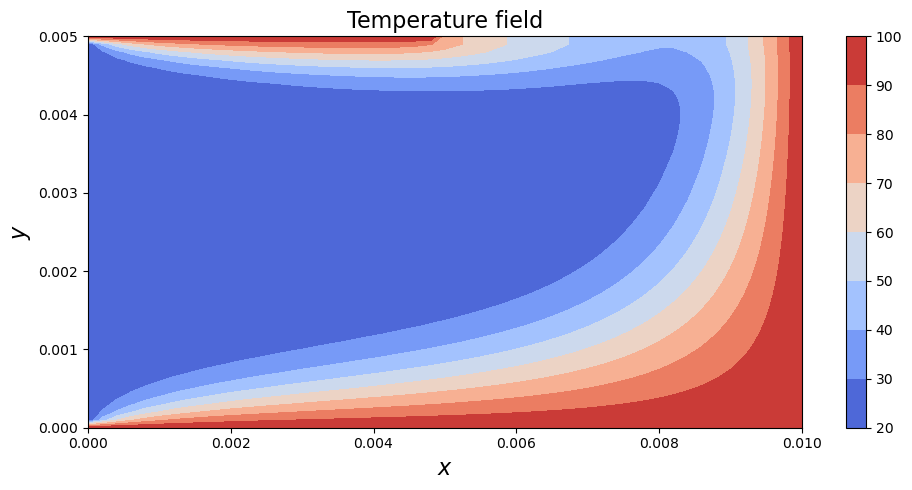

In [10]:
# set up figure
fig = plt.figure(figsize=(10, 5))

# Plot for temperature field
ax3 = fig.add_subplot(111)  
cont = ax3.contourf(X, Y, T, cmap=cm.coolwarm)
fig.colorbar(cont)
ax3.set_xlim(0, Lx)
ax3.set_ylim(0, Ly)
ax3.set_xlabel('$x$', fontsize=16)
ax3.set_ylabel('$y$', fontsize=16)
ax3.set_title('Temperature field', fontsize=16)

plt.tight_layout()  # Adjust the layout so that all subplots fit into the figure area.
plt.show()


### (D)  How the parameters in the models influence the results

In fluid mechanics and heat transfer, dimensionless groups are commonly used to reveal the relative importance of different physical quantities and how they influence flow and heat transfer. Some common dimensionless numbers include:

- **Reynolds Number (Re)**: This characterizes the ratio of inertial forces to viscous forces within fluid flow. It is calculated as $ Re = \frac{\rho U L}{\mu} $ , where $ U $ is the characteristic velocity and $ L $ is the characteristic length.
  
- **Peclet Number (Pe)**: This is the product of the Reynolds number and the Prandtl number, signifying the ratio of convective to conductive heat transfer. It is calculated as $Pe = \frac{U L}{\alpha} $, where $ \alpha $ is the thermal diffusivity.

- **Prandtl Number (Pr)**: This represents the ratio of momentum diffusion to thermal diffusion in a fluid. It is calculated as $ Pr = \frac{\nu}{\alpha} $, where $ \nu $ is the momentum diffusivity (kinematic viscosity).

Let's see what happens if we **change the density** (and also the value of Re).

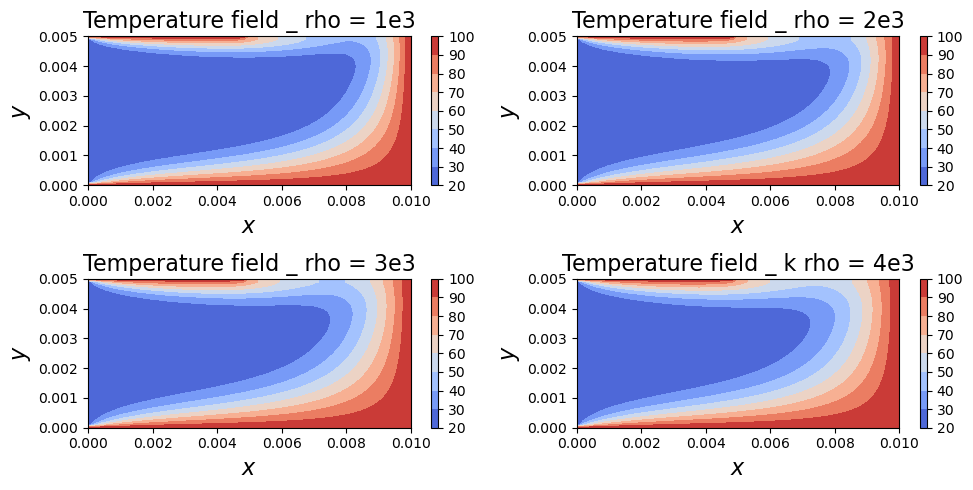

In [11]:
# Start simulation with different densities
tnt = 1
rho1 = 1e3
rho2 = 2e3
rho3 = 3e3
rho4 = 4e3
_, _, _, T1 = solve_NS_with_temperature(u, v, p, T, rho1, nu, k, dt, tnt, dx, dy, rtol=1.e-6)
_, _, _, T2 = solve_NS_with_temperature(u, v, p, T, rho2, nu, k, dt, tnt, dx, dy, rtol=1.e-6)
_, _, _, T3 = solve_NS_with_temperature(u, v, p, T, rho3, nu, k, dt, tnt, dx, dy, rtol=1.e-6)
_, _, _, T4 = solve_NS_with_temperature(u, v, p, T, rho4, nu, k, dt, tnt, dx, dy, rtol=1.e-6)

# set up figure
fig = plt.figure(figsize=(10, 5))

# subplot for temperature field
ax1 = fig.add_subplot(221)  
cont = ax1.contourf(X, Y, T1, cmap=cm.coolwarm)
fig.colorbar(cont)
ax1.set_xlim(0, Lx)
ax1.set_ylim(0, Ly)
ax1.set_xlabel('$x$', fontsize=16)
ax1.set_ylabel('$y$', fontsize=16)
ax1.set_title('Temperature field _ rho = 1e3', fontsize=16)

# subplot for temperature field
ax2 = fig.add_subplot(222)  
cont = ax2.contourf(X, Y, T2, cmap=cm.coolwarm)
fig.colorbar(cont)
ax2.set_xlim(0, Lx)
ax2.set_ylim(0, Ly)
ax2.set_xlabel('$x$', fontsize=16)
ax2.set_ylabel('$y$', fontsize=16)
ax2.set_title('Temperature field _ rho = 2e3', fontsize=16)

# subplot for temperature field
ax3 = fig.add_subplot(223)  
cont = ax3.contourf(X, Y, T3, cmap=cm.coolwarm)
fig.colorbar(cont)
ax3.set_xlim(0, Lx)
ax3.set_ylim(0, Ly)
ax3.set_xlabel('$x$', fontsize=16)
ax3.set_ylabel('$y$', fontsize=16)
ax3.set_title('Temperature field _ rho = 3e3', fontsize=16)

# subplot for temperature field
ax4 = fig.add_subplot(224)  
cont = ax4.contourf(X, Y, T4, cmap=cm.coolwarm)
fig.colorbar(cont)
ax4.set_xlim(0, Lx)
ax4.set_ylim(0, Ly)
ax4.set_xlabel('$x$', fontsize=16)
ax4.set_ylabel('$y$', fontsize=16)
ax4.set_title('Temperature field _ k rho = 4e3', fontsize=16)

plt.tight_layout()  # Adjust the layout so that all subplots fit into the figure area.
plt.show()

By observing the heat map drawn, it can be found that the higher the density of the liquid, the higher the temperature of the liquid at the output port.

Next we try **changing the thermal diffusivity** (and also the value of Pe) to see what the impact is.

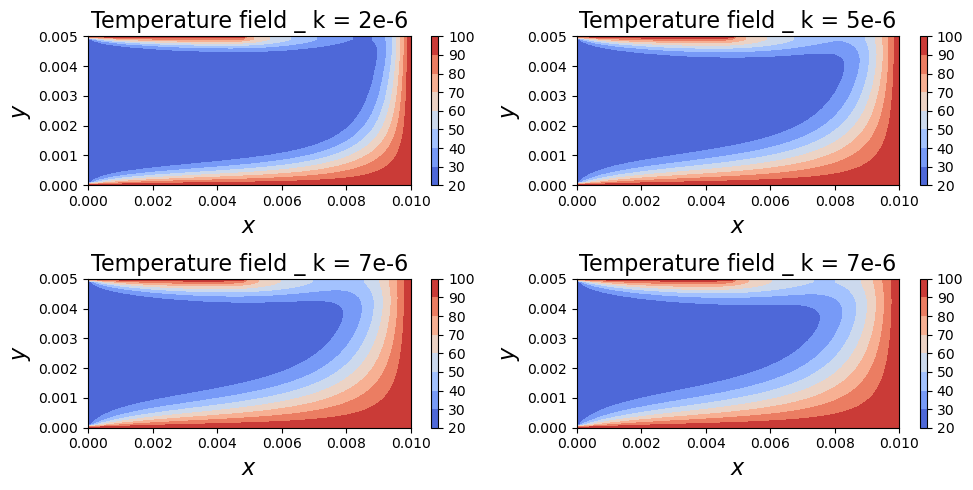

In [12]:
# Start simulation with different thermal diffusivity
tnt = 1
k1 = 2e-6
k2 = 5e-6
k3 = 7e-6
k4 = 9e-6
_, _, _, T1 = solve_NS_with_temperature(u, v, p, T, rho, nu, k1, dt, tnt, dx, dy, rtol=1.e-6)
_, _, _, T2 = solve_NS_with_temperature(u, v, p, T, rho, nu, k2, dt, tnt, dx, dy, rtol=1.e-6)
_, _, _, T3 = solve_NS_with_temperature(u, v, p, T, rho, nu, k3, dt, tnt, dx, dy, rtol=1.e-6)
_, _, _, T4 = solve_NS_with_temperature(u, v, p, T, rho, nu, k4, dt, tnt, dx, dy, rtol=1.e-6)

# set up figure
fig = plt.figure(figsize=(10, 5))

# subplot for temperature field
ax1 = fig.add_subplot(221)  
cont = ax1.contourf(X, Y, T1, cmap=cm.coolwarm)
fig.colorbar(cont)
ax1.set_xlim(0, Lx)
ax1.set_ylim(0, Ly)
ax1.set_xlabel('$x$', fontsize=16)
ax1.set_ylabel('$y$', fontsize=16)
ax1.set_title('Temperature field _ k = 2e-6', fontsize=16)

# subplot for temperature field
ax2 = fig.add_subplot(222)  
cont = ax2.contourf(X, Y, T2, cmap=cm.coolwarm)
fig.colorbar(cont)
ax2.set_xlim(0, Lx)
ax2.set_ylim(0, Ly)
ax2.set_xlabel('$x$', fontsize=16)
ax2.set_ylabel('$y$', fontsize=16)
ax2.set_title('Temperature field _ k = 5e-6', fontsize=16)

# subplot for temperature field
ax3 = fig.add_subplot(223)  
cont = ax3.contourf(X, Y, T3, cmap=cm.coolwarm)
fig.colorbar(cont)
ax3.set_xlim(0, Lx)
ax3.set_ylim(0, Ly)
ax3.set_xlabel('$x$', fontsize=16)
ax3.set_ylabel('$y$', fontsize=16)
ax3.set_title('Temperature field _ k = 7e-6', fontsize=16)

# subplot for temperature field
ax4 = fig.add_subplot(224)  
cont = ax4.contourf(X, Y, T4, cmap=cm.coolwarm)
fig.colorbar(cont)
ax4.set_xlim(0, Lx)
ax4.set_ylim(0, Ly)
ax4.set_xlabel('$x$', fontsize=16)
ax4.set_ylabel('$y$', fontsize=16)
ax4.set_title('Temperature field _ k = 7e-6', fontsize=16)

plt.tight_layout()  # Adjust the layout so that all subplots fit into the figure area.
plt.show()

By observing the heat map drawn, we can find that if the thermal diffusivity is higher, the temperature of the liquid at the outlet will be higher.